<a href="https://colab.research.google.com/github/deniseiras/Time-Series-Credit-BCB/blob/main/Time_Series_credit_BCB.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Time Series - Predição de inadimplentes da carteira da crédito bcb

https://colab.research.google.com/drive/10kjCcOBwHzkxoH0QqzbWqp5719H1DVVC?usp=sharing

Autor: Denis M. A. Eiras

contato: denis.eiras@gmail.com

Atualizado em: 02/09/2023

**Time series**

A partir da série de inadimplência, disponível em:
https://dadosabertos.bcb.gov.br/dataset/21082-inadimplencia-dacarteira-de-credito---total :
1. Projete a taxa de inadimplência dos próximos 12 meses;
2. Como você defenderia essa projeção? Quais
são, provavelmente, os principais drivers desses valores?

---



# Introdução

Os grandes mercados do sistema financeiro são interligados - qualquer acontecimento
em qualquer um dos mercados afetam indiretamente ou diretamente os outros; mesmos os
eventos internacionais afetam o sistema financeiro brasileiro através da globalização, um exemplo disso é a crise do Subprime que aconteceu nos Estados Unidos em julho de 2007.O sistema financeiro também é muito sensível às decisões políticas e fatores políticos, um exemplo disso é o Plano Real adotado no Brasil na década dos 90, que foi uma decisão política que influenciou bastante no mercado de crédito do Brasil [1].

A Serasa Experian, em janeiro de 2016, apontou que cerca de 59 milhões de
brasileiros começaram o ano na lista de inadimplentes, sendo maior número registrado desde 2012. Segundo os economistas da Serasa Experian, a alta da inadimplência é causada pelo cenário econômico bastante adverso à quitação das dívidas do consumidor: desemprego, taxas de inflação e juros se mantiveram em alta no ano 2015 [1].

Considerando-se a apenas fatores históricos, algumas abordagens tem sido utilizadas para previsão de séries temporais. As metodologias de Redes Neurais Recorrentes (RNNs), recentemente se tornaram uma técnica de previsão viável e poderosa. GRU(Gated Recurrent Unit) e LSTM (Long Short Term Memory) são um tipo de RRN que se adaptam melhor a diferentes séries temporais, ao comparar com uma RNN simples, por serem capazes de guardar mais nuances das séries. GRU geralmente se adaptam melhor para séries mais curtas, enquanto que as LSTM são mais capazes para séries longas [2]. Métodos clássicos de previsão como ARIMA e HWES ainda são populares e poderosos, mas carecem da generalização que modelos baseados em memória como LSTM oferecem. Ainda, carecem de um trabalho de análise e pré-processamento que não é necessário nas RNNs [3].

Na previsão de séries temporais com Machine Learning, existe uma regra geral de que um modelo RNN decente deve sempre ter mais observações do que parâmetros na série temporal. Para a maioria das aplicações de séries temporais, isto significa que os dados submetidos devem ter tantas observações quanto o período da sazonalidade máxima esperada. Por exemplo, se você tiver dados de vendas diárias e espera que eles apresentem sazonalidade anual, deverá ter mais de 365 pontos de dados para treinar um modelo bem-sucedido. No entanto, esse é o número mínimo de pontos necessários para treinar esses tipos de modelos – mais dados são necessários se você quiser testar com eficácia a precisão do desempenho do seu modelo ao fazer previsões [4].

# Metodologia

A série temporal em estudo registra o percentual da carteira de crédito do Sistema Financeiro Nacional com pelo menos uma parcela com atraso superior a 90 dias. Inclui operações contratadas no segmento de crédito livre e no segmento de crédito direcionado. Foram registrados 149 valores mensais entre 01/03/2011 e 01/07/2023.

Devido ao curto tempo de estudo das séries, não serão utilizados modelos estatísticos como ARIMA e ARIMAX.

A prévia análise da série em um gráfico mostra que, aparentemente, há uma sazonalidade aproximada a cada 4 ou 5 anos, entre 2011 e 2019, o que sugere a possibilidade de aplicação de uma RNN, apesar da série apresentar mais um período conturbado pelos efeitos da Covid-19, após 2019.

A metodologia consiste em:
1. Análise da série temporal
2. Divisão em base de testes e treinamento
3. Pré-processamento para adequação às arquiteturas RNNs
4. Uso de diferentes arquiteturas RNNs para avaliação sobre a base de avaliação do treinamento
5. Avaliação das melhores arquiteturas sobre a base de testes e escolha da melhor arquitetura
6. Predição dos próximos 12 meses utilizando a melhor arquitetura

Os passos da metodologia são detalhados em cada sub seção.

Inicialização de bibliotecas


In [ ]:
import numpy as np
from keras.models import Model, Sequential
from keras.layers import LSTM, Input, Dropout, Dense, RepeatVector, TimeDistributed, Conv1D, Flatten, MaxPooling1D, \
  BatchNormalization, Activation, GRU
from keras.regularizers import l2
import tensorflow as tf
import pandas as pd
from matplotlib import pyplot as plt
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import seaborn as sns
from IPython import display as dsp
import sys
from time import time
from datetime import datetime, timedelta
from random import uniform

print('Python version:')
print (sys.version)
print('\nTensorflow version:')
print(tf.__version__)
print('')

# import warnings
# from sklearn import metrics
# import pickle
# import glob
# from google.colab import drive
# warnings.filterwarnings('ignore')

Python version:
3.10.12 (main, Jun 11 2023, 05:26:28) [GCC 11.4.0]

Tensorflow version:
2.12.0



## 1) Análise da série temporal
As série foi copiada para uma pasta púbilica do Dropbox, para evitar mudanças no arquivo fornecido na api



In [102]:
# df_original = pd.read_csv('https://api.bcb.gov.br/dados/serie/bcdata.sgs.21082/dados?formato=csv',  sep=';', decimal=',' , index_col='data')
df_original = pd.read_csv('https://www.dropbox.com/scl/fi/2usyl2f7r2clwlggkoliz/bcdata.sgs.21082.csv?rlkey=0umia8sc3xl2irmlodwa01z9j&dl=1',  sep=';', decimal=',' , index_col='data')
df = df_original

df.index = pd.to_datetime(df.index, format='%d/%m/%Y')
print('Data Inicial: ', df.index.min())
print('Data Final  : ', df.index.max())
print('Tamanho     : ', len(df))
dsp.display(df.describe())

feature='valor'


Data Inicial:  2011-03-01 00:00:00
Data Final  :  2023-07-01 00:00:00
Tamanho     :  149


,valor
count,149.000000
mean,3.143087
std,0.453813
min,2.120000
25%,2.890000
50%,3.120000
75%,3.540000
max,4.040000


## 2) Divisão da base em base de testes e treinamento e visualização

Data Inicial Treino:  2011-03-01 00:00:00
Data Final   Treino:  2022-07-01 00:00:00
Tamanho      Treino:  137

Data Inicial Teste:  2022-08-01 00:00:00
Data Final   Teste:  2023-07-01 00:00:00
Tamanho      Teste:  12


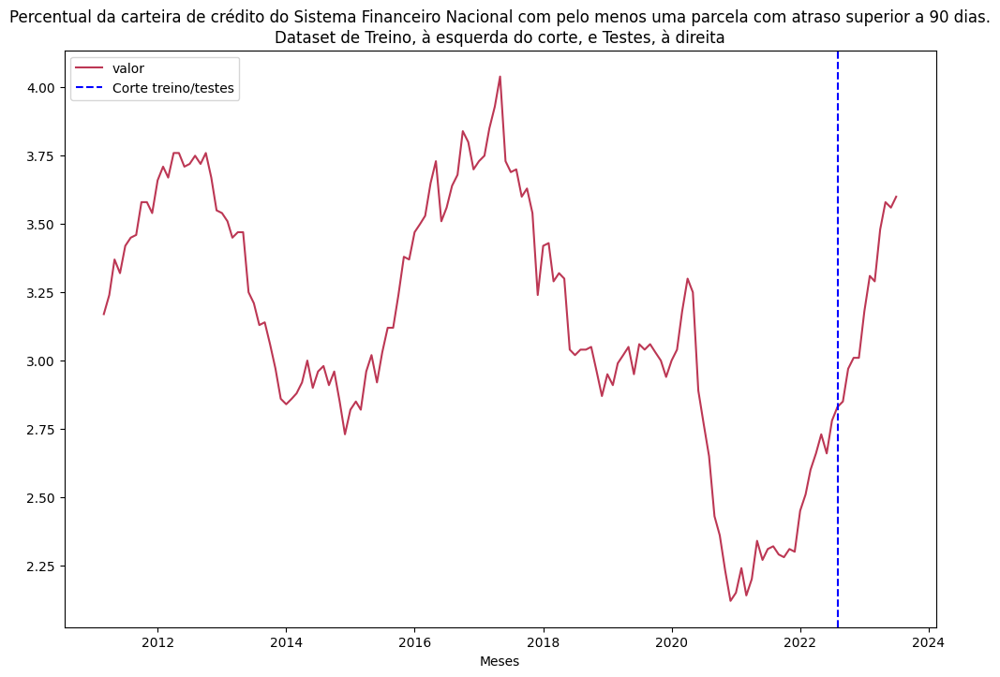

In [ ]:
today = datetime.today()

# A base de testes serão os últimos 12 meses
meses_teste = 12
data_corte_treino = df.index[-meses_teste]
data_treino = df.loc[(df.index < data_corte_treino)]
data_teste = df.loc[(df.index >= data_corte_treino)]

print('Data Inicial Treino: ', data_treino.index.min())
print('Data Final   Treino: ', data_treino.index.max())
print('Tamanho      Treino: ', len(data_treino))
print('')

print('Data Inicial Teste: ', data_teste.index.min())
print('Data Final   Teste: ', data_teste.index.max())
print('Tamanho      Teste: ', len(data_teste))

fig, ax = plt.subplots(figsize=(12, 8), nrows=1, ncols=1)
sns.lineplot(data=df, palette='inferno', ax=ax)
plt.axvline(x=data_corte_treino, color='blue', linestyle='--', label='Corte treino/testes', )
ax.set_xlabel('Meses')
ax.set_title('Percentual da carteira de crédito do Sistema Financeiro Nacional com pelo menos uma parcela com atraso superior a 90 dias.\nDataset de Treino, à esquerda do corte, e Testes, à direita')
# ax.set_ylim([0, 80])
plt.legend()

## 3) Pré Processamento
- função preprocess_rnn: usada para transformação da série em subseries de treinamento

In [ ]:
def preprocess(dataset, feature, timesteps, TesteLen):
# Função utilizada para transformação da série em subseries:
#
# 1. Uma sequência para treinamento do tamanho Batch Size;
# 2. Um ponto de observação para a sequência de treinamento

    n = len(dataset[[feature]])
    scaler = StandardScaler()
    scaler = scaler.fit(dataset[[feature]])

    df_scal = scaler.transform(dataset[[feature]])
    df_scal = df_scal.reshape(n, 1)

    X = df_scal
    X_samples = list()
    y_samples = list()

    NumerOfRows = len(X)
    for i in range(int(timesteps) , NumerOfRows , 1):
        x_sample = X[i-timesteps:i]
        y_sample = X[i]
        X_samples.append(x_sample)
        y_samples.append(y_sample)

    X_data=np.array(X_samples)
    X_data=X_data.reshape(X_data.shape[0],X_data.shape[1], 1)

    y_data=np.array(y_samples)
    y_data=y_data.reshape(y_data.shape[0], 1)

    # Separando dataset entre treino e teste
    if TesteLen > 0:
      X_train=X_data[:-TesteLen]
      X_test=X_data[-TesteLen:]
      y_train=y_data[:-TesteLen]
      y_test=y_data[-TesteLen:]
    else:
      X_train=X_data
      X_test=[]
      y_train=y_data
      y_test=[]
    return scaler, X_train, X_test, y_train, y_test


def preprocess_CNN1D(dataset, feature, TesteLen):

    n = len(dataset[[feature]])
    scaler = StandardScaler()
    scaler = scaler.fit(dataset[[feature]])

    df_scal = scaler.transform(dataset[[feature]])
    df_scal = df_scal.reshape(n, 1)

    X = np.array(df_scal)
    # Separando dataset entre treino e teste
    if TesteLen > 0:
      X_train = X[:-TesteLen]
      X_test = X[-TesteLen:]
    else:
      X_train = X_train
      X_test = []

    y_train, y_test = X_train, X_test
    X_train = X_train.reshape(X_train.shape[0], 1, 1)
    X_test = X_test.reshape(X_test.shape[0], 1, 1)

    return scaler, X_train, X_test, y_train, y_test

Exemplo de transformação do dataset, utilizando sequência de 10 observações por batch, separando os ultimos len(data_teste) registros como base de testes



In [ ]:
timesteps = 6
print('RNN data\n')
scaler, X_train, X_test, y_train, y_test = preprocess(df, feature, timesteps, len(data_teste))
for inp, out in zip(X_train[0:3], y_train[0:2]):
  print(inp,'--', out)

print('\n\nCNN1D data\n')
scaler, X_train, X_test, y_train, y_test = preprocess_CNN1D(df, feature, len(data_teste))
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)
for inp, out in zip(X_train[0:3], y_train[0:2]):
  print(inp,'--', out)

RNN data

[[0.05950369]
 [0.21427264]
 [0.50170069]
 [0.39115144]
 [0.61224994]
 [0.67857949]] -- [0.70068934]
[[0.21427264]
 [0.50170069]
 [0.39115144]
 [0.61224994]
 [0.67857949]
 [0.70068934]] -- [0.96600754]


CNN1D data

(137, 1, 1) (12, 1, 1) (137, 1) (12, 1)
[[0.05950369]] -- [0.05950369]
[[0.21427264]] -- [0.21427264]


## 4) Construção dos modelos RNN

Para desenvolvimento do projeto foram testados os modelos LSTM e GRU abaixo.

O modelo GRU foi testada uma arquitetura simples, enquanto que os LSTMS foram avaliadas arquiteturas com regularização e dropouts para evitar o overfitting e curvas tendenciosas ao usar o modelo iterativamente

In [ ]:
def GRU_v1(unit, optimizer, timesteps, X, y, epochs, batch_size, patience):

  mod = Sequential()
  mod.add(GRU(unit, input_shape=(timesteps, 1)))
  mod.add(Dense(1, activation='linear'))
  return mod


def LSTM_v1(unit, optimizer, timesteps, X, y, epochs, batch_size, patience):

    mod = Sequential()
    mod.add(LSTM(int(unit), activation='relu', input_shape=(timesteps, 1), return_sequences=False))
    mod.add(Dense(1, activation='linear'))
    return mod


def LSTM_v2(unit, optimizer, timesteps, X, y, epochs, batch_size, patience, l2_reg=0.001):

    mod = Sequential()
    mod.add(LSTM(int(unit), activation='relu', input_shape=(timesteps, 1), kernel_regularizer=l2(l2_reg),
                 return_sequences=False))
    mod.add(Dense(1, activation='linear'))
    return mod


def LSTM_v3(unit, optimizer, timesteps, X, y, epochs, batch_size, patience, dropout_rate=0.3, l2_reg=0.001):

    mod = Sequential()
    mod.add(LSTM(int(unit), activation='relu', input_shape=(timesteps, 1), kernel_regularizer=l2(l2_reg),
                 return_sequences=False))
    mod.add(Dropout(dropout_rate))
    mod.add(Dense(1, activation='linear'))
    return mod


def model_type(mod_type, unit, optimizer, timesteps, X, y, epochs=60, batch_size=32, patience=10, train=True):
  func = globals()[mod_type]
  mod = func(unit, optimizer, timesteps, X, y, epochs, batch_size, patience)
  hist = None
  if train:
    mod, hist = train_model(mod, optimizer, X, y, batch_size, patience, epochs)
  return mod, hist


def train_model(mod, optimizer, X, y, batch_size, patience, epochs):

  callback = tf.keras.callbacks.EarlyStopping(monitor='val_mean_absolute_error', patience=patience, mode='min',
                                              restore_best_weights=True)

  # only Adam implemented
  if optimizer == 'Adam':
    adam = tf.keras.optimizers.Adam()
    mod.compile(loss=tf.losses.MeanSquaredError(),optimizer=adam, metrics=[tf.metrics.MeanAbsoluteError()])

  hist = mod.fit(X, y, batch_size=batch_size, epochs=epochs, validation_split=0.1, callbacks=[callback], verbose=0,
                  shuffle=False)

  loss_metric_train = mod.evaluate(X, y, verbose=0, batch_size=batch_size, use_multiprocessing=True)
  dsp.display( 'TRAINING set. Loss = {} , MAE = {}'.format(loss_metric_train[0], loss_metric_train[1]))

  plt.xlabel('Epochs')
  plt.ylabel('Loss')
  plt.plot(hist.history['loss'], label='Loss Treino')
  plt.plot(hist.history['val_loss'], label='Loss Validação')
  plt.plot(hist.history['mean_absolute_error'], label='MAE Treino')
  plt.ylim([0.0, 2])
  plt.xlim([0.0, epochs])
  plt.legend()
  plt.show()

  return mod, hist

### Treinamento e Hiperparâmetrização

A metodologia de escolha de melhor modelo consiste em variar modelos e parâmetros das RNNs e testar na base de testes. Os treinamentos serão executados 3 vezes para cada combinanação, e uma média sobre o MAE será feita. A melhor combinação de modelos e parâmetros, em razão da média calculada, determinará o melhor modelo.

Parâmetros variados

1. Modelos
2. Timesteps (tamanho da subséries de treinamento): será de semestres, anuais e bianuais, para encontrar padrões das sazonalidades
3. Numéro de Neurônios nas camadas ocultas
4. Batch size


X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=6, units=4, batch=4


'TRAINING set. Loss = 0.47095832228660583 , MAE = 0.5210343599319458'

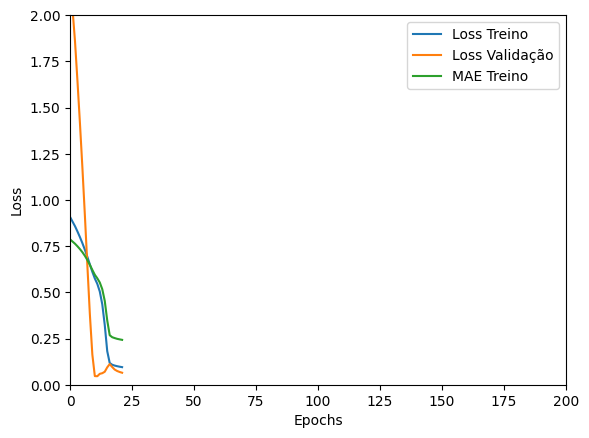

Tempo de treino: 0.22678302526473998 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.220067098736763 , MAE = 0.3103736937046051'

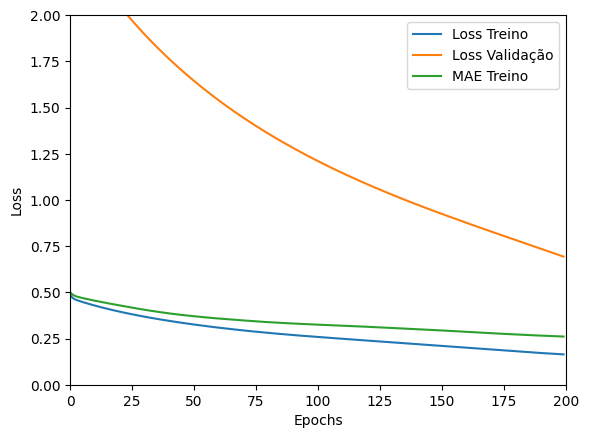

Tempo de treino: 0.7763495882352193 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05846536532044411 , MAE = 0.18526498973369598'

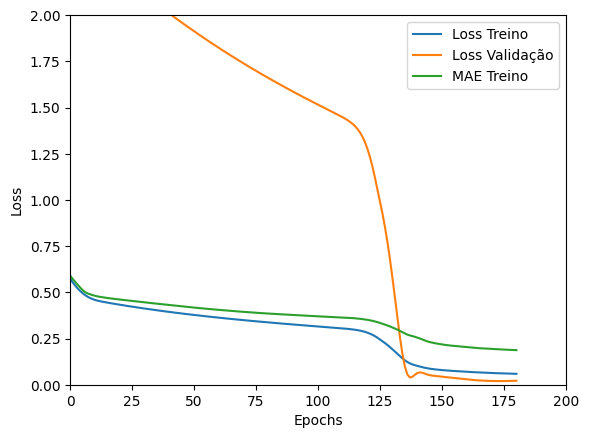

Tempo de treino: 0.26082210143407186 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3871231973171234 , MAE = 0.39850807189941406'

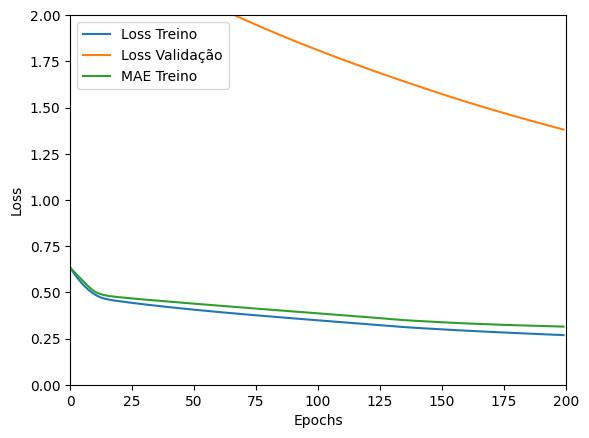

Tempo de treino: 0.22482027610143027 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05871972069144249 , MAE = 0.19109249114990234'

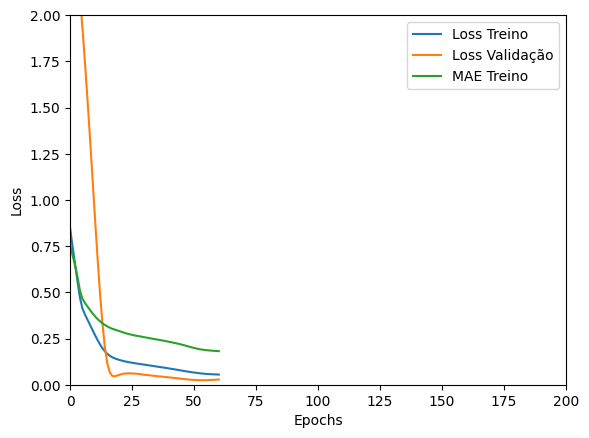

Tempo de treino: 0.20996787945429485 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1323544830083847 , MAE = 0.2814217209815979'

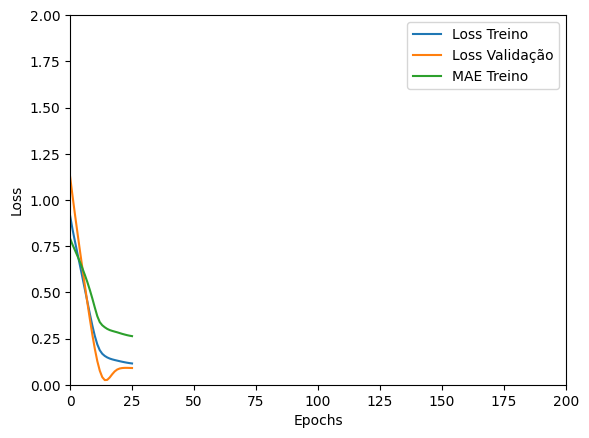

Tempo de treino: 0.08296993176142374 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14603182673454285 , MAE = 0.29226645827293396'

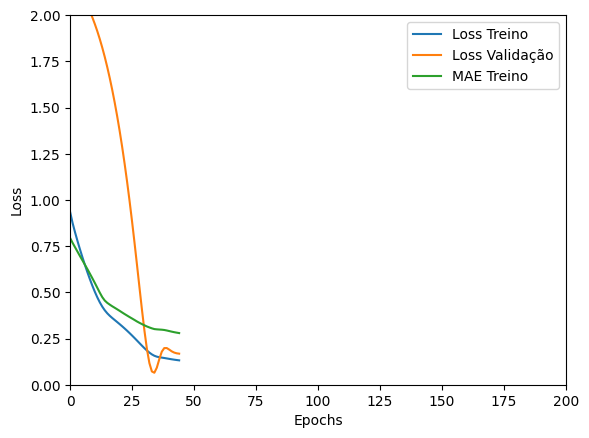

Tempo de treino: 0.13480244080225626 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16104285418987274 , MAE = 0.3089533746242523'

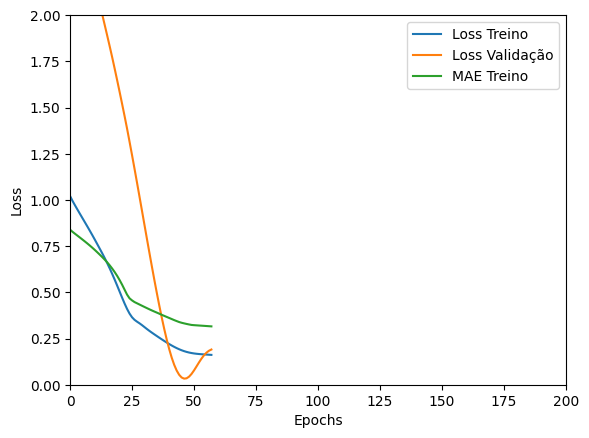

Tempo de treino: 0.11429811318715413 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.060416072607040405 , MAE = 0.19785718619823456'

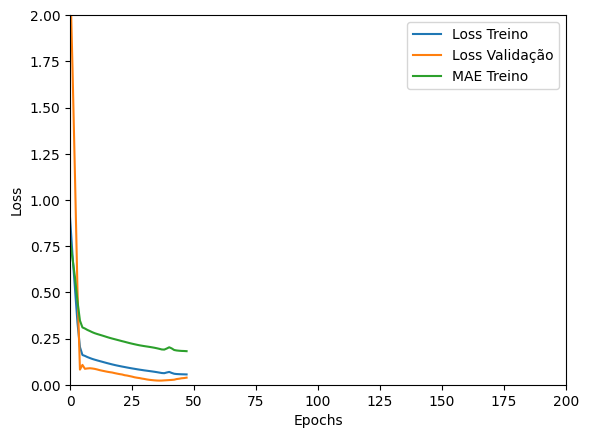

Tempo de treino: 0.17433852752049764 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25854164361953735 , MAE = 0.39787185192108154'

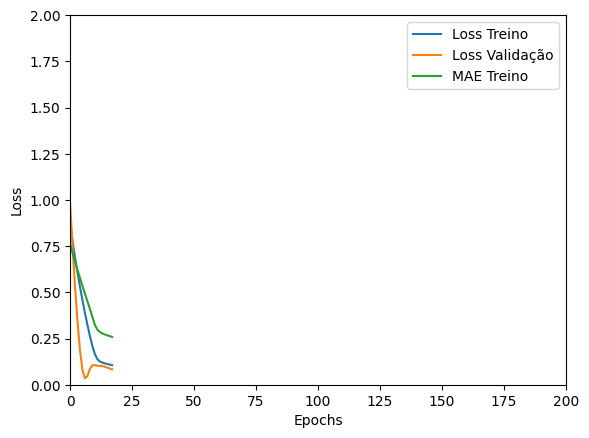

Tempo de treino: 0.08558247884114584 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2788142263889313 , MAE = 0.4130055904388428'

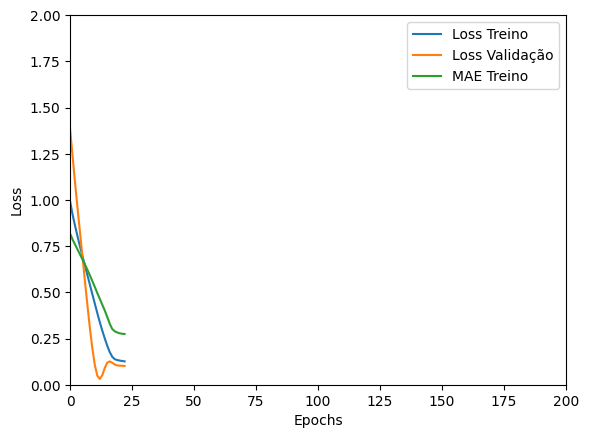

Tempo de treino: 0.0782028595606486 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1359381228685379 , MAE = 0.28028854727745056'

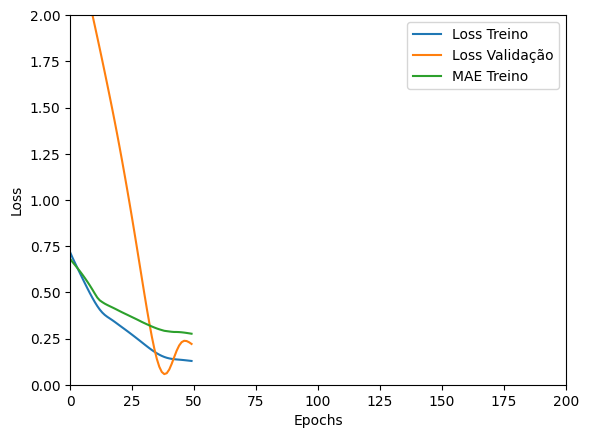

Tempo de treino: 0.12047349214553833 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15093573927879333 , MAE = 0.29533055424690247'

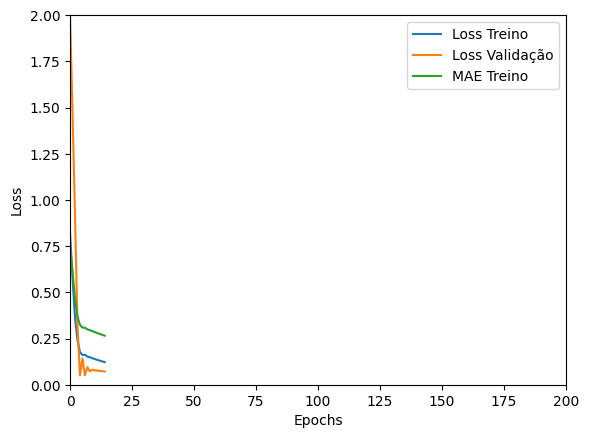

Tempo de treino: 0.12195260922114054 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13335207104682922 , MAE = 0.273442804813385'

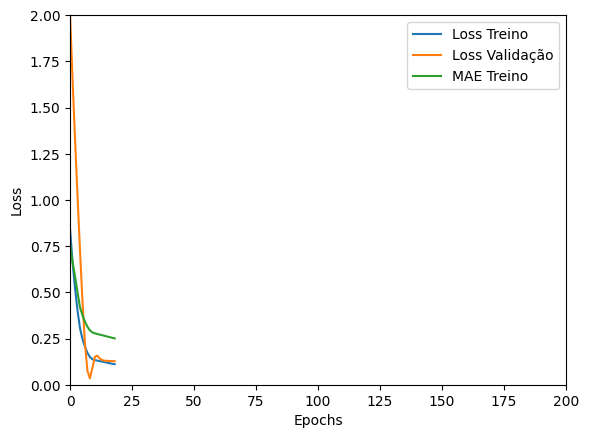

Tempo de treino: 0.1039678970972697 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1481921672821045 , MAE = 0.2925180196762085'

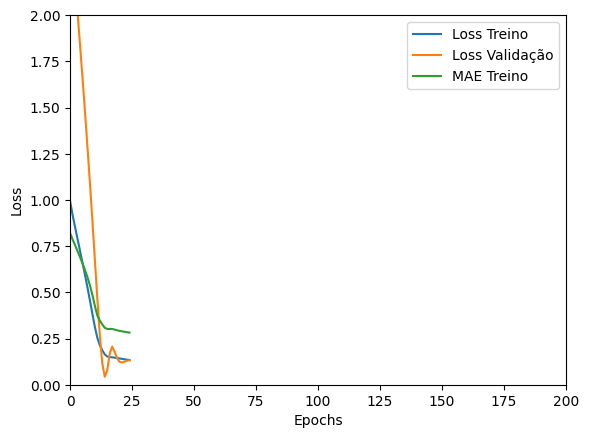

Tempo de treino: 0.07960715691248575 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15204934775829315 , MAE = 0.2936227023601532'

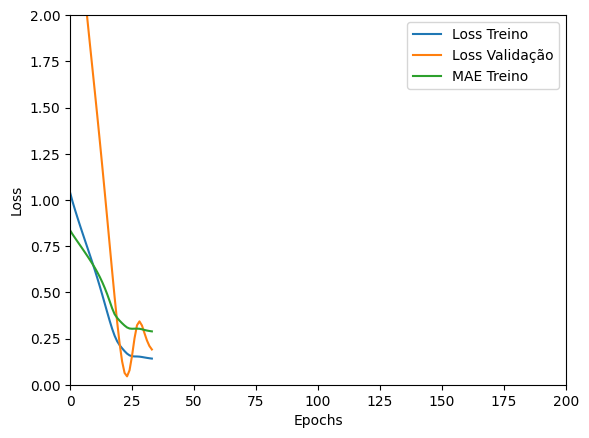

Tempo de treino: 0.08504501183827719 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08778228610754013 , MAE = 0.24327439069747925'

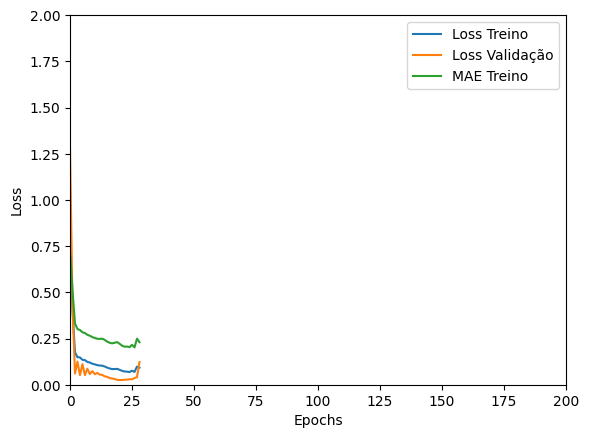

Tempo de treino: 0.12907575766245524 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24654479324817657 , MAE = 0.39242056012153625'

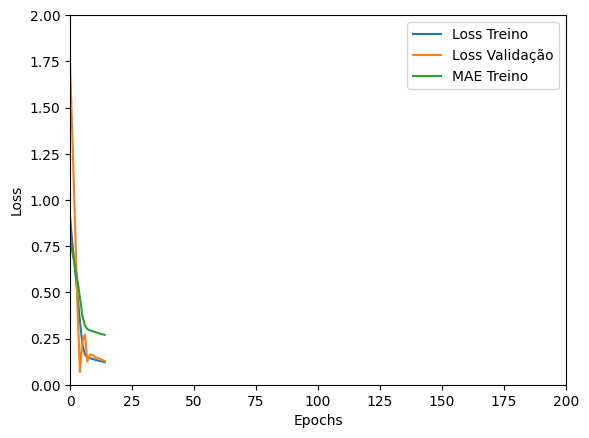

Tempo de treino: 0.12011837959289551 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1393452286720276 , MAE = 0.2870842516422272'

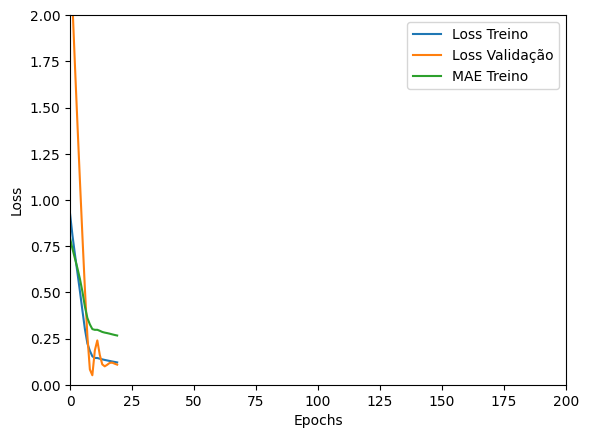

Tempo de treino: 0.06509040594100952 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15814527869224548 , MAE = 0.2960309088230133'

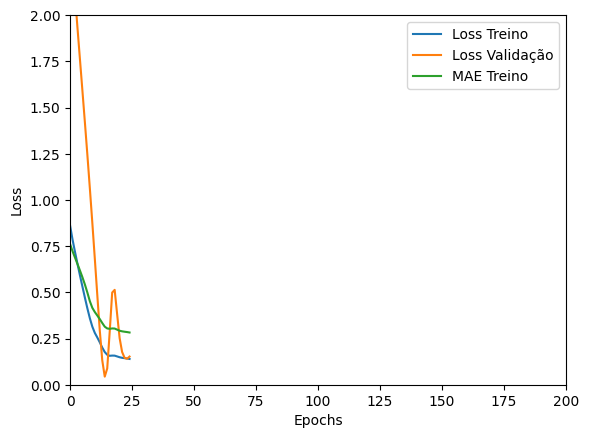

Tempo de treino: 0.08065992991129557 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=6, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14772146940231323 , MAE = 0.2654043734073639'

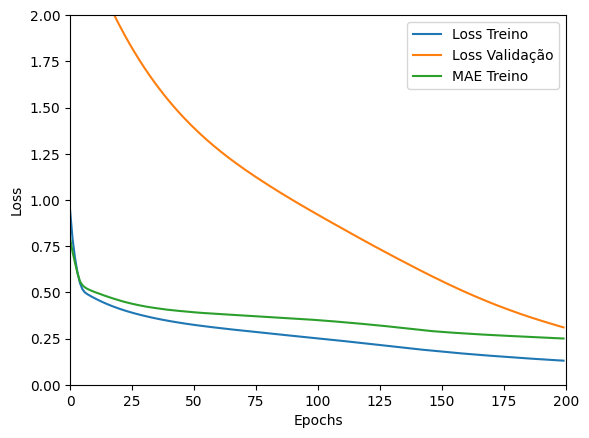

Tempo de treino: 0.7391928235689799 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0982670783996582 , MAE = 0.23971101641654968'

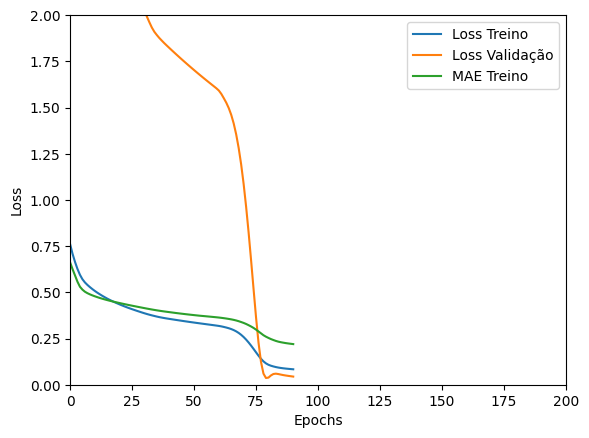

Tempo de treino: 0.2169809579849243 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37067991495132446 , MAE = 0.4221164584159851'

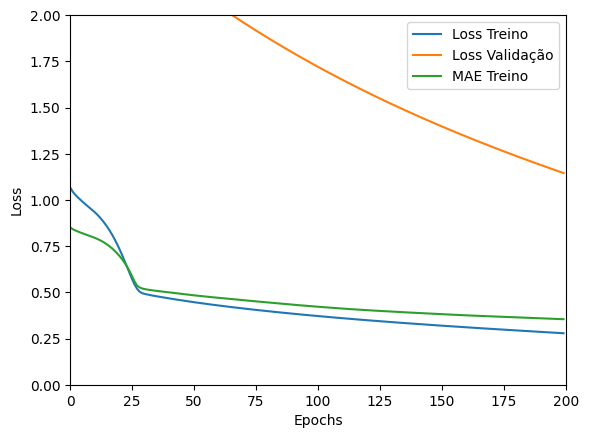

Tempo de treino: 0.3794966220855713 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39782315492630005 , MAE = 0.40464311838150024'

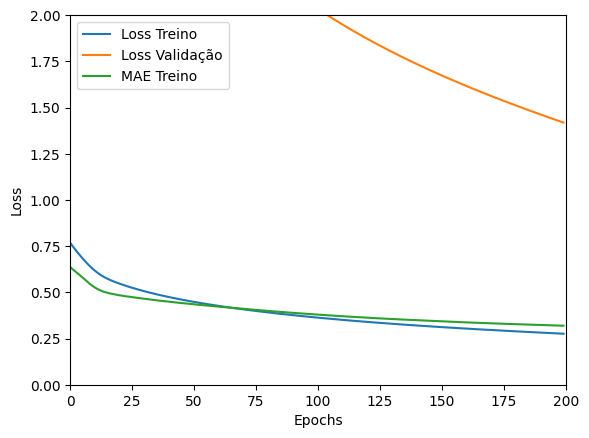

Tempo de treino: 0.2653059482574463 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17529313266277313 , MAE = 0.31428438425064087'

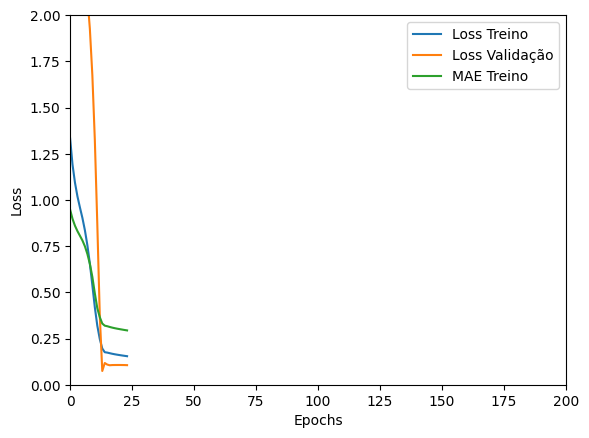

Tempo de treino: 0.12530392408370972 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10880813002586365 , MAE = 0.2548672556877136'

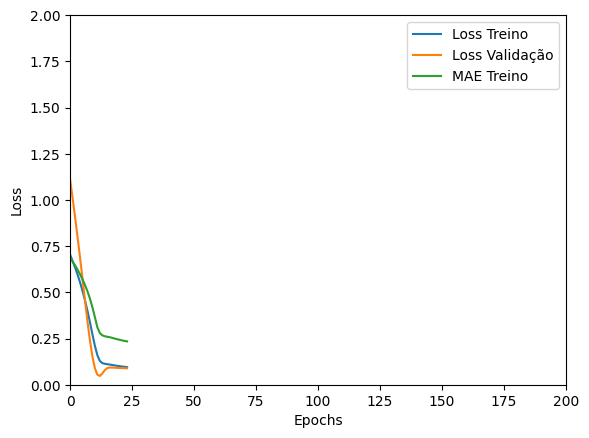

Tempo de treino: 0.08621012767155965 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15339654684066772 , MAE = 0.29870542883872986'

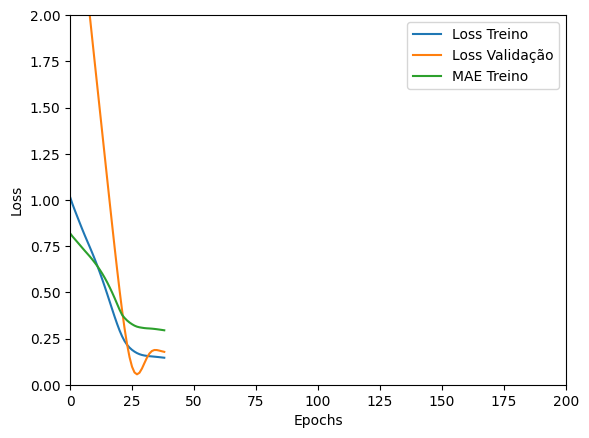

Tempo de treino: 0.12932215531667074 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14455857872962952 , MAE = 0.28851333260536194'

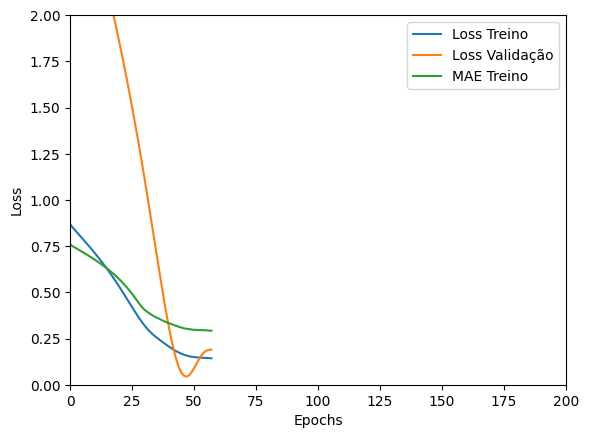

Tempo de treino: 0.10272495349248251 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15116947889328003 , MAE = 0.28908300399780273'

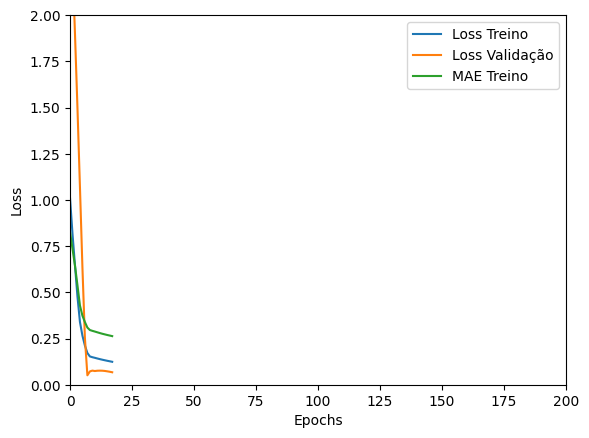

Tempo de treino: 0.1312692125638326 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14476534724235535 , MAE = 0.2792648673057556'

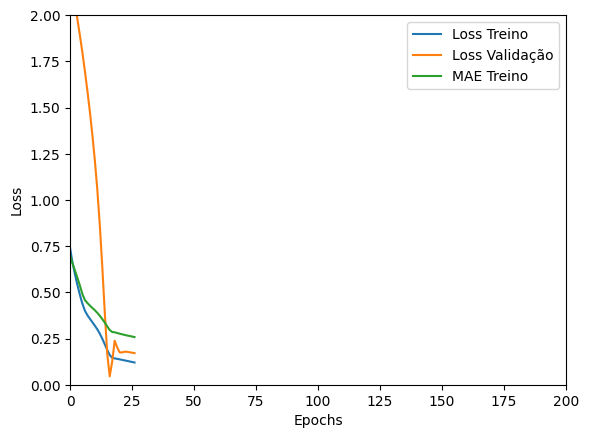

Tempo de treino: 0.1218521237373352 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16442988812923431 , MAE = 0.30157819390296936'

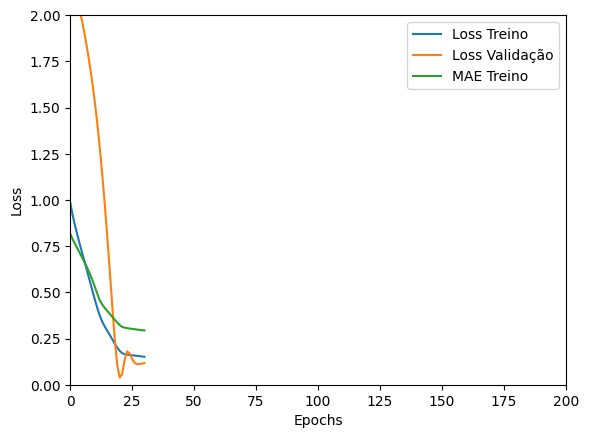

Tempo de treino: 0.07697033087412516 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1384275108575821 , MAE = 0.28142476081848145'

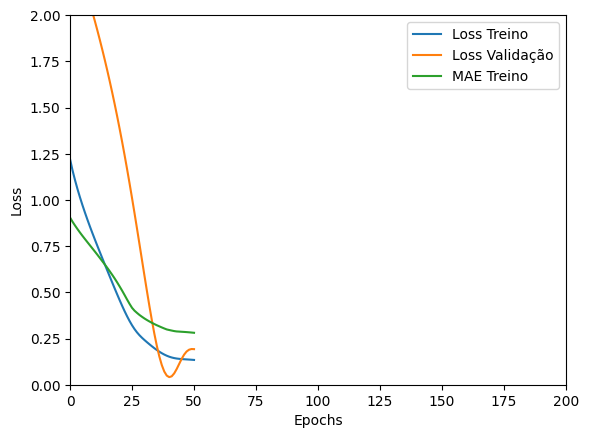

Tempo de treino: 0.12091451088587443 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.052362583577632904 , MAE = 0.17941375076770782'

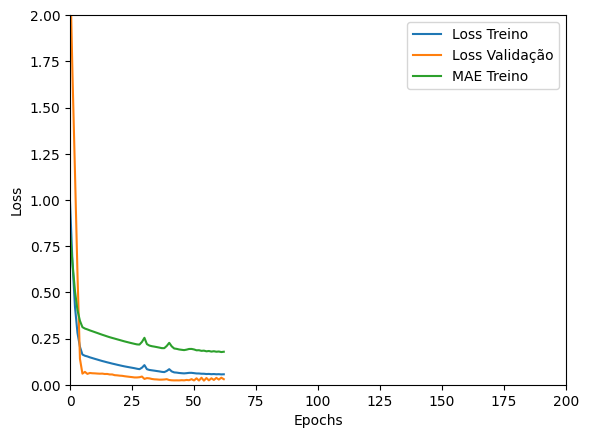

Tempo de treino: 0.2754859447479248 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1400795876979828 , MAE = 0.2843612730503082'

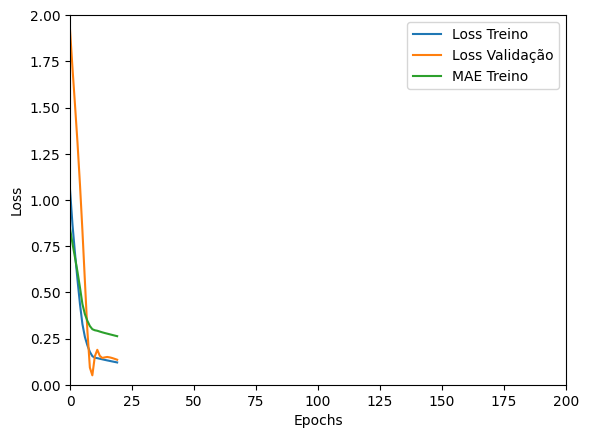

Tempo de treino: 0.12567859490712482 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1601189374923706 , MAE = 0.30002284049987793'

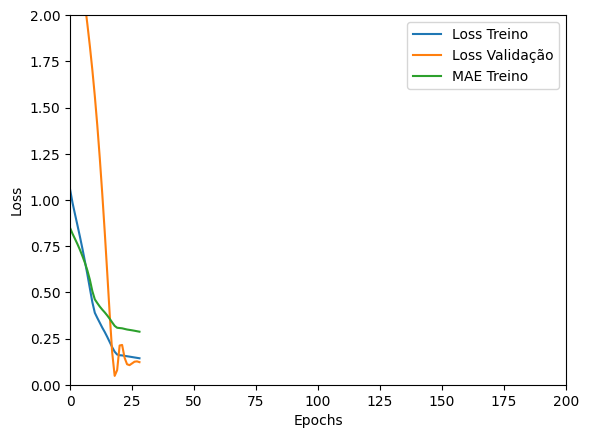

Tempo de treino: 0.12471604347229004 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15447279810905457 , MAE = 0.2949593961238861'

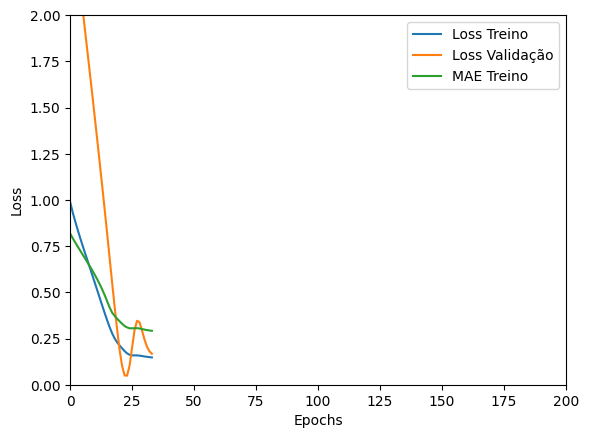

Tempo de treino: 0.08712728420893351 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14540037512779236 , MAE = 0.2856714129447937'

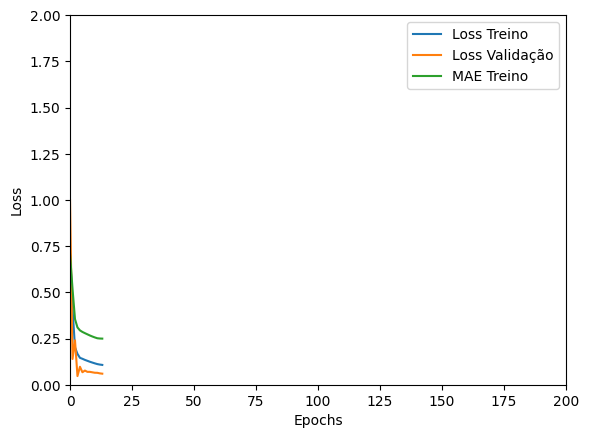

Tempo de treino: 0.08768166700998942 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14849424362182617 , MAE = 0.28829050064086914'

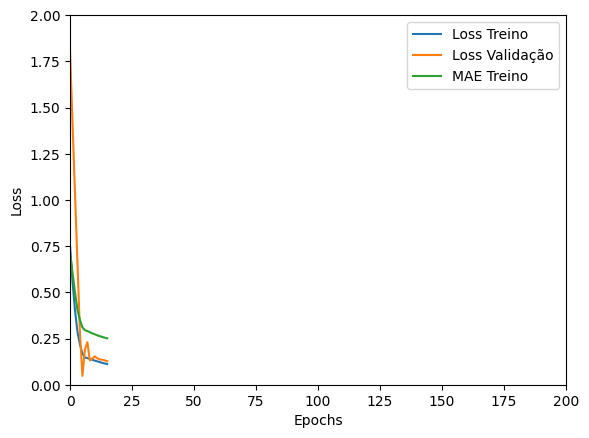

Tempo de treino: 0.08100618124008178 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1821628361940384 , MAE = 0.32295066118240356'

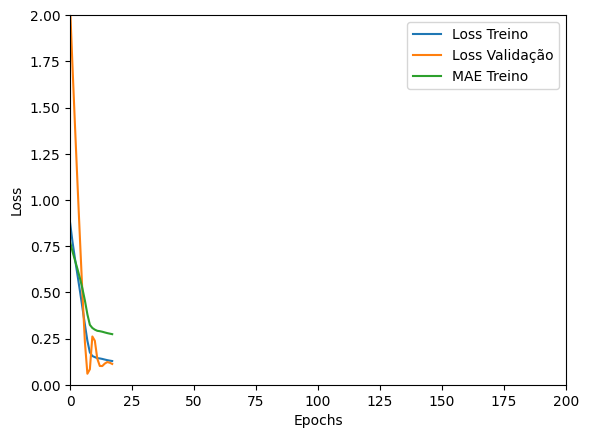

Tempo de treino: 0.08203381697336833 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14639653265476227 , MAE = 0.2937382161617279'

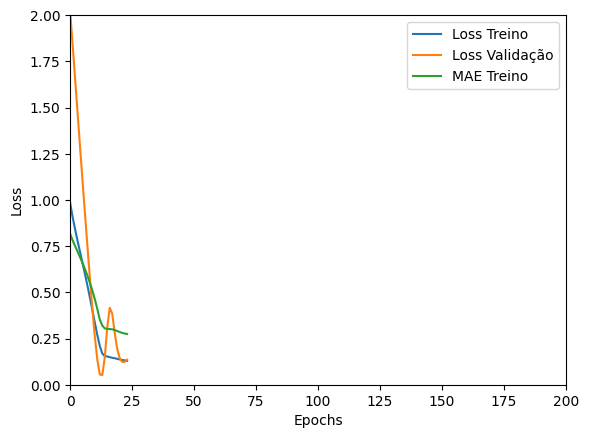

Tempo de treino: 0.07164112329483033 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=6, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2139105647802353 , MAE = 0.3579922020435333'

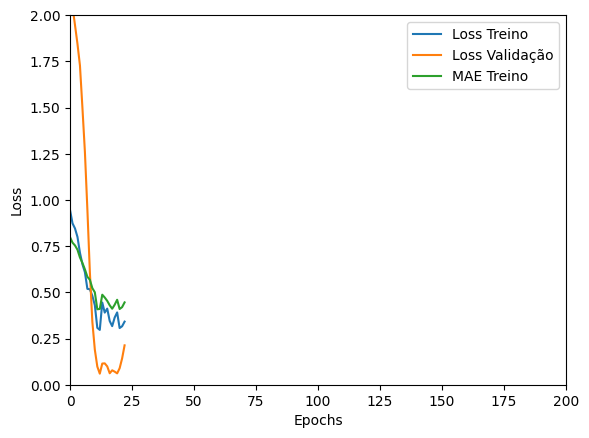

Tempo de treino: 0.12387286424636841 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4153696894645691 , MAE = 0.45487484335899353'

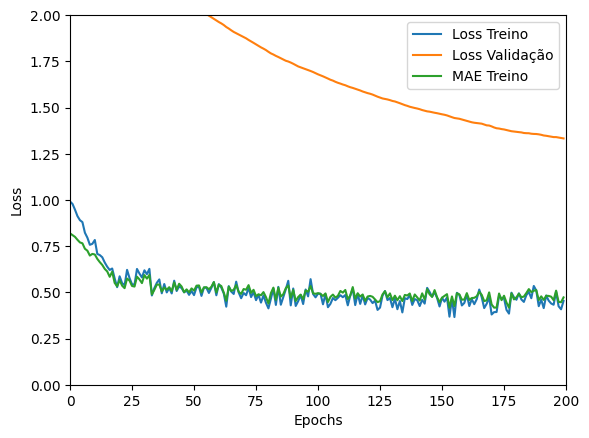

Tempo de treino: 0.7205190141995748 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23461470007896423 , MAE = 0.37313905358314514'

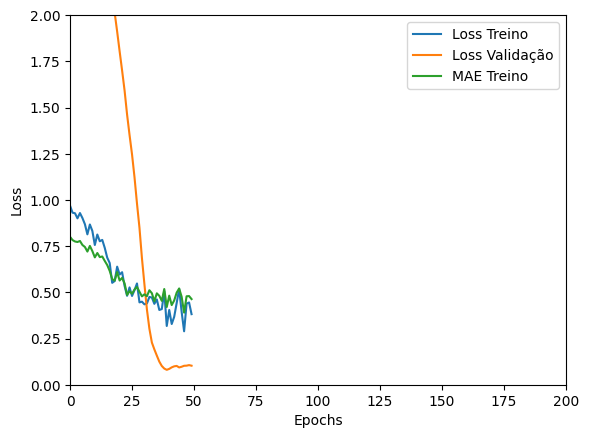

Tempo de treino: 0.1180189609527588 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5492856502532959 , MAE = 0.5645676255226135'

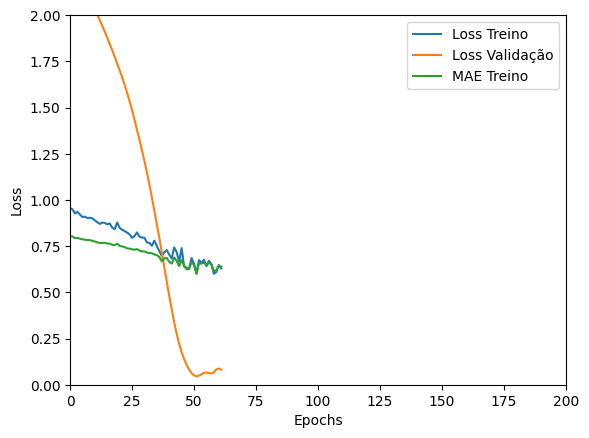

Tempo de treino: 0.1251044551531474 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2110680639743805 , MAE = 0.34761181473731995'

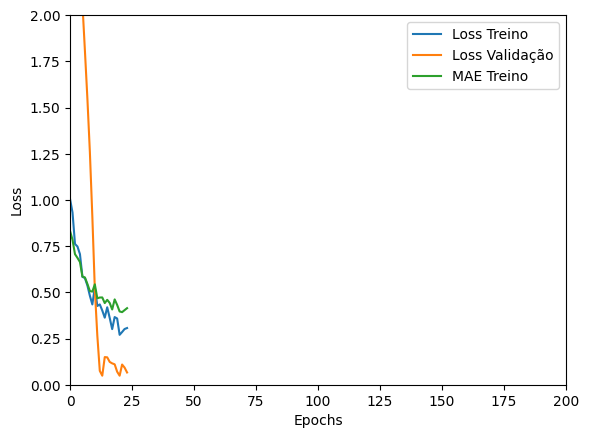

Tempo de treino: 0.12445188760757446 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16664797067642212 , MAE = 0.3048557639122009'

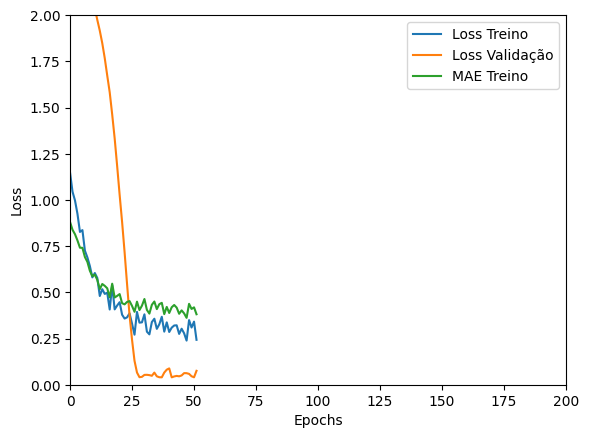

Tempo de treino: 0.1738008419672648 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32661494612693787 , MAE = 0.44346800446510315'

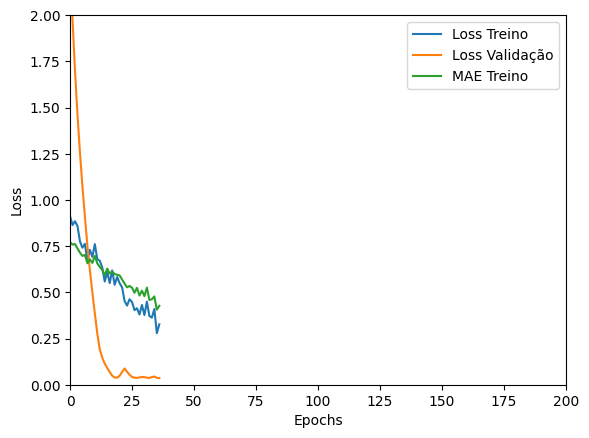

Tempo de treino: 0.12479812304178874 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15013854205608368 , MAE = 0.2935923933982849'

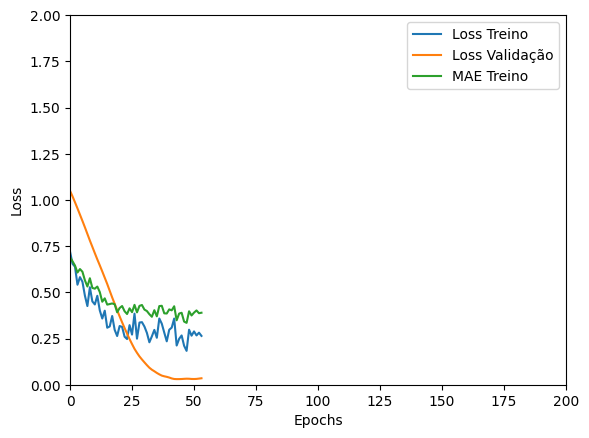

Tempo de treino: 0.09494418700536092 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12615254521369934 , MAE = 0.2684022784233093'

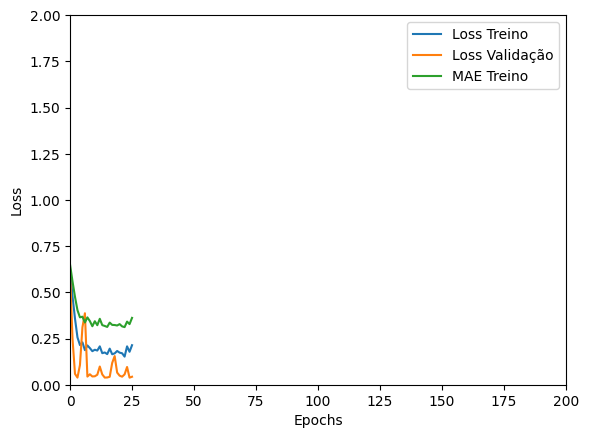

Tempo de treino: 0.20922275384267172 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12809360027313232 , MAE = 0.26753827929496765'

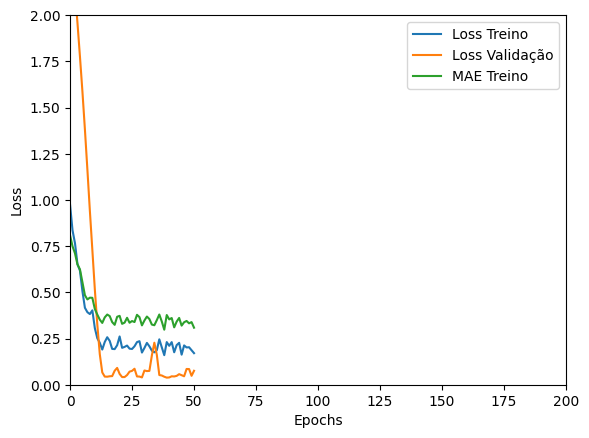

Tempo de treino: 0.20994266668955486 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15193398296833038 , MAE = 0.29487428069114685'

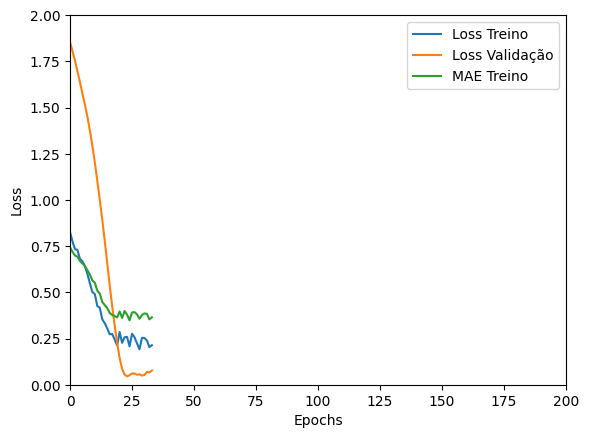

Tempo de treino: 0.12221856911977132 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14242444932460785 , MAE = 0.2793428599834442'

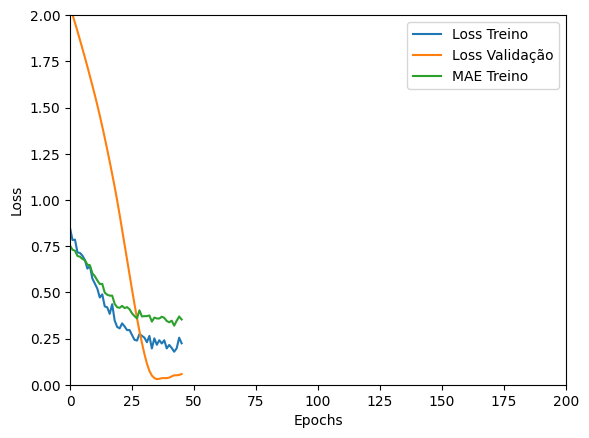

Tempo de treino: 0.11169369618097941 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12055136263370514 , MAE = 0.2543204128742218'

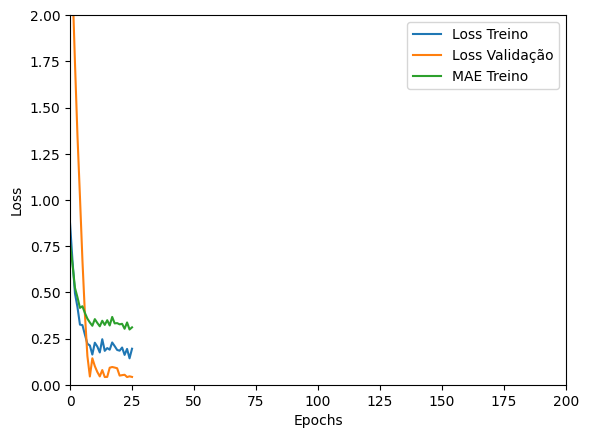

Tempo de treino: 0.14696491956710817 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11099850386381149 , MAE = 0.24270528554916382'

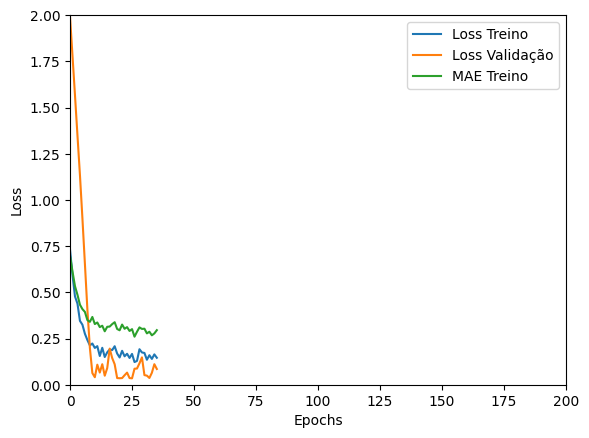

Tempo de treino: 0.12933046817779542 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2813386917114258 , MAE = 0.4138103425502777'

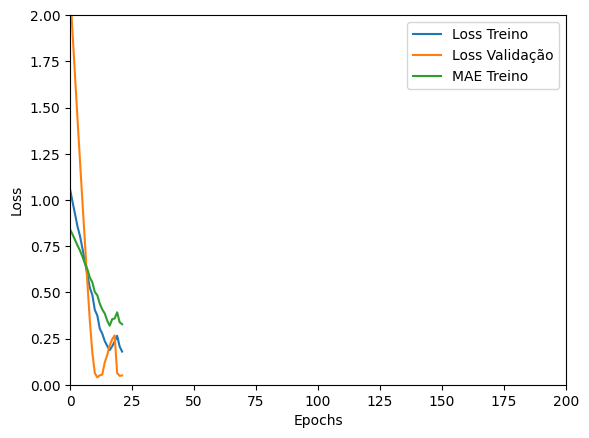

Tempo de treino: 0.08071328401565551 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14029356837272644 , MAE = 0.2802514433860779'

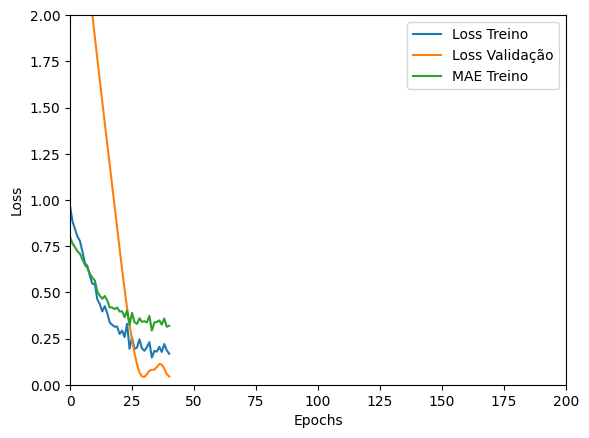

Tempo de treino: 0.12250171502431234 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12194845080375671 , MAE = 0.25945743918418884'

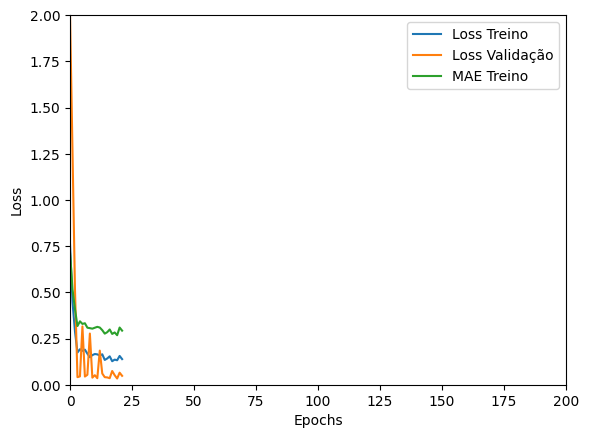

Tempo de treino: 0.11526002486546834 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12780748307704926 , MAE = 0.2691923975944519'

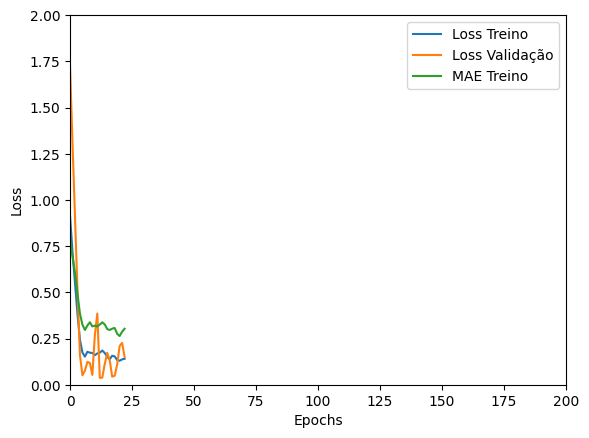

Tempo de treino: 0.13566032648086548 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13772213459014893 , MAE = 0.2787827253341675'

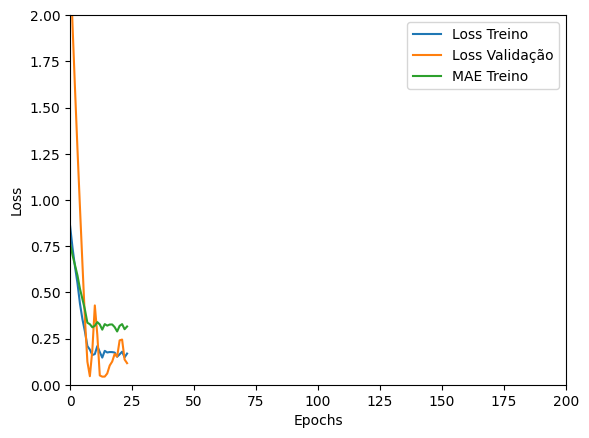

Tempo de treino: 0.08526099920272827 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1388004571199417 , MAE = 0.28044840693473816'

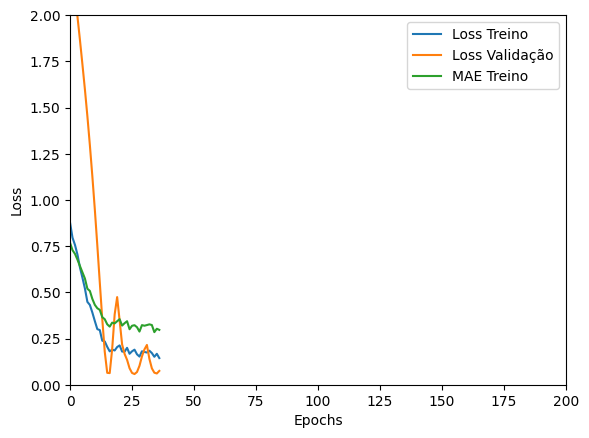

Tempo de treino: 0.13266712029774982 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com GRU_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0438484326004982 , MAE = 0.1605125516653061'

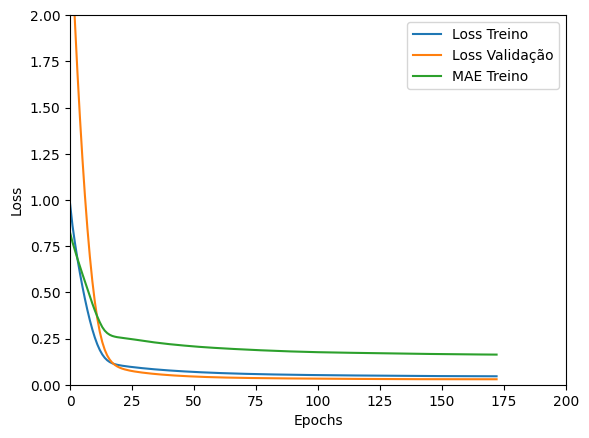

Tempo de treino: 0.7363217393557231 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.053264521062374115 , MAE = 0.17944221198558807'

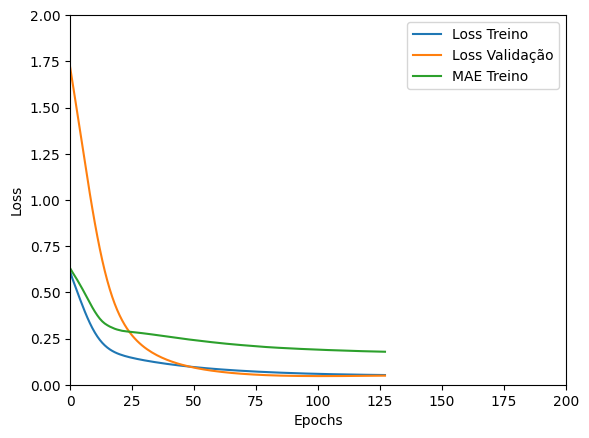

Tempo de treino: 0.3203997095425924 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06706070899963379 , MAE = 0.1967029720544815'

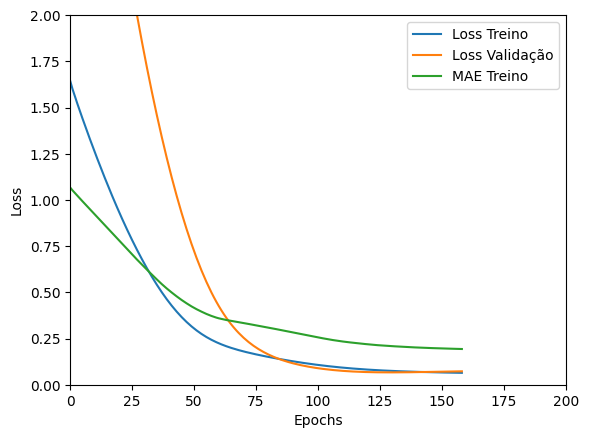

Tempo de treino: 0.2724660118420919 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06860224157571793 , MAE = 0.2102026790380478'

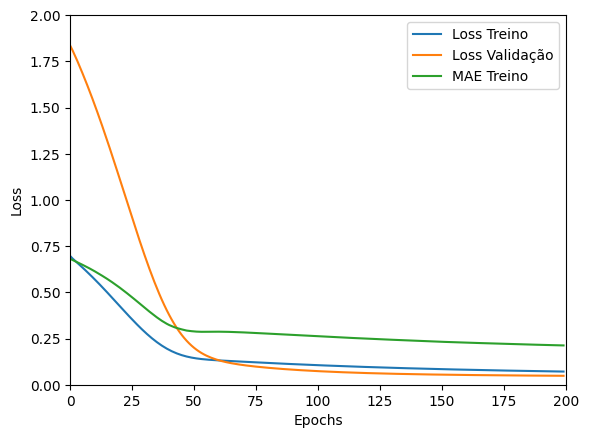

Tempo de treino: 0.31059343814849855 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04390515759587288 , MAE = 0.16049553453922272'

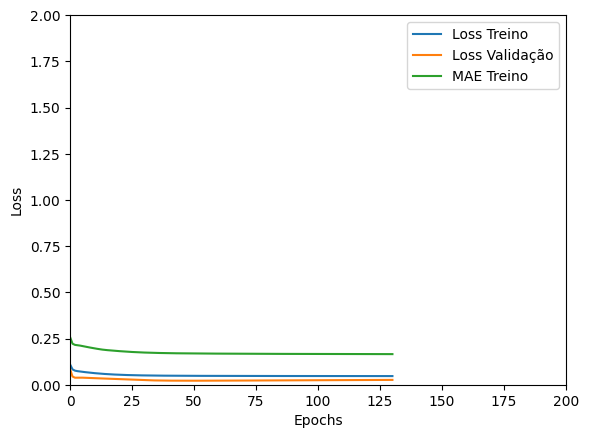

Tempo de treino: 0.7332611163457234 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0480942465364933 , MAE = 0.16831810772418976'

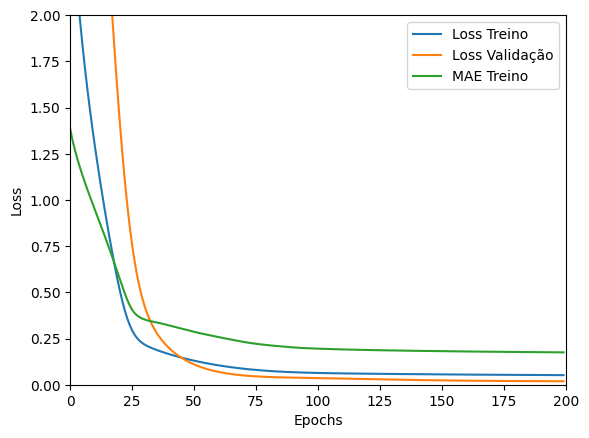

Tempo de treino: 0.7463053067525228 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.045749057084321976 , MAE = 0.16572867333889008'

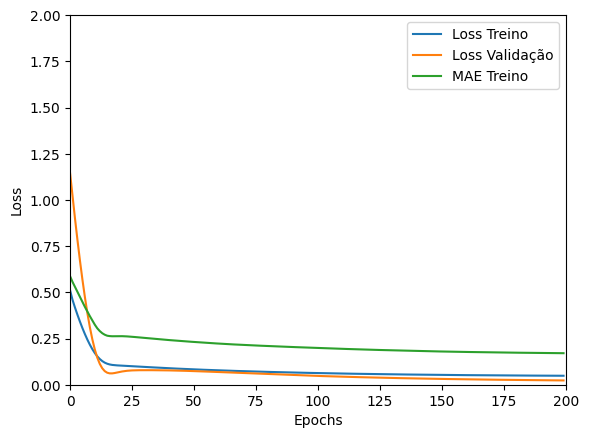

Tempo de treino: 0.3329370657602946 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04865561053156853 , MAE = 0.17146985232830048'

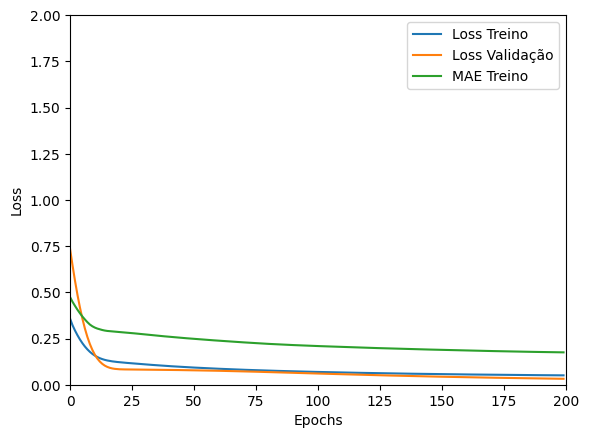

Tempo de treino: 0.29014861981074014 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04490246996283531 , MAE = 0.16296249628067017'

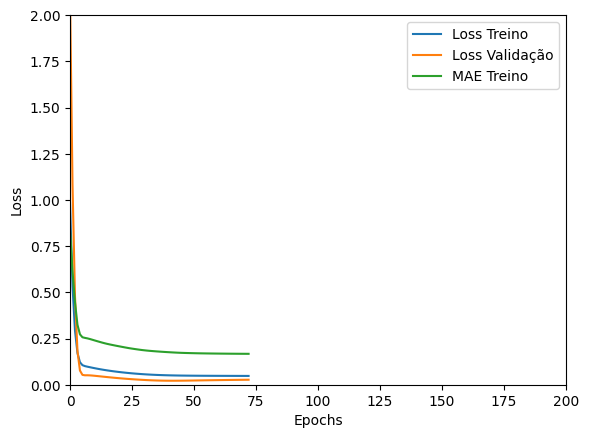

Tempo de treino: 0.3222793698310852 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04441884160041809 , MAE = 0.16151687502861023'

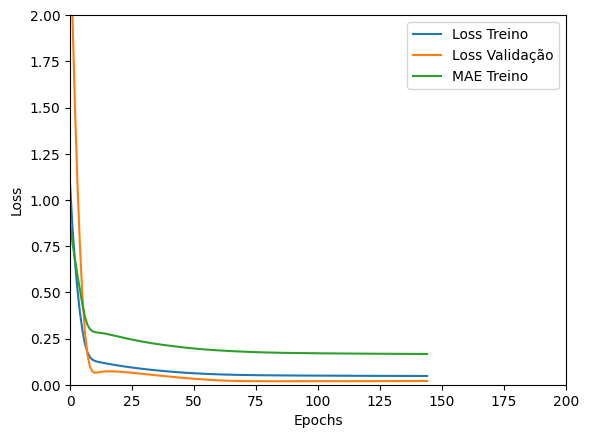

Tempo de treino: 0.35748664538065594 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1326071172952652 , MAE = 0.2943841516971588'

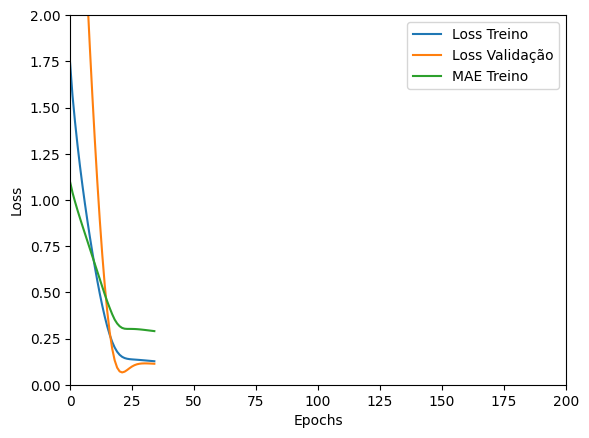

Tempo de treino: 0.13905429045359294 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.045922454446554184 , MAE = 0.16645602881908417'

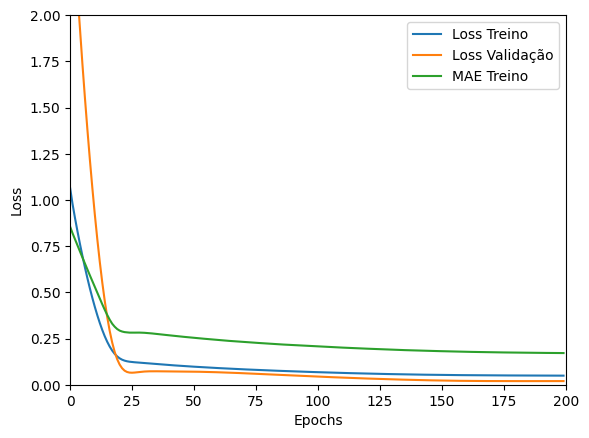

Tempo de treino: 0.2991955796877543 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.050249598920345306 , MAE = 0.1754753440618515'

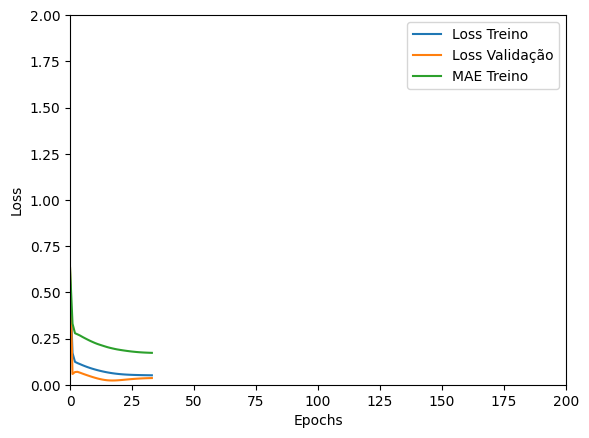

Tempo de treino: 0.23642335732777914 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04802343249320984 , MAE = 0.16802628338336945'

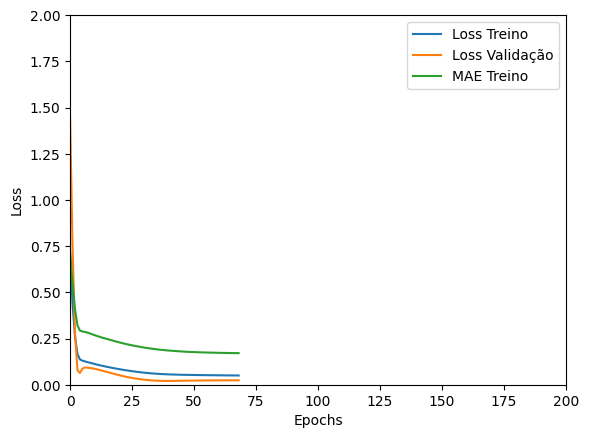

Tempo de treino: 0.2296206037203471 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13089142739772797 , MAE = 0.2873573899269104'

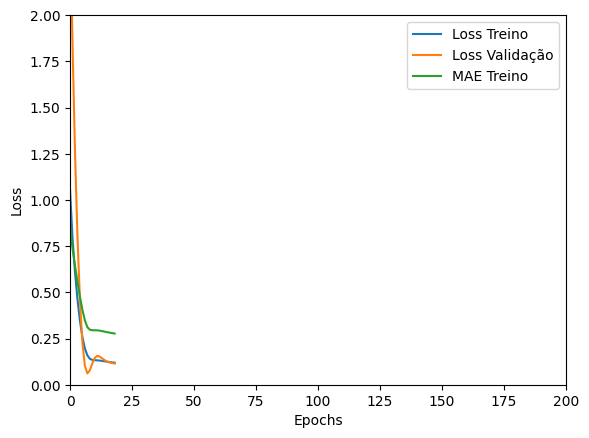

Tempo de treino: 0.08505523602167765 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1205701157450676 , MAE = 0.27424538135528564'

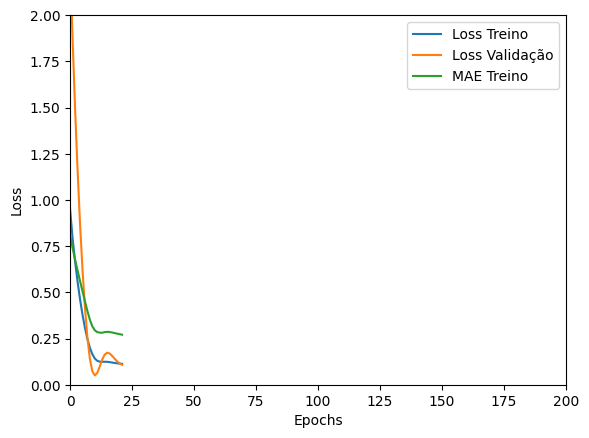

Tempo de treino: 0.15394822359085084 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07953710108995438 , MAE = 0.21941351890563965'

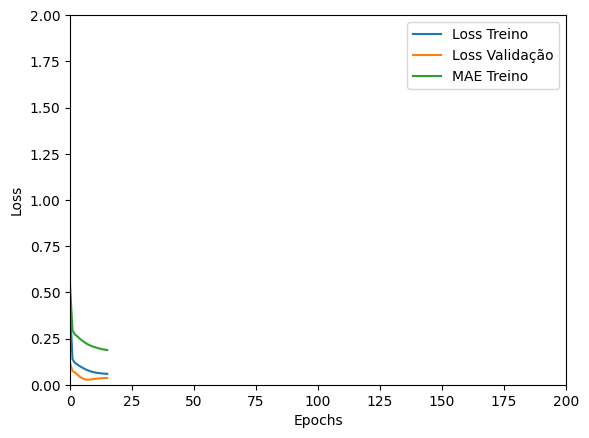

Tempo de treino: 0.13966904481252035 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.053945522755384445 , MAE = 0.1799946427345276'

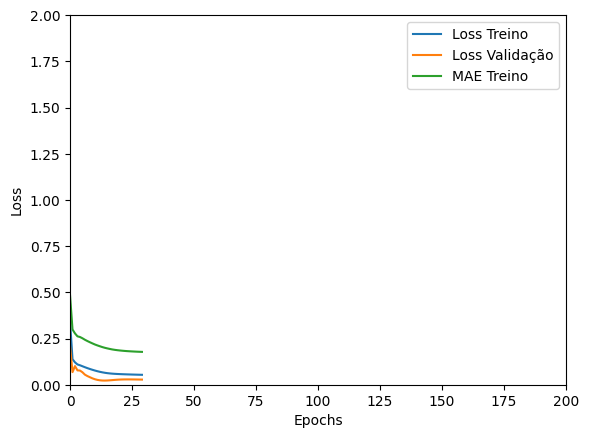

Tempo de treino: 0.14190390904744465 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15087439119815826 , MAE = 0.30457940697669983'

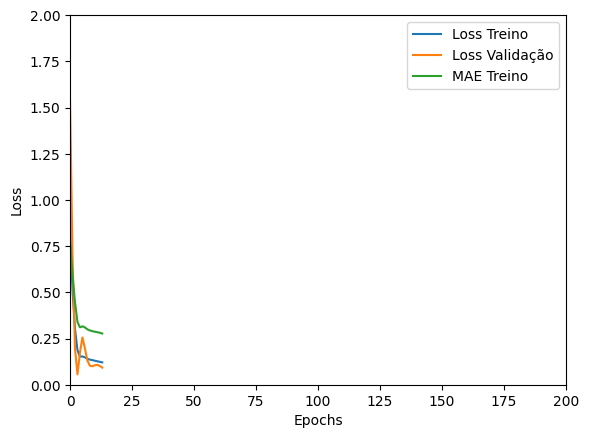

Tempo de treino: 0.08919370571772257 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13108022511005402 , MAE = 0.2825761139392853'

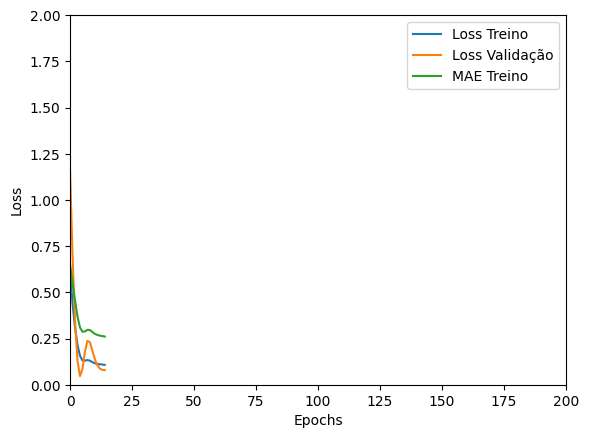

Tempo de treino: 0.11252634525299073 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15380080044269562 , MAE = 0.2698451578617096'

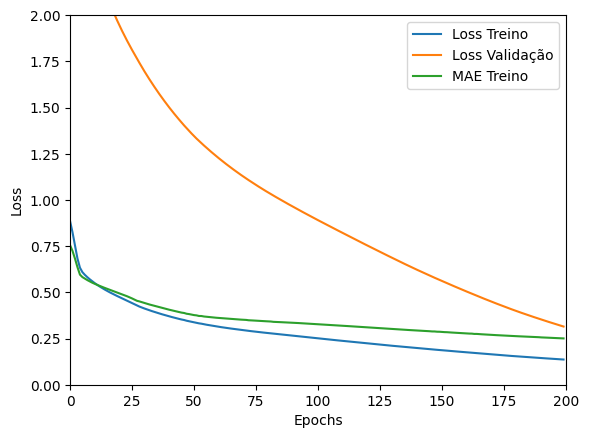

Tempo de treino: 0.6026742855707804 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10516770929098129 , MAE = 0.25797519087791443'

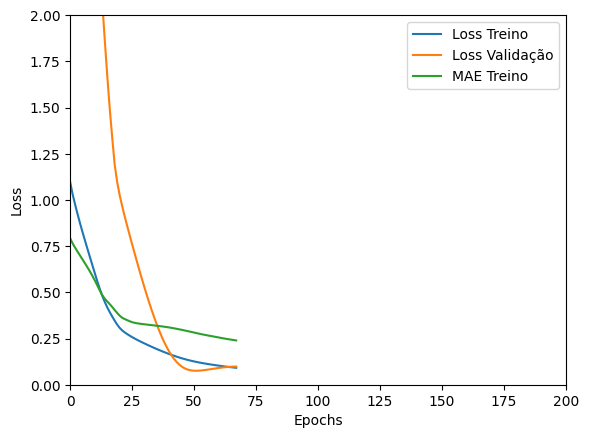

Tempo de treino: 0.2013881762822469 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39657461643218994 , MAE = 0.4230063557624817'

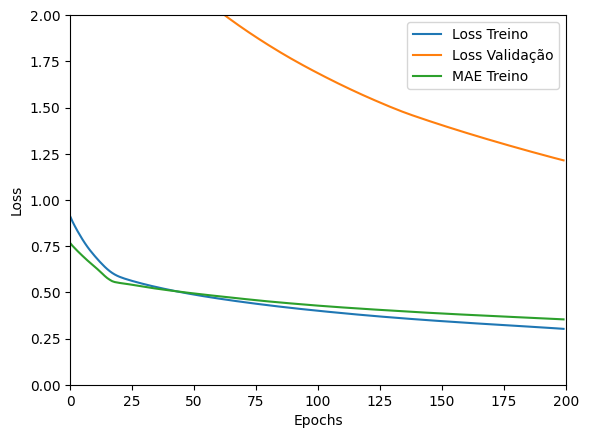

Tempo de treino: 0.2733876705169678 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.644046425819397 , MAE = 0.6326877474784851'

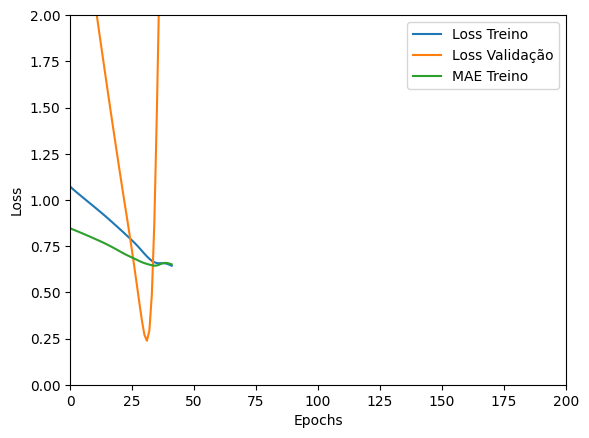

Tempo de treino: 0.09914930661519368 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09074623137712479 , MAE = 0.2270258069038391'

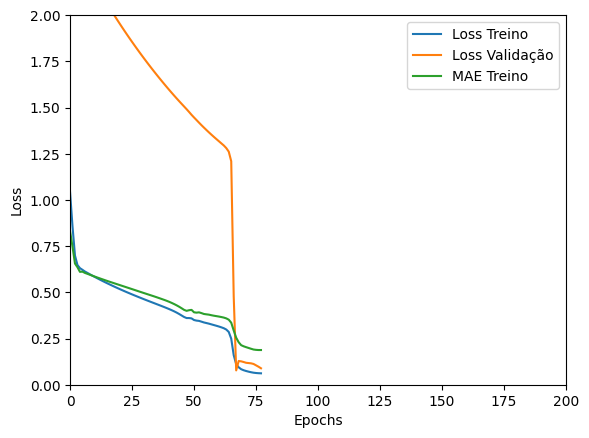

Tempo de treino: 0.25059208075205486 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21878208220005035 , MAE = 0.3677853047847748'

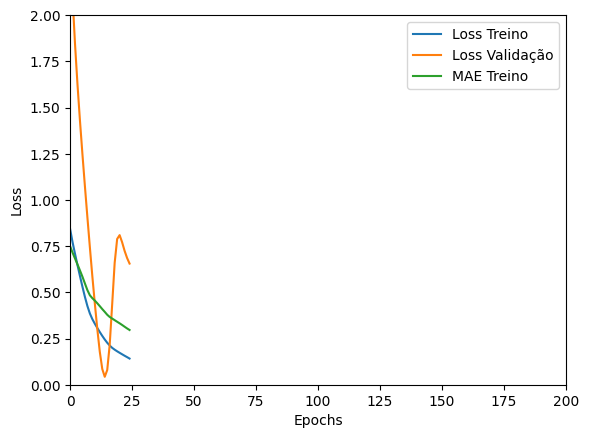

Tempo de treino: 0.07461299896240234 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14240439236164093 , MAE = 0.2828587591648102'

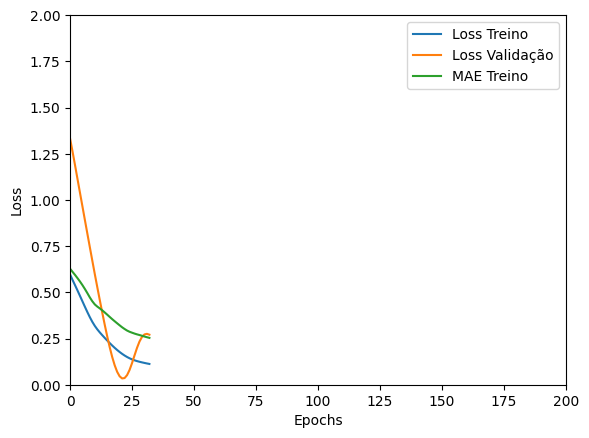

Tempo de treino: 0.10815320412317912 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3104833960533142 , MAE = 0.428749144077301'

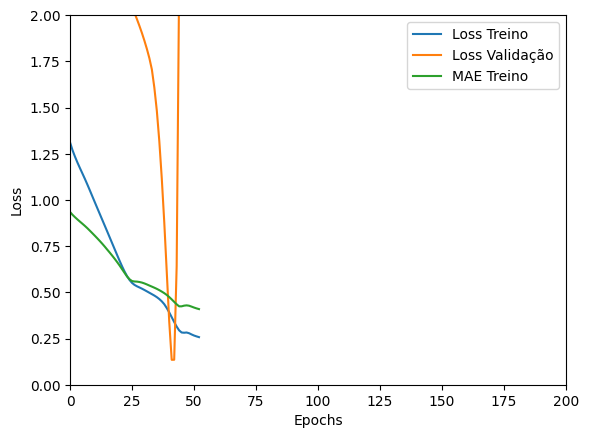

Tempo de treino: 0.127708633740743 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20759637653827667 , MAE = 0.33115825057029724'

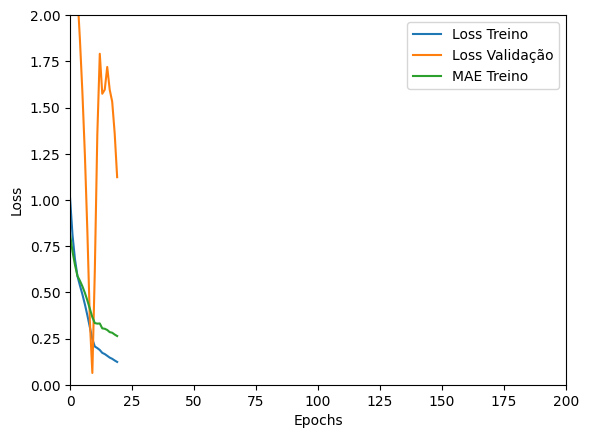

Tempo de treino: 0.09850203196207682 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20857776701450348 , MAE = 0.3415949046611786'

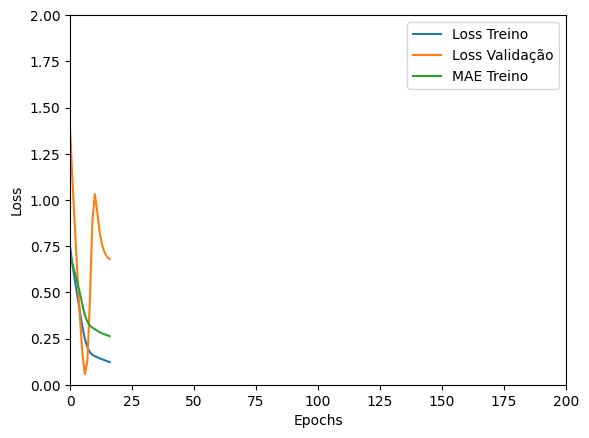

Tempo de treino: 0.07341626882553101 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2281934767961502 , MAE = 0.3341000974178314'

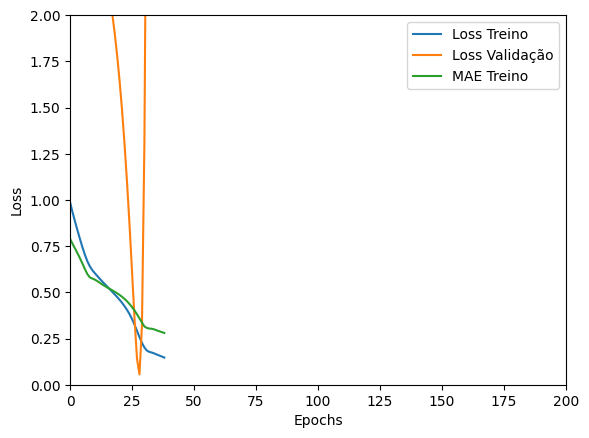

Tempo de treino: 0.12103533347447713 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5610558986663818 , MAE = 0.5867800116539001'

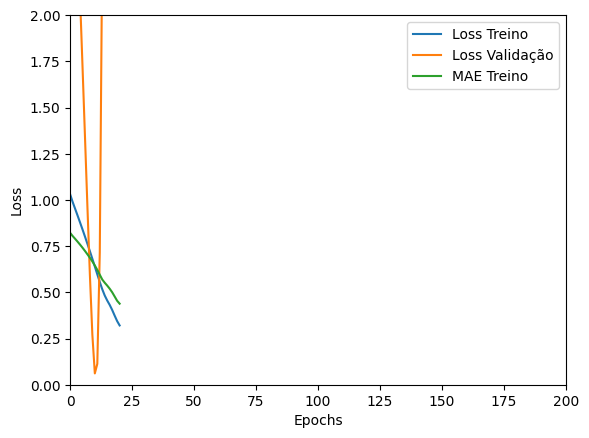

Tempo de treino: 0.07897920608520508 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0742267370223999 , MAE = 0.20869514346122742'

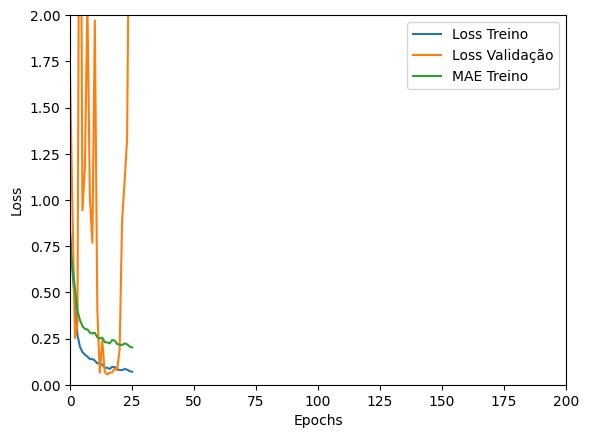

Tempo de treino: 0.20514169136683147 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2354491651058197 , MAE = 0.36709415912628174'

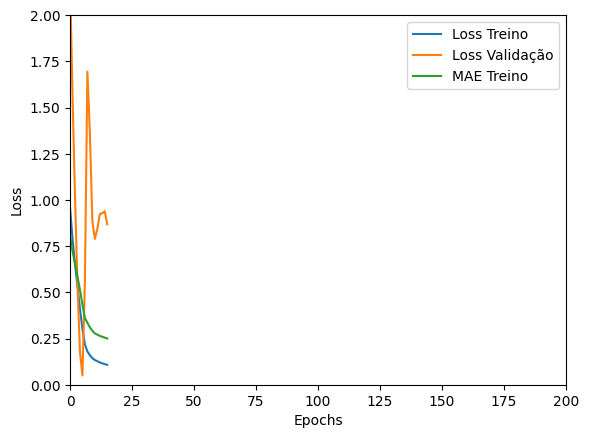

Tempo de treino: 0.09013555447260539 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2568015456199646 , MAE = 0.3919166922569275'

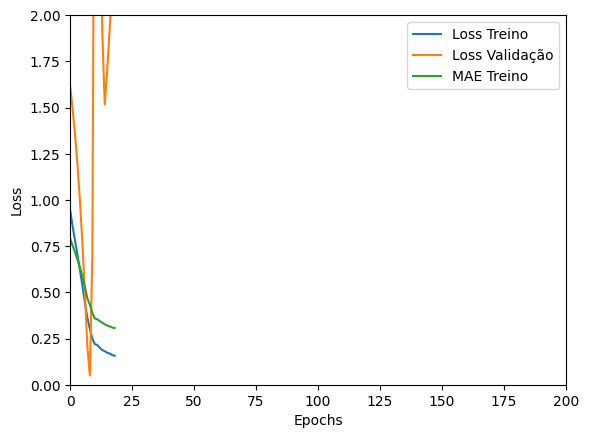

Tempo de treino: 0.06598764657974243 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29733482003211975 , MAE = 0.4205009639263153'

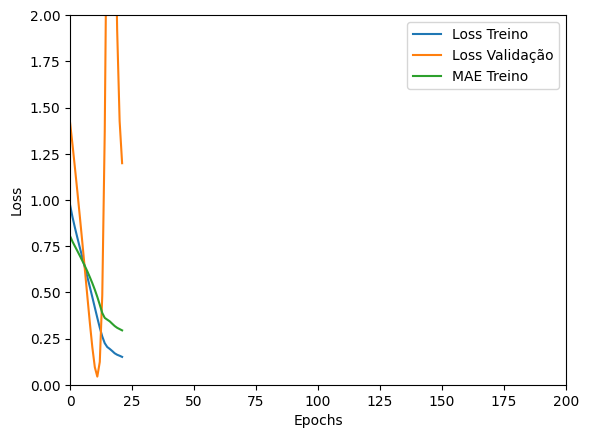

Tempo de treino: 0.07090924183527629 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27206242084503174 , MAE = 0.3822551667690277'

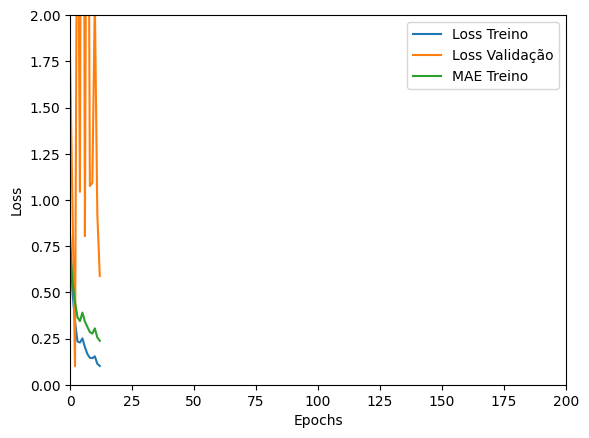

Tempo de treino: 0.09494214057922364 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3181031346321106 , MAE = 0.43058523535728455'

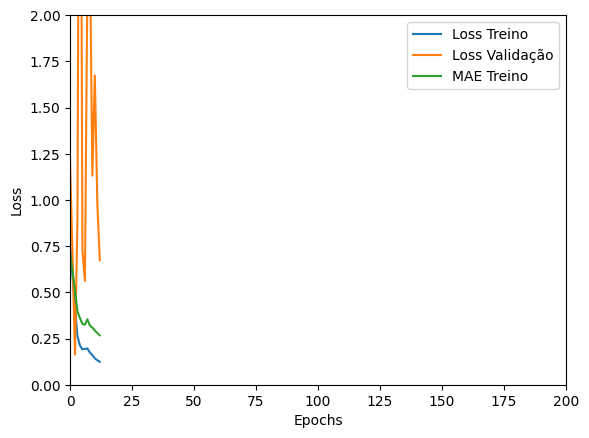

Tempo de treino: 0.07309072415033976 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2397732436656952 , MAE = 0.3507370352745056'

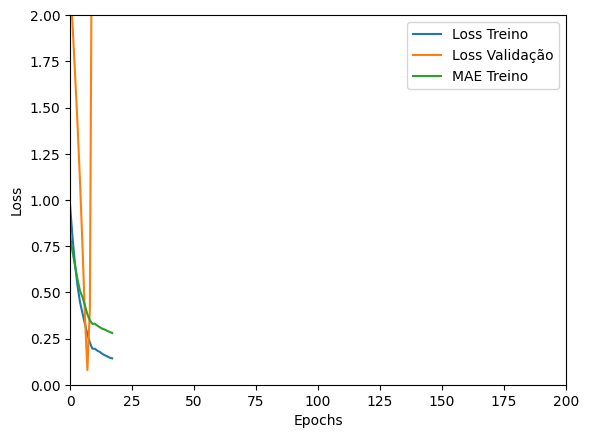

Tempo de treino: 0.07625316381454468 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2649388909339905 , MAE = 0.38846680521965027'

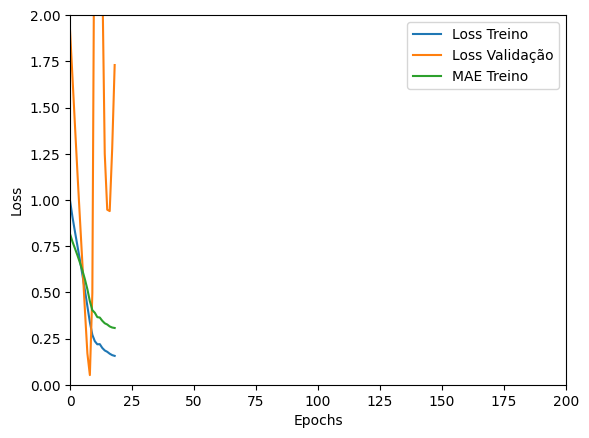

Tempo de treino: 0.06557109753290812 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=12, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20324590802192688 , MAE = 0.3541059195995331'

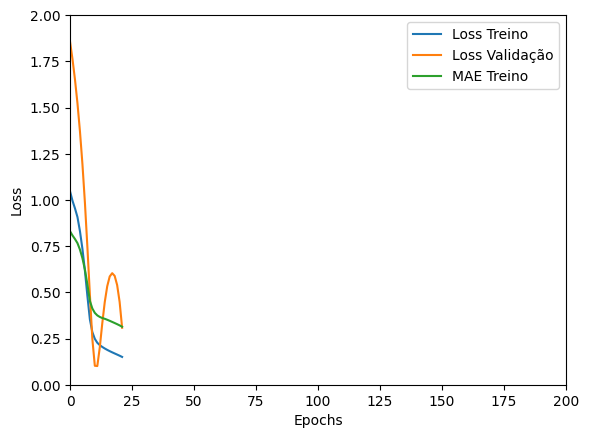

Tempo de treino: 0.087693719069163 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08229979872703552 , MAE = 0.21623188257217407'

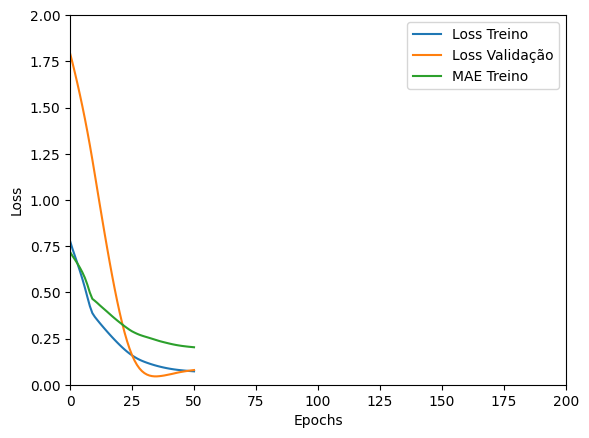

Tempo de treino: 0.2345850149790446 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4004841446876526 , MAE = 0.4678747355937958'

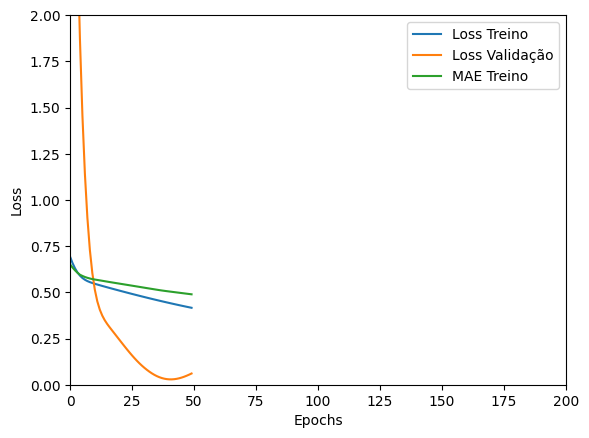

Tempo de treino: 0.1264670769373576 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5919814109802246 , MAE = 0.5895057320594788'

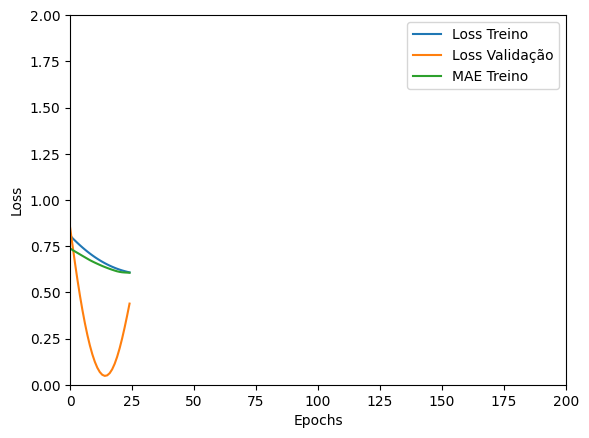

Tempo de treino: 0.0826153039932251 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7720595002174377 , MAE = 0.6755825877189636'

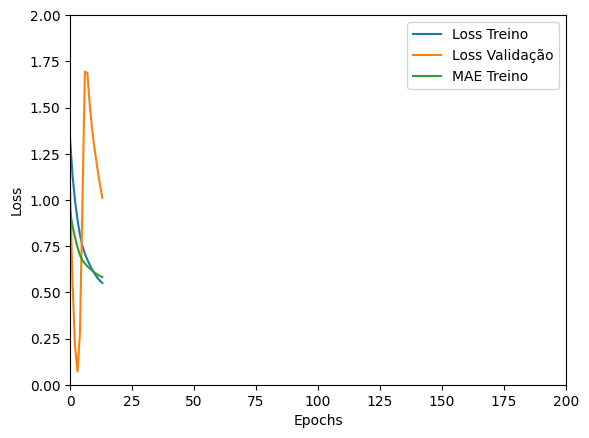

Tempo de treino: 0.08195823431015015 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15447348356246948 , MAE = 0.28919291496276855'

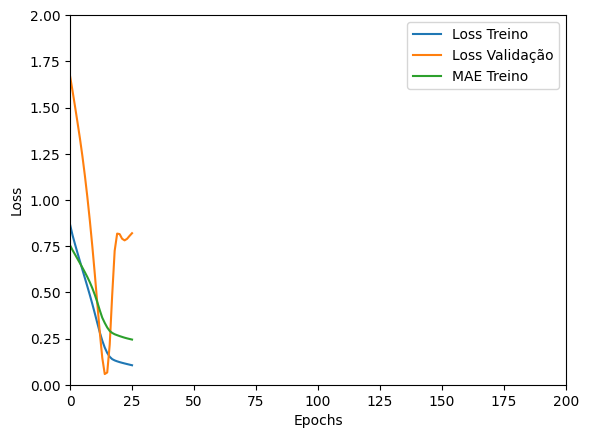

Tempo de treino: 0.11868913173675537 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40410226583480835 , MAE = 0.4888659119606018'

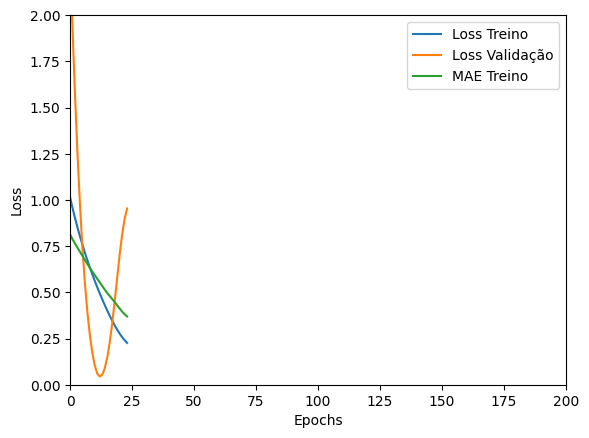

Tempo de treino: 0.07311238447825114 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17582814395427704 , MAE = 0.29738563299179077'

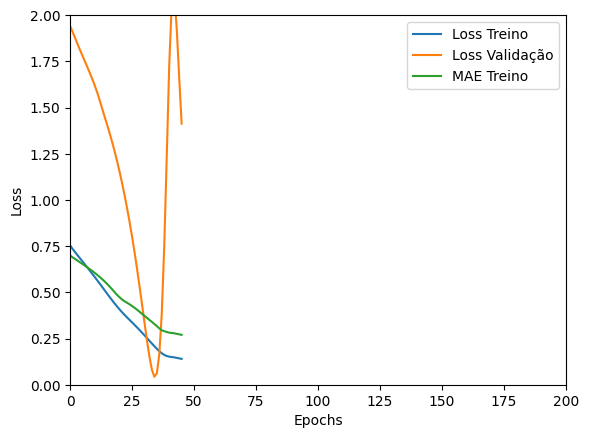

Tempo de treino: 0.08628644148508707 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38969686627388 , MAE = 0.48480337858200073'

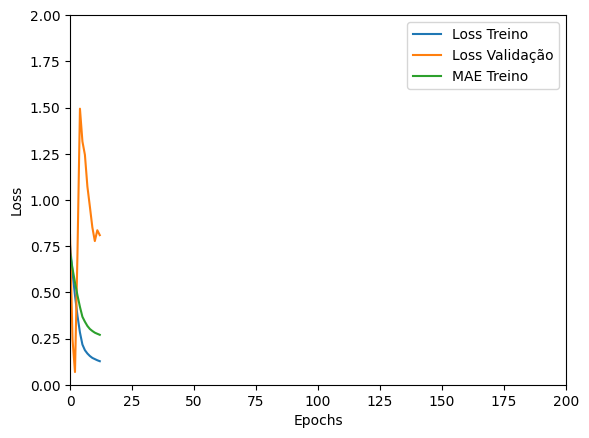

Tempo de treino: 0.10307121674219767 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09068787842988968 , MAE = 0.22470587491989136'

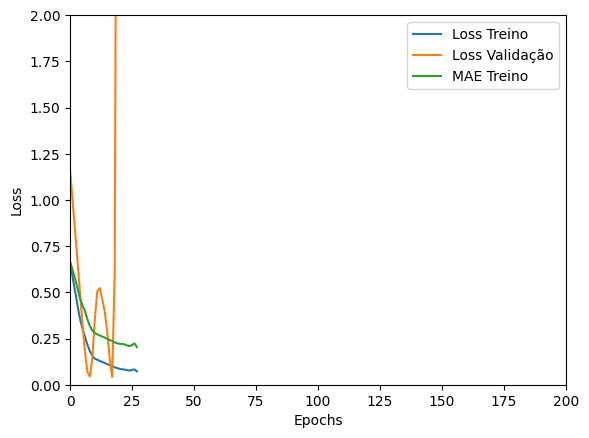

Tempo de treino: 0.08818897803624472 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40546363592147827 , MAE = 0.4981380105018616'

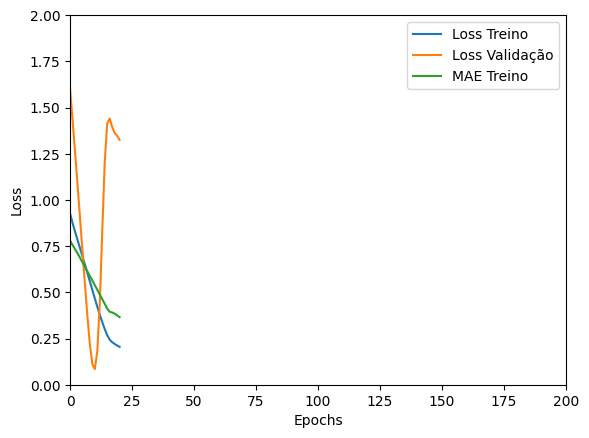

Tempo de treino: 0.06820657650629679 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2310134321451187 , MAE = 0.3515474498271942'

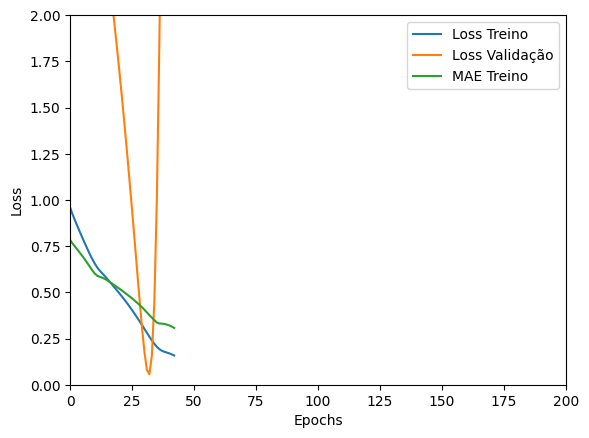

Tempo de treino: 0.13151882489522299 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08064756542444229 , MAE = 0.20987781882286072'

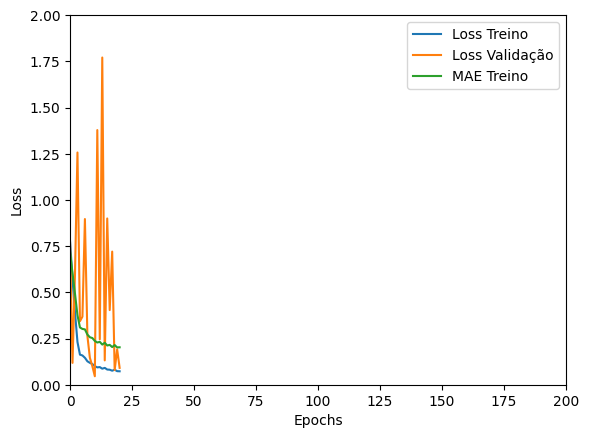

Tempo de treino: 0.11212376753489177 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25227728486061096 , MAE = 0.37237778306007385'

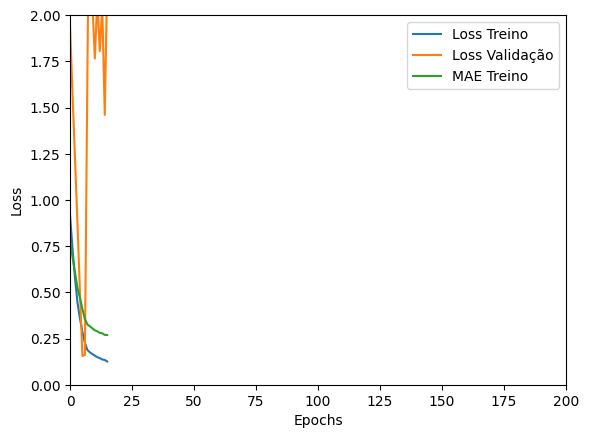

Tempo de treino: 0.06541144847869873 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39063066244125366 , MAE = 0.4846094250679016'

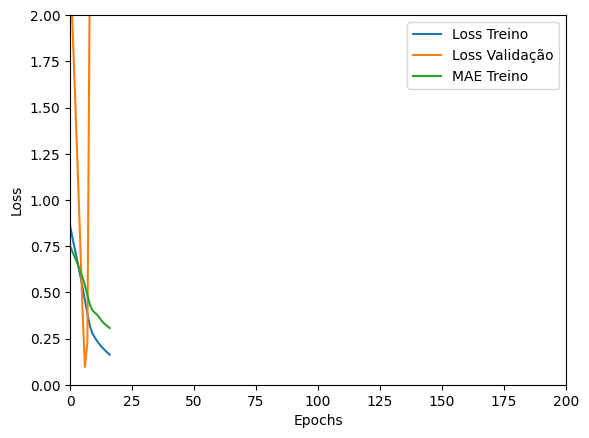

Tempo de treino: 0.0553141196568807 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3550238013267517 , MAE = 0.4624679684638977'

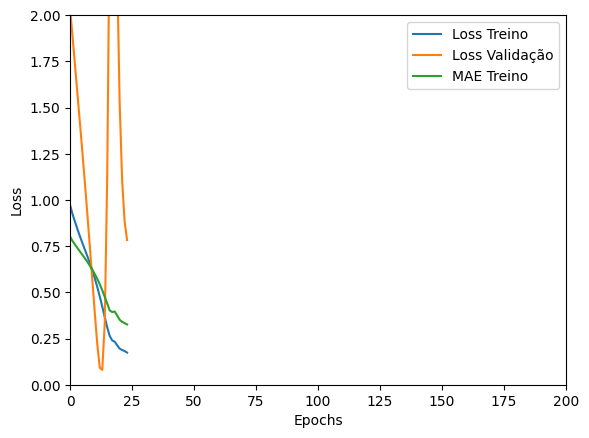

Tempo de treino: 0.09501791000366211 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23201942443847656 , MAE = 0.36209654808044434'

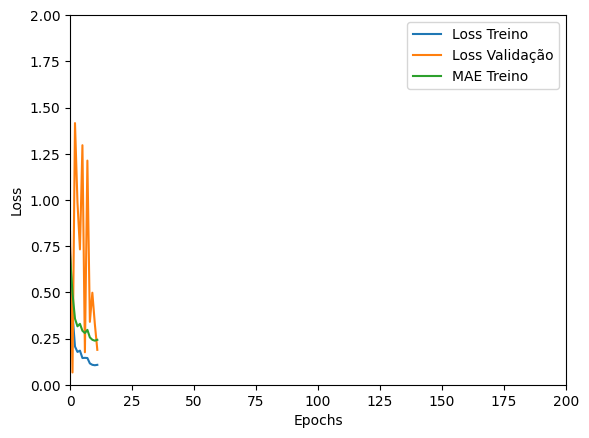

Tempo de treino: 0.12221699555714925 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2882631719112396 , MAE = 0.39771145582199097'

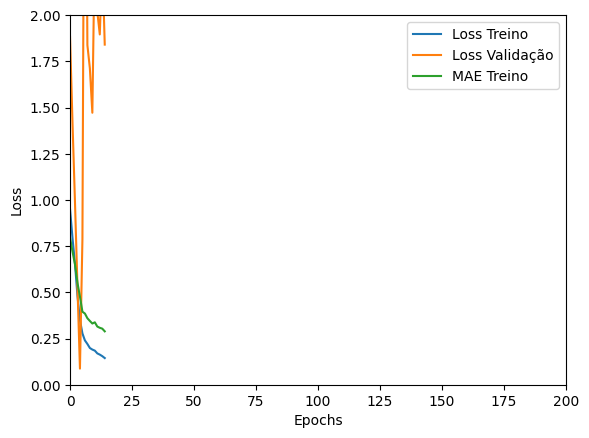

Tempo de treino: 0.08278812170028686 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2992202341556549 , MAE = 0.4176420271396637'

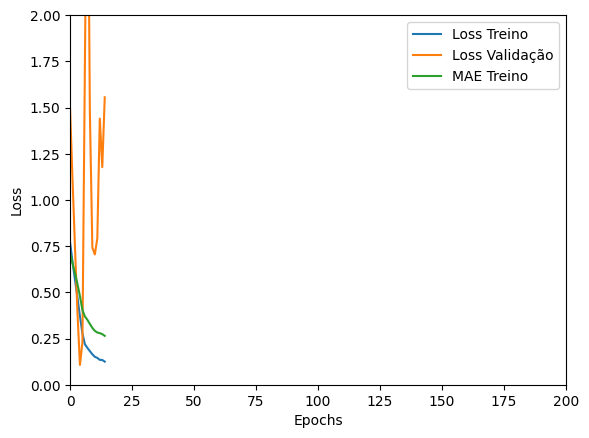

Tempo de treino: 0.07438087860743205 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2545507848262787 , MAE = 0.3828420042991638'

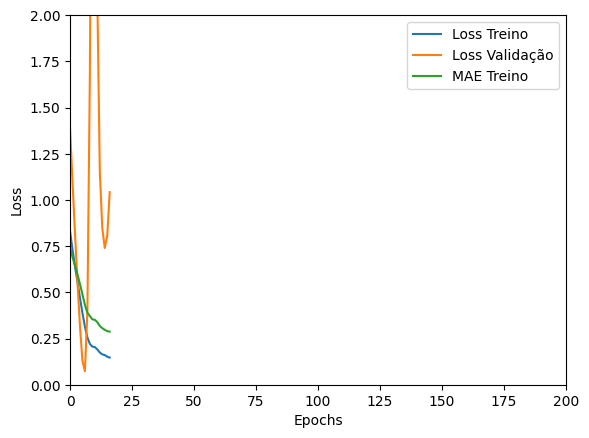

Tempo de treino: 0.08259443839391073 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=12, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5282891392707825 , MAE = 0.5507563352584839'

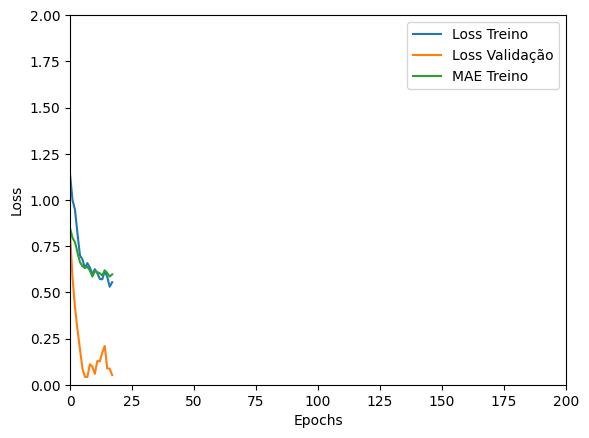

Tempo de treino: 0.12578641176223754 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.42424407601356506 , MAE = 0.45441192388534546'

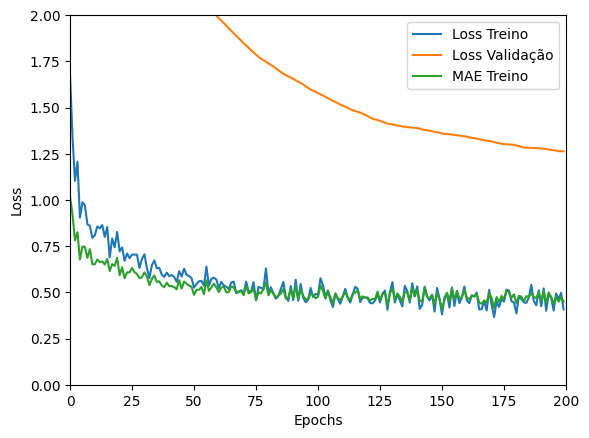

Tempo de treino: 0.7173178394635519 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17381583154201508 , MAE = 0.3240971565246582'

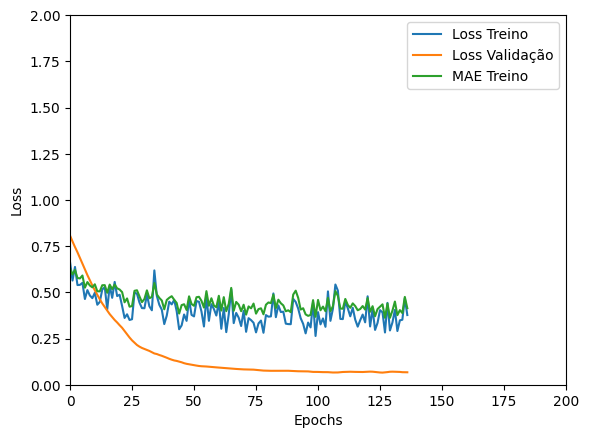

Tempo de treino: 0.19409710963567098 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31485795974731445 , MAE = 0.4224041998386383'

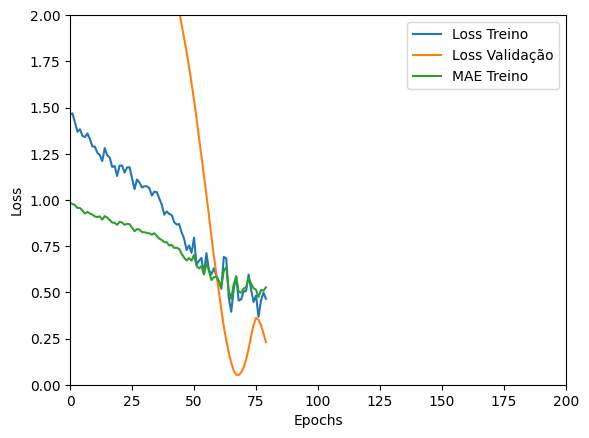

Tempo de treino: 0.235595174630483 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13019177317619324 , MAE = 0.2748401463031769'

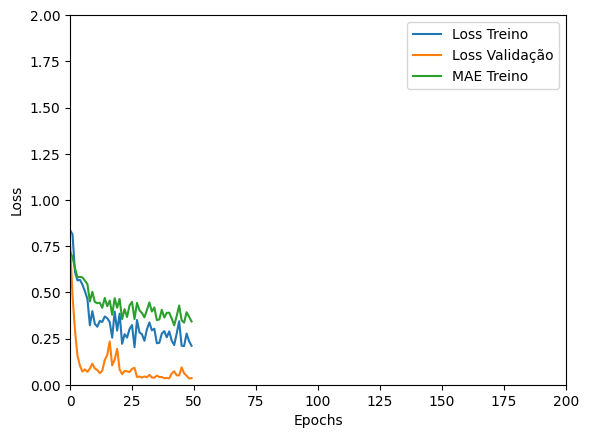

Tempo de treino: 0.19592498143513998 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13876277208328247 , MAE = 0.2777804434299469'

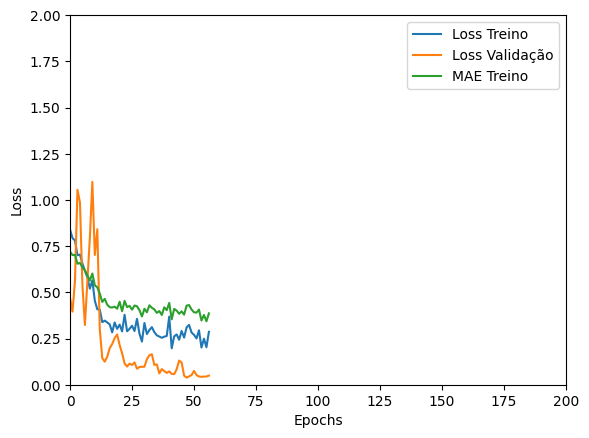

Tempo de treino: 0.13953408002853393 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1984938234090805 , MAE = 0.32290220260620117'

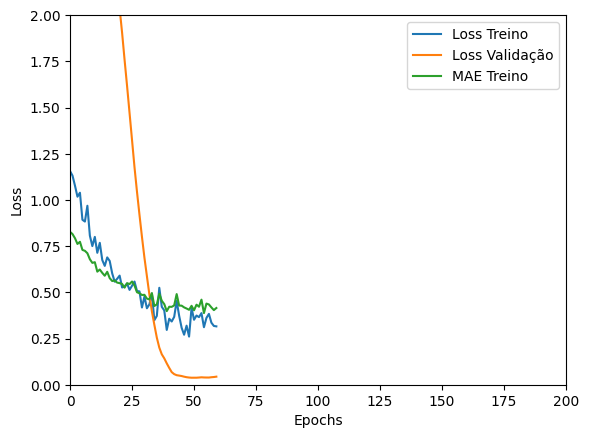

Tempo de treino: 0.21393804947535197 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19110025465488434 , MAE = 0.3259216248989105'

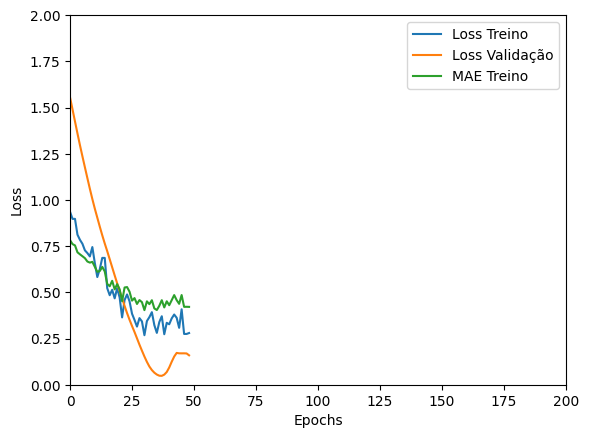

Tempo de treino: 0.14116998513539633 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25858139991760254 , MAE = 0.36946800351142883'

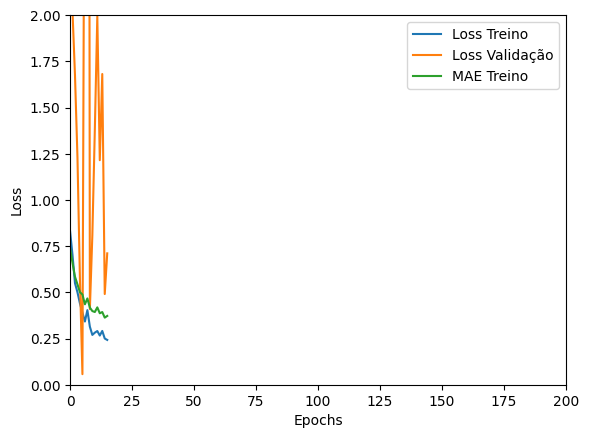

Tempo de treino: 0.11875988642374674 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21850179135799408 , MAE = 0.35076195001602173'

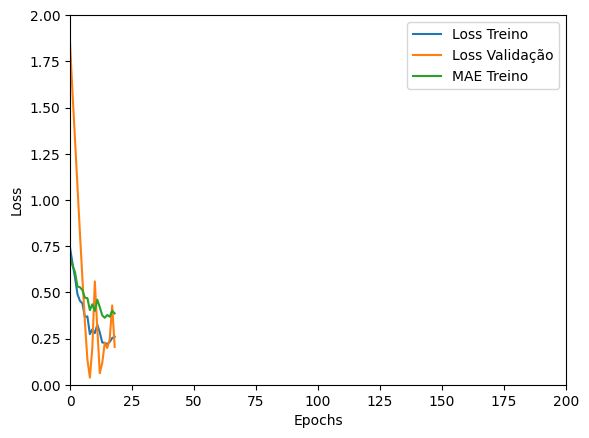

Tempo de treino: 0.06705268621444702 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38791918754577637 , MAE = 0.46814265847206116'

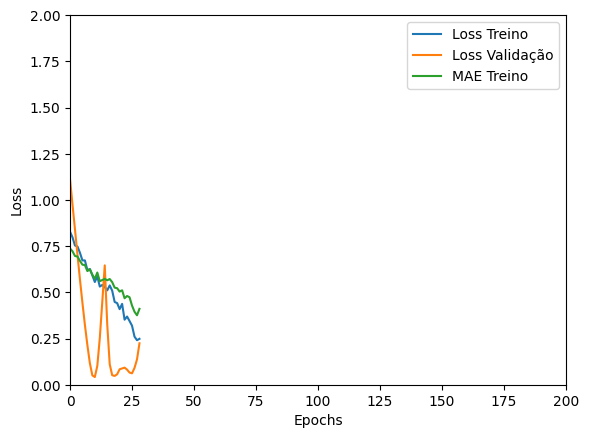

Tempo de treino: 0.10751866499582927 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1974094957113266 , MAE = 0.330838680267334'

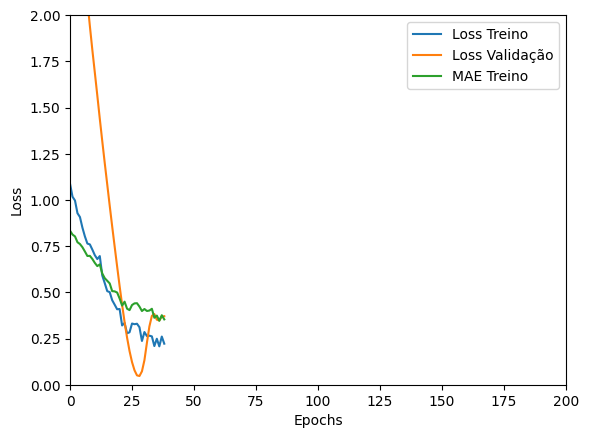

Tempo de treino: 0.10714451869328817 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.365286260843277 , MAE = 0.46570590138435364'

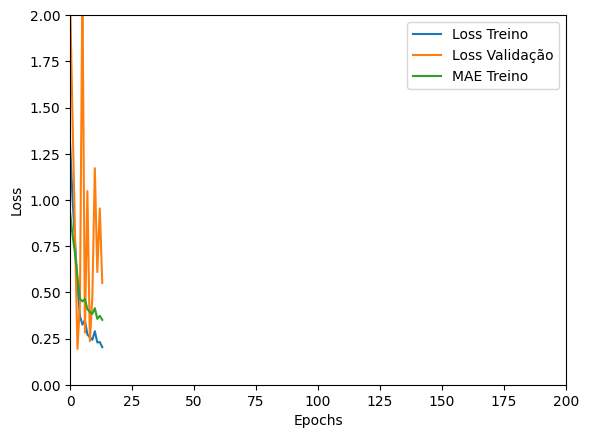

Tempo de treino: 0.08614641427993774 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2824758291244507 , MAE = 0.40207937359809875'

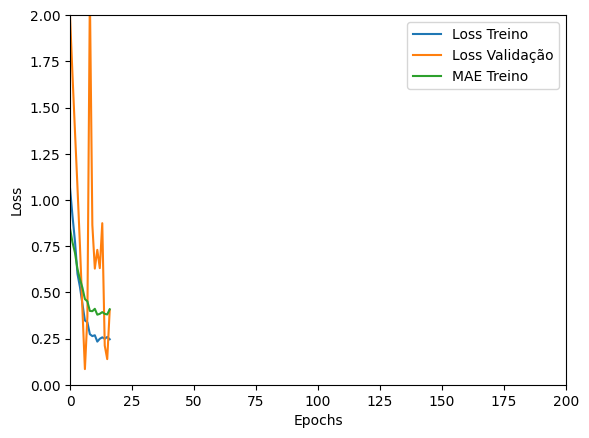

Tempo de treino: 0.08491617441177368 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22752495110034943 , MAE = 0.34884369373321533'

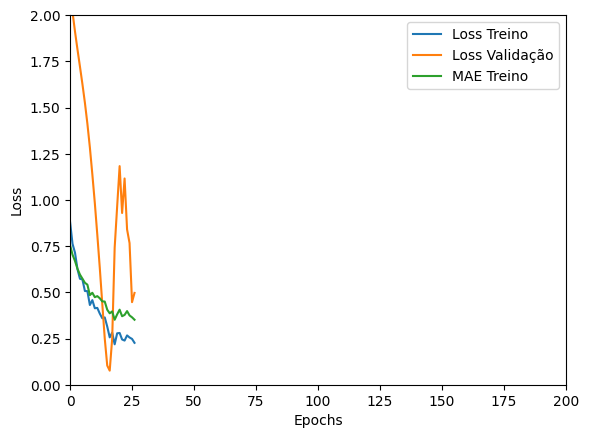

Tempo de treino: 0.07572364807128906 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23437322676181793 , MAE = 0.3449244499206543'

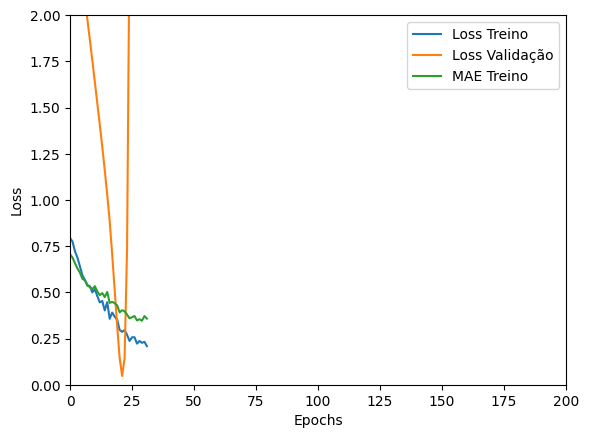

Tempo de treino: 0.12364217440287271 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2333296537399292 , MAE = 0.35111454129219055'

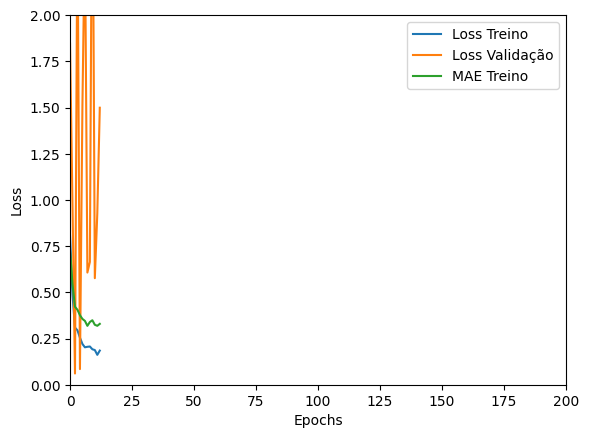

Tempo de treino: 0.07954323689142863 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3897964656352997 , MAE = 0.4905164837837219'

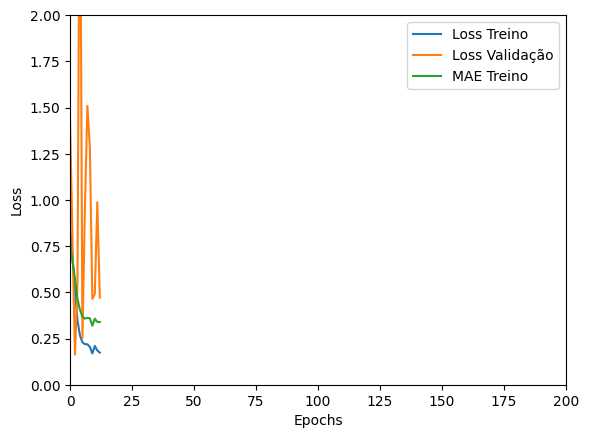

Tempo de treino: 0.09525182247161865 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24177925288677216 , MAE = 0.3621309697628021'

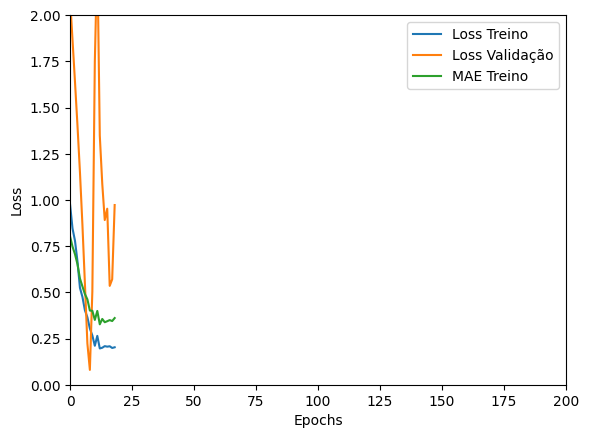

Tempo de treino: 0.07125432093938192 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.257079154253006 , MAE = 0.38489830493927'

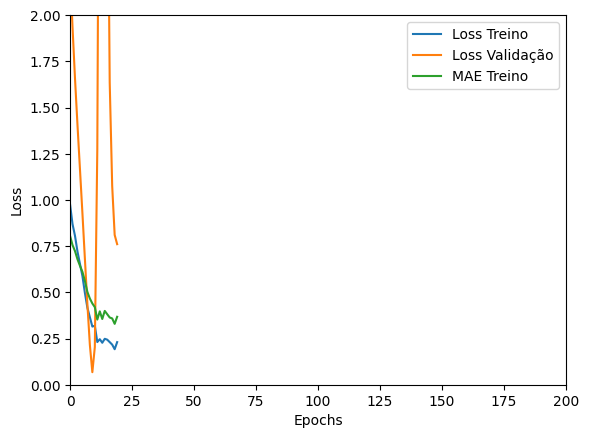

Tempo de treino: 0.07441409826278686 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com GRU_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04932115226984024 , MAE = 0.17245954275131226'

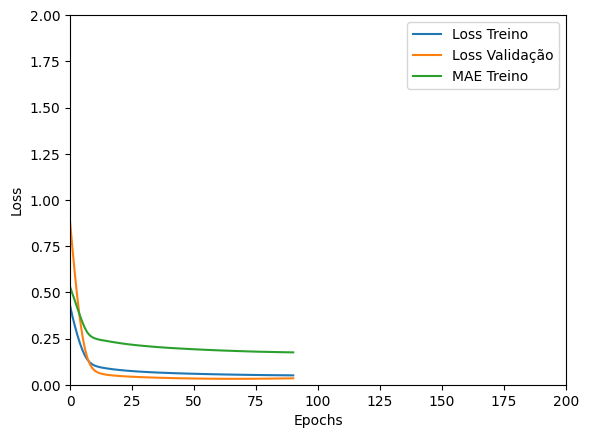

Tempo de treino: 0.3452313542366028 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.052040424197912216 , MAE = 0.1757921427488327'

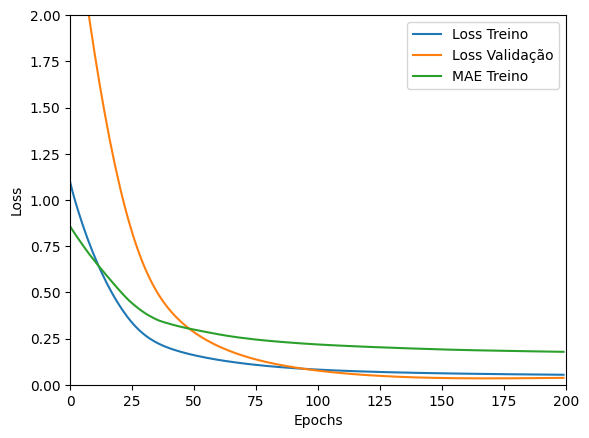

Tempo de treino: 0.7245437184969584 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0709259957075119 , MAE = 0.20983466506004333'

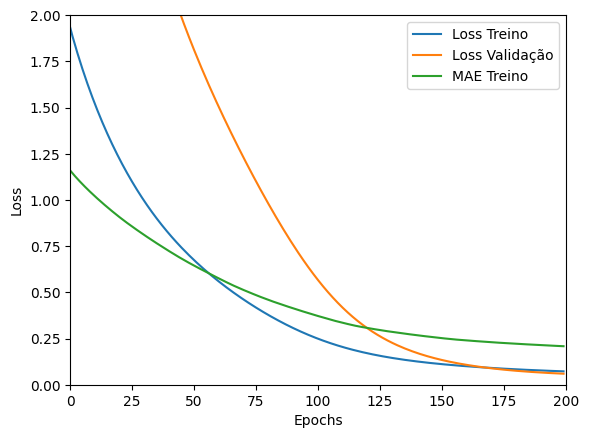

Tempo de treino: 0.38521849711736045 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06856154650449753 , MAE = 0.2088402509689331'

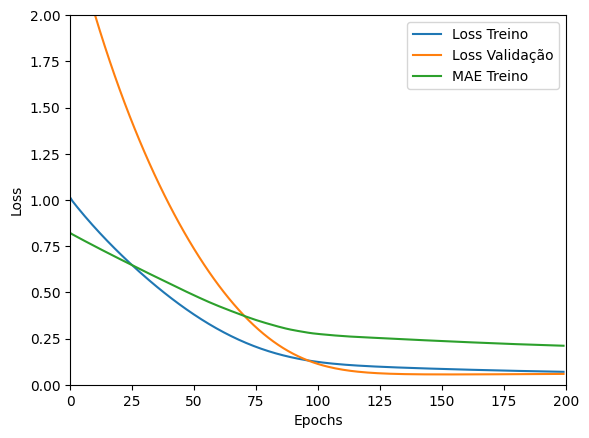

Tempo de treino: 0.33822476069132484 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0413520485162735 , MAE = 0.15490616858005524'

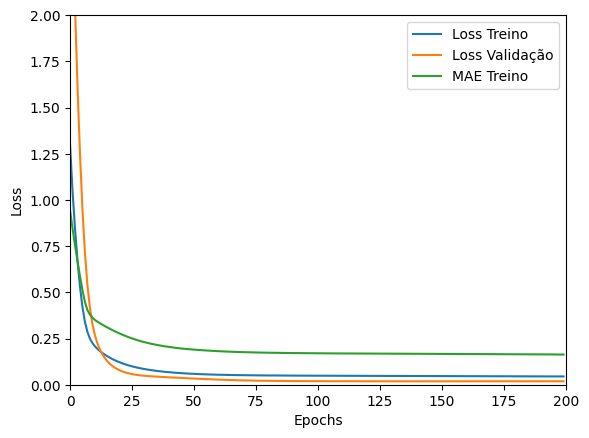

Tempo de treino: 0.7278103709220887 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04551803320646286 , MAE = 0.1641390025615692'

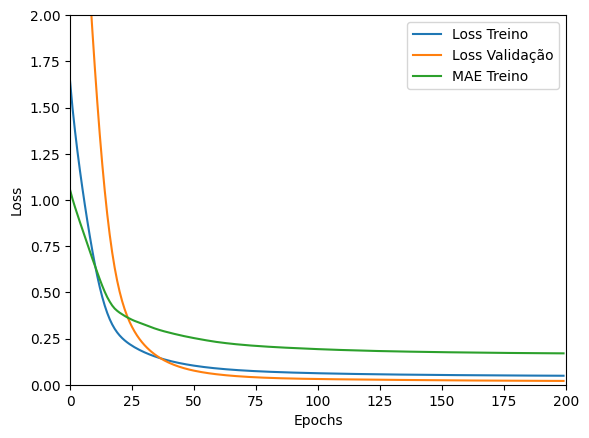

Tempo de treino: 0.4350215593973796 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04561100900173187 , MAE = 0.16333211958408356'

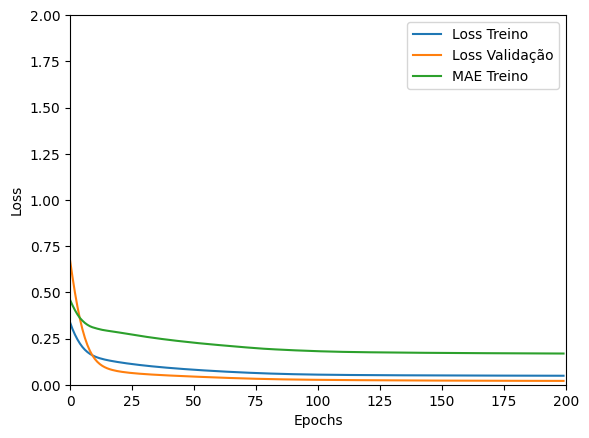

Tempo de treino: 0.2949121117591858 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.045849304646253586 , MAE = 0.16709132492542267'

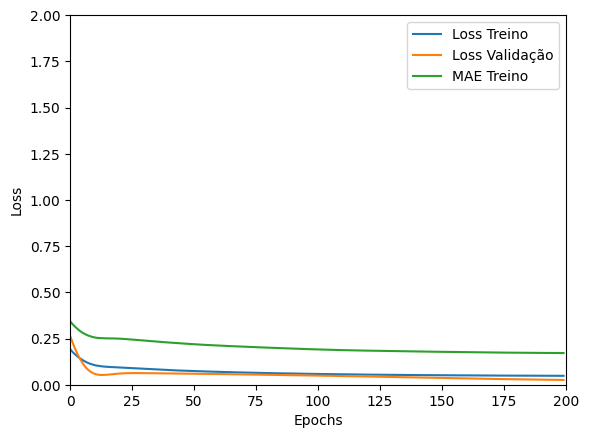

Tempo de treino: 0.4045096000035604 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04028789699077606 , MAE = 0.1520489603281021'

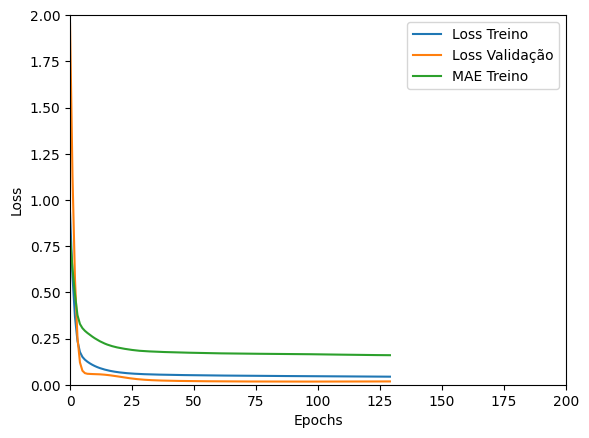

Tempo de treino: 0.48262588183085126 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.03986433148384094 , MAE = 0.15191884338855743'

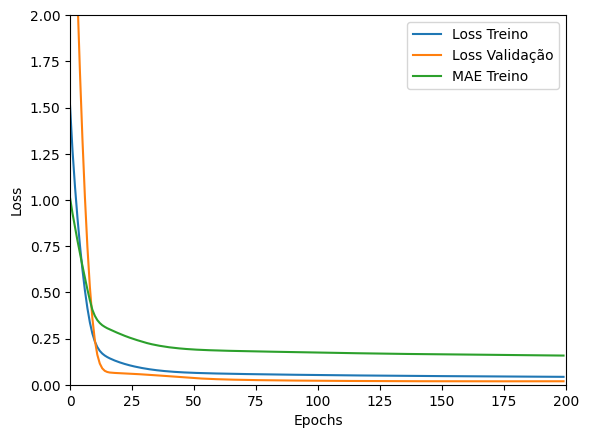

Tempo de treino: 0.736712650458018 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04582646116614342 , MAE = 0.16325895488262177'

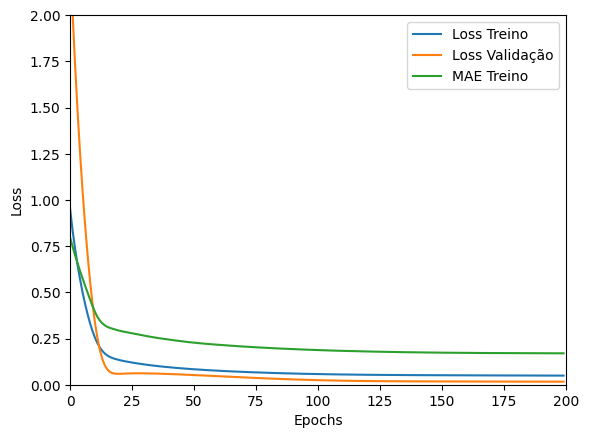

Tempo de treino: 0.3824192722638448 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14040790498256683 , MAE = 0.2932470142841339'

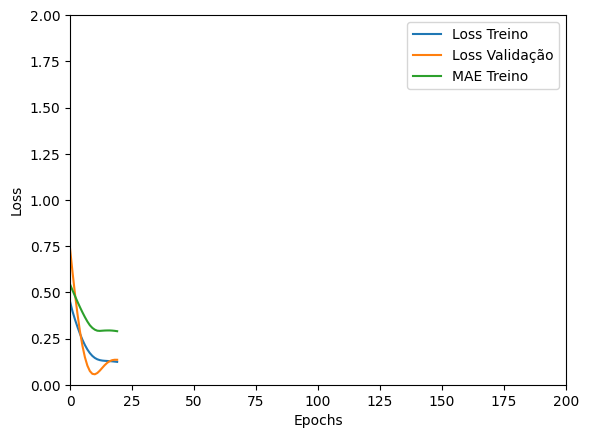

Tempo de treino: 0.08231920003890991 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042468540370464325 , MAE = 0.1562945395708084'

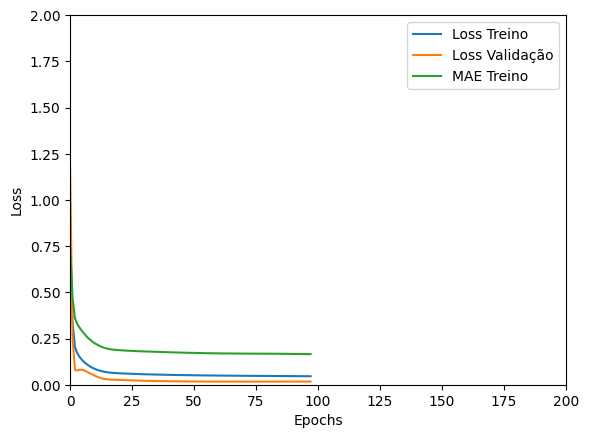

Tempo de treino: 0.43640832901000975 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042750079184770584 , MAE = 0.15735282003879547'

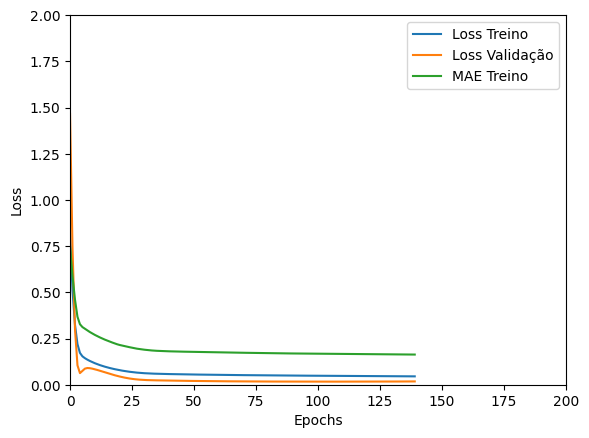

Tempo de treino: 0.3602587699890137 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04436652362346649 , MAE = 0.16049228608608246'

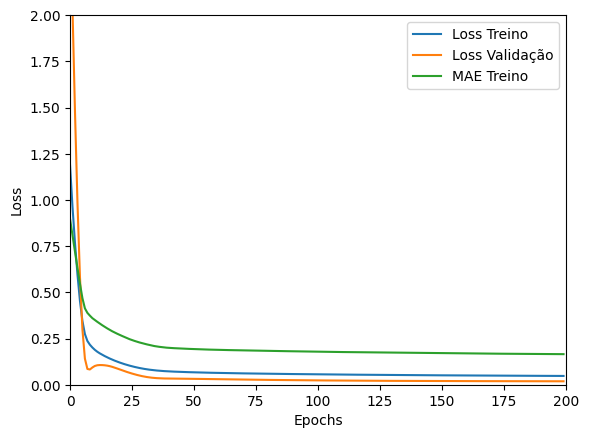

Tempo de treino: 0.3858319878578186 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21472811698913574 , MAE = 0.3660072684288025'

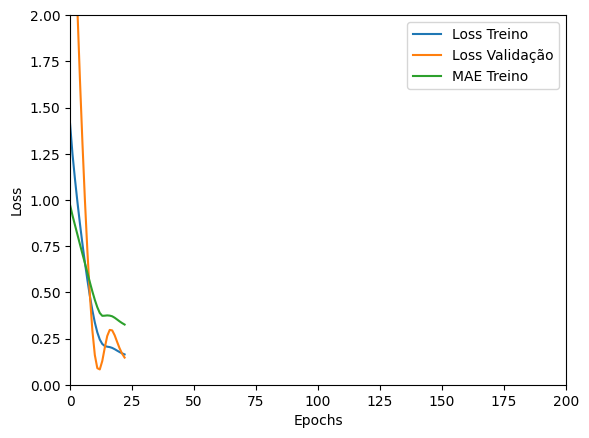

Tempo de treino: 0.13693160216013592 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042370330542325974 , MAE = 0.15453124046325684'

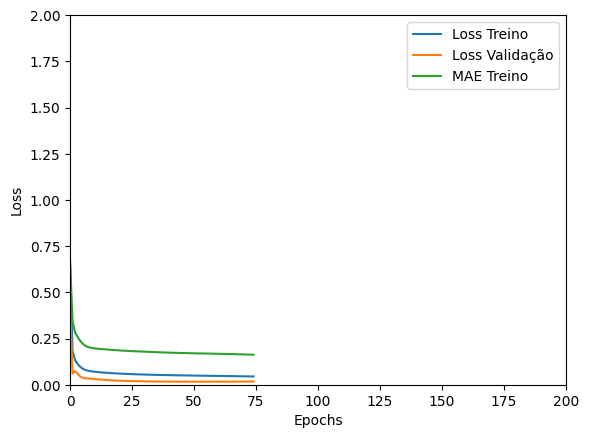

Tempo de treino: 0.324801504611969 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042658668011426926 , MAE = 0.1565992534160614'

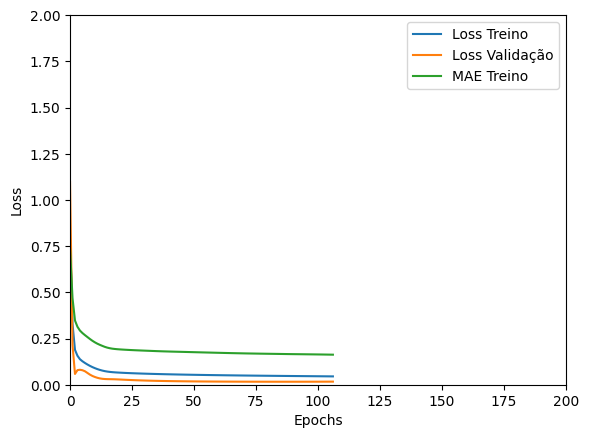

Tempo de treino: 0.35211278597513834 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04054811969399452 , MAE = 0.15302424132823944'

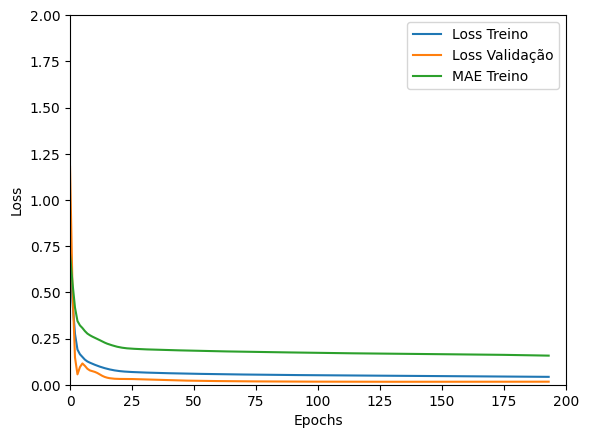

Tempo de treino: 0.36665884256362913 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042988840490579605 , MAE = 0.16044892370700836'

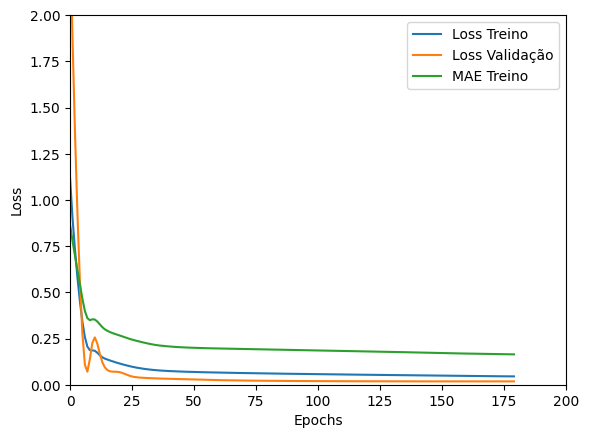

Tempo de treino: 0.3071055809656779 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3593170940876007 , MAE = 0.44104862213134766'

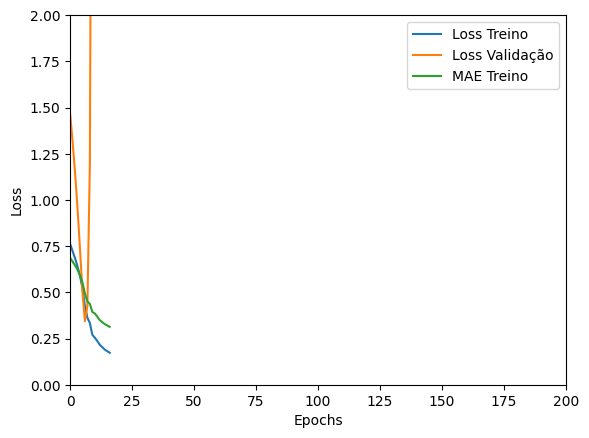

Tempo de treino: 0.14727944533030193 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.0218327045440674 , MAE = 0.8015356063842773'

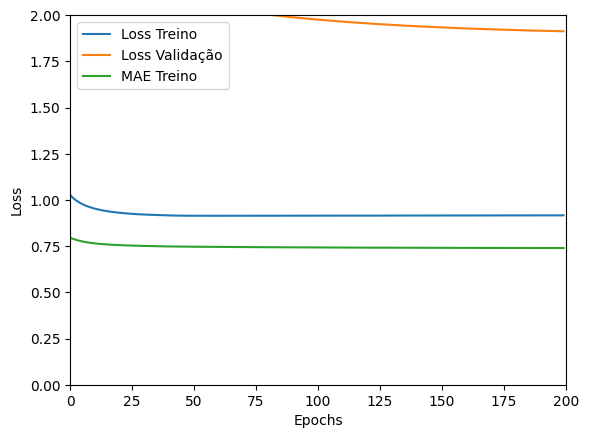

Tempo de treino: 0.6619622945785523 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7833486199378967 , MAE = 0.6800214648246765'

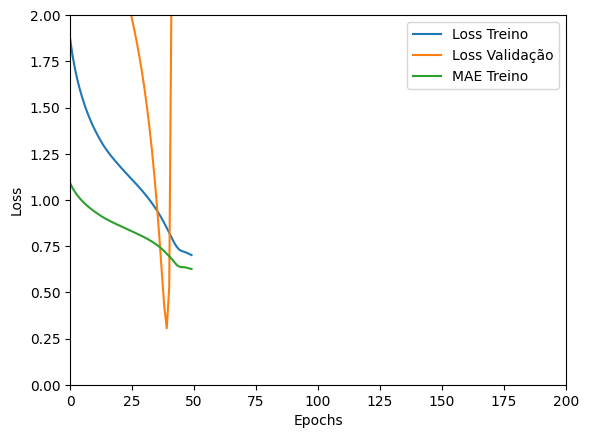

Tempo de treino: 0.20799351930618287 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25898313522338867 , MAE = 0.38767990469932556'

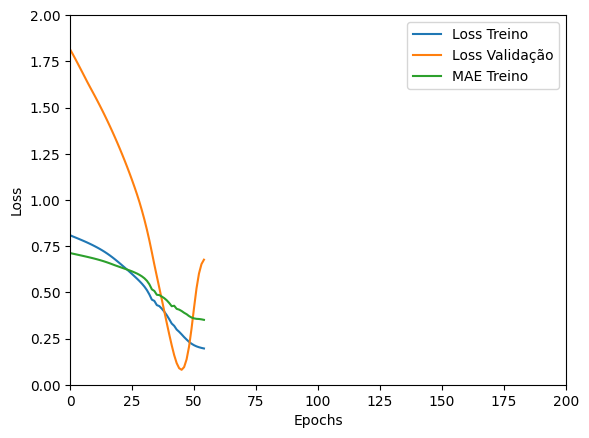

Tempo de treino: 0.17090561389923095 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3631340563297272 , MAE = 0.451111763715744'

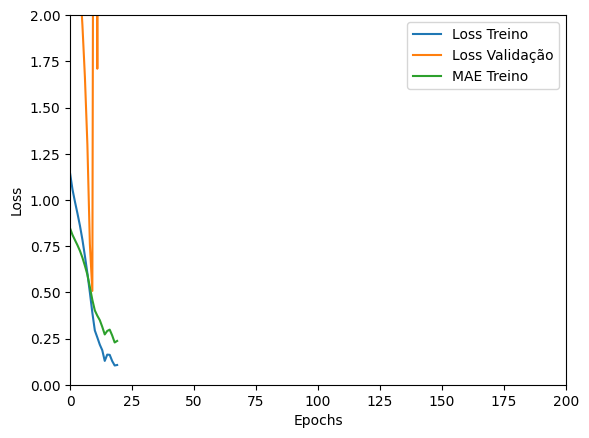

Tempo de treino: 0.1745213270187378 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05339372530579567 , MAE = 0.17580874264240265'

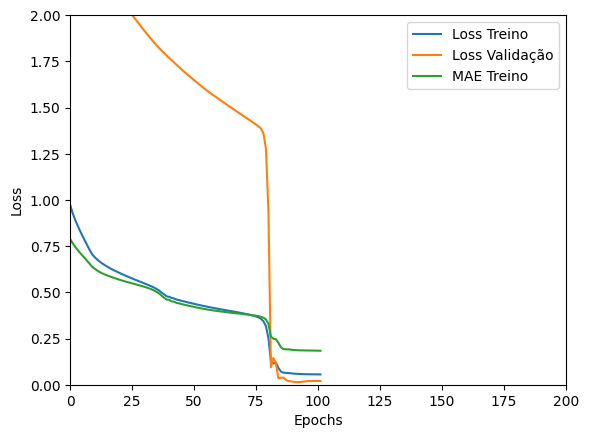

Tempo de treino: 0.3730997721354167 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34958648681640625 , MAE = 0.4364372491836548'

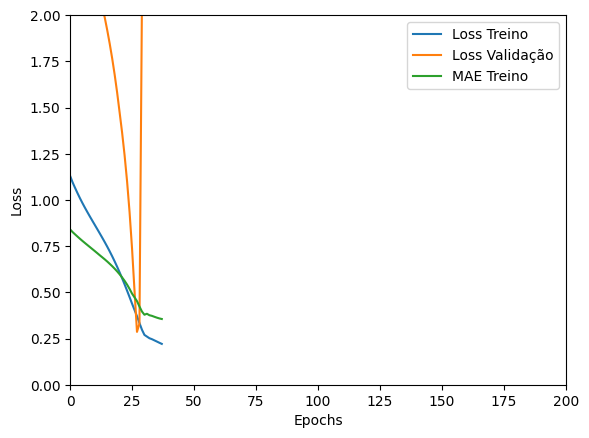

Tempo de treino: 0.12935596307118732 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.050168830901384354 , MAE = 0.17775729298591614'

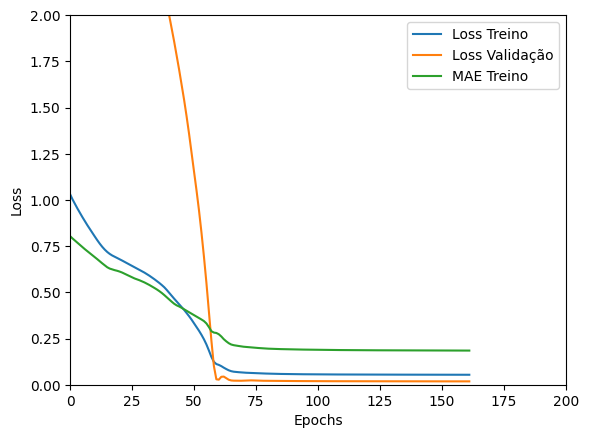

Tempo de treino: 0.37964423894882204 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15476581454277039 , MAE = 0.29129335284233093'

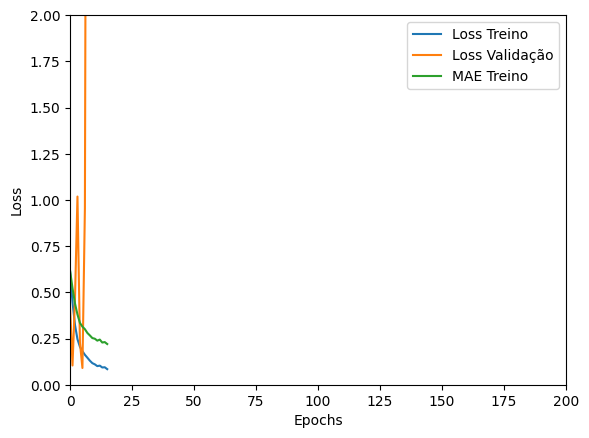

Tempo de treino: 0.14060547749201457 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38100332021713257 , MAE = 0.46820908784866333'

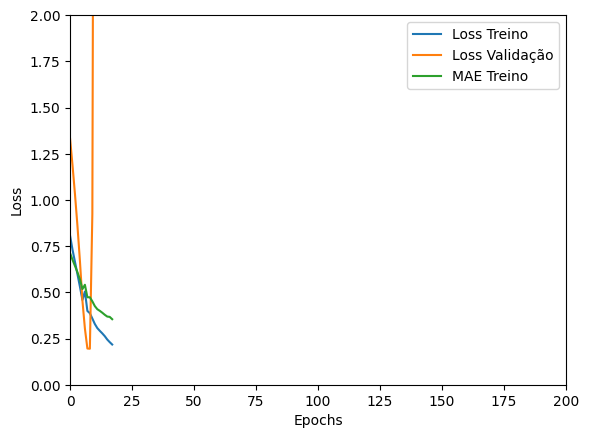

Tempo de treino: 0.11176678339640299 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4225221276283264 , MAE = 0.49666479229927063'

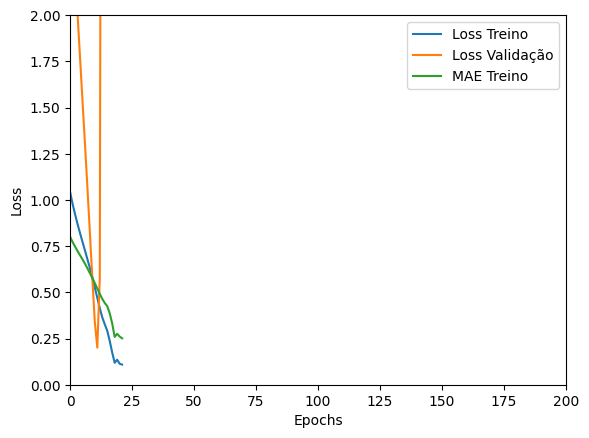

Tempo de treino: 0.1332192063331604 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4320667088031769 , MAE = 0.4971192181110382'

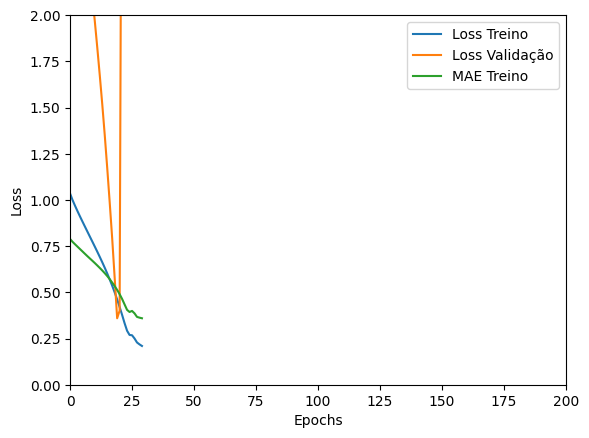

Tempo de treino: 0.12629094123840331 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20865608751773834 , MAE = 0.35691332817077637'

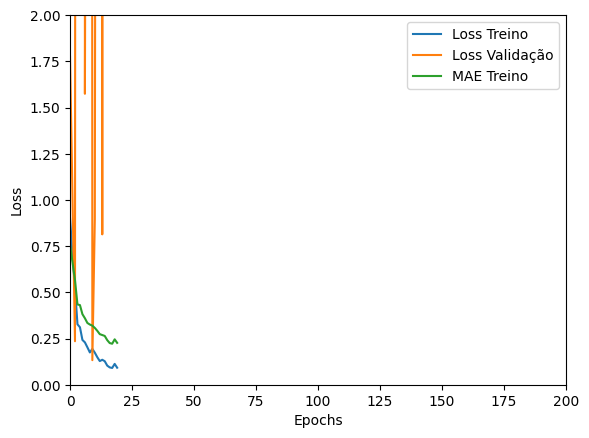

Tempo de treino: 0.17768530050913492 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2978096902370453 , MAE = 0.41001594066619873'

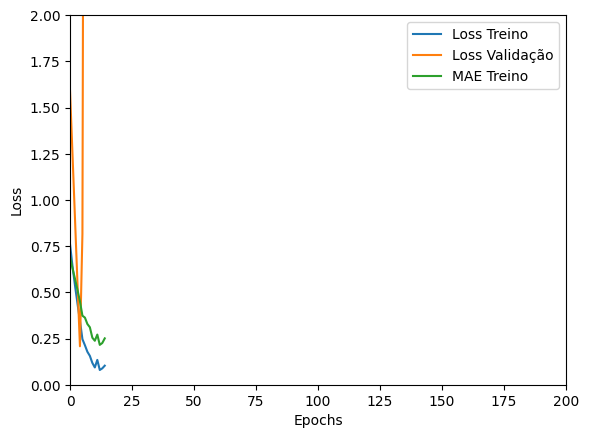

Tempo de treino: 0.1072071353594462 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40382102131843567 , MAE = 0.4882252514362335'

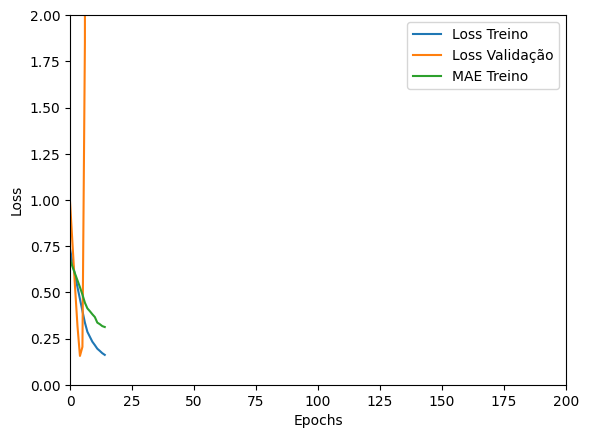

Tempo de treino: 0.07450007994969686 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33288824558258057 , MAE = 0.40882056951522827'

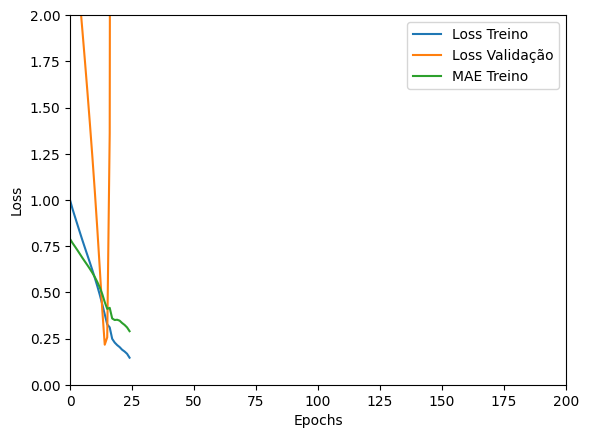

Tempo de treino: 0.08489507834116618 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33769145607948303 , MAE = 0.4342248737812042'

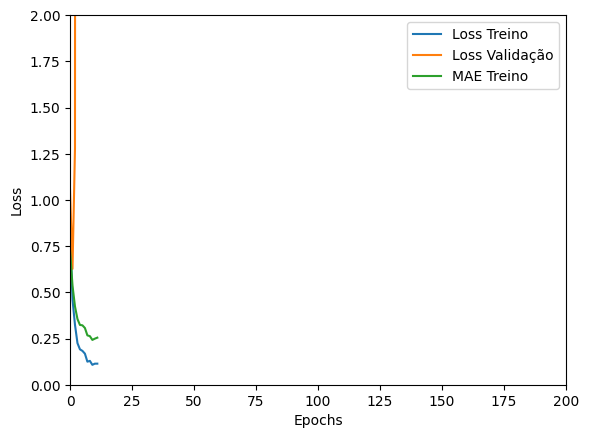

Tempo de treino: 0.17169287999471028 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3735135495662689 , MAE = 0.4523932933807373'

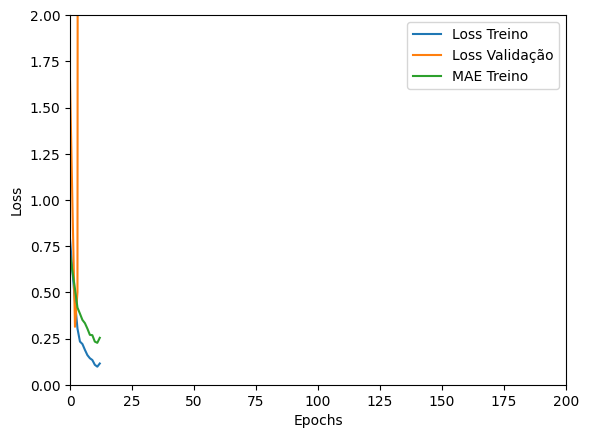

Tempo de treino: 0.1389053463935852 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29014724493026733 , MAE = 0.394382119178772'

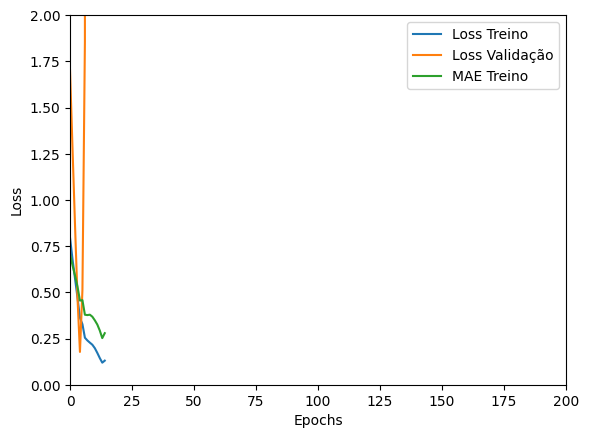

Tempo de treino: 0.08380097548166911 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38929665088653564 , MAE = 0.46977829933166504'

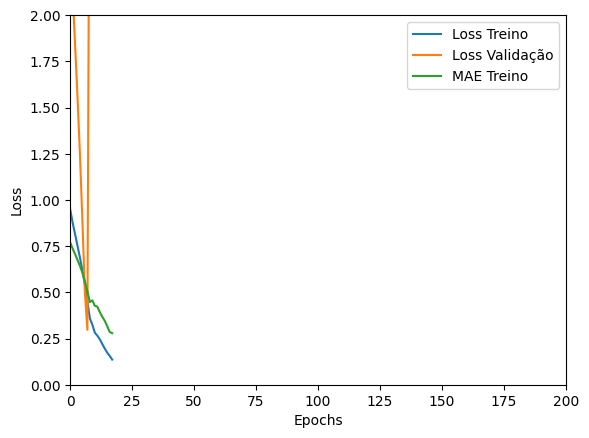

Tempo de treino: 0.08904279867808024 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=24, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22816088795661926 , MAE = 0.3766316771507263'

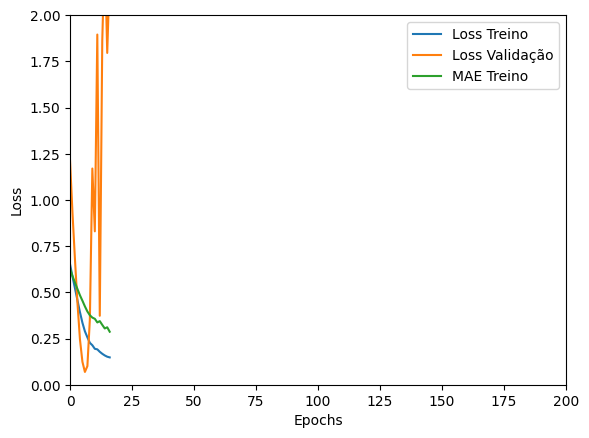

Tempo de treino: 0.21315224568049113 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47922036051750183 , MAE = 0.5164401531219482'

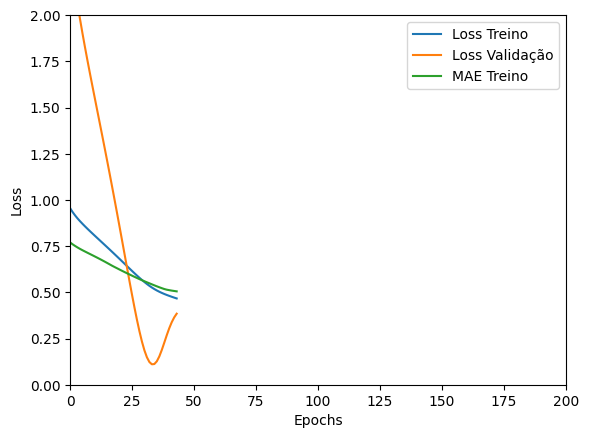

Tempo de treino: 0.20806346734364828 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3972748816013336 , MAE = 0.42768335342407227'

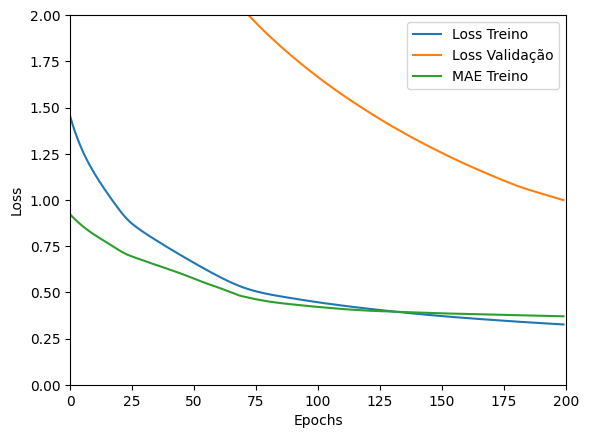

Tempo de treino: 0.4423287153244019 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6026185154914856 , MAE = 0.5949890613555908'

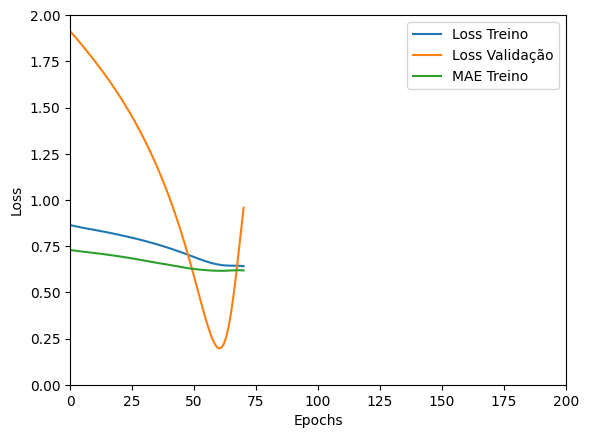

Tempo de treino: 0.21877288818359375 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29918646812438965 , MAE = 0.3994613289833069'

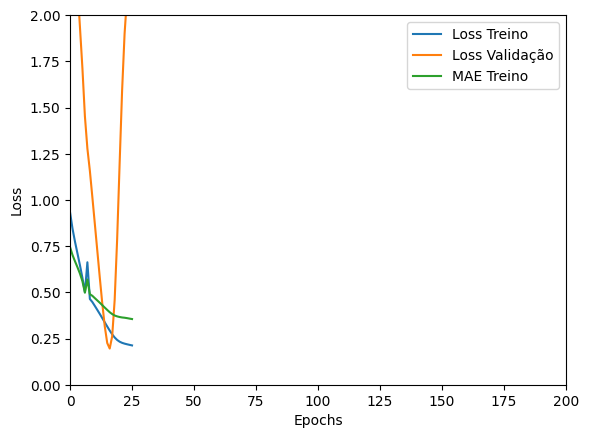

Tempo de treino: 0.20151527722676596 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28609931468963623 , MAE = 0.40459513664245605'

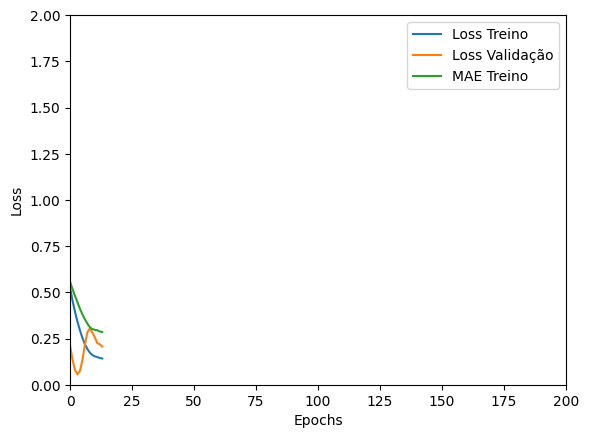

Tempo de treino: 0.12585914134979248 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07616087794303894 , MAE = 0.21311433613300323'

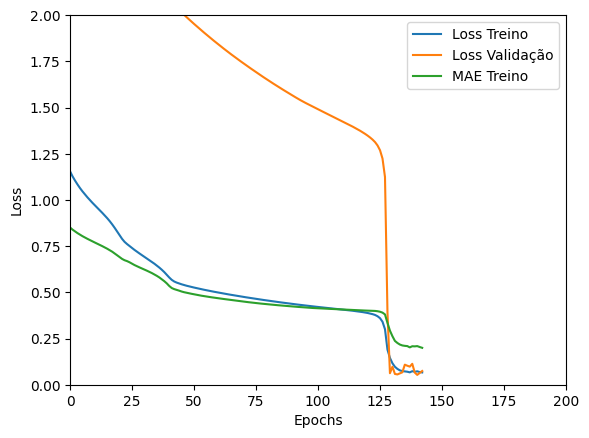

Tempo de treino: 0.3323346972465515 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2857133746147156 , MAE = 0.39007997512817383'

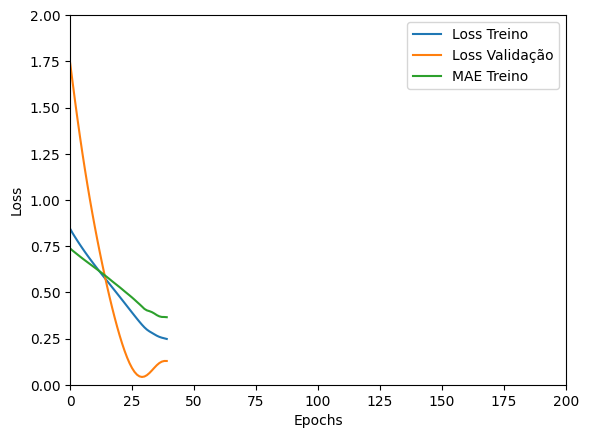

Tempo de treino: 0.1262732704480489 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39046573638916016 , MAE = 0.4890119433403015'

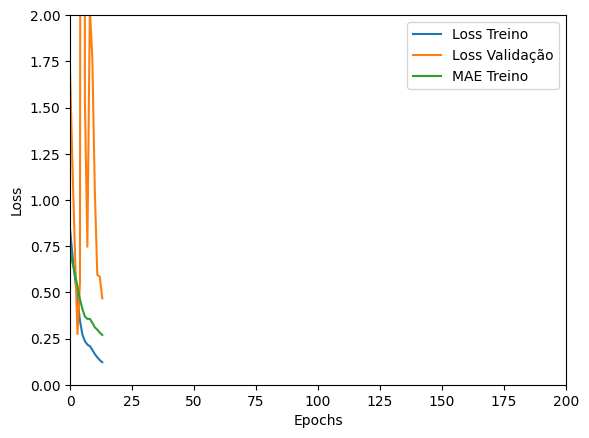

Tempo de treino: 0.11567569573720296 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08849596232175827 , MAE = 0.22007110714912415'

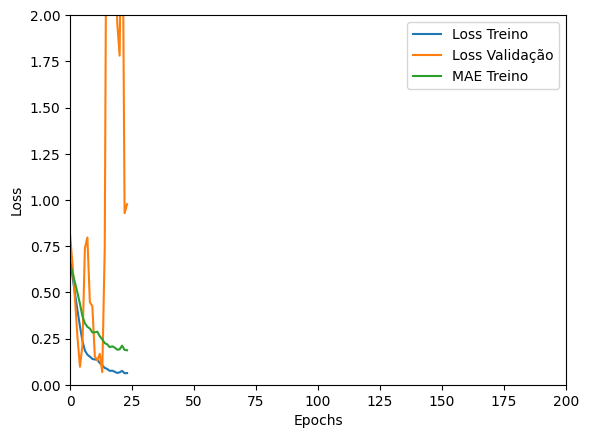

Tempo de treino: 0.1592782497406006 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31651532649993896 , MAE = 0.4351545572280884'

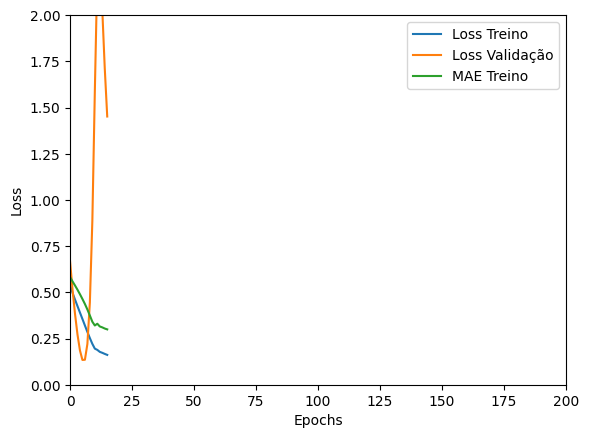

Tempo de treino: 0.1288143793741862 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6348708868026733 , MAE = 0.6069426536560059'

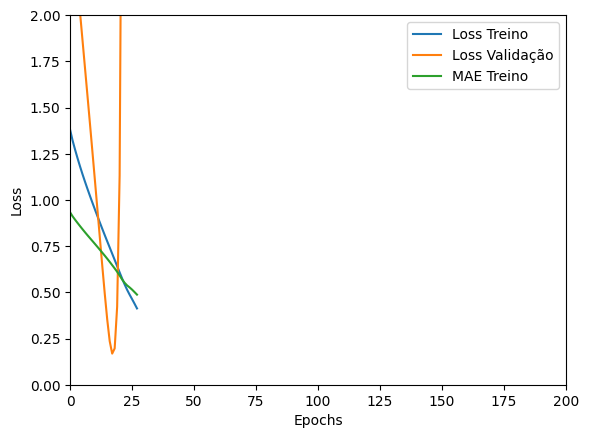

Tempo de treino: 0.08567239046096801 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5141437649726868 , MAE = 0.5655280351638794'

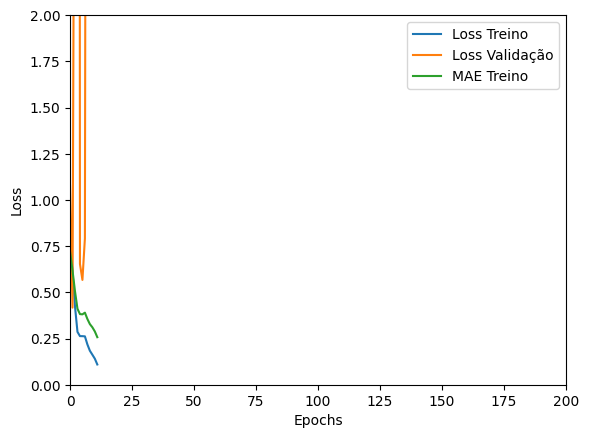

Tempo de treino: 0.13214100599288942 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4430551826953888 , MAE = 0.5085529088973999'

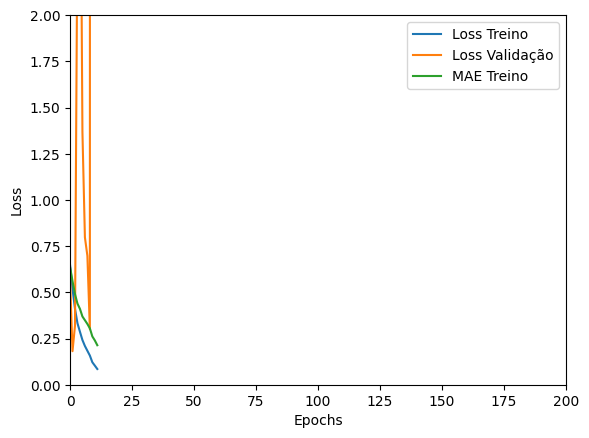

Tempo de treino: 0.08218418757120768 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3643496632575989 , MAE = 0.42296653985977173'

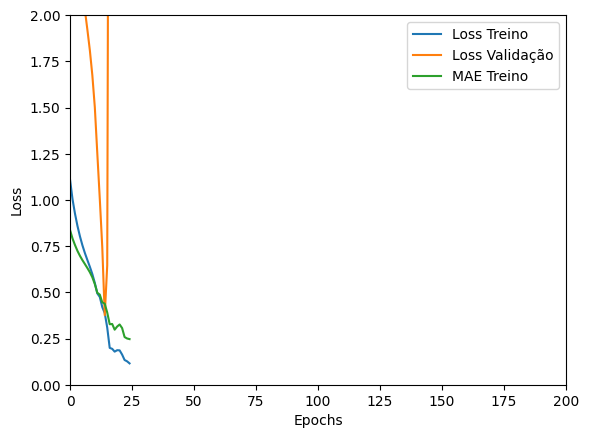

Tempo de treino: 0.10649478038152059 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3470711410045624 , MAE = 0.43982237577438354'

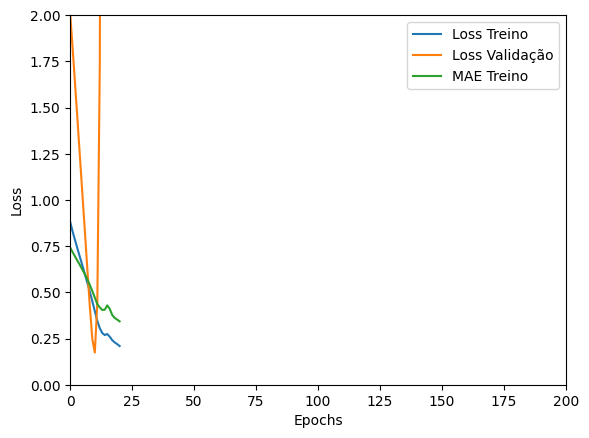

Tempo de treino: 0.10882444779078165 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23711153864860535 , MAE = 0.37359070777893066'

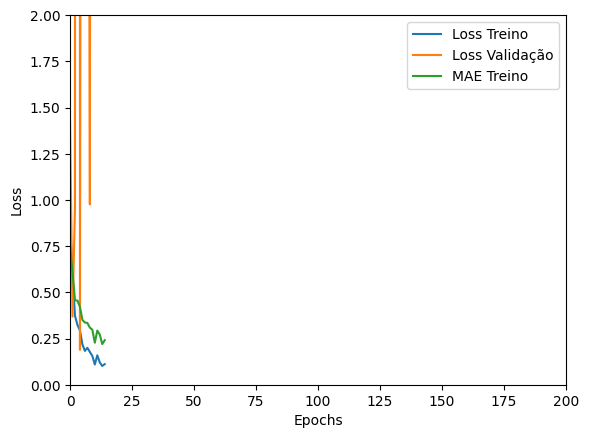

Tempo de treino: 0.16197076638539631 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3083247244358063 , MAE = 0.4165748059749603'

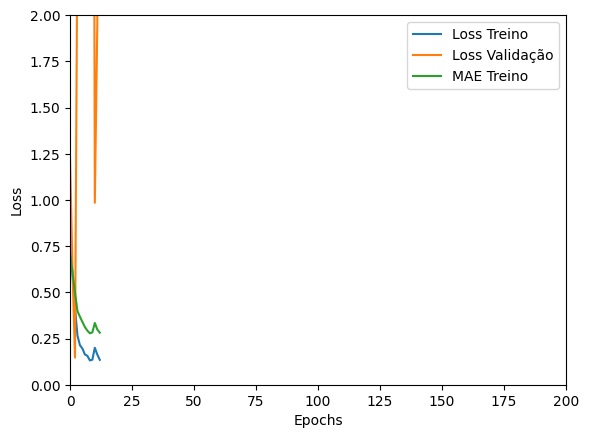

Tempo de treino: 0.12676457166671753 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3758421242237091 , MAE = 0.4643343985080719'

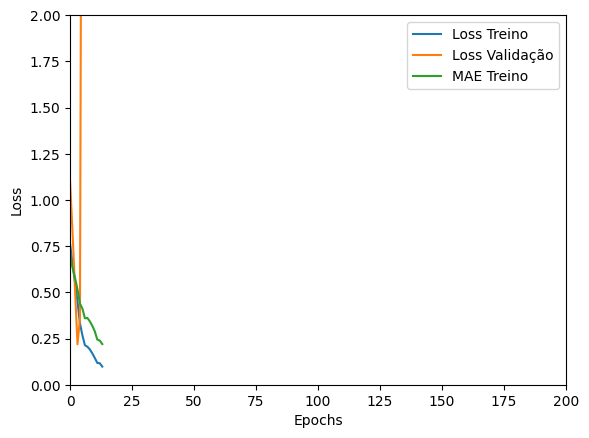

Tempo de treino: 0.08367070357004801 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3603431284427643 , MAE = 0.45065394043922424'

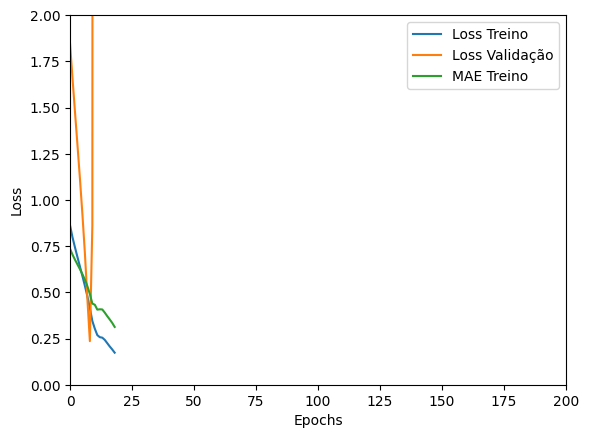

Tempo de treino: 0.08319782018661499 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1)

<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


 (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=24, units=4, batch=4


'TRAINING set. Loss = 0.10752562433481216 , MAE = 0.24597521126270294'

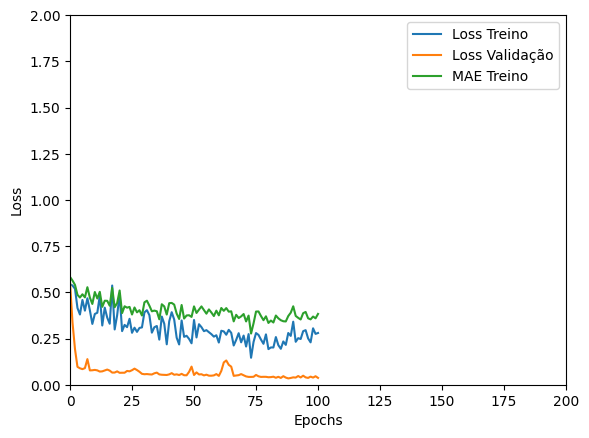

Tempo de treino: 0.7322877486546834 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3519963324069977 , MAE = 0.4580421447753906'

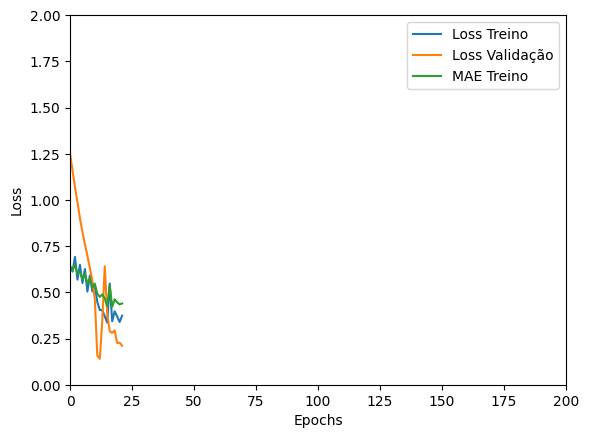

Tempo de treino: 0.1441251079241435 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3894755244255066 , MAE = 0.4719543755054474'

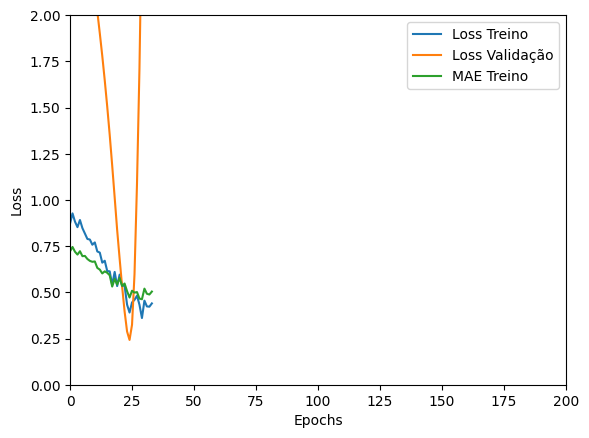

Tempo de treino: 0.13396744728088378 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4036758840084076 , MAE = 0.5056686401367188'

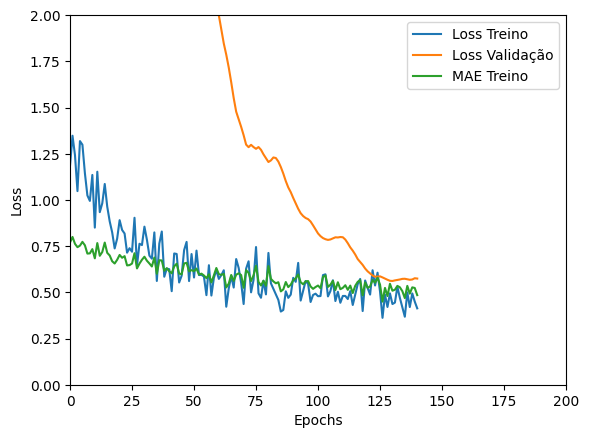

Tempo de treino: 0.39982060591379803 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6040151119232178 , MAE = 0.5947276949882507'

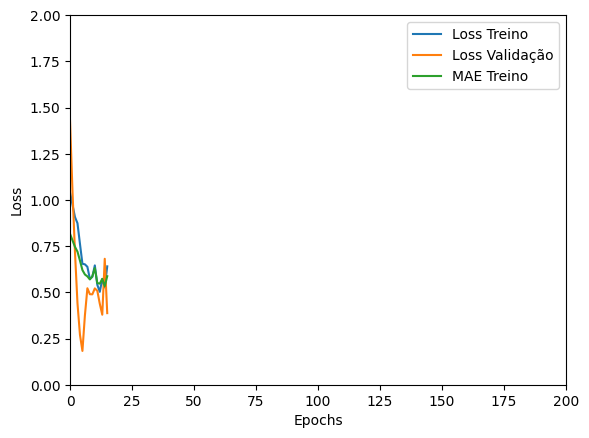

Tempo de treino: 0.15023158391316732 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11965196579694748 , MAE = 0.2456914633512497'

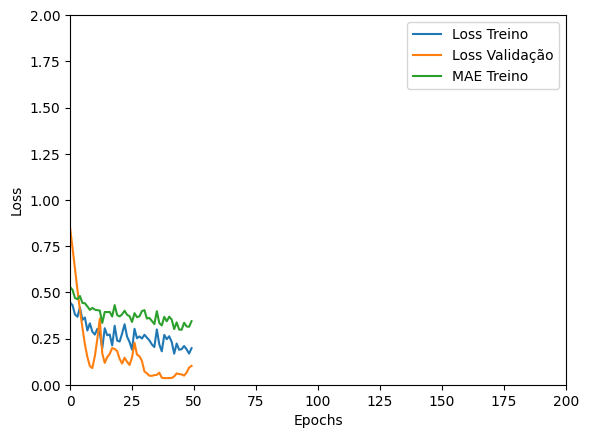

Tempo de treino: 0.2049104928970337 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24763402342796326 , MAE = 0.3638385236263275'

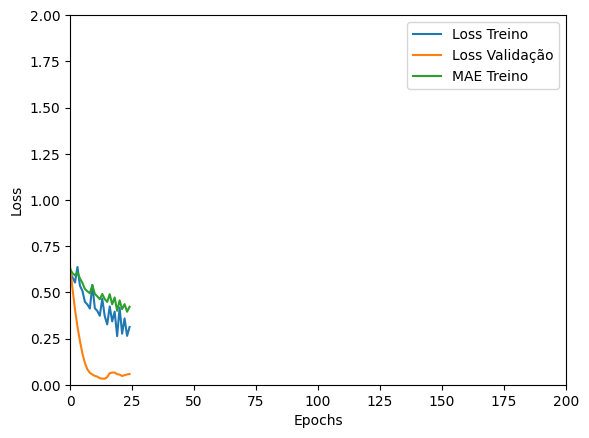

Tempo de treino: 0.12370411157608033 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4674204885959625 , MAE = 0.5129010081291199'

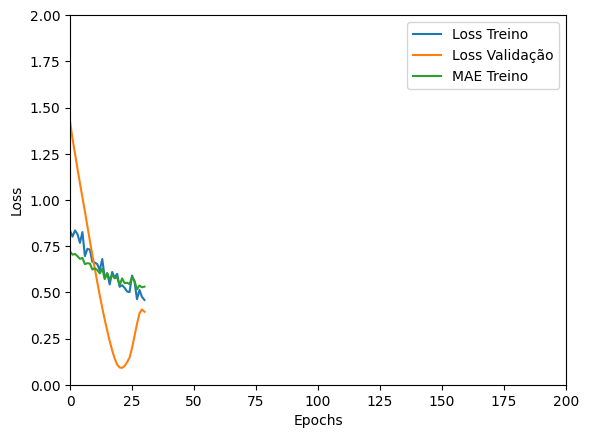

Tempo de treino: 0.1386273980140686 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4034724533557892 , MAE = 0.47194236516952515'

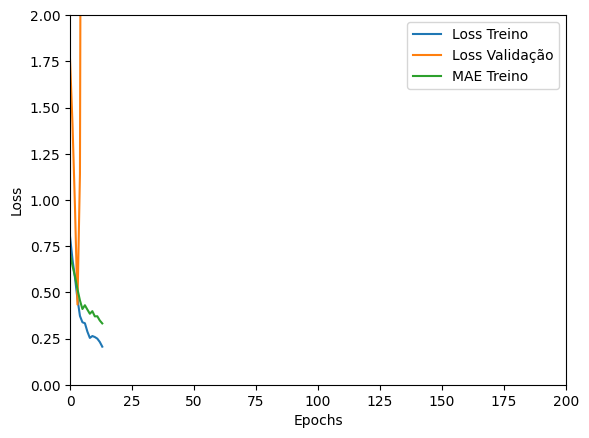

Tempo de treino: 0.1540105938911438 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32369351387023926 , MAE = 0.4357891380786896'

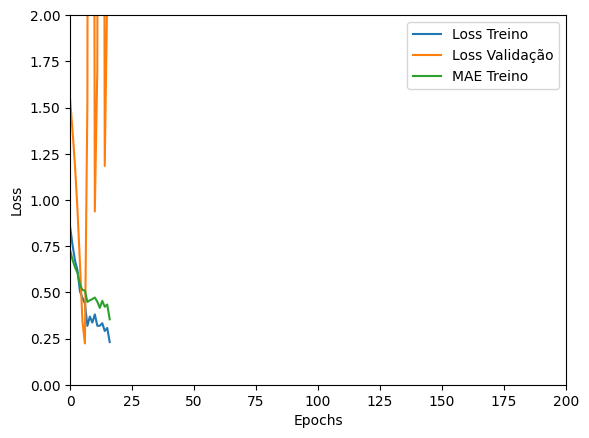

Tempo de treino: 0.12928587595621746 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40676066279411316 , MAE = 0.47255969047546387'

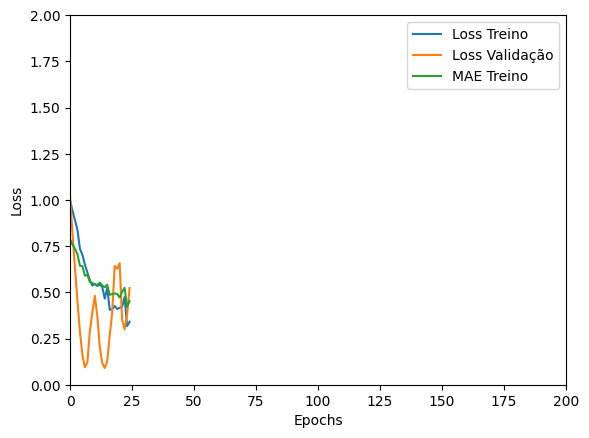

Tempo de treino: 0.09449367920557658 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5357613563537598 , MAE = 0.5592134594917297'

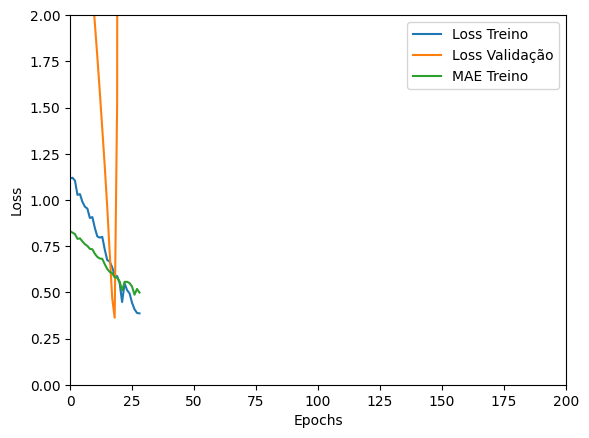

Tempo de treino: 0.09825279315312703 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08803857117891312 , MAE = 0.21313127875328064'

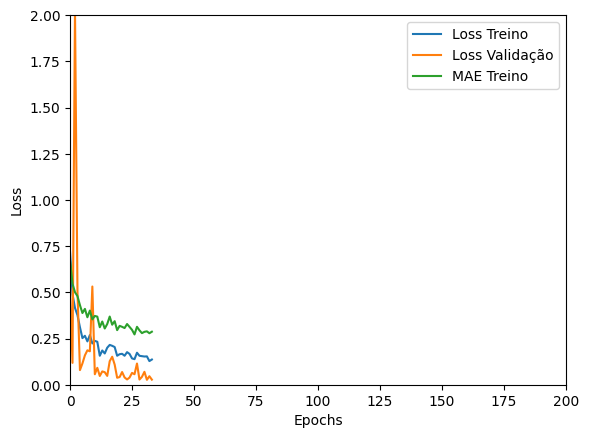

Tempo de treino: 0.2415234883626302 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4177997410297394 , MAE = 0.450133740901947'

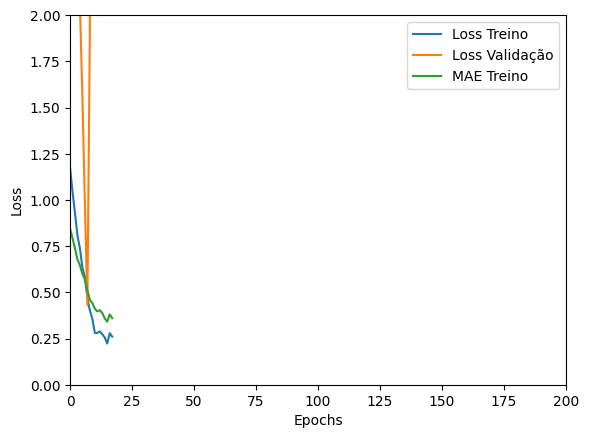

Tempo de treino: 0.09709439277648926 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2764345407485962 , MAE = 0.38314083218574524'

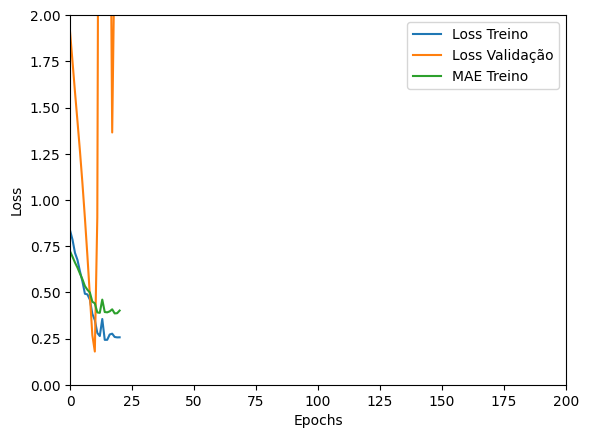

Tempo de treino: 0.16556114753087361 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40130454301834106 , MAE = 0.47374773025512695'

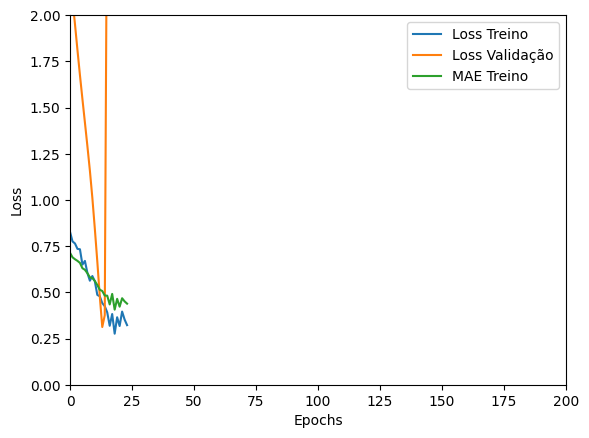

Tempo de treino: 0.13268328507741292 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21538349986076355 , MAE = 0.35488173365592957'

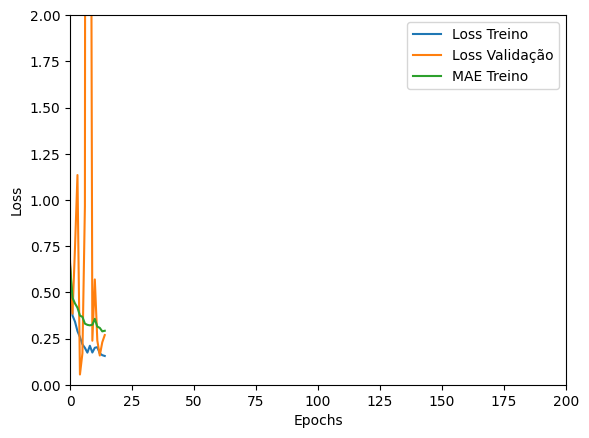

Tempo de treino: 0.1509135087331136 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14888179302215576 , MAE = 0.2797486484050751'

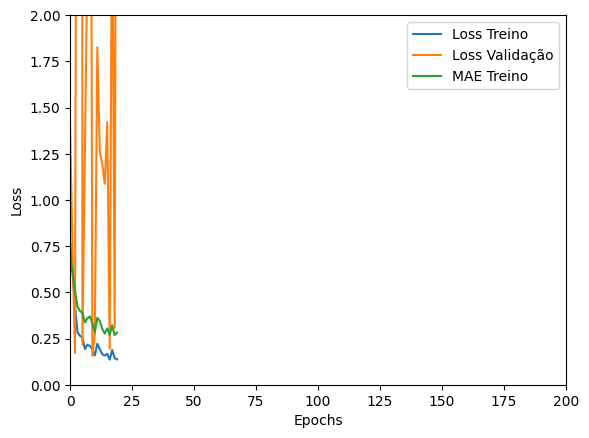

Tempo de treino: 0.13668476740519206 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.43838053941726685 , MAE = 0.504449725151062'

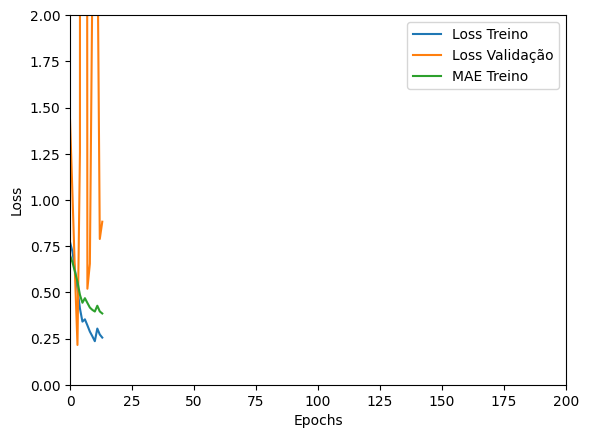

Tempo de treino: 0.08583838939666748 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4857819676399231 , MAE = 0.5305161476135254'

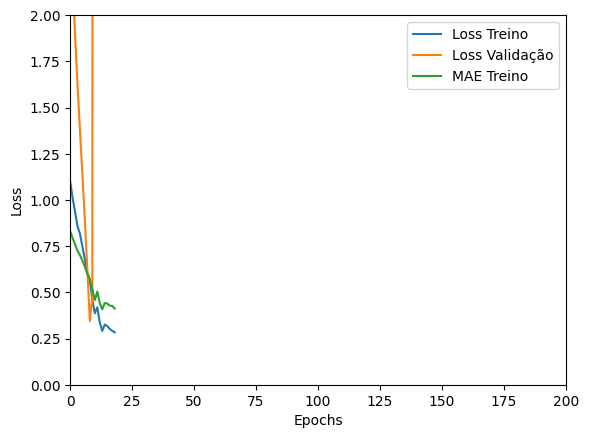

Tempo de treino: 0.08025472164154053 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com GRU_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04690876603126526 , MAE = 0.16898801922798157'

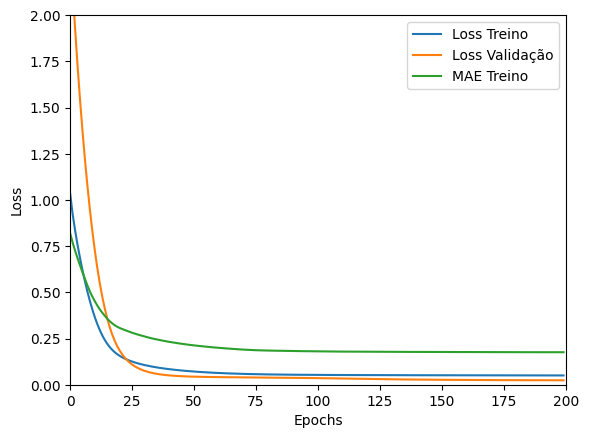

Tempo de treino: 1.456671623388926 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05368026718497276 , MAE = 0.17828576266765594'

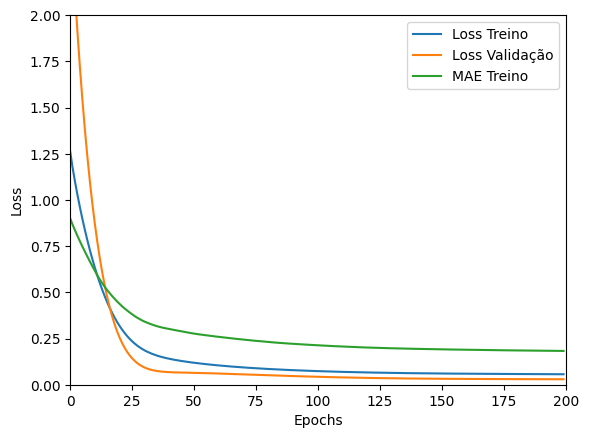

Tempo de treino: 1.4190119981765748 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0962584912776947 , MAE = 0.25410962104797363'

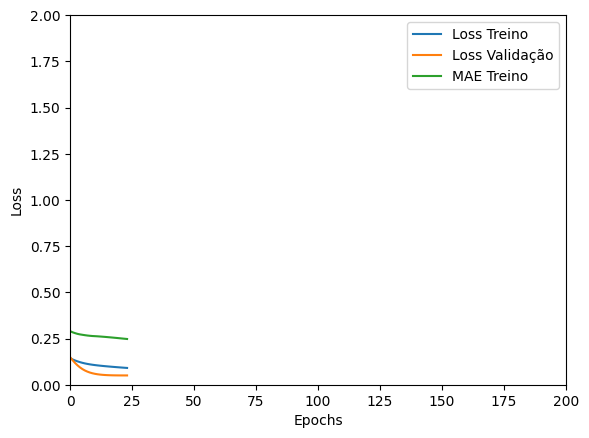

Tempo de treino: 0.14028112490971884 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10310982167720795 , MAE = 0.25669777393341064'

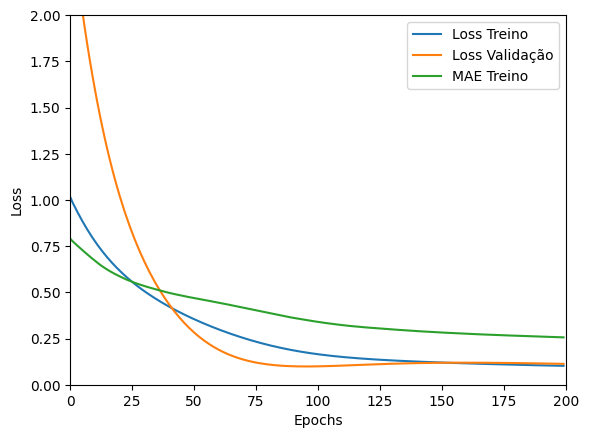

Tempo de treino: 0.3739514867464701 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.044740356504917145 , MAE = 0.1634087711572647'

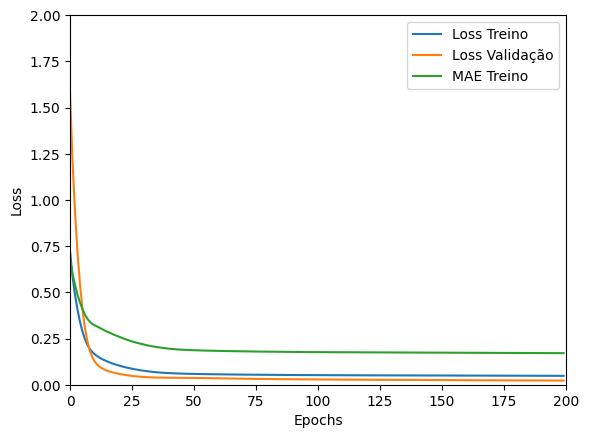

Tempo de treino: 1.439310892422994 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04933571070432663 , MAE = 0.17249943315982819'

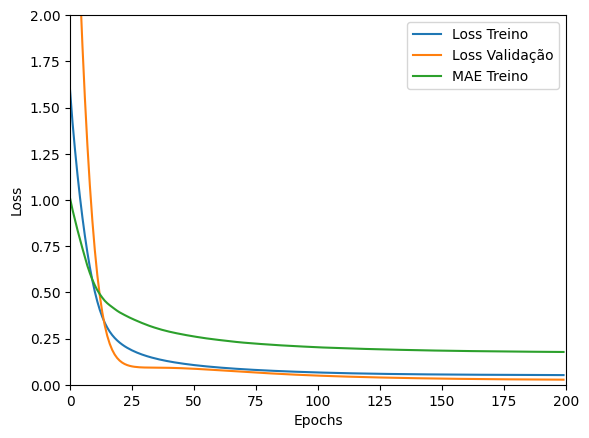

Tempo de treino: 1.4264156103134156 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18675397336483002 , MAE = 0.3477199077606201'

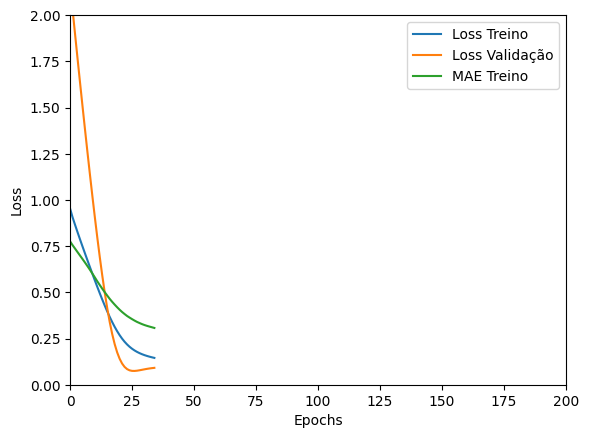

Tempo de treino: 0.22295144001642864 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09037019312381744 , MAE = 0.23436163365840912'

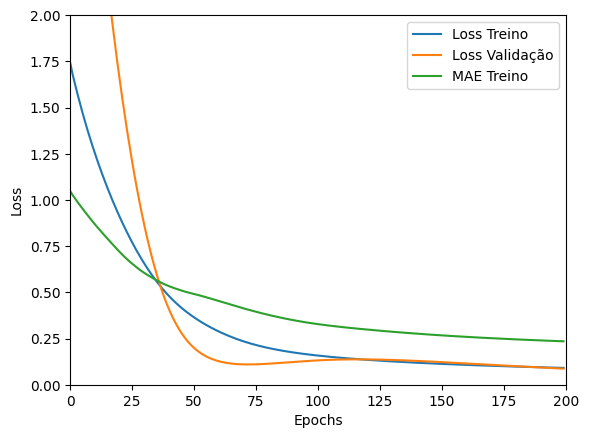

Tempo de treino: 0.38319894870122273 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04491083323955536 , MAE = 0.1641927808523178'

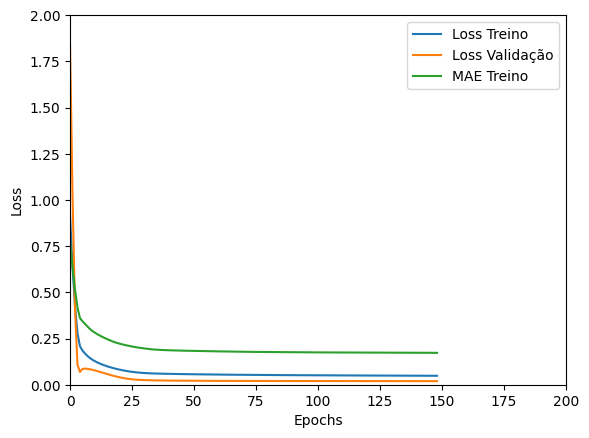

Tempo de treino: 1.4441914717356363 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04437056928873062 , MAE = 0.16058963537216187'

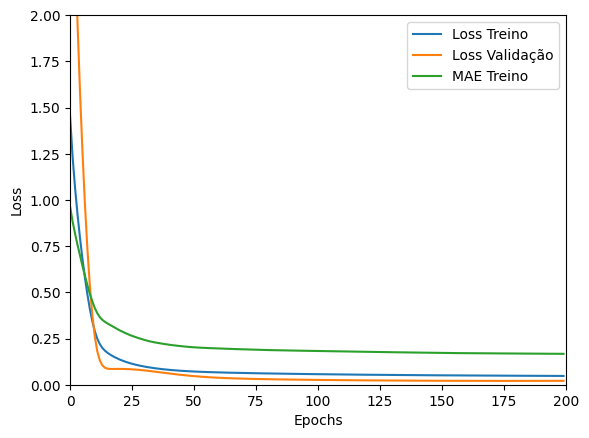

Tempo de treino: 1.4229626933733621 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18543778359889984 , MAE = 0.3393521308898926'

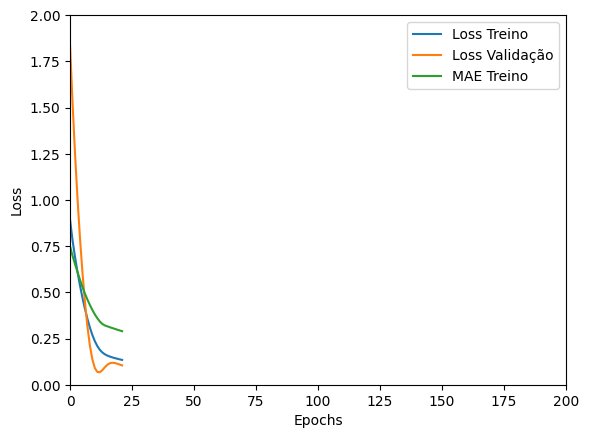

Tempo de treino: 0.13853777249654134 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2170969694852829 , MAE = 0.3753849267959595'

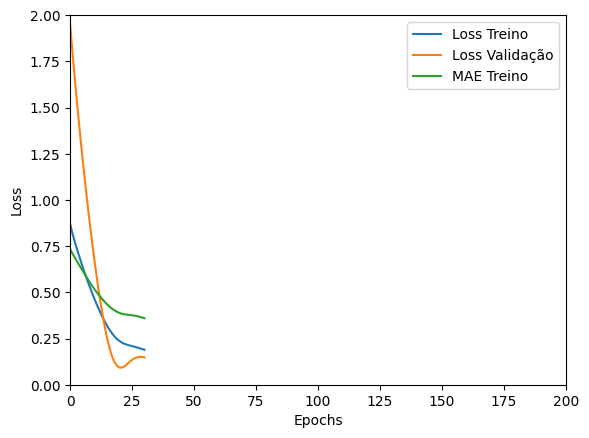

Tempo de treino: 0.13503998120625813 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.03786174952983856 , MAE = 0.14967092871665955'

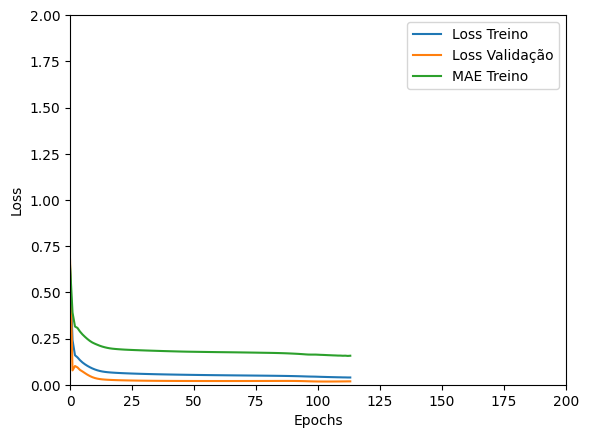

Tempo de treino: 0.8120379567146301 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04624452069401741 , MAE = 0.164813831448555'

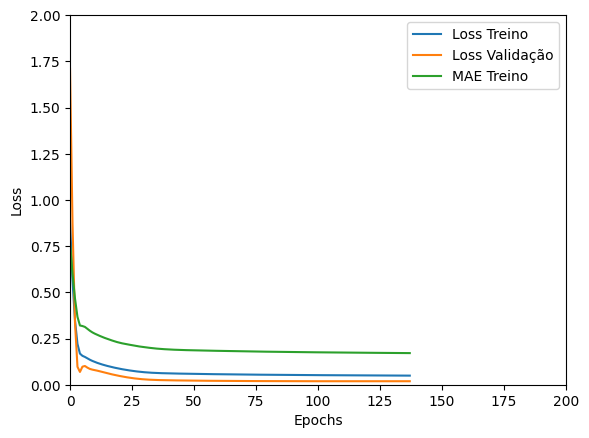

Tempo de treino: 0.643534795443217 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04633204638957977 , MAE = 0.16474749147891998'

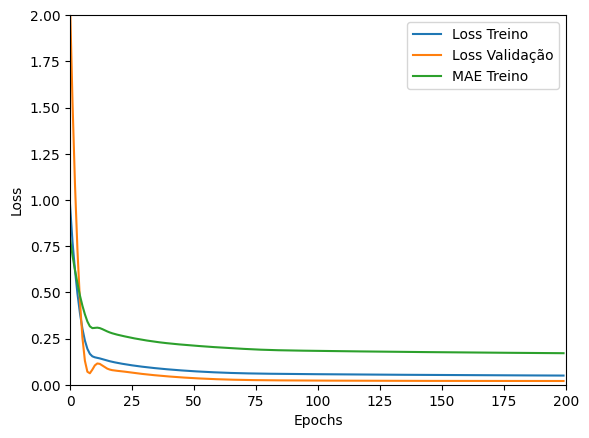

Tempo de treino: 0.5727039059003194 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19541744887828827 , MAE = 0.34987208247184753'

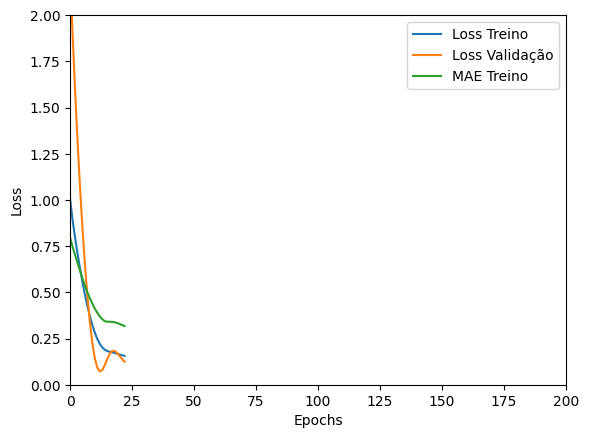

Tempo de treino: 0.10473457574844361 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.050137002021074295 , MAE = 0.17179052531719208'

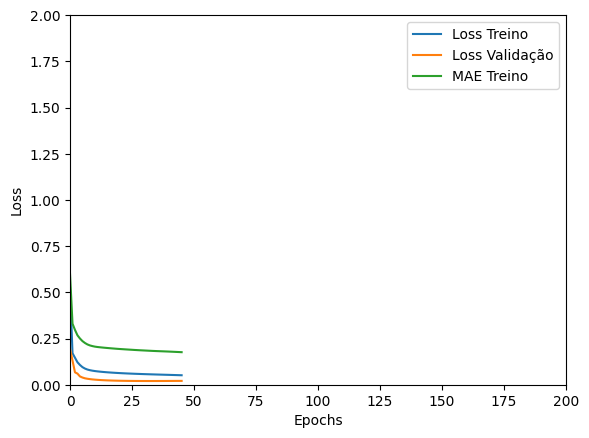

Tempo de treino: 0.40989144643147785 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04776827618479729 , MAE = 0.16827523708343506'

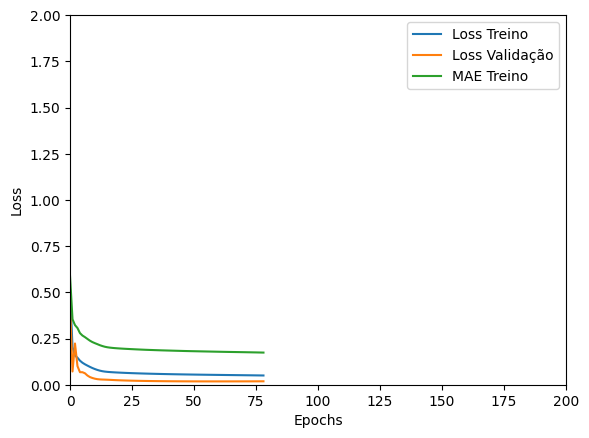

Tempo de treino: 0.44895439545313515 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04862622544169426 , MAE = 0.16953188180923462'

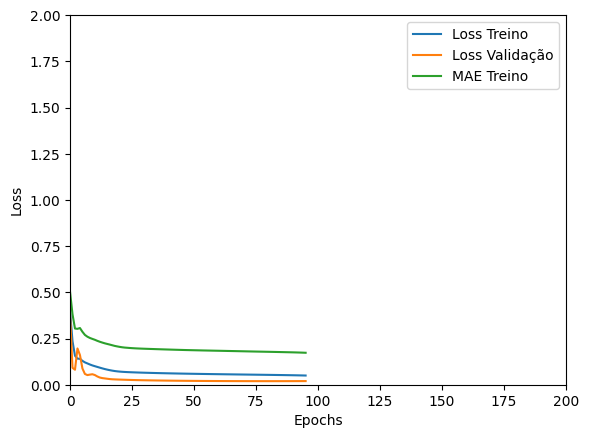

Tempo de treino: 0.40352333784103395 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.054802000522613525 , MAE = 0.17868046462535858'

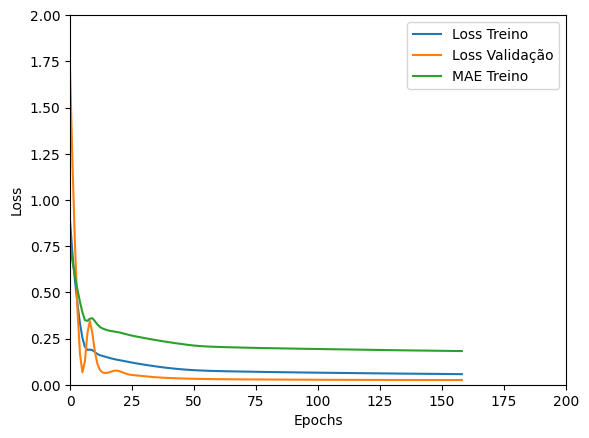

Tempo de treino: 0.35852195421854655 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.415211945772171 , MAE = 0.49168574810028076'

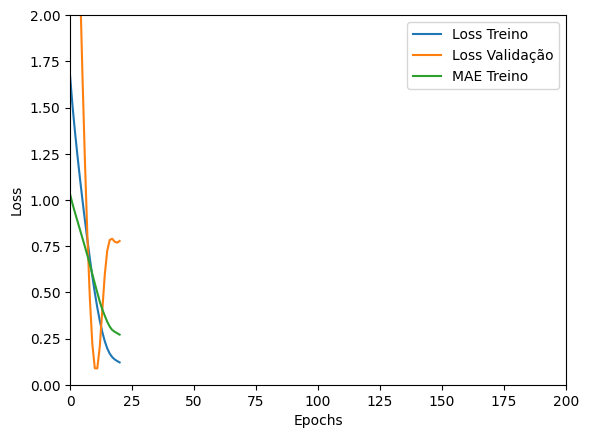

Tempo de treino: 0.2101912021636963 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.9133317470550537 , MAE = 0.7595018148422241'

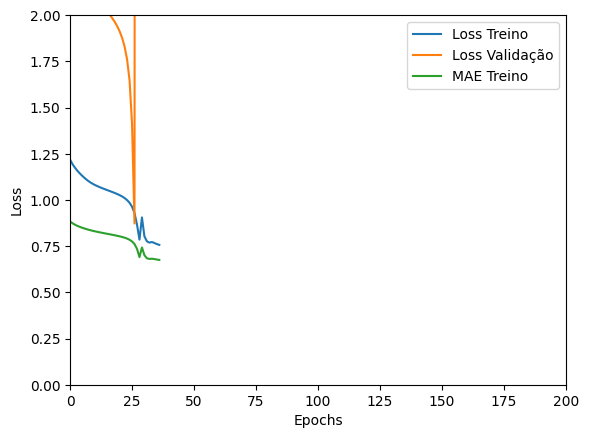

Tempo de treino: 0.20858889023462932 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5322660803794861 , MAE = 0.5470058917999268'

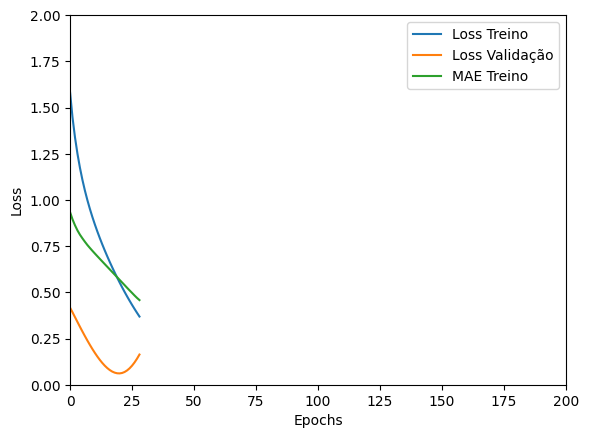

Tempo de treino: 0.12256194750467936 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7075868248939514 , MAE = 0.6456680297851562'

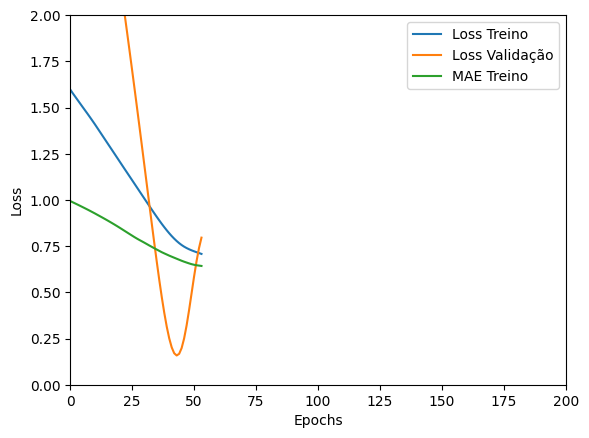

Tempo de treino: 0.23958319028218586 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.48270997405052185 , MAE = 0.5027185678482056'

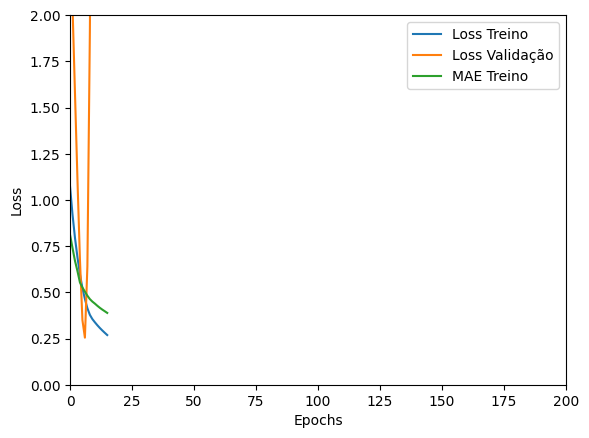

Tempo de treino: 0.166476309299469 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3210872709751129 , MAE = 0.41746363043785095'

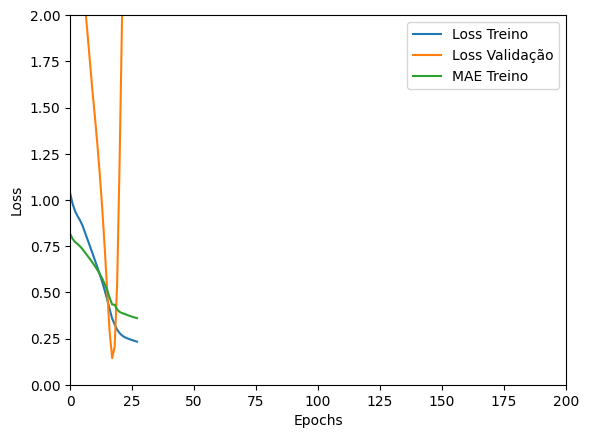

Tempo de treino: 0.14984552462895712 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2525627911090851 , MAE = 0.3815182149410248'

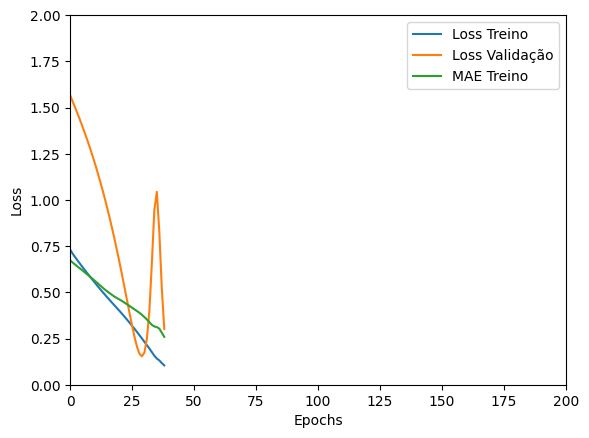

Tempo de treino: 0.14250384171803793 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.614751935005188 , MAE = 0.561633288860321'

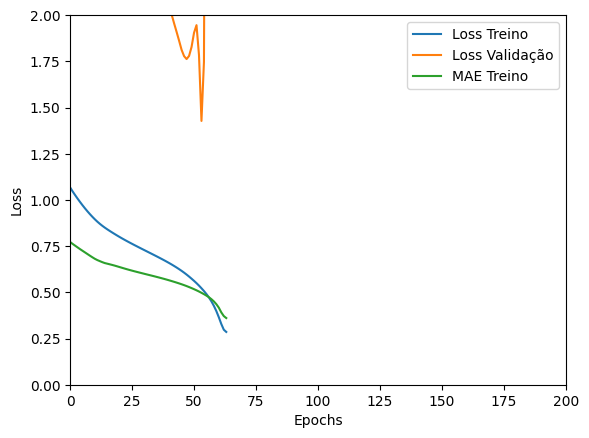

Tempo de treino: 0.20900247494379678 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5180701613426208 , MAE = 0.49492672085762024'

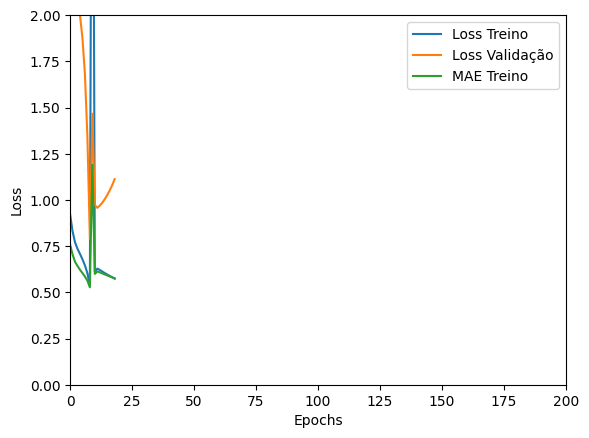

Tempo de treino: 0.2108902891476949 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4164588451385498 , MAE = 0.485815167427063'

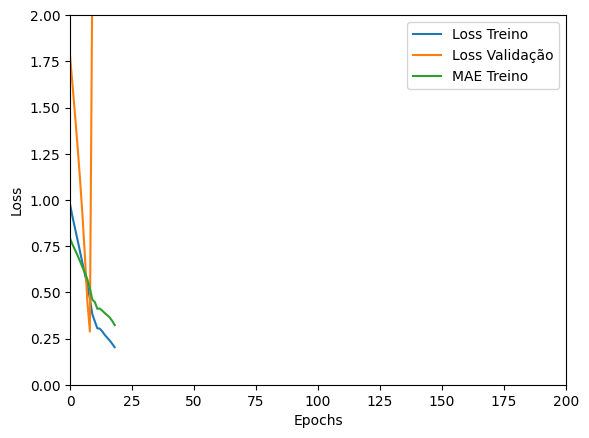

Tempo de treino: 0.12337954044342041 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26373788714408875 , MAE = 0.3606598973274231'

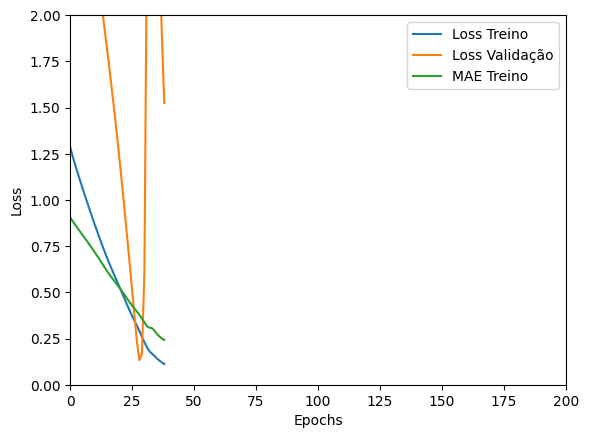

Tempo de treino: 0.17525866826375325 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37900403141975403 , MAE = 0.4720642566680908'

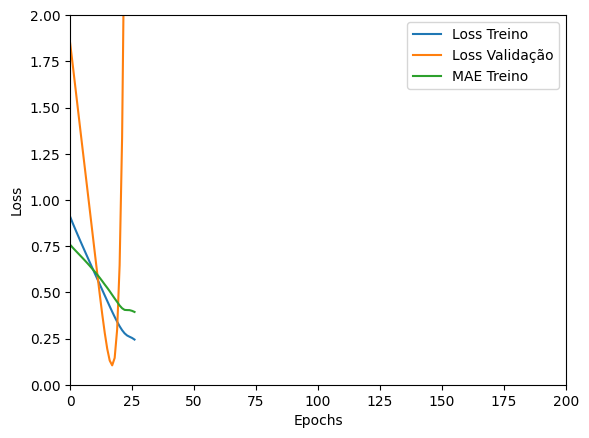

Tempo de treino: 0.1373851736386617 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13974156975746155 , MAE = 0.2679454982280731'

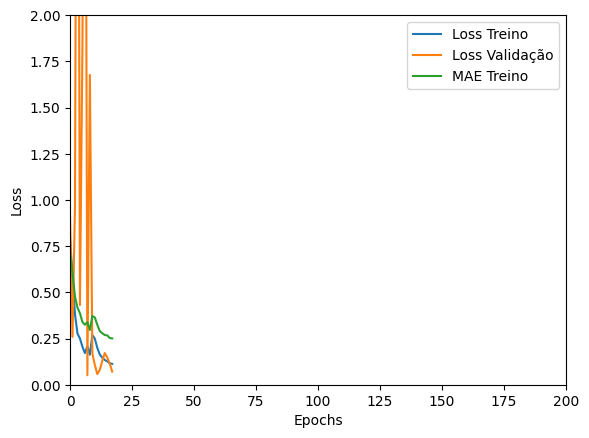

Tempo de treino: 0.1836803396542867 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.153250053524971 , MAE = 0.2841724455356598'

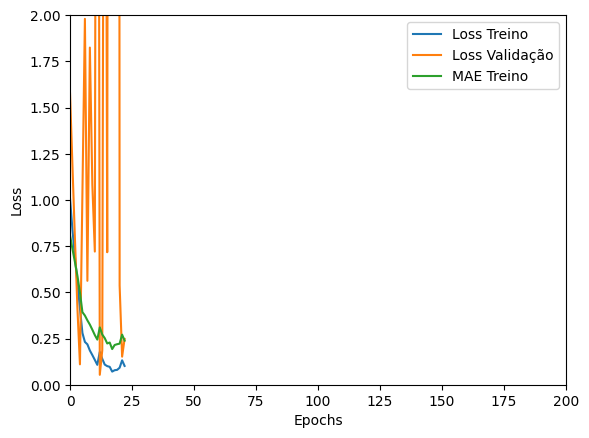

Tempo de treino: 0.2114604353904724 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.604780912399292 , MAE = 0.6026129126548767'

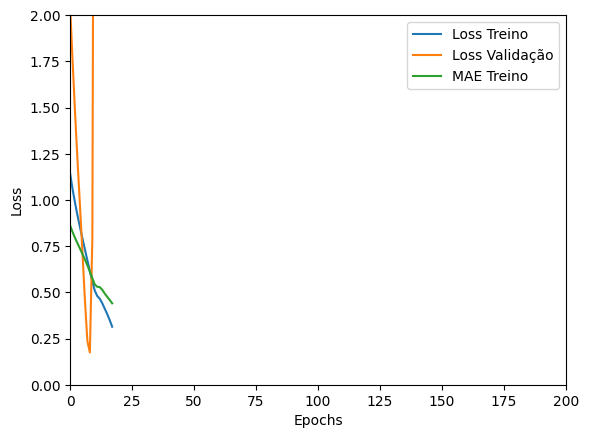

Tempo de treino: 0.08695557514826456 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35137954354286194 , MAE = 0.45224666595458984'

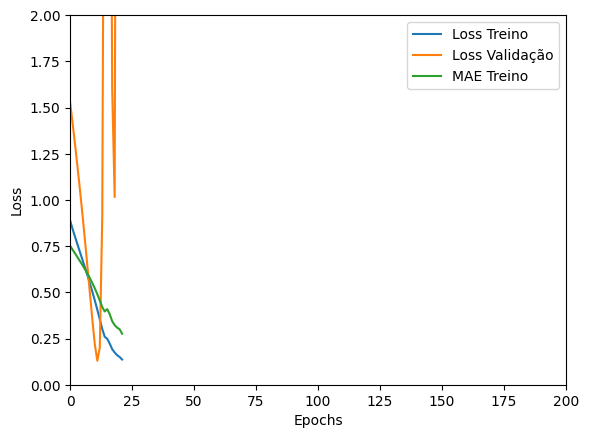

Tempo de treino: 0.0930069883664449 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22096797823905945 , MAE = 0.3351871371269226'

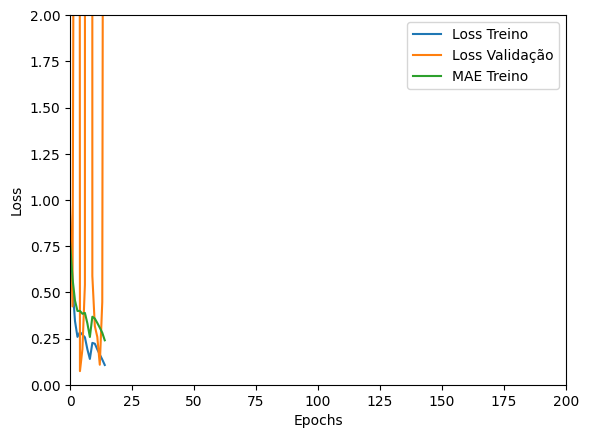

Tempo de treino: 0.22437380154927572 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4371531903743744 , MAE = 0.5144308805465698'

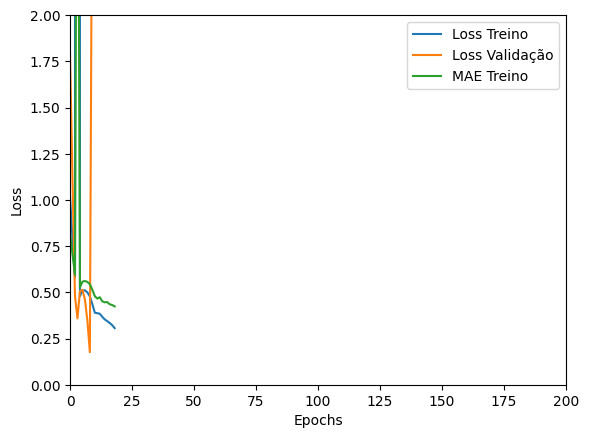

Tempo de treino: 0.22028344472249348 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40966007113456726 , MAE = 0.491764098405838'

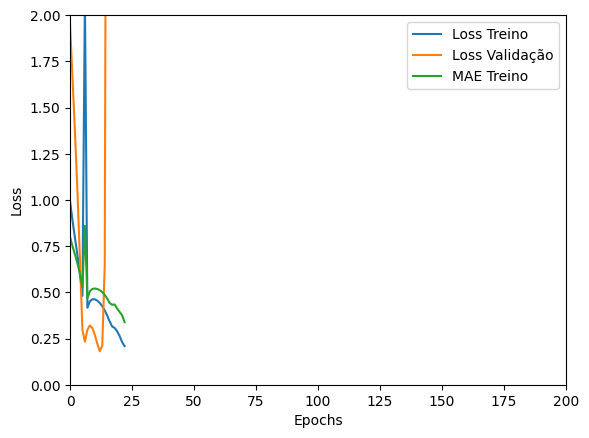

Tempo de treino: 0.12435892820358277 minutos


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v1 , timesteps=36, units=64, batch=32


'TRAINING set. Loss = 0.3561493456363678 , MAE = 0.45657968521118164'

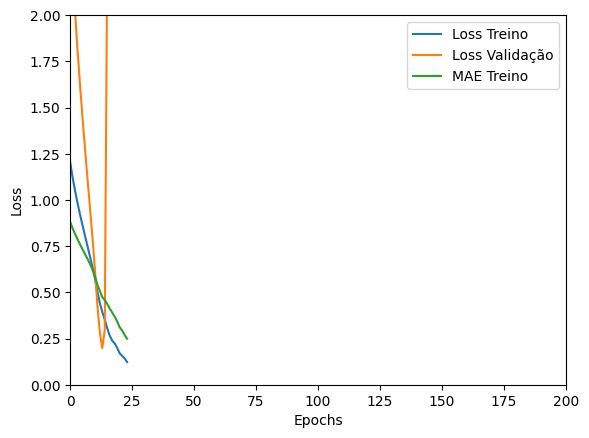

Tempo de treino: 0.12871833642323813 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=36, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1462721824645996 , MAE = 0.2775554955005646'

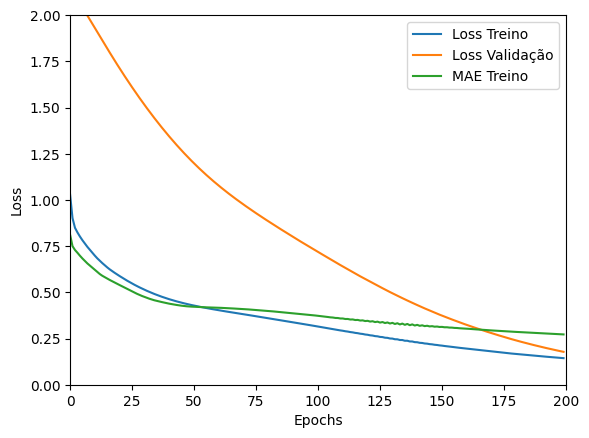

Tempo de treino: 1.4079464515050253 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6194775104522705 , MAE = 0.6088467240333557'

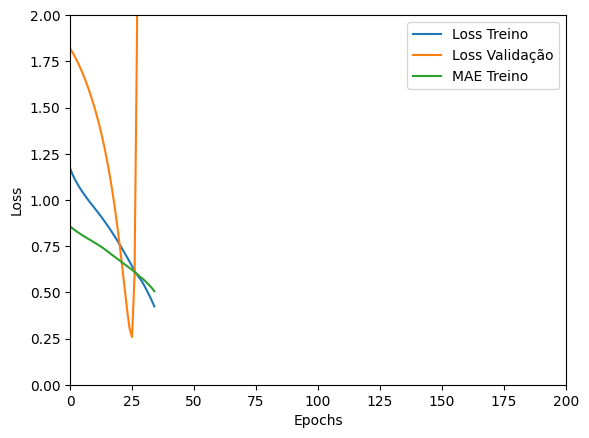

Tempo de treino: 0.1782821774482727 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7057710886001587 , MAE = 0.6473267674446106'

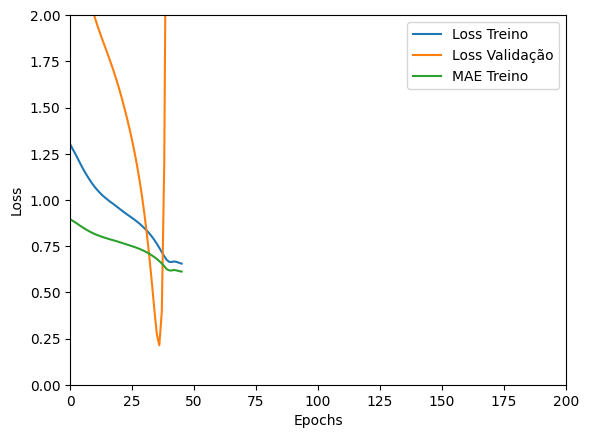

Tempo de treino: 0.13916663328806558 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.451313316822052 , MAE = 0.5175749659538269'

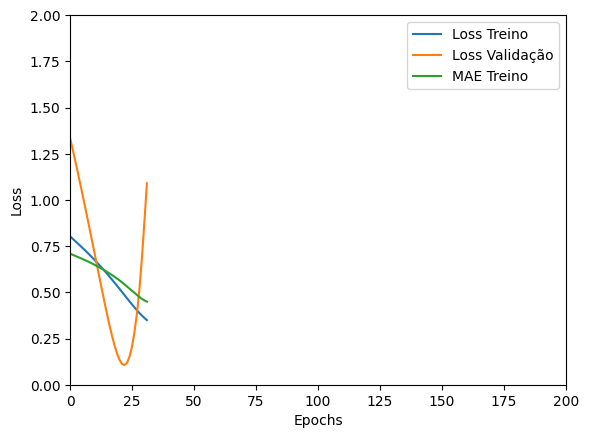

Tempo de treino: 0.1498620589574178 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18517105281352997 , MAE = 0.31748726963996887'

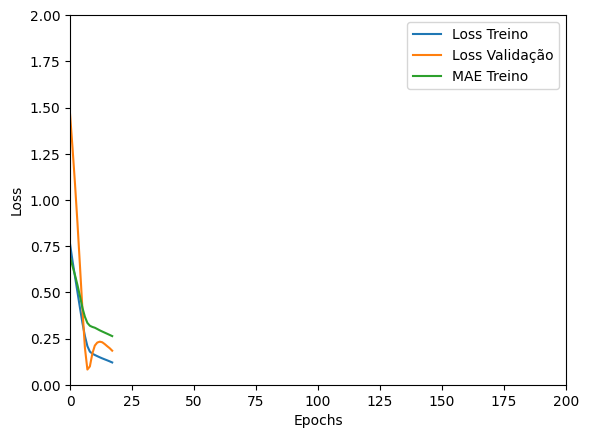

Tempo de treino: 0.19071648120880128 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40583547949790955 , MAE = 0.48435476422309875'

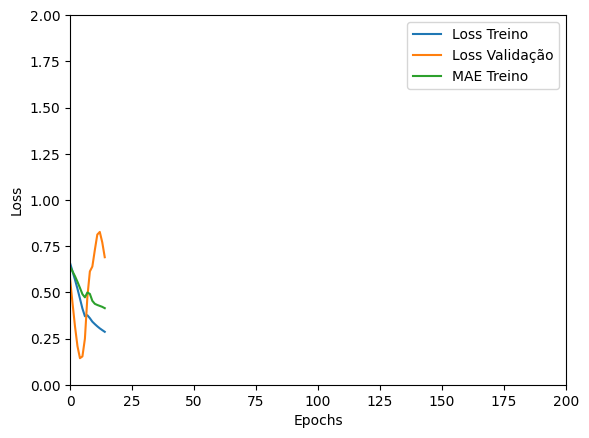

Tempo de treino: 0.12179702917734782 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3198232352733612 , MAE = 0.40538403391838074'

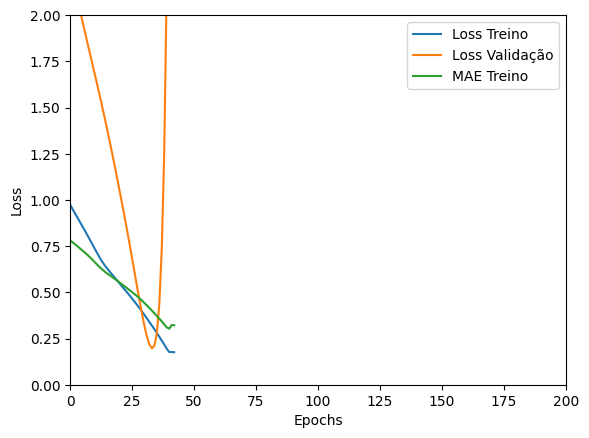

Tempo de treino: 0.21293613115946453 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6047053933143616 , MAE = 0.6014047265052795'

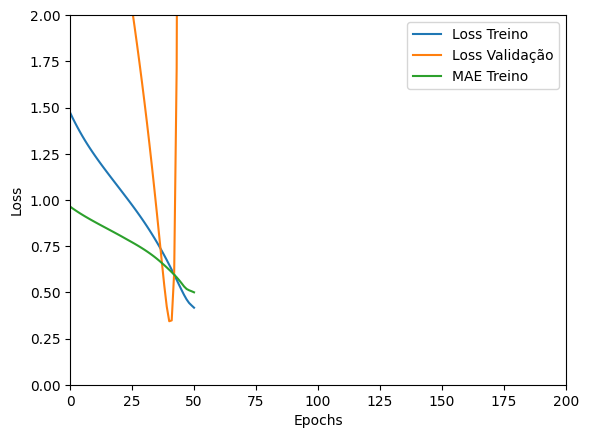

Tempo de treino: 0.125809903939565 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5687017440795898 , MAE = 0.5864303708076477'

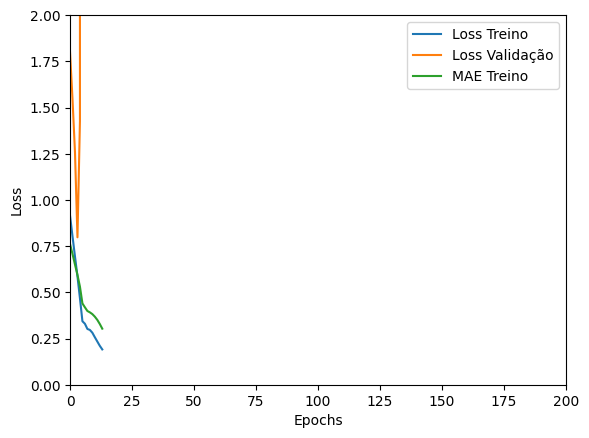

Tempo de treino: 0.14770352443059284 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.333408385515213 , MAE = 0.43131953477859497'

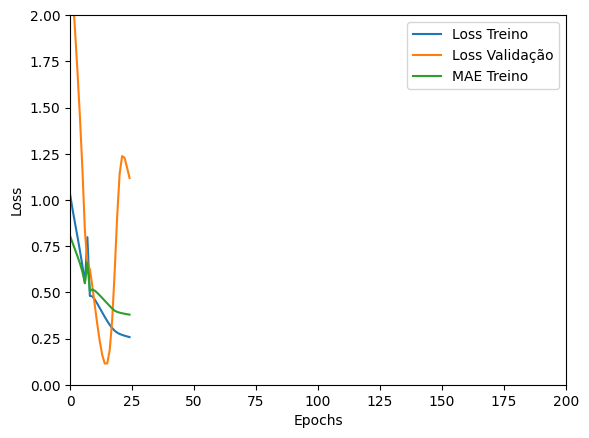

Tempo de treino: 0.2087283492088318 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4938303828239441 , MAE = 0.5324386358261108'

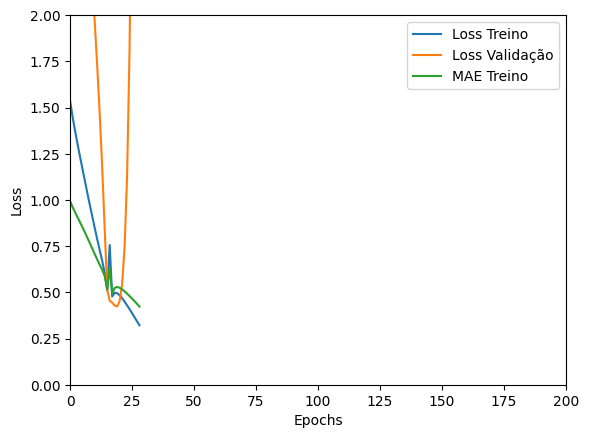

Tempo de treino: 0.11667007605234782 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36473989486694336 , MAE = 0.43013086915016174'

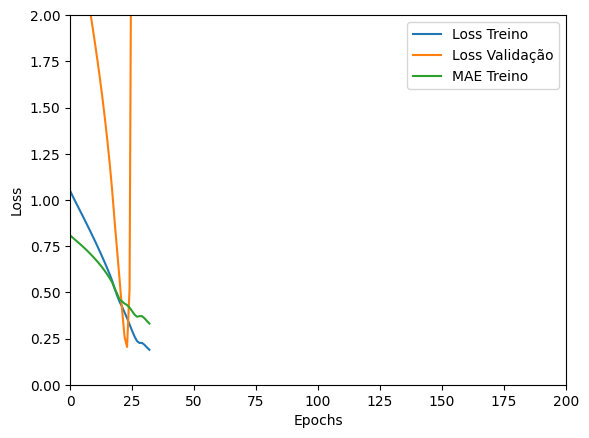

Tempo de treino: 0.1315912127494812 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5074620246887207 , MAE = 0.5432979464530945'

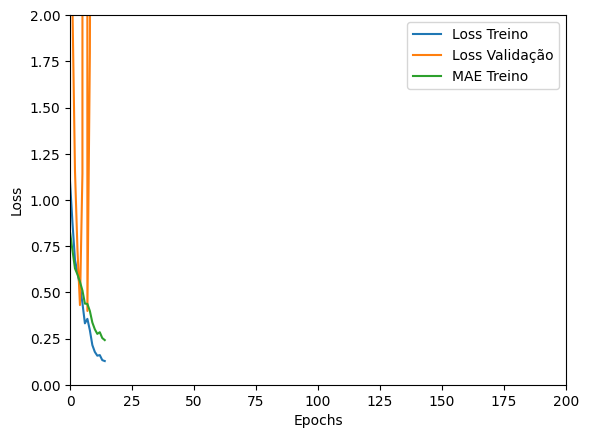

Tempo de treino: 0.1681735873222351 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35433560609817505 , MAE = 0.4318637251853943'

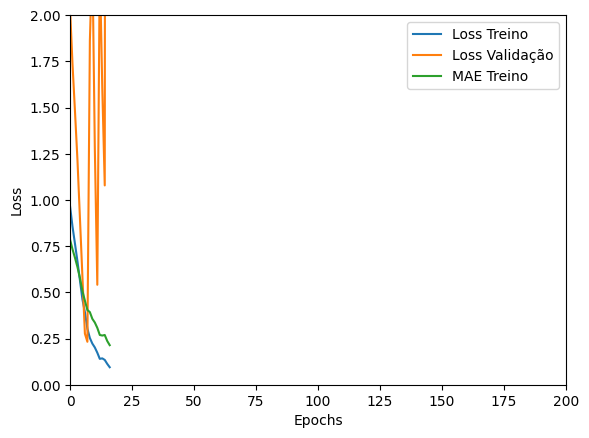

Tempo de treino: 0.13344054619471232 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37577715516090393 , MAE = 0.4638878107070923'

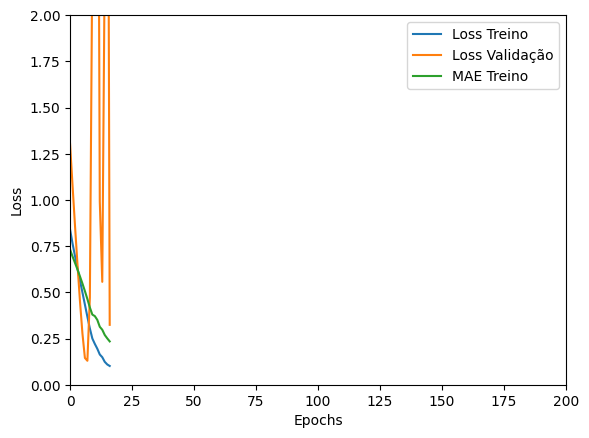

Tempo de treino: 0.12624177138010662 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3438602089881897 , MAE = 0.43991002440452576'

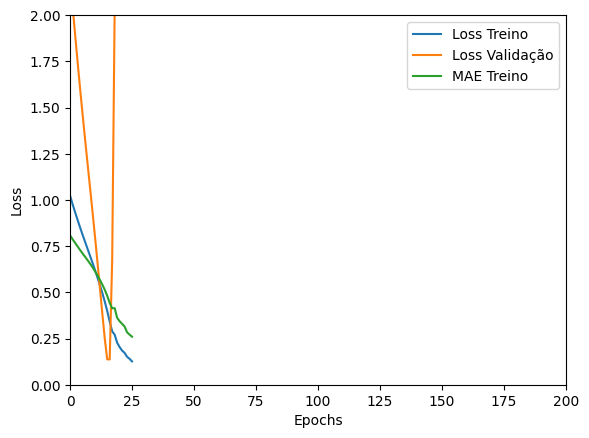

Tempo de treino: 0.10035061438878377 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28765055537223816 , MAE = 0.40723785758018494'

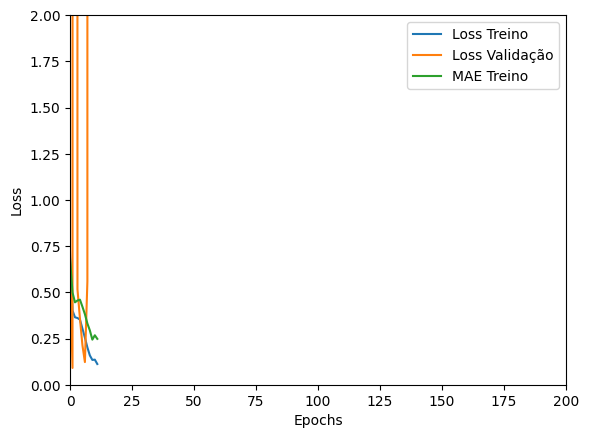

Tempo de treino: 0.13215753237406414 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18185502290725708 , MAE = 0.31542688608169556'

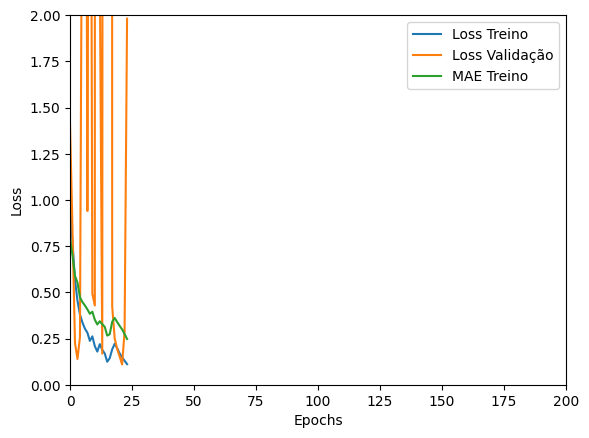

Tempo de treino: 0.24423545201619465 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4477808475494385 , MAE = 0.5144526362419128'

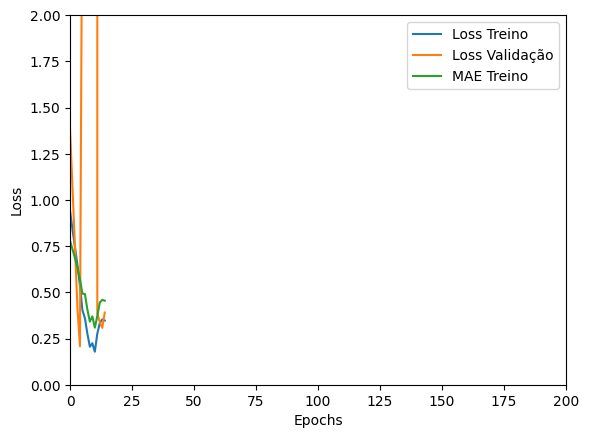

Tempo de treino: 0.1417572021484375 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3015058934688568 , MAE = 0.4247181713581085'

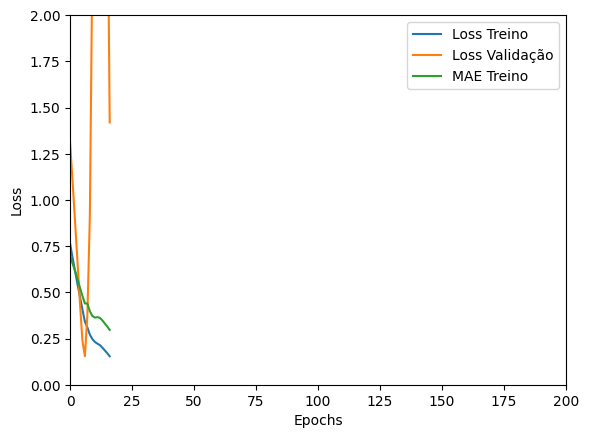

Tempo de treino: 0.13405555884043377 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=36, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22936858236789703 , MAE = 0.3602515459060669'

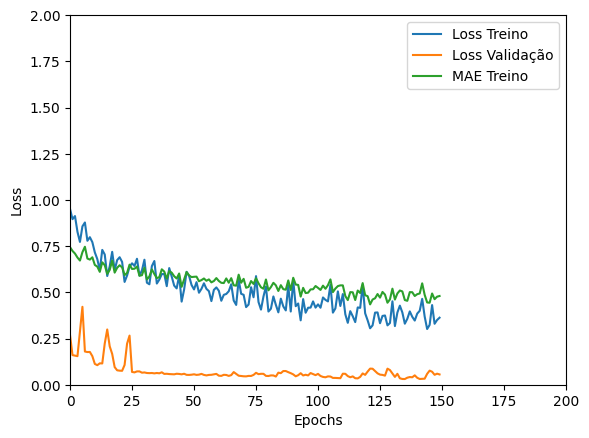

Tempo de treino: 1.4102111776669821 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2091374546289444 , MAE = 0.3510809540748596'

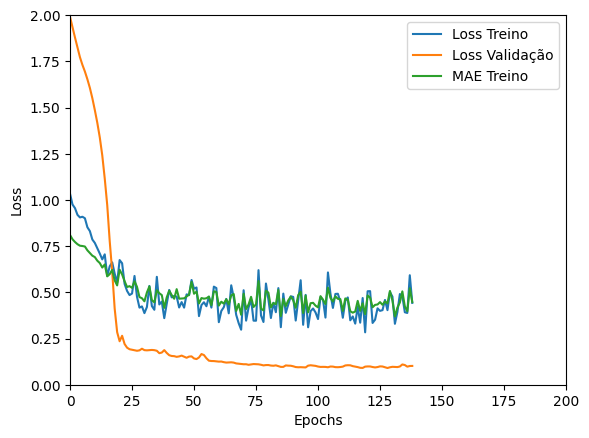

Tempo de treino: 0.5607796788215638 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20350033044815063 , MAE = 0.3439480662345886'

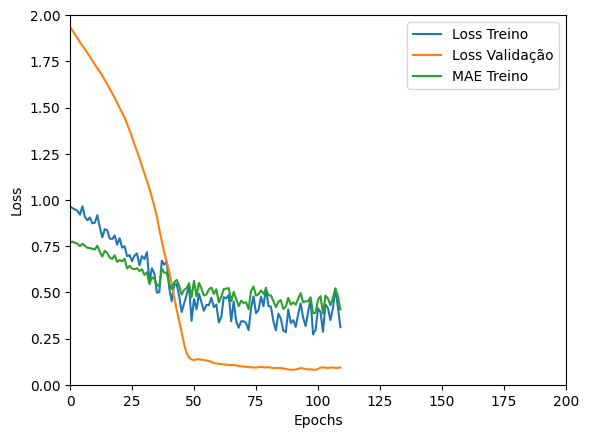

Tempo de treino: 0.39461338917414346 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7392602562904358 , MAE = 0.6457154154777527'

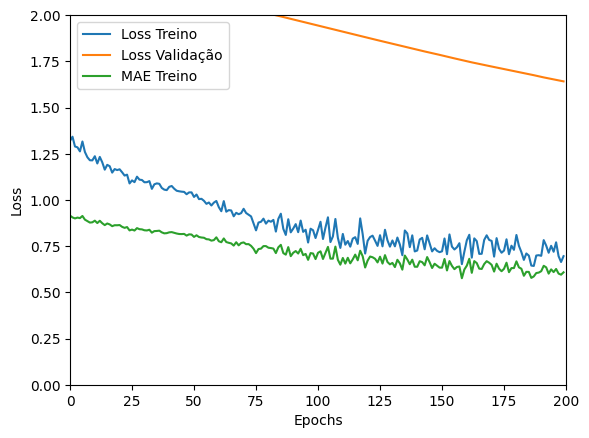

Tempo de treino: 0.3403363903363546 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5001055002212524 , MAE = 0.5665871500968933'

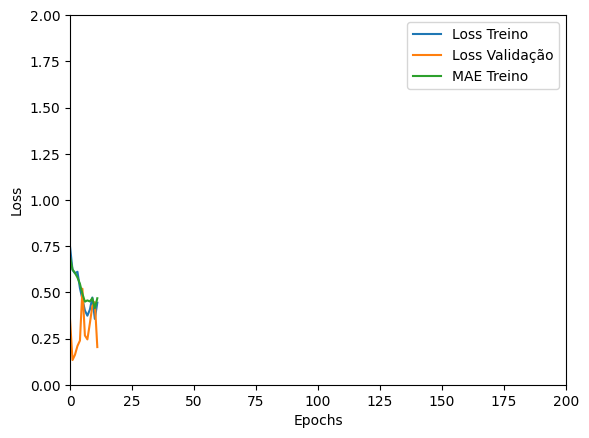

Tempo de treino: 0.2449371298154195 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5928564667701721 , MAE = 0.6149235367774963'

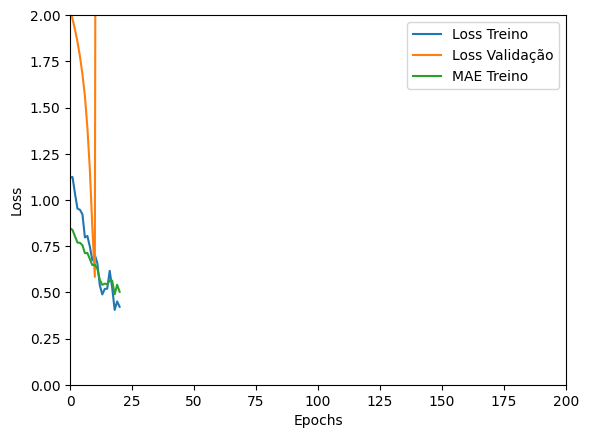

Tempo de treino: 0.14866748650868733 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5023525953292847 , MAE = 0.536816418170929'

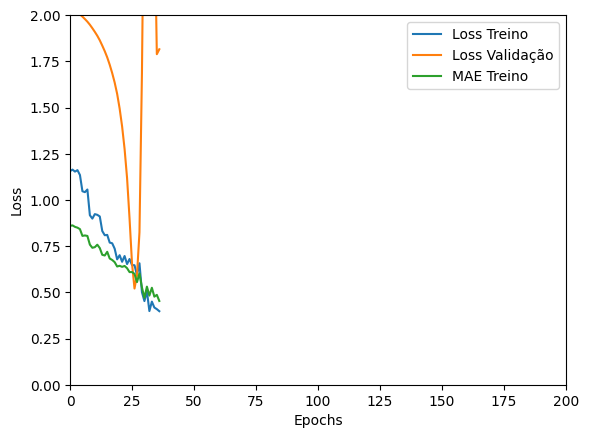

Tempo de treino: 0.21498048305511475 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6220389008522034 , MAE = 0.6103366613388062'

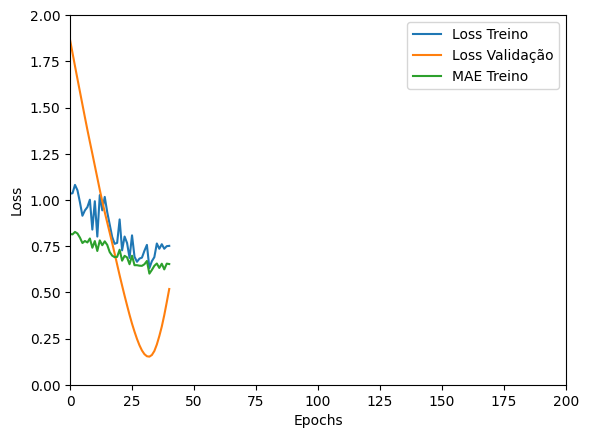

Tempo de treino: 0.1307422677675883 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5882773995399475 , MAE = 0.5886024236679077'

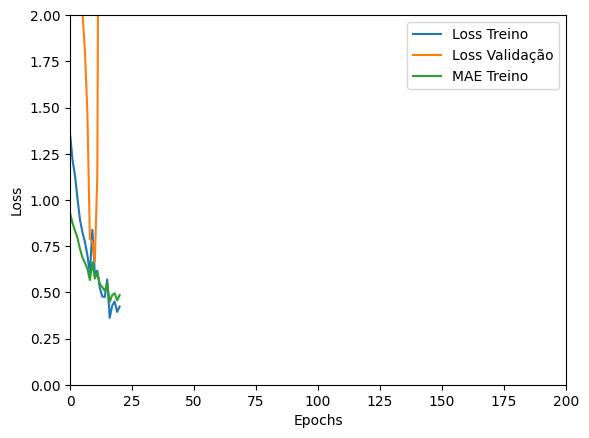

Tempo de treino: 0.21808401346206666 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5925208330154419 , MAE = 0.5741532444953918'

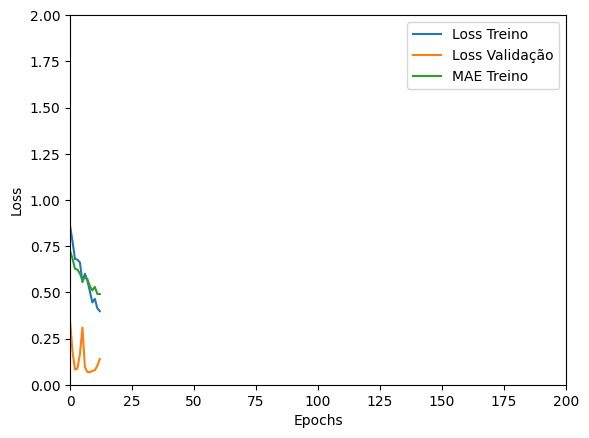

Tempo de treino: 0.09100948572158814 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5080334544181824 , MAE = 0.549211323261261'

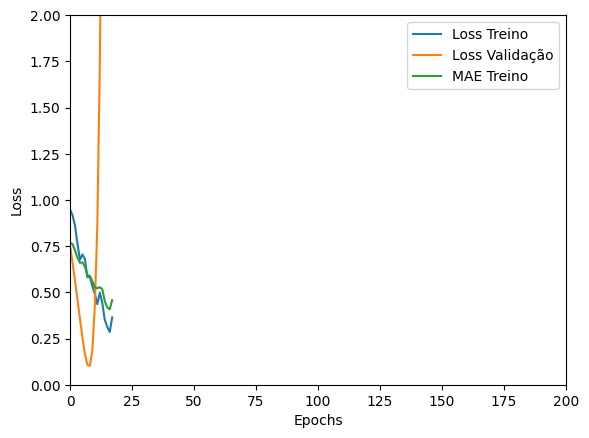

Tempo de treino: 0.12405540148417155 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5900530815124512 , MAE = 0.5906810760498047'

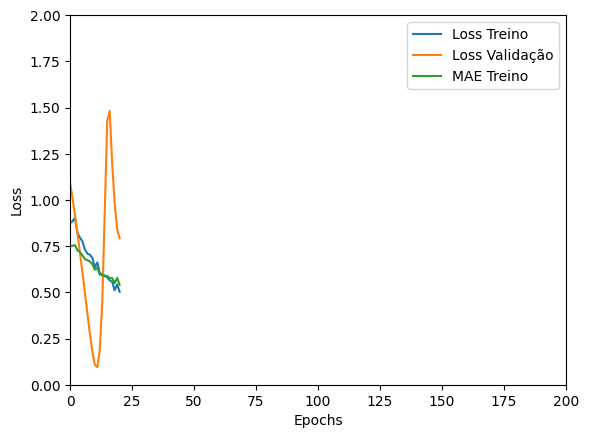

Tempo de treino: 0.1113095998764038 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09132345765829086 , MAE = 0.2233591377735138'

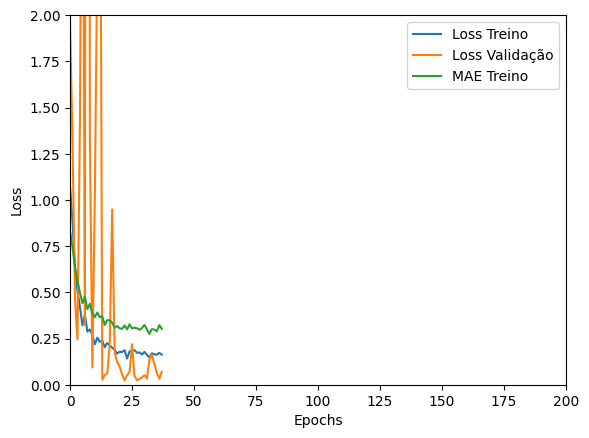

Tempo de treino: 0.34173978567123414 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1546127051115036 , MAE = 0.27843472361564636'

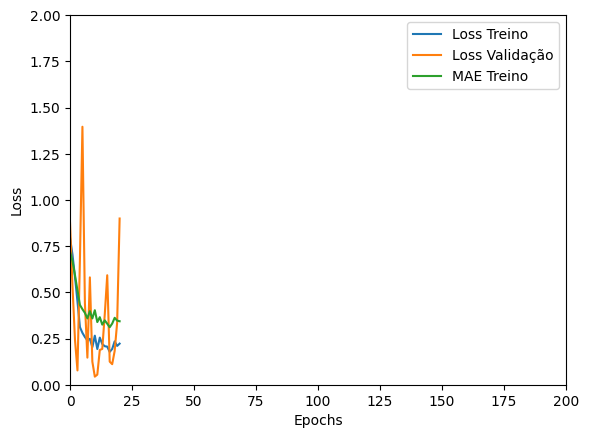

Tempo de treino: 0.21599260568618775 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3813968300819397 , MAE = 0.46552038192749023'

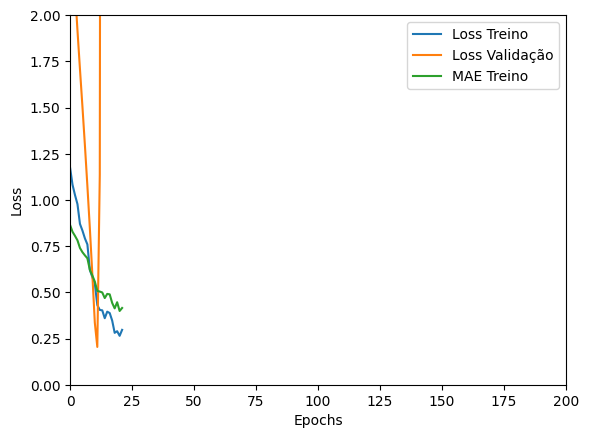

Tempo de treino: 0.12582322359085082 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32219037413597107 , MAE = 0.4043771028518677'

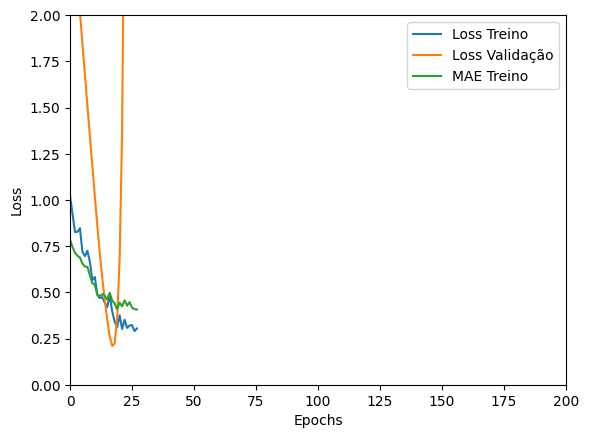

Tempo de treino: 0.08673368295033773 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08841651678085327 , MAE = 0.21613122522830963'

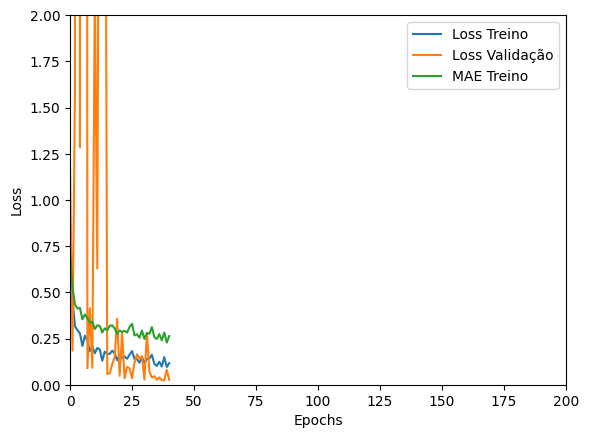

Tempo de treino: 0.3670759439468384 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07856492698192596 , MAE = 0.20472554862499237'

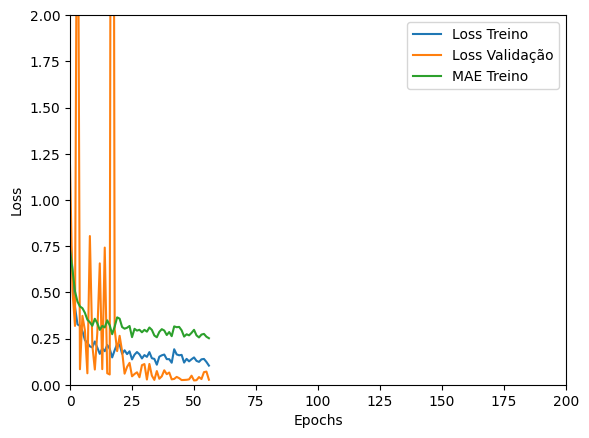

Tempo de treino: 0.34786195357640587 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.45147067308425903 , MAE = 0.5140222311019897'

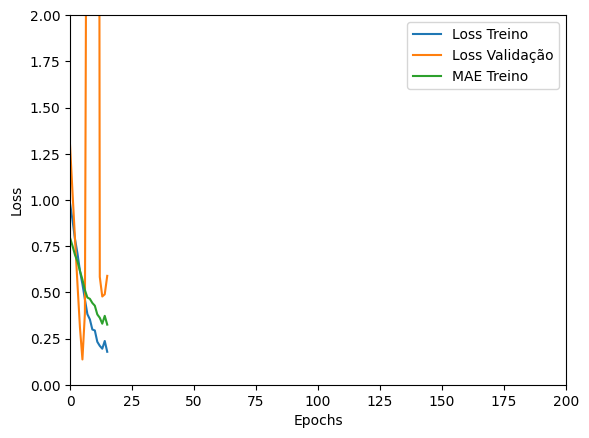

Tempo de treino: 0.10731813510258993 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3971286714076996 , MAE = 0.43806561827659607'

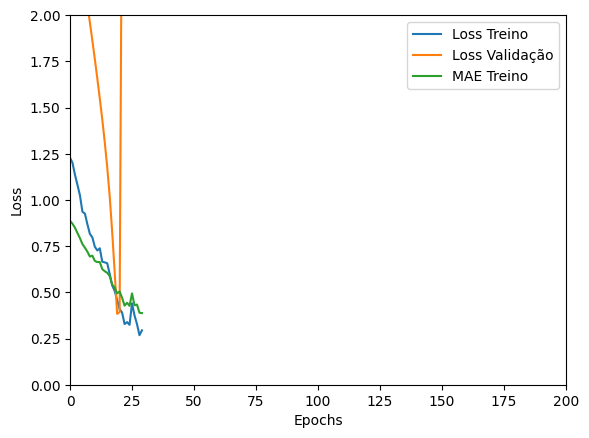

Tempo de treino: 0.10289498170216878 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com GRU_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09347495436668396 , MAE = 0.24332067370414734'

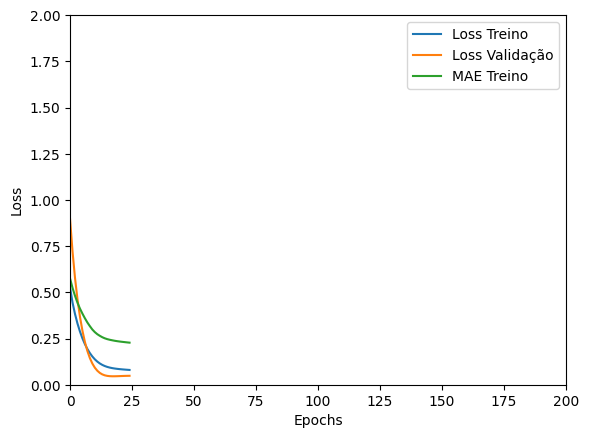

Tempo de treino: 0.40692947308222455 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14085182547569275 , MAE = 0.289673388004303'

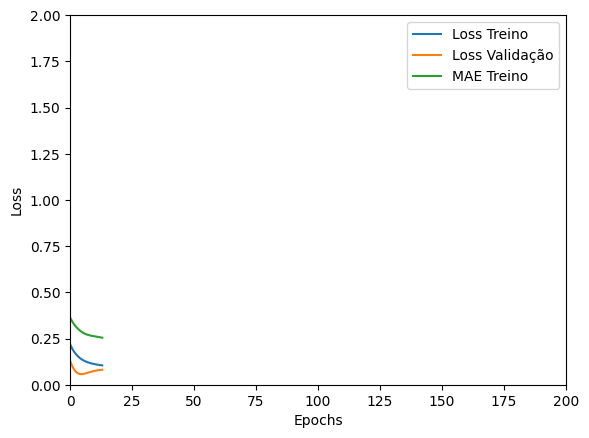

Tempo de treino: 0.14976177215576172 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13299202919006348 , MAE = 0.293944776058197'

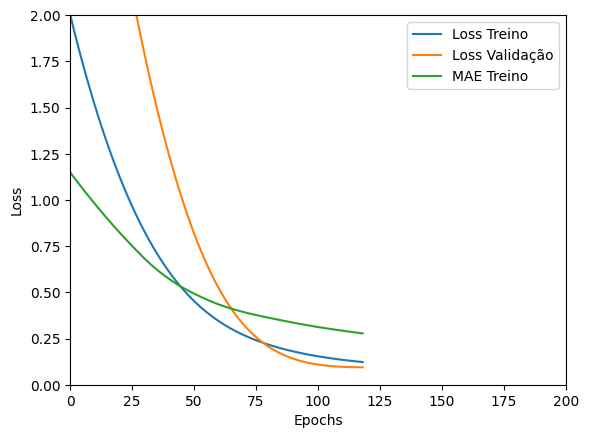

Tempo de treino: 0.40881576935450237 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11915694177150726 , MAE = 0.27869588136672974'

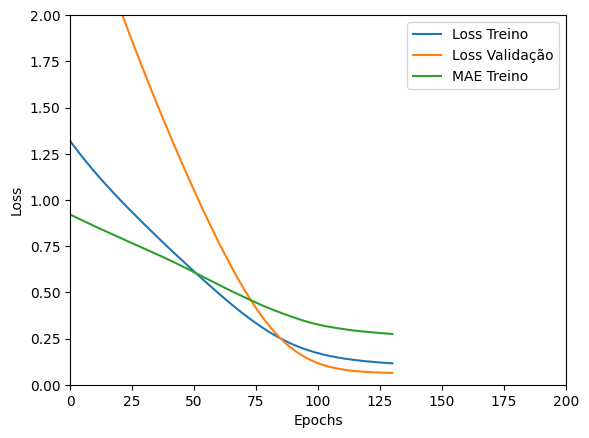

Tempo de treino: 0.31681819756825763 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.047773417085409164 , MAE = 0.1684238165616989'

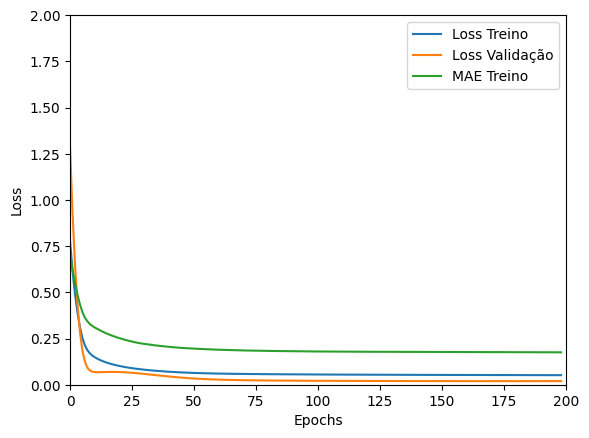

Tempo de treino: 2.426419480641683 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13179649412631989 , MAE = 0.29309606552124023'

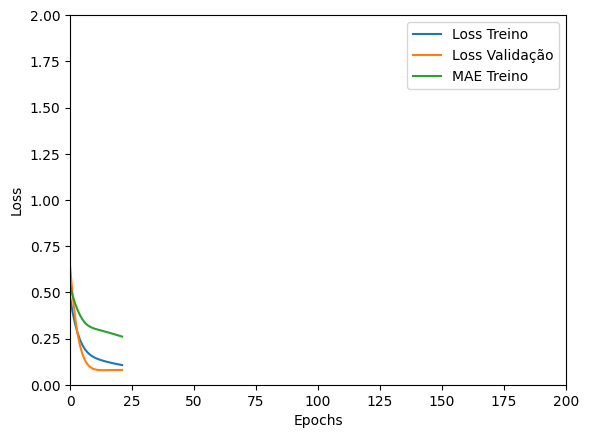

Tempo de treino: 0.22914273341496785 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1605534702539444 , MAE = 0.32311195135116577'

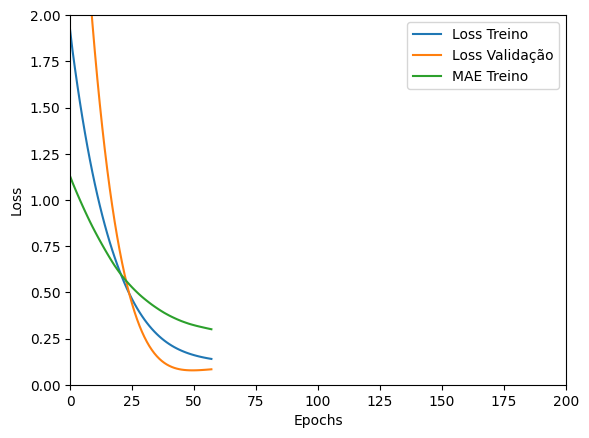

Tempo de treino: 0.2107271949450175 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1344042867422104 , MAE = 0.28221091628074646'

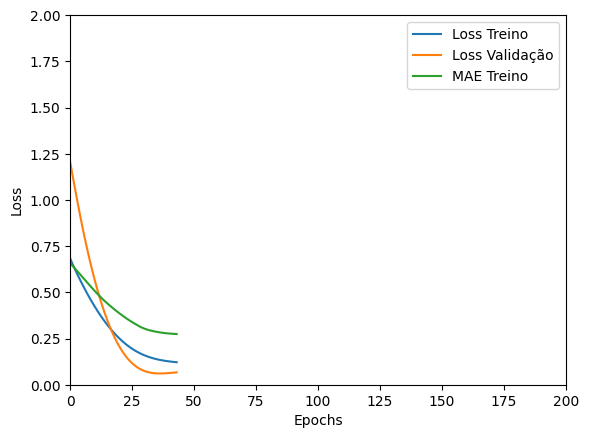

Tempo de treino: 0.2605462352434794 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04669838026165962 , MAE = 0.168401837348938'

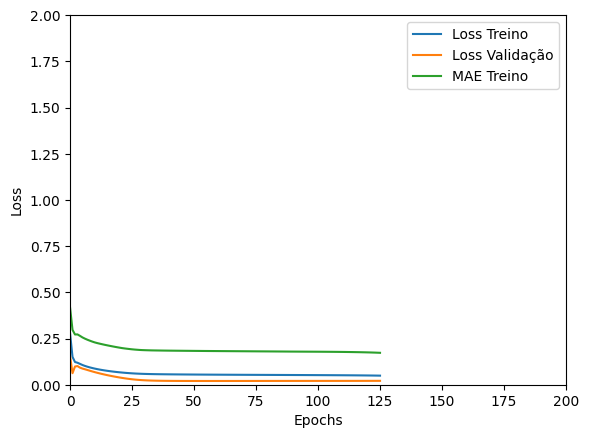

Tempo de treino: 1.424940299987793 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14125284552574158 , MAE = 0.29146361351013184'

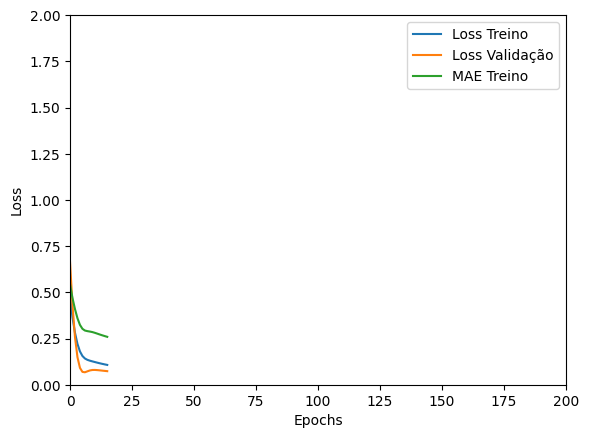

Tempo de treino: 0.14168400367101033 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12972170114517212 , MAE = 0.27723097801208496'

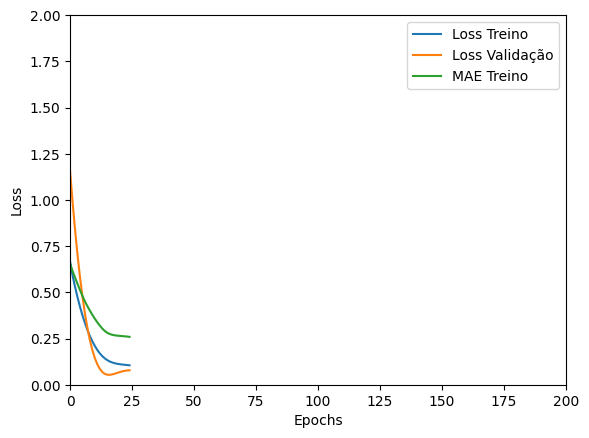

Tempo de treino: 0.13670443296432494 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.216212660074234 , MAE = 0.3762570321559906'

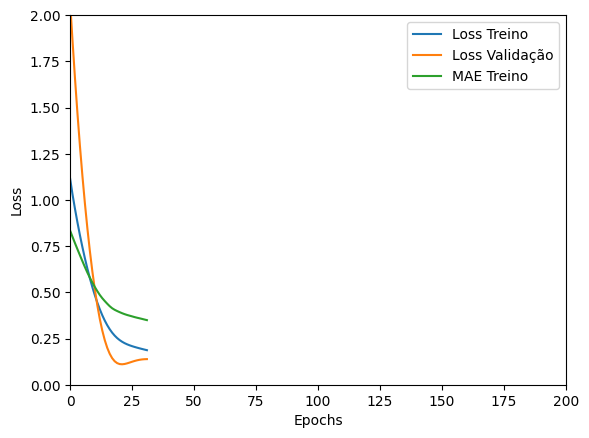

Tempo de treino: 0.2194036841392517 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04672718048095703 , MAE = 0.1674780696630478'

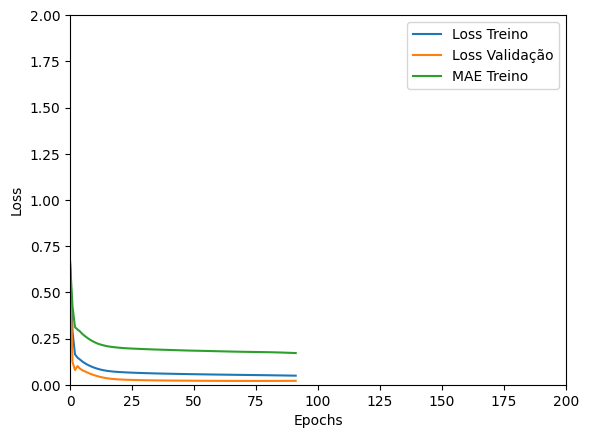

Tempo de treino: 0.8766030351320903 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04828537255525589 , MAE = 0.17020119726657867'

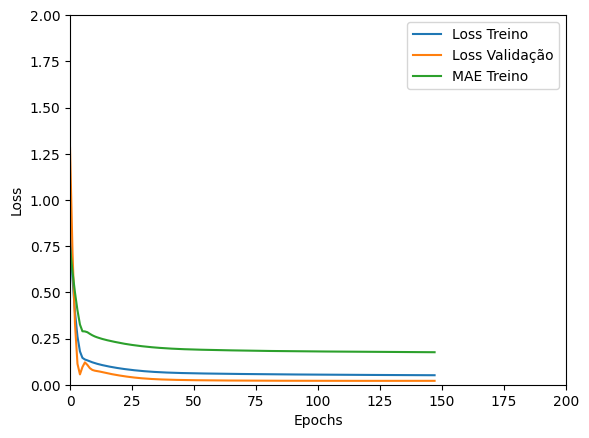

Tempo de treino: 1.4179014364878337 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27563831210136414 , MAE = 0.40766048431396484'

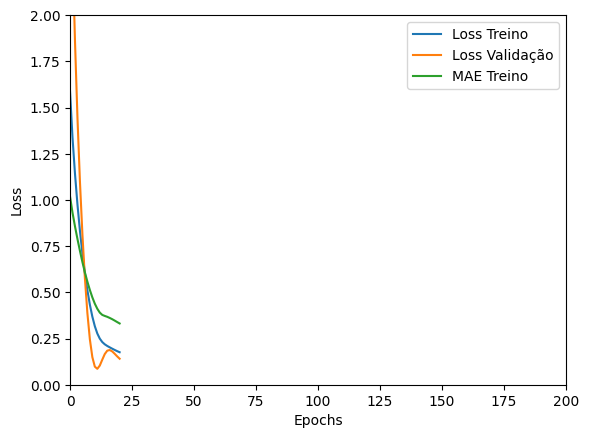

Tempo de treino: 0.13483115434646606 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1514366865158081 , MAE = 0.29605090618133545'

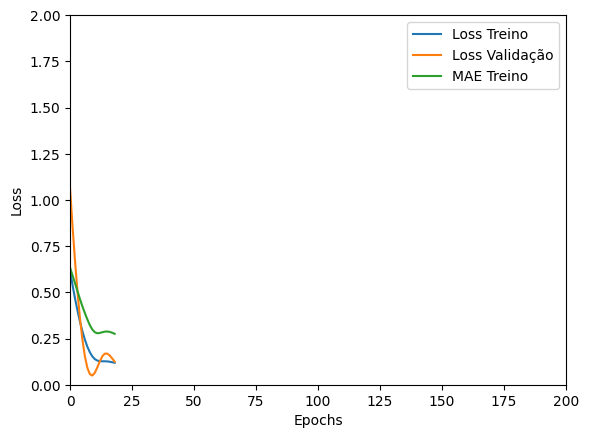

Tempo de treino: 0.09105109771092733 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05191333219408989 , MAE = 0.17351219058036804'

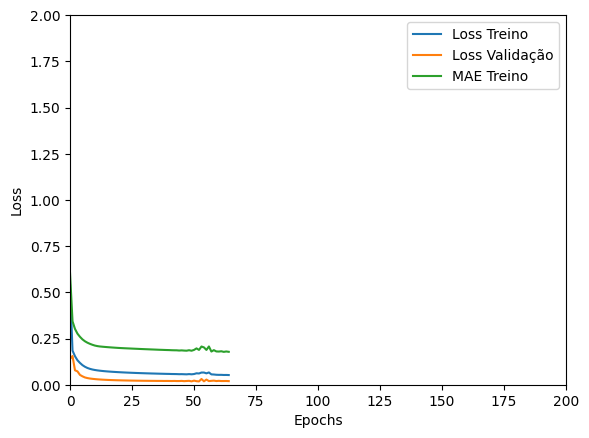

Tempo de treino: 0.7687735716501872 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04894952476024628 , MAE = 0.16596485674381256'

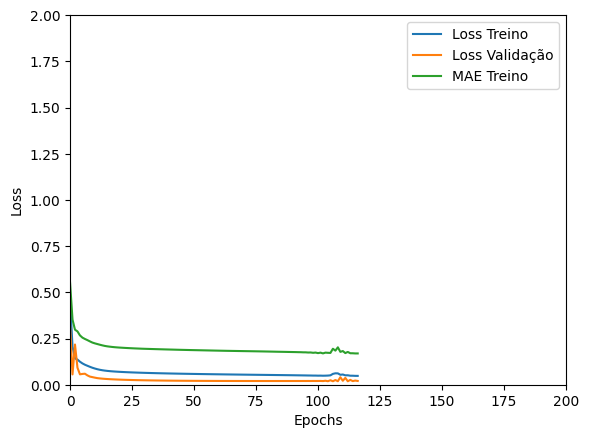

Tempo de treino: 0.6753564357757569 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048846423625946045 , MAE = 0.17019079625606537'

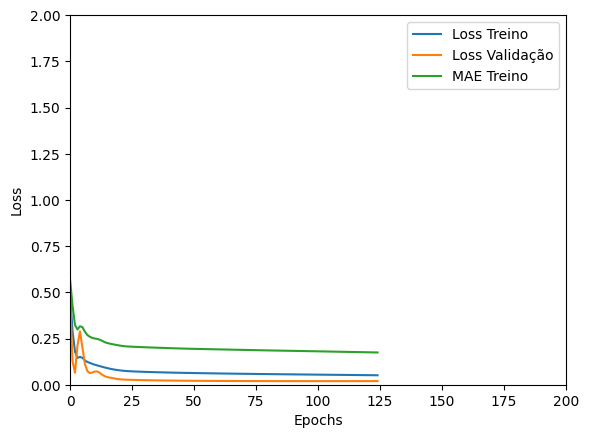

Tempo de treino: 0.44176336129506427 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2151464968919754 , MAE = 0.3526252210140228'

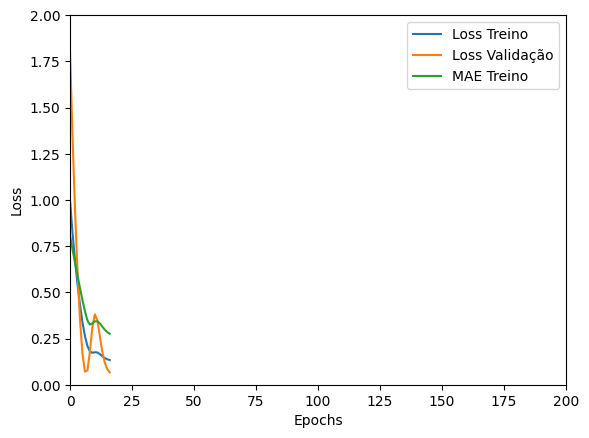

Tempo de treino: 0.13586137294769288 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1292761117219925 , MAE = 0.25284895300865173'

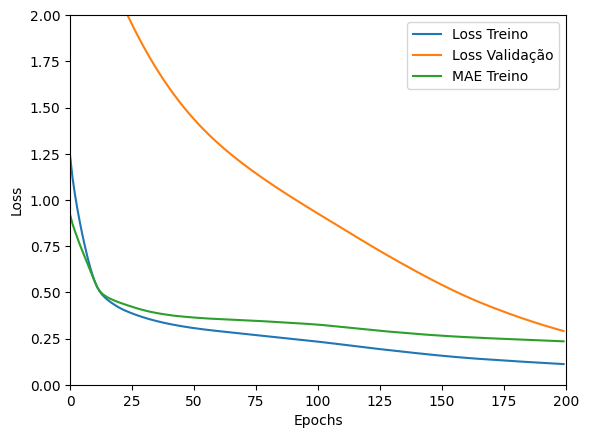

Tempo de treino: 0.7607180515925089 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.45501482486724854 , MAE = 0.5096409320831299'

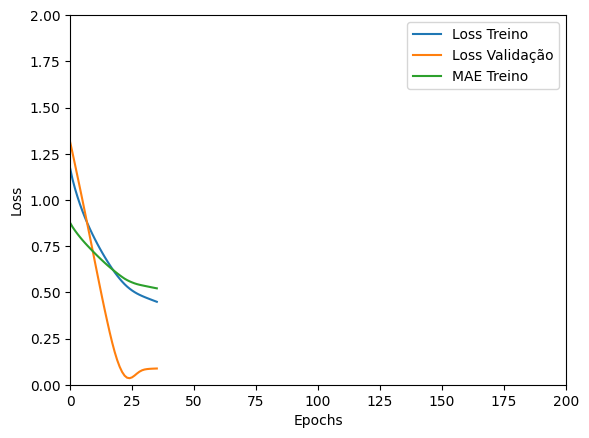

Tempo de treino: 0.1440018057823181 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38674280047416687 , MAE = 0.471316397190094'

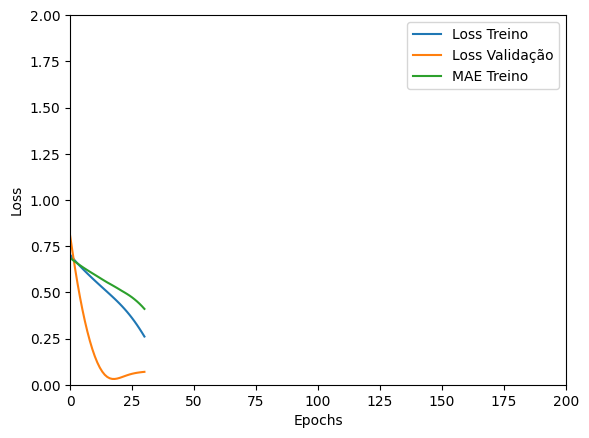

Tempo de treino: 0.12843630313873292 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14181792736053467 , MAE = 0.2742478847503662'

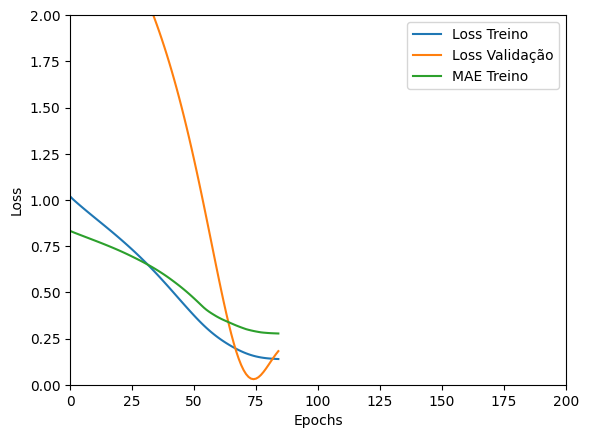

Tempo de treino: 0.21166298389434815 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1393137276172638 , MAE = 0.2824239134788513'

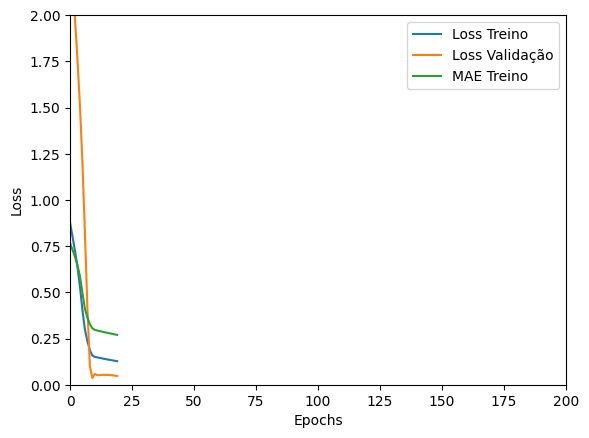

Tempo de treino: 0.09996116161346436 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13540343940258026 , MAE = 0.2740801274776459'

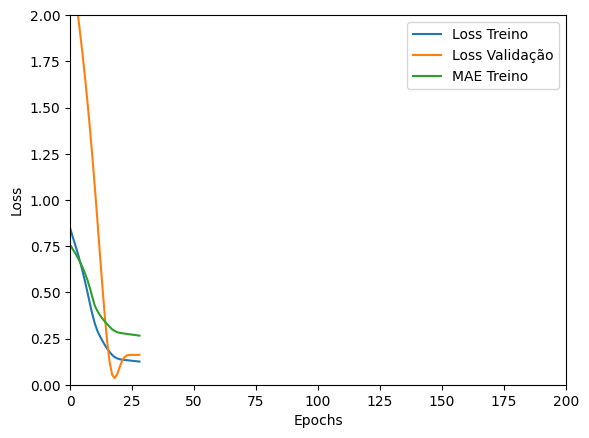

Tempo de treino: 0.10847817659378052 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15585124492645264 , MAE = 0.29178014397621155'

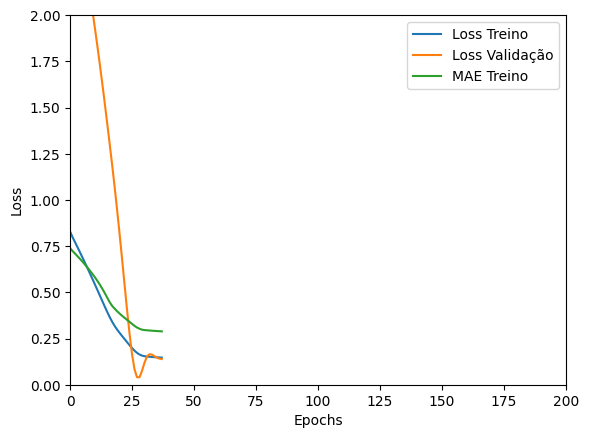

Tempo de treino: 0.08970409234364828 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13783928751945496 , MAE = 0.2837945818901062'

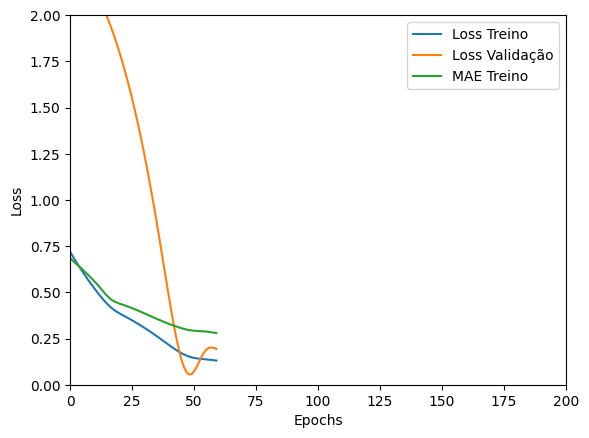

Tempo de treino: 0.157783842086792 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14687052369117737 , MAE = 0.29056674242019653'

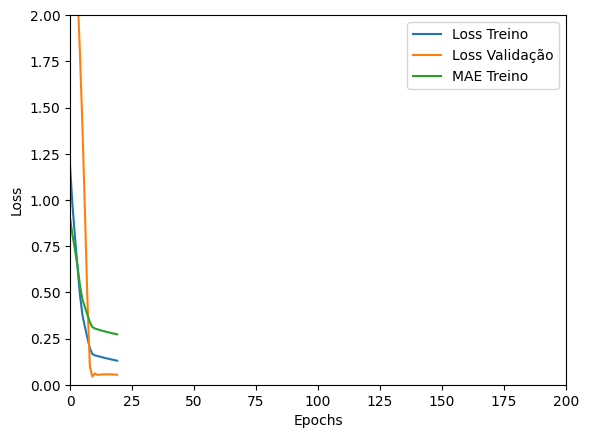

Tempo de treino: 0.13614965677261354 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15712638199329376 , MAE = 0.30132243037223816'

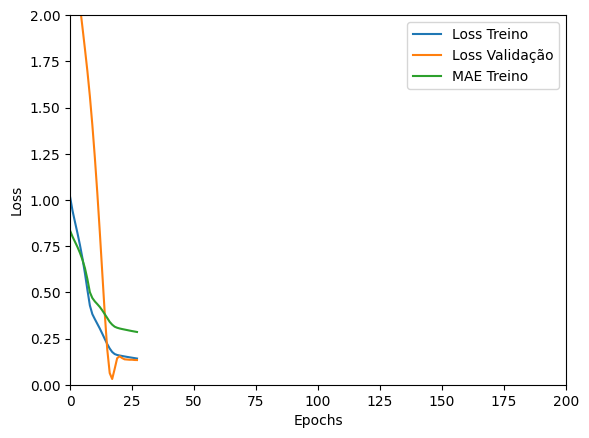

Tempo de treino: 0.1304548978805542 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14197668433189392 , MAE = 0.2814452648162842'

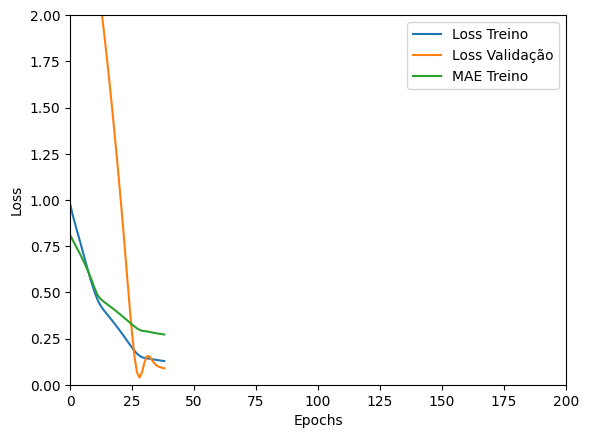

Tempo de treino: 0.10912595589955648 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13896210491657257 , MAE = 0.27294114232063293'

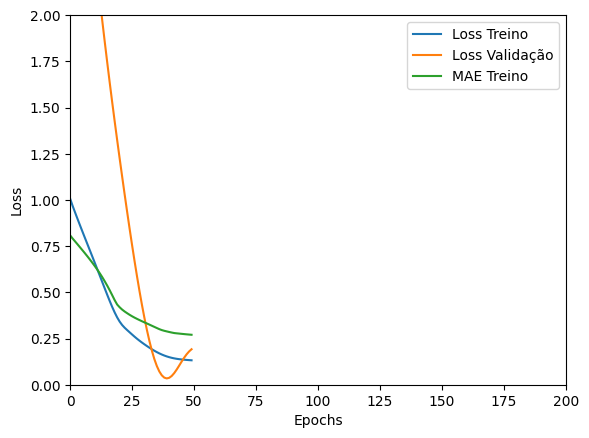

Tempo de treino: 0.12717267274856567 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14950379729270935 , MAE = 0.2917628884315491'

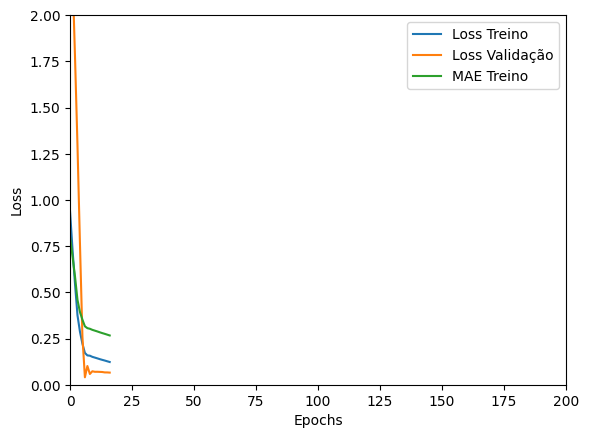

Tempo de treino: 0.10265149275461832 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12341944873332977 , MAE = 0.26766058802604675'

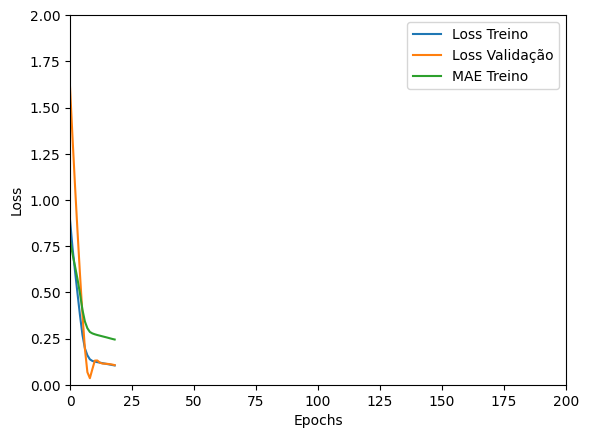

Tempo de treino: 0.08128719329833985 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14178940653800964 , MAE = 0.29010170698165894'

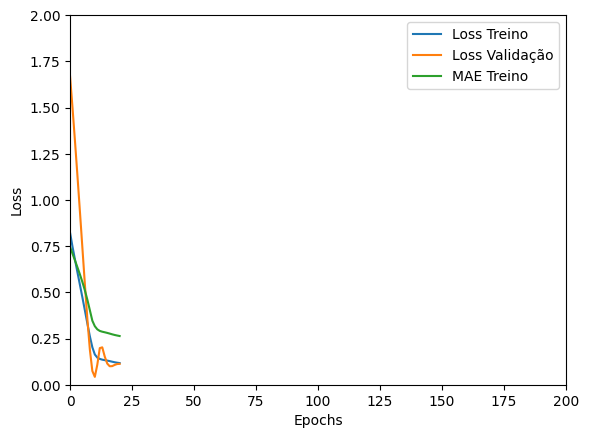

Tempo de treino: 0.12560893297195436 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14600618183612823 , MAE = 0.2808365523815155'

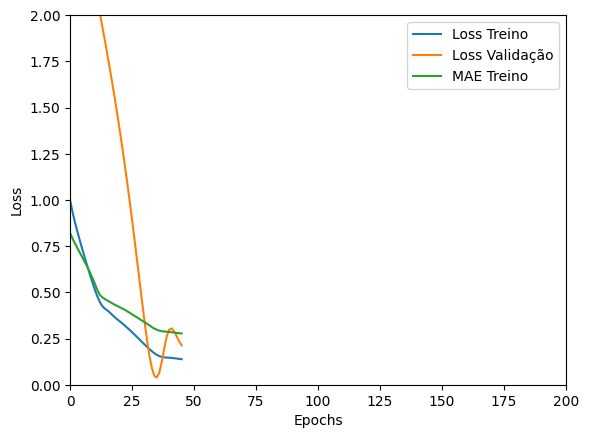

Tempo de treino: 0.10854673782984416 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1421816200017929 , MAE = 0.28421714901924133'

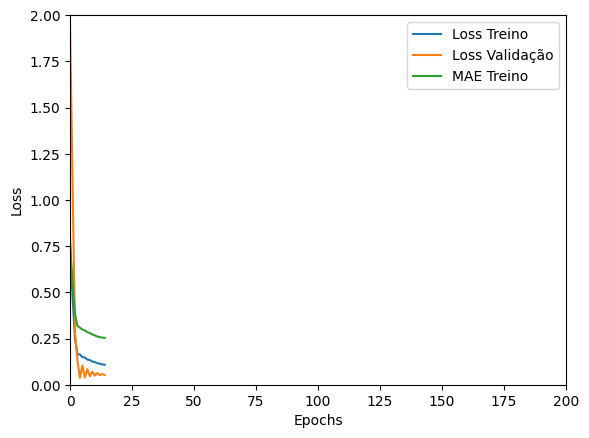

Tempo de treino: 0.13805591662724812 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14320404827594757 , MAE = 0.29045116901397705'

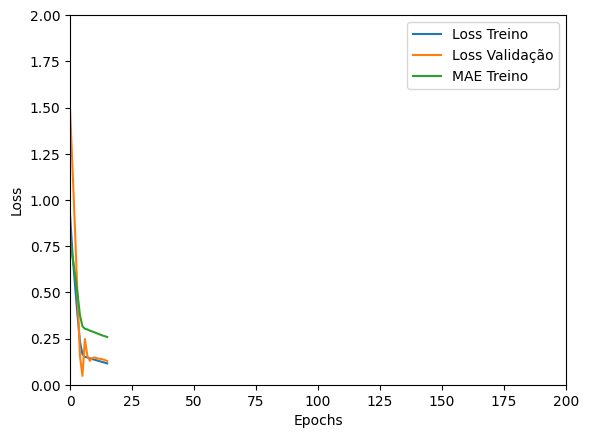

Tempo de treino: 0.09032737414042155 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14309461414813995 , MAE = 0.29043692350387573'

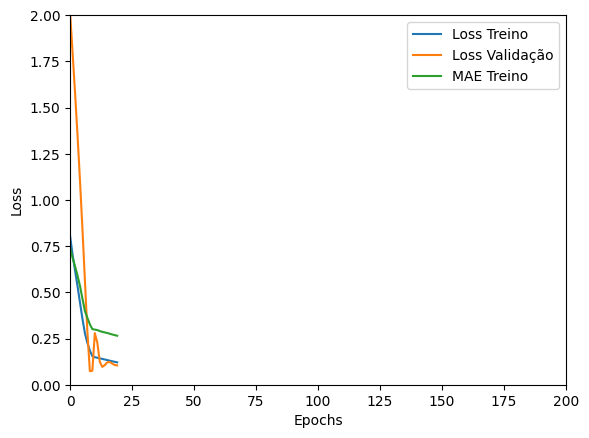

Tempo de treino: 0.07874398628870646 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14723370969295502 , MAE = 0.28809478878974915'

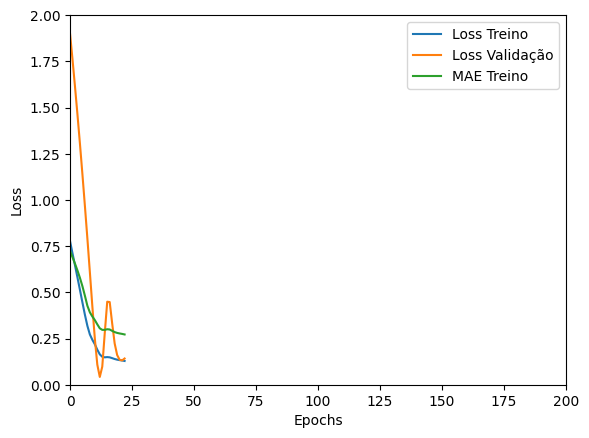

Tempo de treino: 0.08187352816263835 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=6, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4784941077232361 , MAE = 0.5259469151496887'

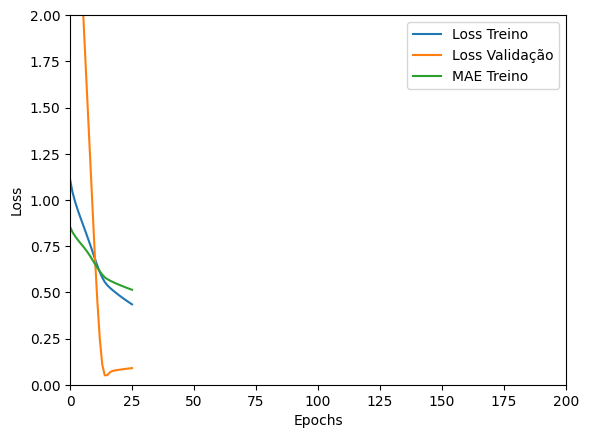

Tempo de treino: 0.13229848941167197 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.567154586315155 , MAE = 0.5752143263816833'

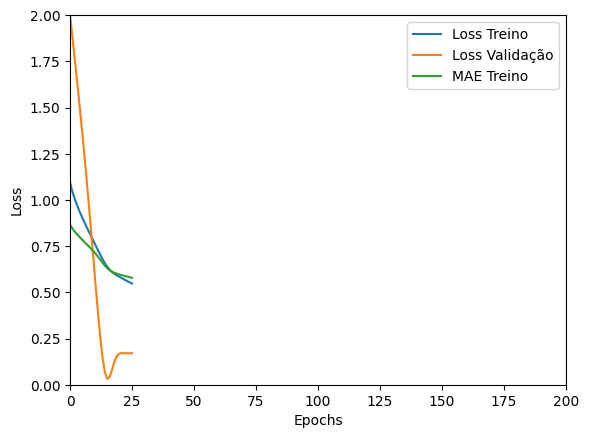

Tempo de treino: 0.14594847361246746 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11402608454227448 , MAE = 0.24921633303165436'

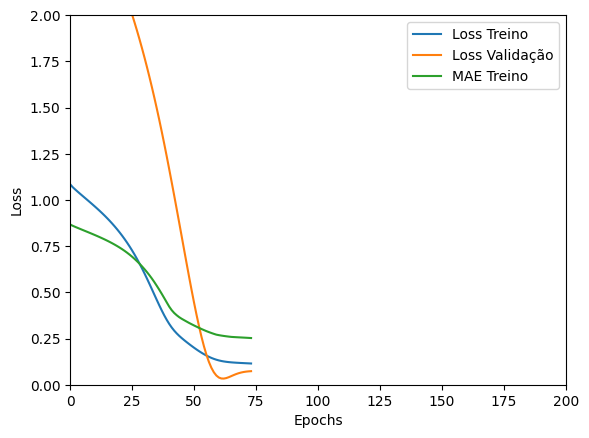

Tempo de treino: 0.21836567719777425 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4524843692779541 , MAE = 0.4979746639728546'

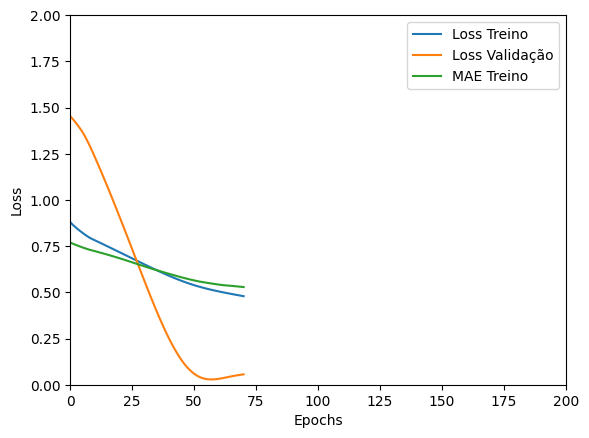

Tempo de treino: 0.12128528753916422 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1629604548215866 , MAE = 0.3087017238140106'

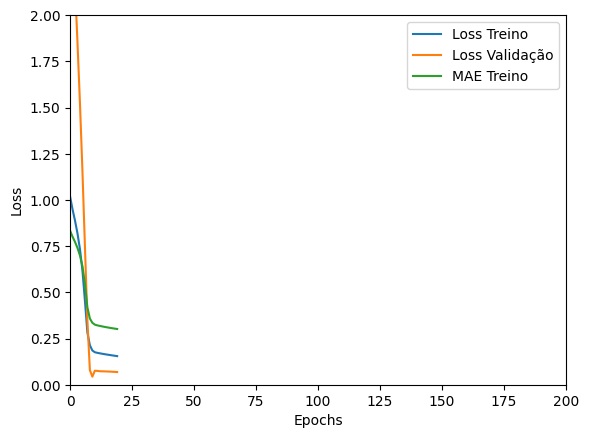

Tempo de treino: 0.14133946498235067 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1915329396724701 , MAE = 0.33977681398391724'

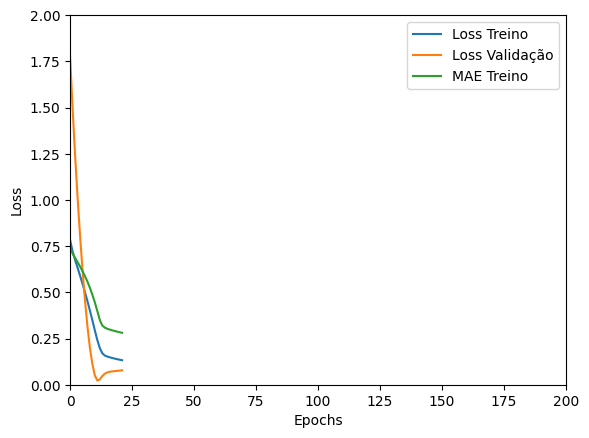

Tempo de treino: 0.1263058582941691 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3596055507659912 , MAE = 0.4688441753387451'

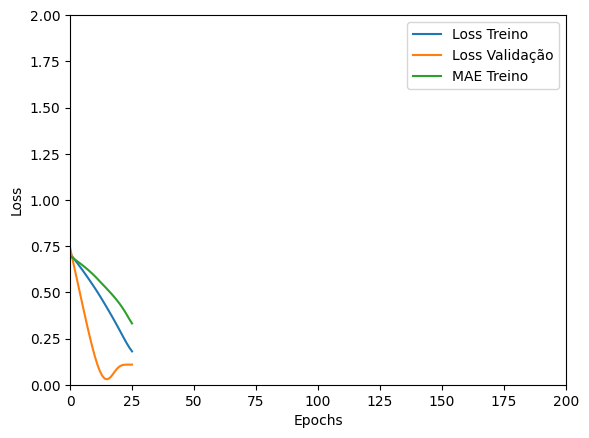

Tempo de treino: 0.08209780057271322 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.411285936832428 , MAE = 0.4235219657421112'

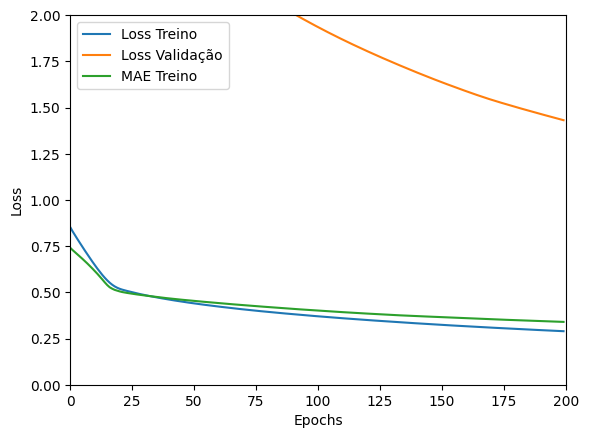

Tempo de treino: 0.23595277070999146 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.056666500866413116 , MAE = 0.18905341625213623'

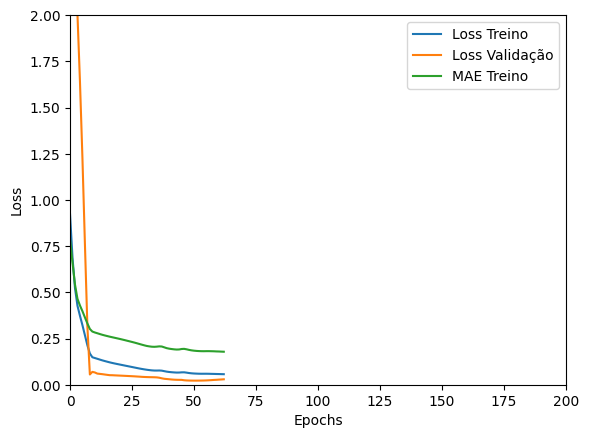

Tempo de treino: 0.3086646238962809 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13466408848762512 , MAE = 0.2737744152545929'

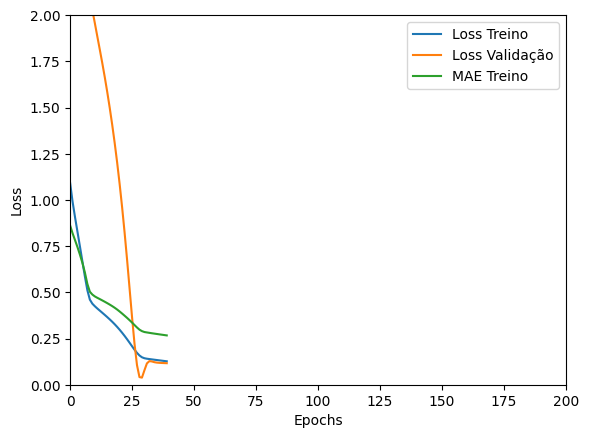

Tempo de treino: 0.1311301589012146 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15107885003089905 , MAE = 0.291753888130188'

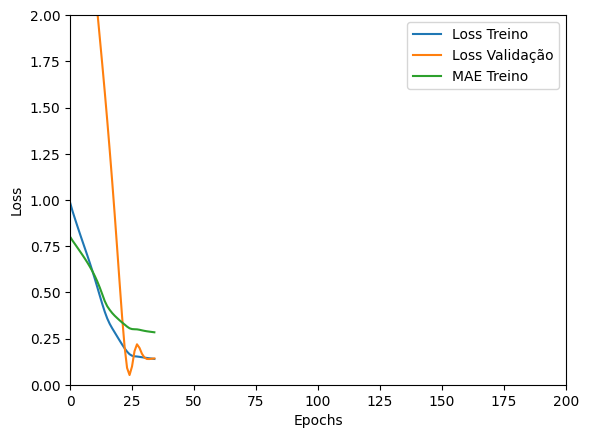

Tempo de treino: 0.10798989534378052 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1493147313594818 , MAE = 0.2871784269809723'

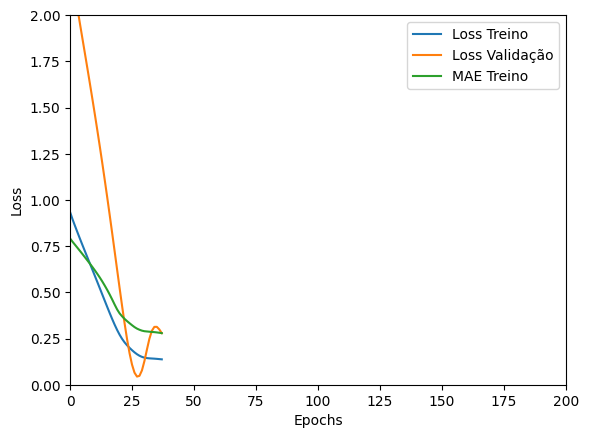

Tempo de treino: 0.12882965405782063 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07556198537349701 , MAE = 0.2245803028345108'

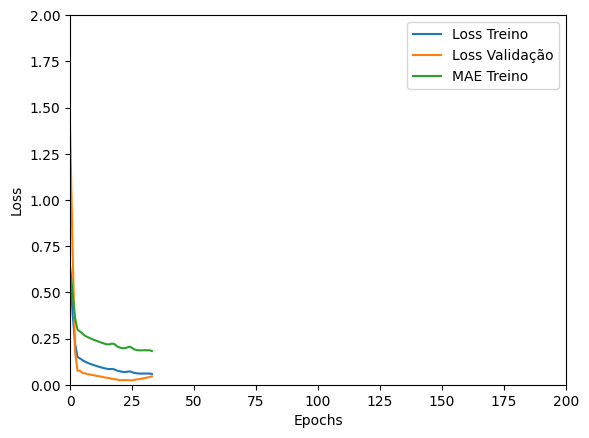

Tempo de treino: 0.15844471454620362 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1425120085477829 , MAE = 0.28579944372177124'

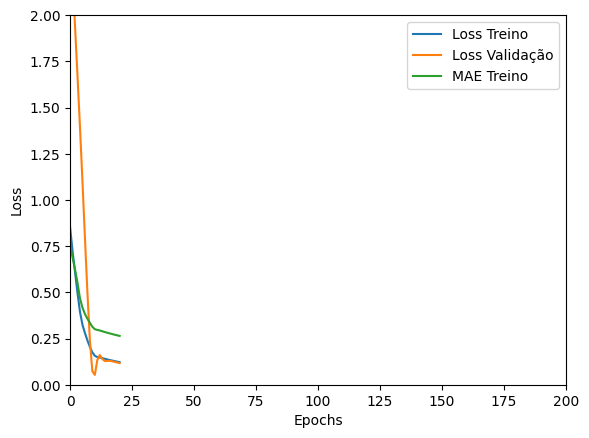

Tempo de treino: 0.12926320632298788 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.208286315202713 , MAE = 0.35388708114624023'

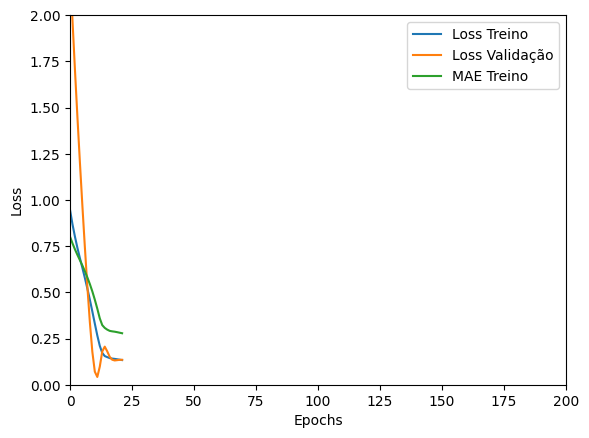

Tempo de treino: 0.12813166777292886 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23691074550151825 , MAE = 0.3825894892215729'

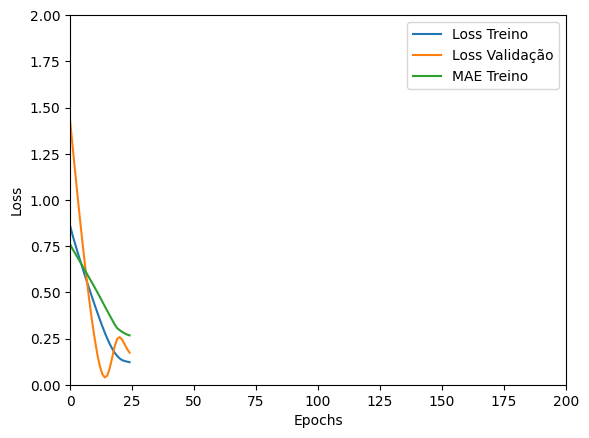

Tempo de treino: 0.09938006401062012 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14669550955295563 , MAE = 0.28574150800704956'

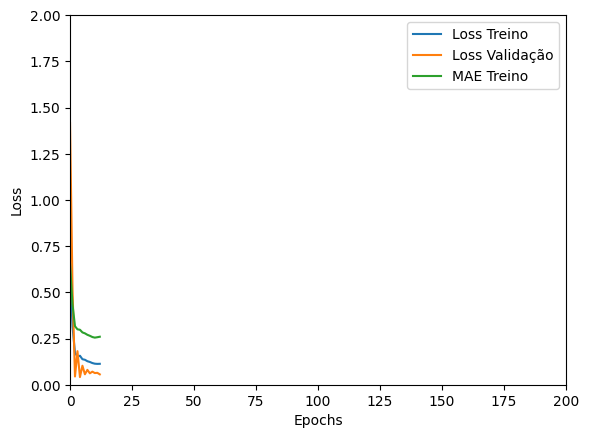

Tempo de treino: 0.10778845151265462 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14796671271324158 , MAE = 0.2941649556159973'

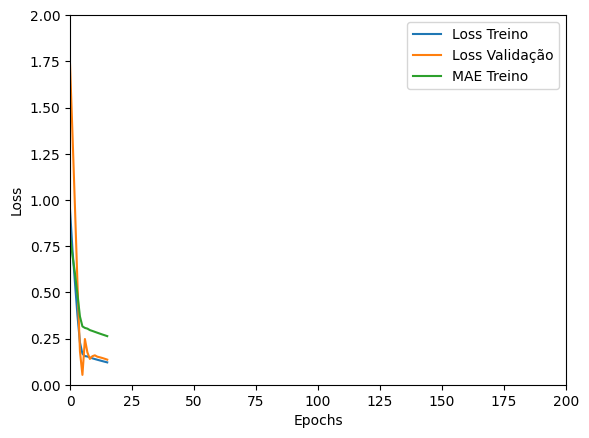

Tempo de treino: 0.0947009046872457 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15278595685958862 , MAE = 0.29733726382255554'

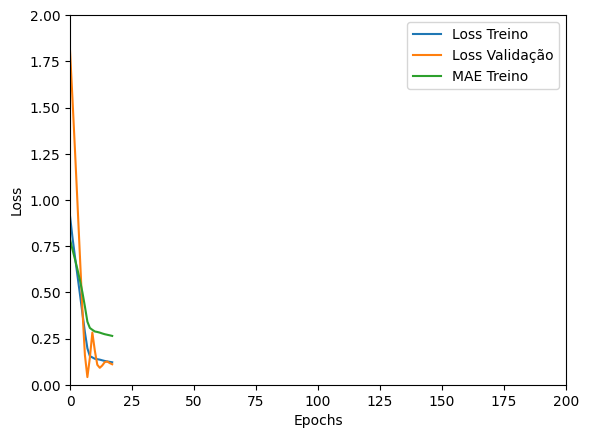

Tempo de treino: 0.08768760363260905 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1432863175868988 , MAE = 0.28600040078163147'

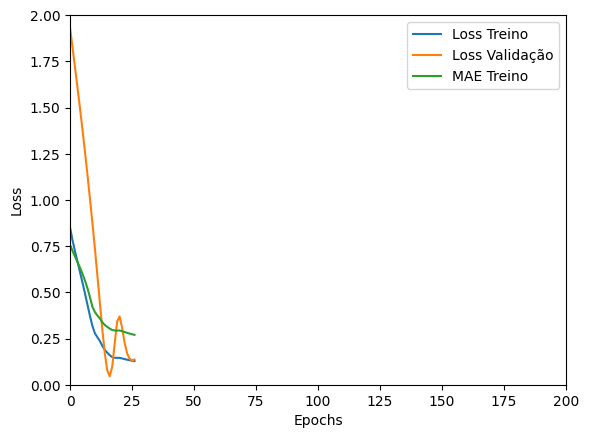

Tempo de treino: 0.09469216664632162 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=6, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4637402892112732 , MAE = 0.5181451439857483'

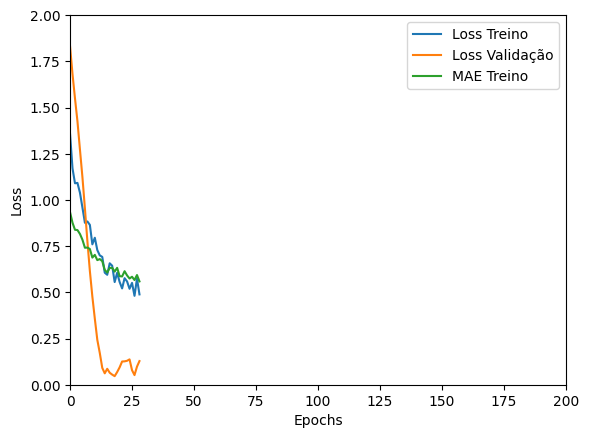

Tempo de treino: 0.1264191468556722 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.1626290082931519 , MAE = 0.9013635516166687'

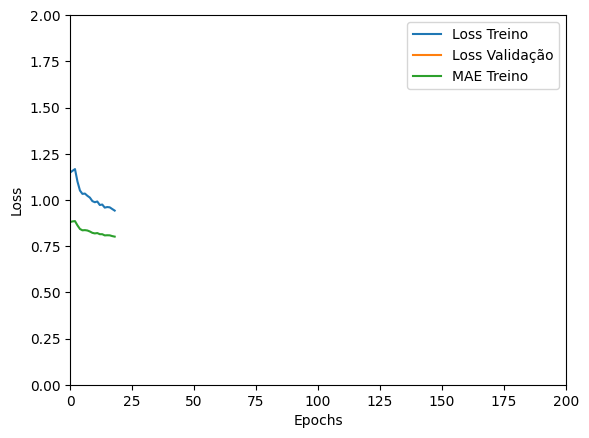

Tempo de treino: 0.13758054971694947 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4954080283641815 , MAE = 0.5150151252746582'

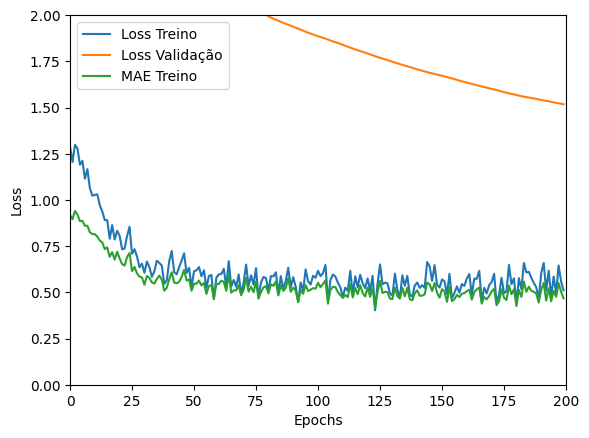

Tempo de treino: 0.39150638580322267 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4661620557308197 , MAE = 0.5134453177452087'

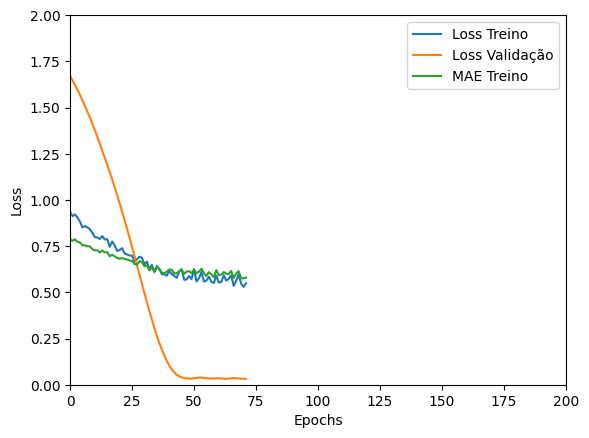

Tempo de treino: 0.1382208784421285 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15293560922145844 , MAE = 0.29178592562675476'

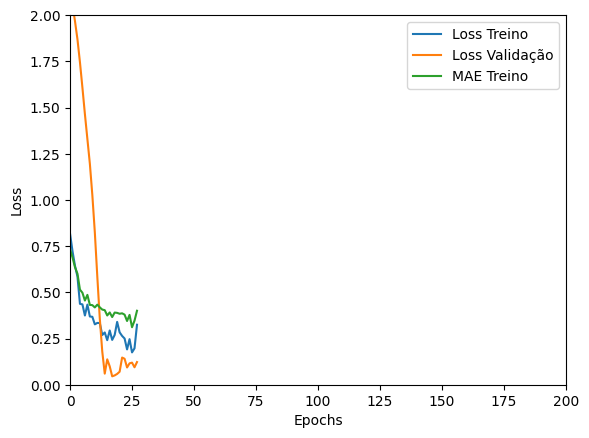

Tempo de treino: 0.1358278234799703 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12861616909503937 , MAE = 0.2704510986804962'

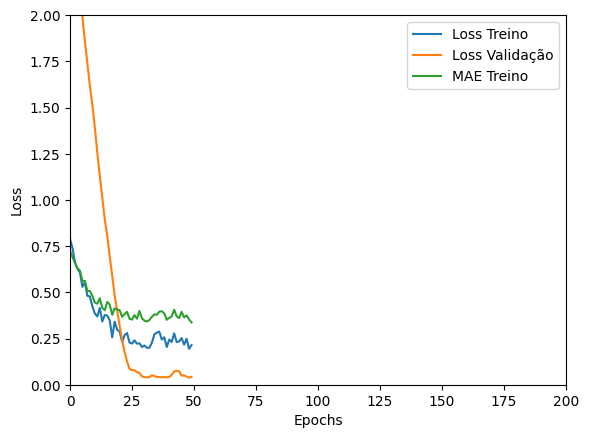

Tempo de treino: 0.15117276509602864 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24870672821998596 , MAE = 0.39212873578071594'

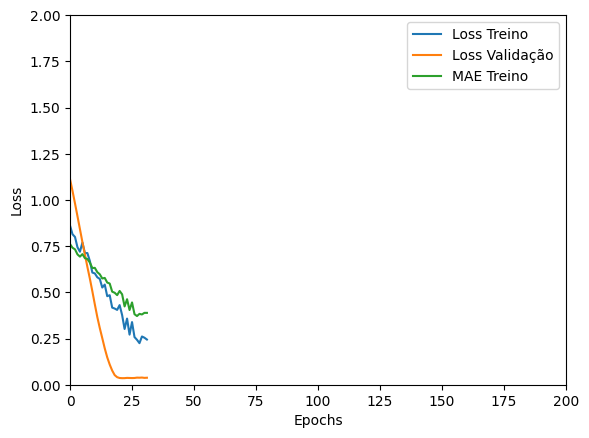

Tempo de treino: 0.12640819549560547 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14665266871452332 , MAE = 0.2862311005592346'

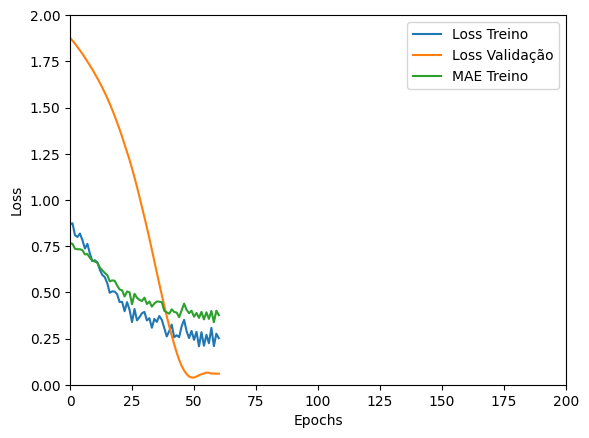

Tempo de treino: 0.14544512828191122 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15978704392910004 , MAE = 0.2997474670410156'

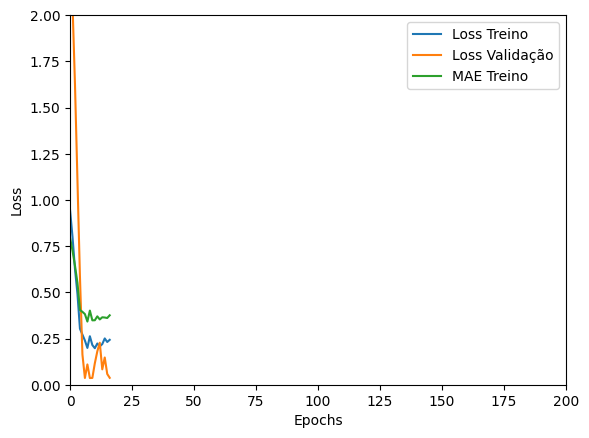

Tempo de treino: 0.13959019184112548 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1468755304813385 , MAE = 0.28817474842071533'

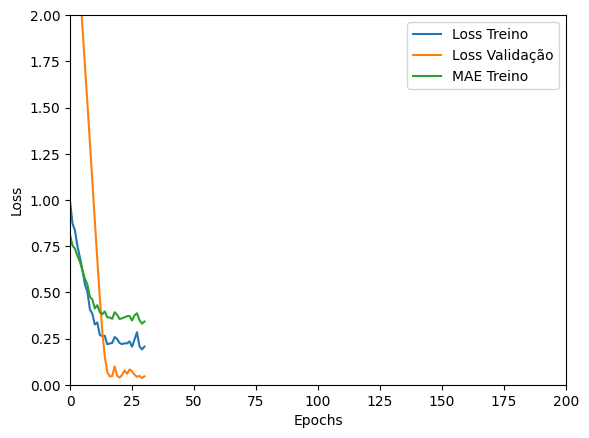

Tempo de treino: 0.1385971466700236 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1760558784008026 , MAE = 0.31126561760902405'

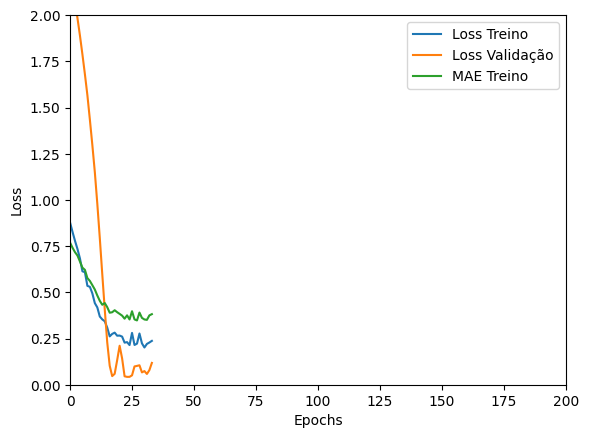

Tempo de treino: 0.13506916364034016 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15478000044822693 , MAE = 0.2957327663898468'

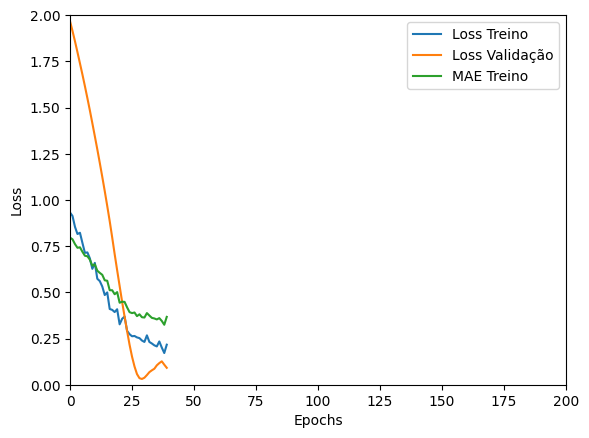

Tempo de treino: 0.10934434731801351 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09268462657928467 , MAE = 0.2292536348104477'

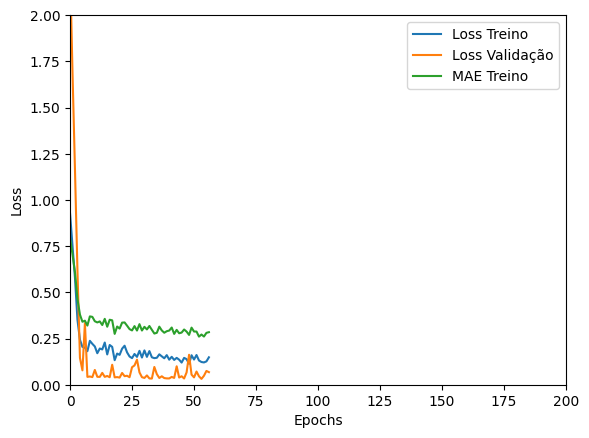

Tempo de treino: 0.2516599337259928 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1301274597644806 , MAE = 0.27153968811035156'

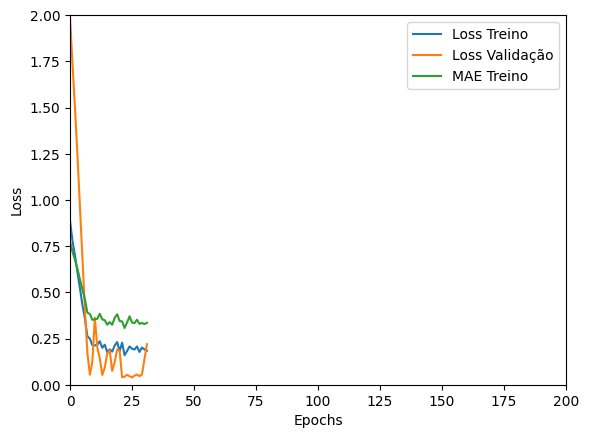

Tempo de treino: 0.12903484106063842 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1684361696243286 , MAE = 0.30221450328826904'

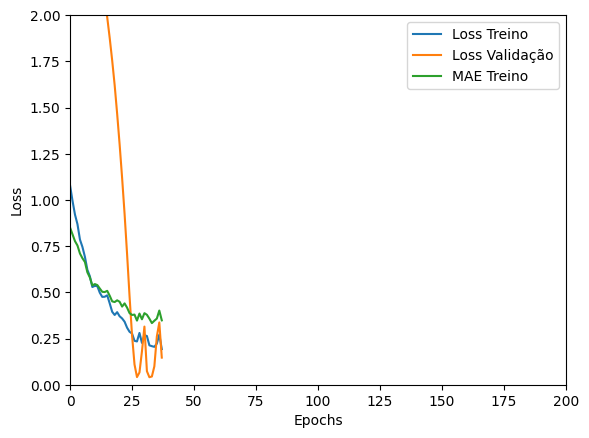

Tempo de treino: 0.13249994119008382 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17220909893512726 , MAE = 0.3090088963508606'

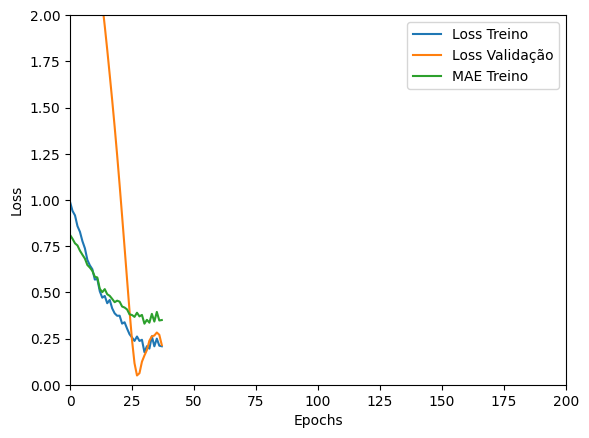

Tempo de treino: 0.15799814065297443 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05970260500907898 , MAE = 0.1836438924074173'

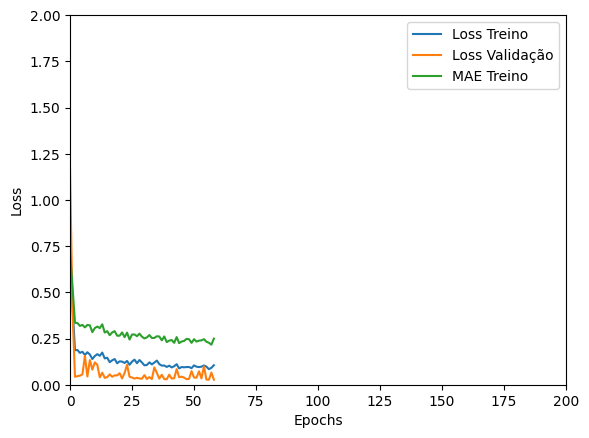

Tempo de treino: 0.29459558725357055 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14136265218257904 , MAE = 0.2836326062679291'

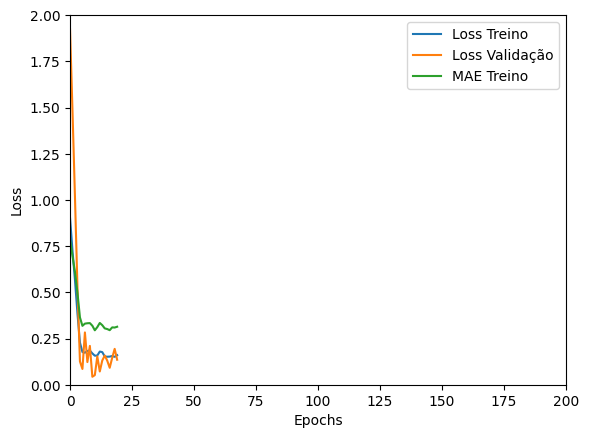

Tempo de treino: 0.14048019647598267 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.150654599070549 , MAE = 0.29367026686668396'

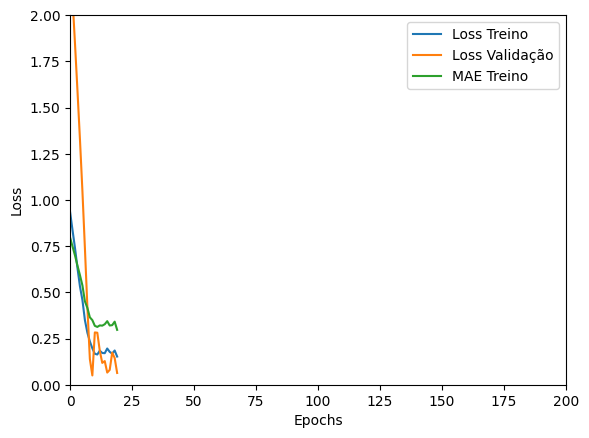

Tempo de treino: 0.09395983616511026 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15821658074855804 , MAE = 0.29784679412841797'

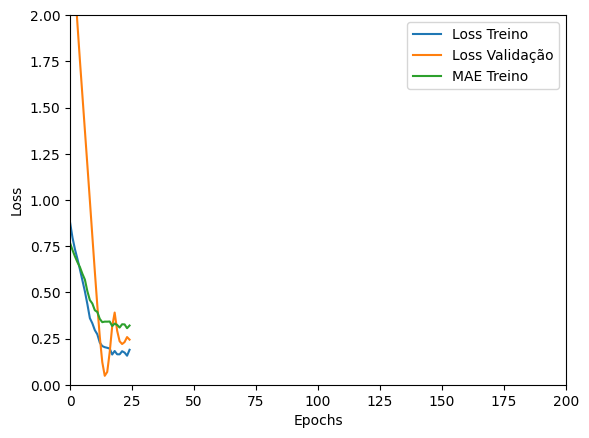

Tempo de treino: 0.08914156357447306 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com GRU_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04433302953839302 , MAE = 0.16363517940044403'

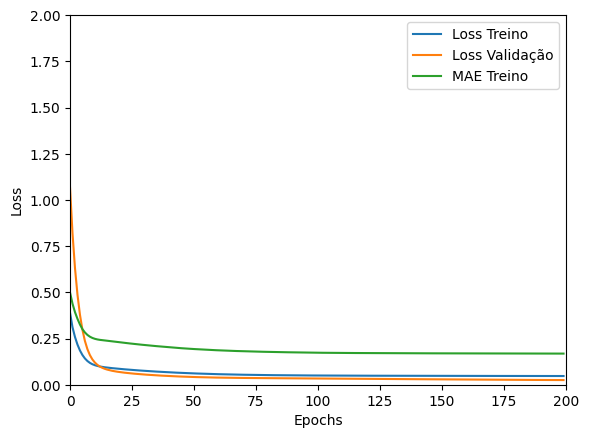

Tempo de treino: 0.7466587781906128 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04747422784566879 , MAE = 0.1681179255247116'

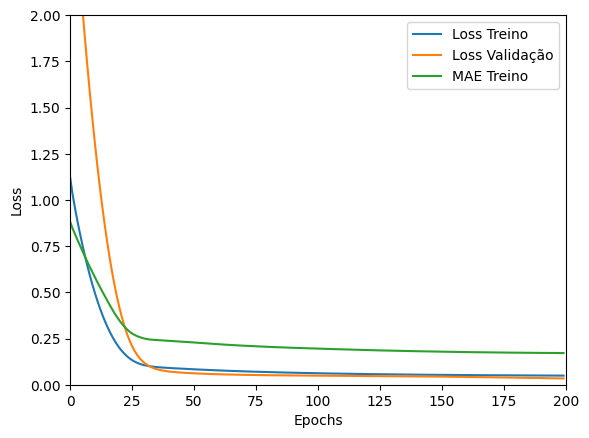

Tempo de treino: 0.5850171486536662 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05906186252832413 , MAE = 0.18990163505077362'

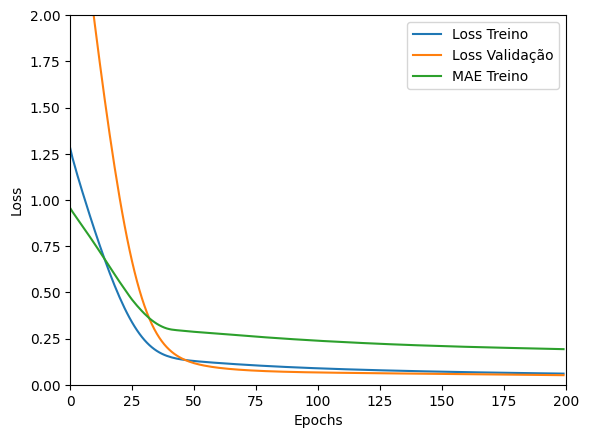

Tempo de treino: 0.39698612292607627 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0586075633764267 , MAE = 0.19070987403392792'

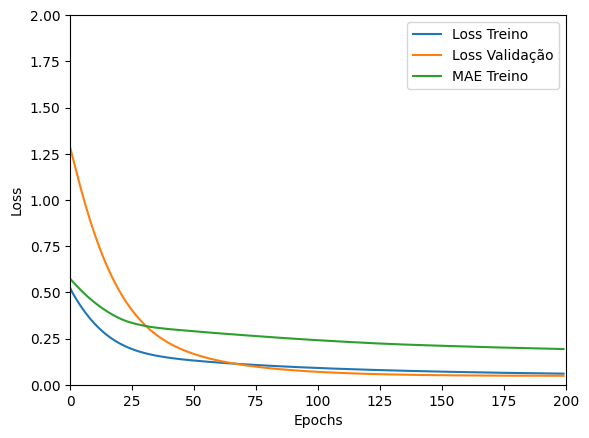

Tempo de treino: 0.3063518444697062 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042996011674404144 , MAE = 0.15869008004665375'

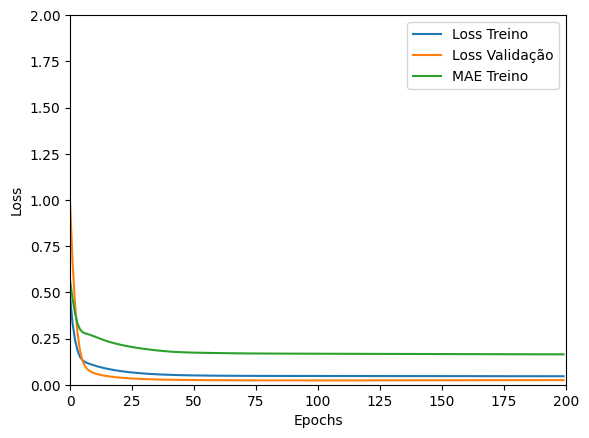

Tempo de treino: 0.748616095383962 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04662212356925011 , MAE = 0.16538049280643463'

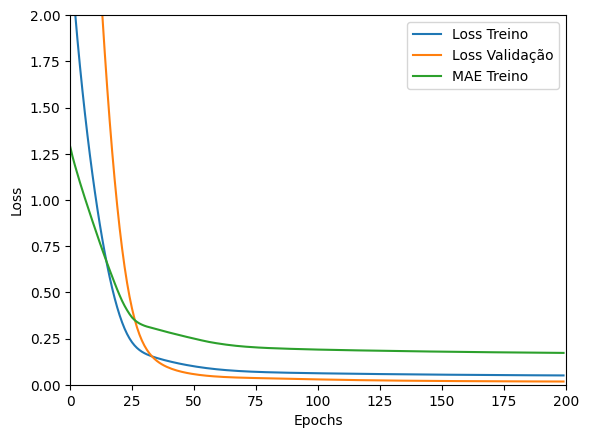

Tempo de treino: 0.7817309260368347 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.053647298365831375 , MAE = 0.18258380889892578'

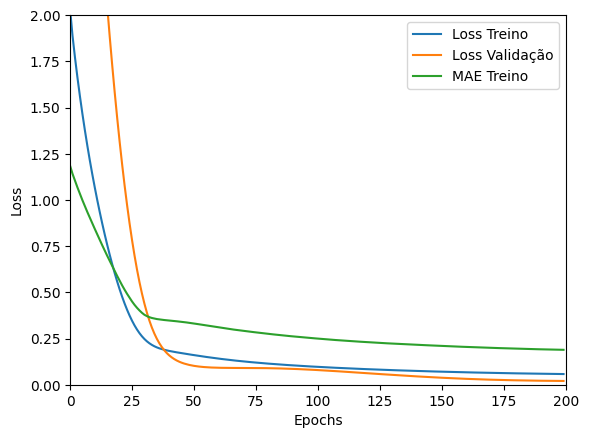

Tempo de treino: 0.383396844069163 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0435803085565567 , MAE = 0.15952737629413605'

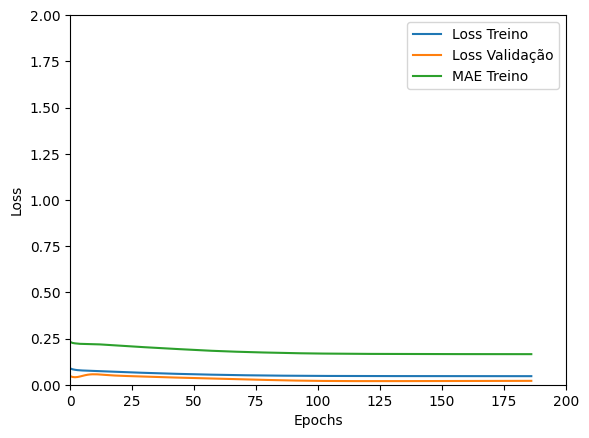

Tempo de treino: 0.39740558465321857 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04608054459095001 , MAE = 0.16579169034957886'

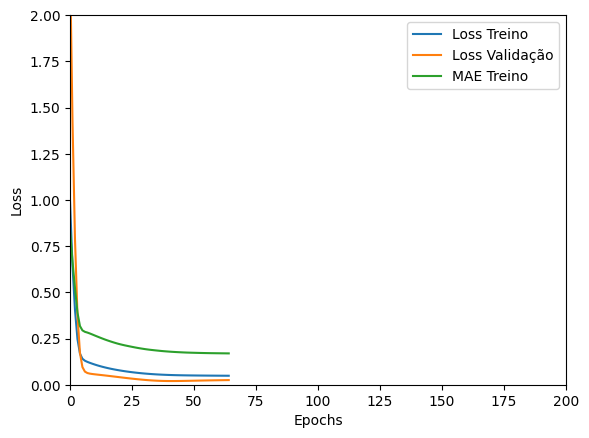

Tempo de treino: 0.39696725209554035 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04308411851525307 , MAE = 0.15849173069000244'

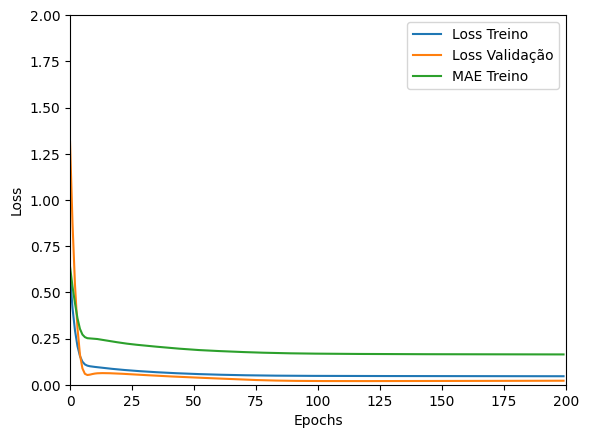

Tempo de treino: 0.7368381023406982 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05136292800307274 , MAE = 0.17593486607074738'

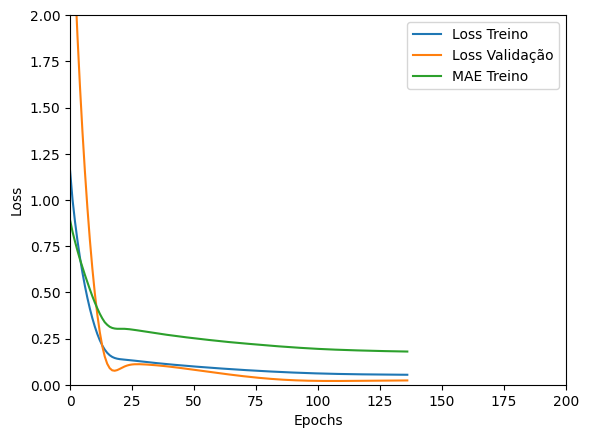

Tempo de treino: 0.32008159955342613 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11277984827756882 , MAE = 0.2725309133529663'

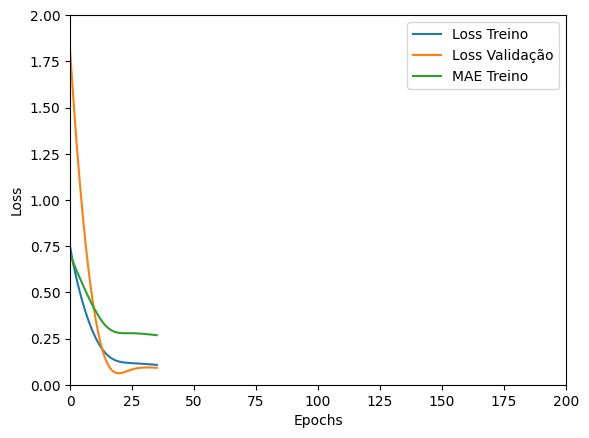

Tempo de treino: 0.11981592575709026 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05111972242593765 , MAE = 0.1750180721282959'

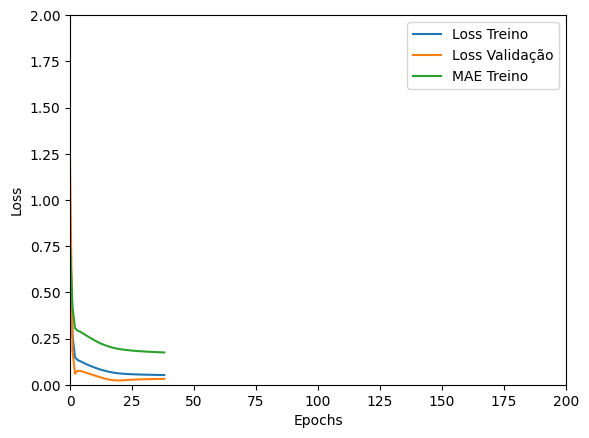

Tempo de treino: 0.21981841325759888 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04779199883341789 , MAE = 0.16745859384536743'

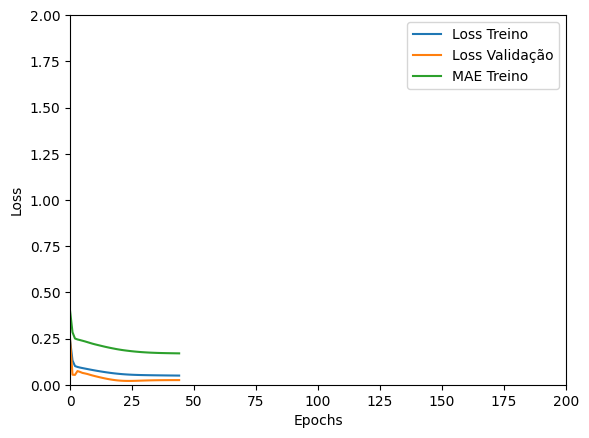

Tempo de treino: 0.1858068585395813 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12096711248159409 , MAE = 0.2739481031894684'

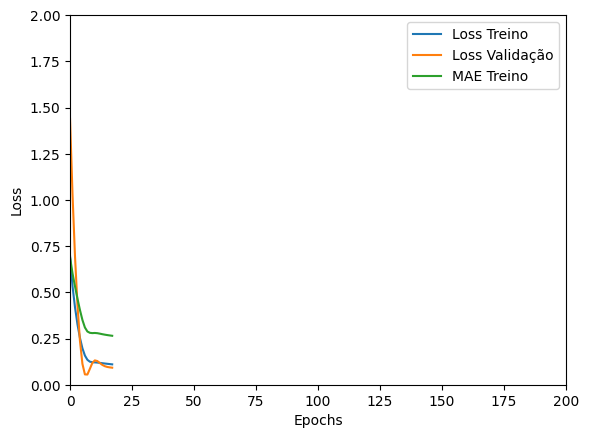

Tempo de treino: 0.16428663730621337 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14333775639533997 , MAE = 0.3014798164367676'

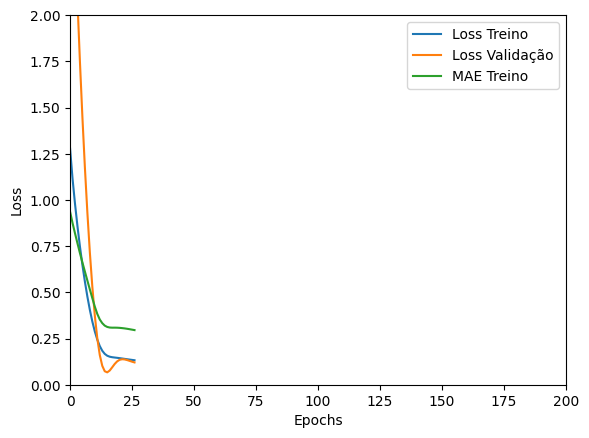

Tempo de treino: 0.14171926180521646 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08343286067247391 , MAE = 0.2249538153409958'

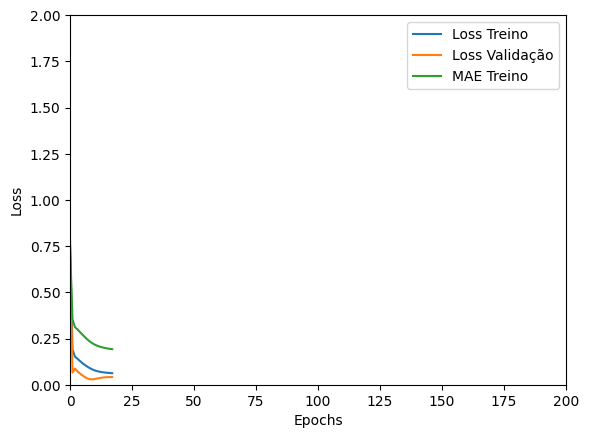

Tempo de treino: 0.14278971751530964 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07191126048564911 , MAE = 0.20794492959976196'

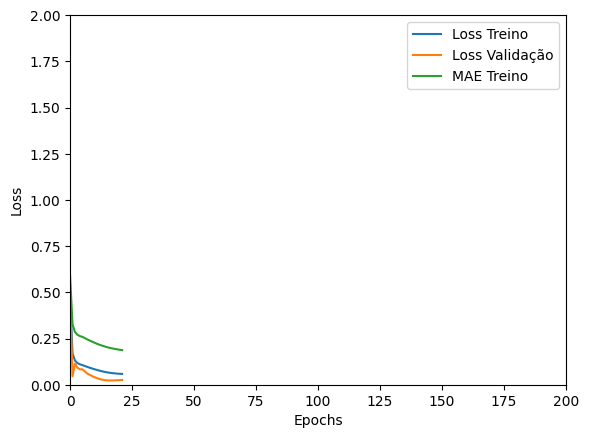

Tempo de treino: 0.14448997577031453 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12892158329486847 , MAE = 0.2809038758277893'

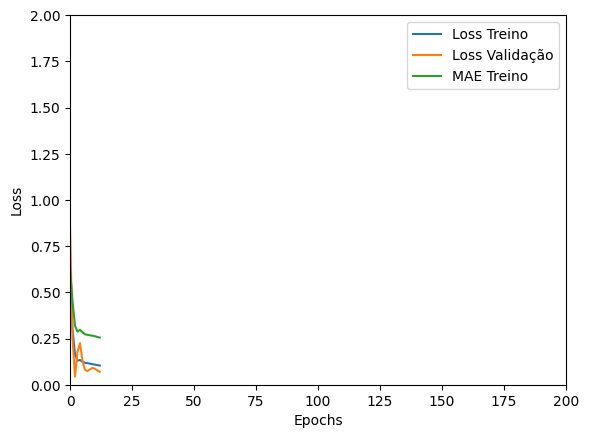

Tempo de treino: 0.1424129565556844 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14393028616905212 , MAE = 0.296085387468338'

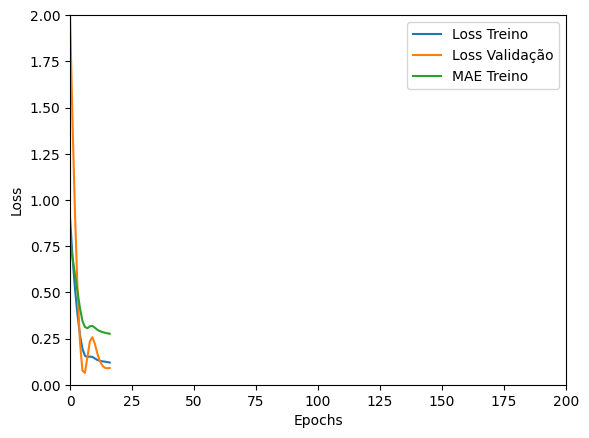

Tempo de treino: 0.09542604684829711 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5314537286758423 , MAE = 0.5488771796226501'

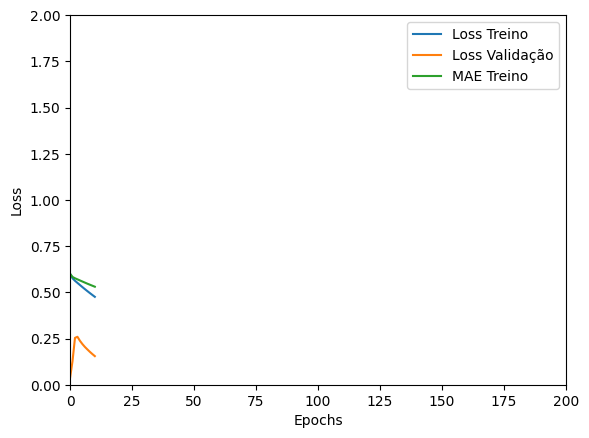

Tempo de treino: 0.1286547899246216 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1447838842868805 , MAE = 0.2840120196342468'

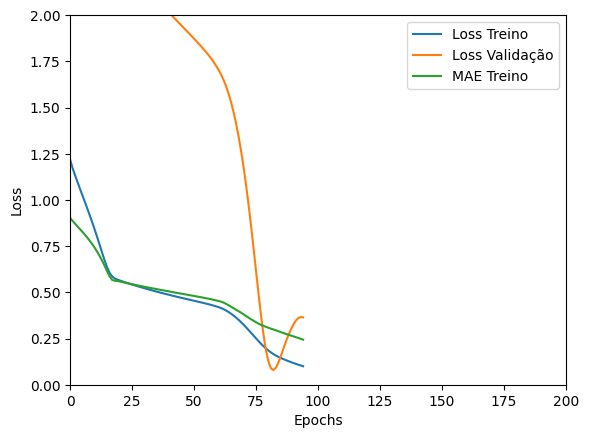

Tempo de treino: 0.37595427831014 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.1253464221954346 , MAE = 0.8200383186340332'

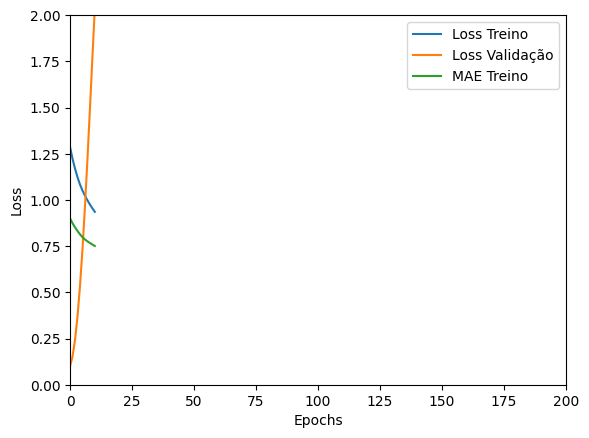

Tempo de treino: 0.0512014110883077 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7286916375160217 , MAE = 0.6404882669448853'

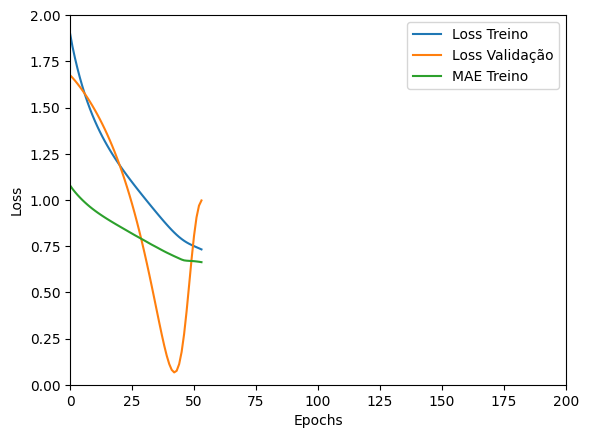

Tempo de treino: 0.1252896269162496 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18971344828605652 , MAE = 0.33415424823760986'

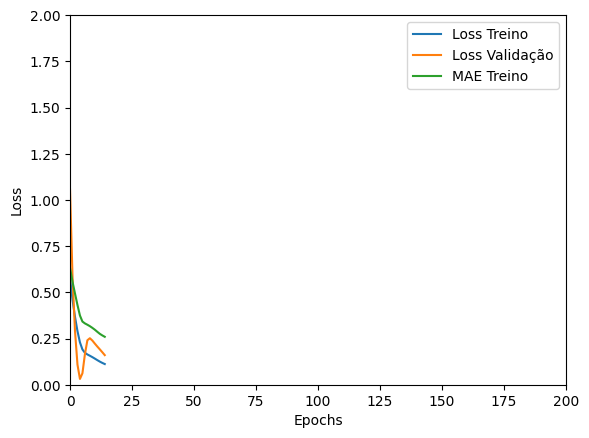

Tempo de treino: 0.12227320273717245 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6471868753433228 , MAE = 0.6268435716629028'

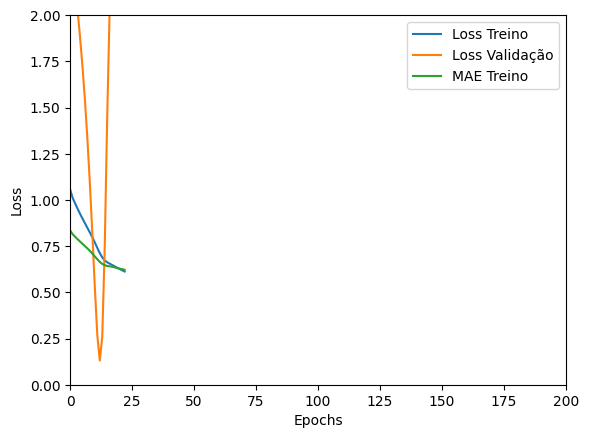

Tempo de treino: 0.10860105355580647 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18486608564853668 , MAE = 0.317624568939209'

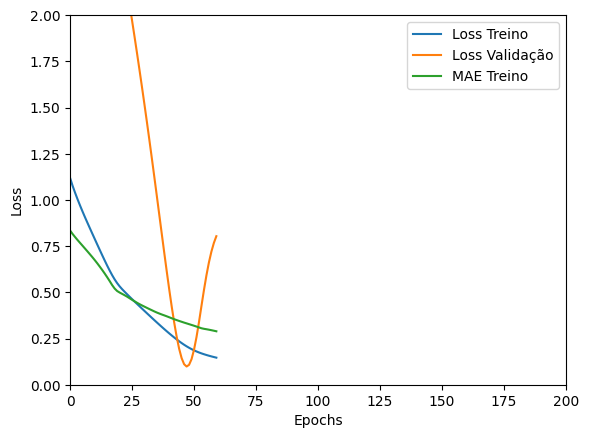

Tempo de treino: 0.12601178884506226 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2509898841381073 , MAE = 0.3835656940937042'

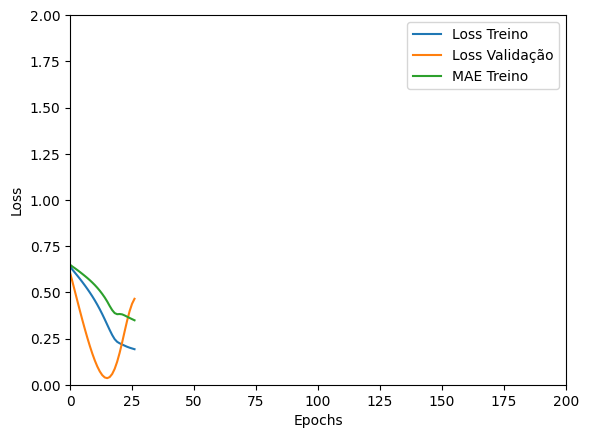

Tempo de treino: 0.09912123282750447 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4497128427028656 , MAE = 0.5232008695602417'

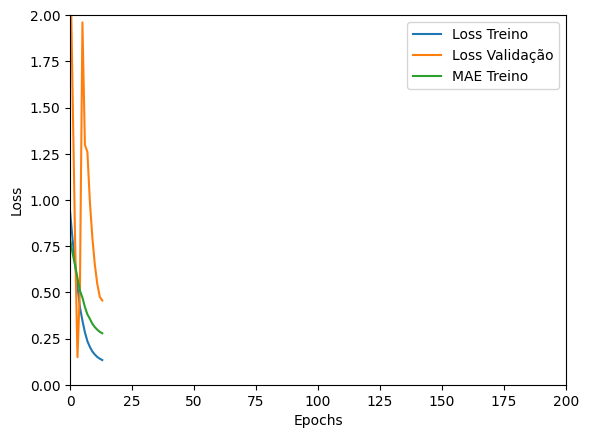

Tempo de treino: 0.08489549160003662 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20914007723331451 , MAE = 0.3332710266113281'

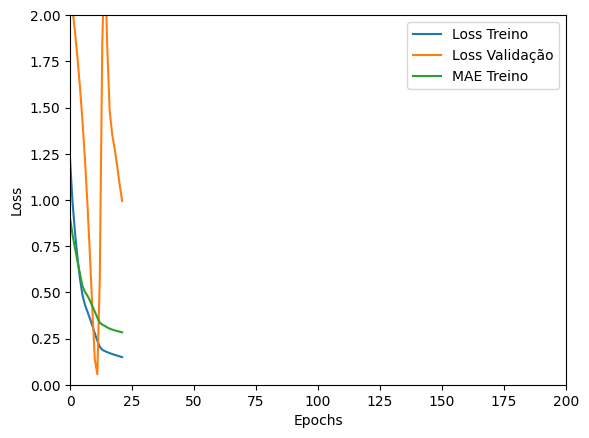

Tempo de treino: 0.0974724292755127 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29093921184539795 , MAE = 0.40094876289367676'

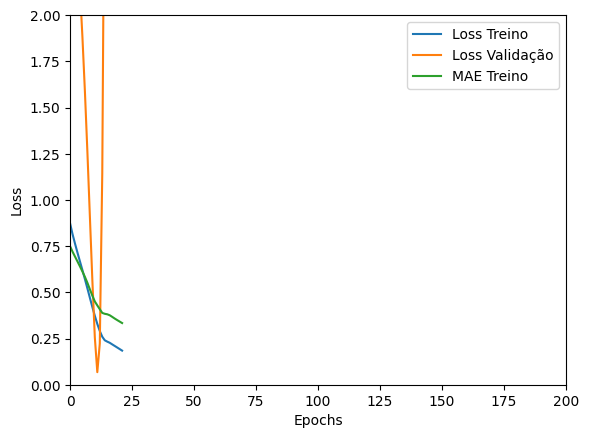

Tempo de treino: 0.06681852738062541 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.45867010951042175 , MAE = 0.5220193266868591'

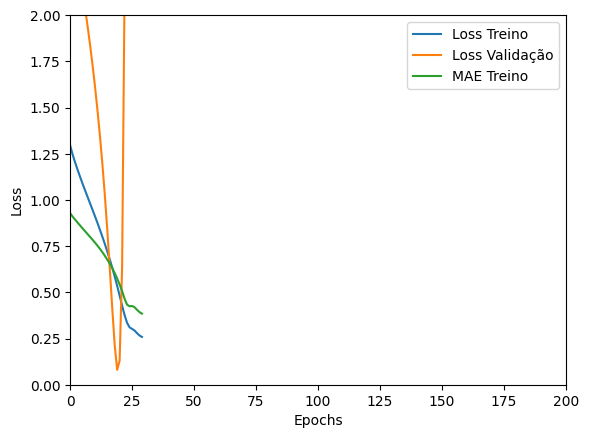

Tempo de treino: 0.0850690484046936 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32978761196136475 , MAE = 0.4358651638031006'

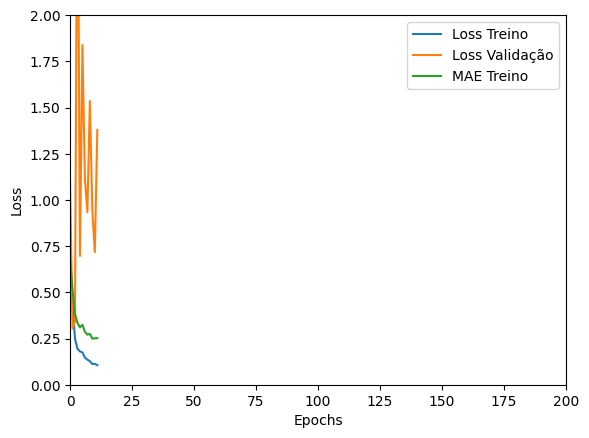

Tempo de treino: 0.1617916703224182 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2355687916278839 , MAE = 0.3527890145778656'

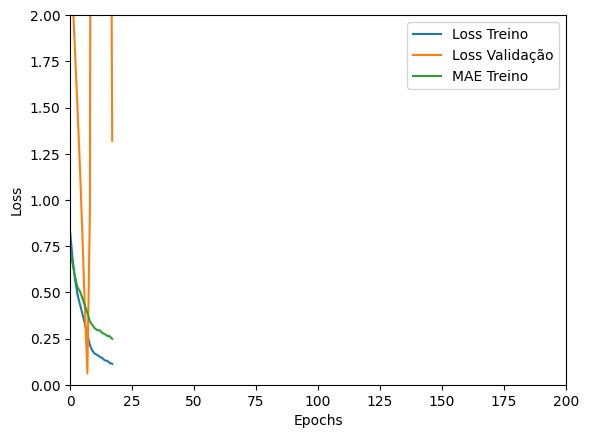

Tempo de treino: 0.10276412963867188 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3043336272239685 , MAE = 0.4243776500225067'

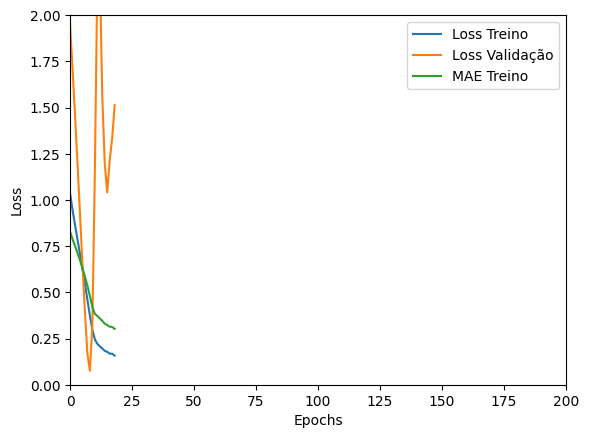

Tempo de treino: 0.07238134940465292 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23056067526340485 , MAE = 0.34664490818977356'

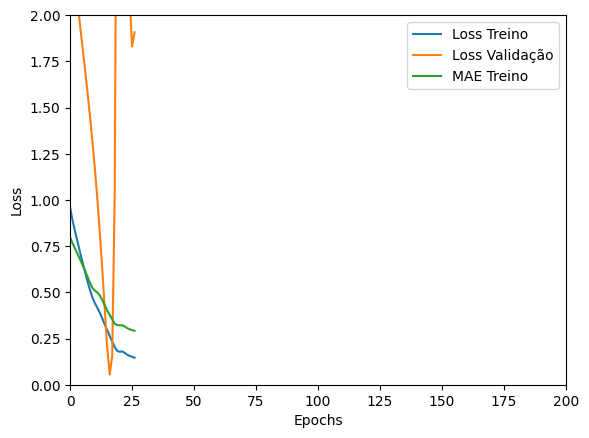

Tempo de treino: 0.11256107886632284 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0881255492568016 , MAE = 0.22027868032455444'

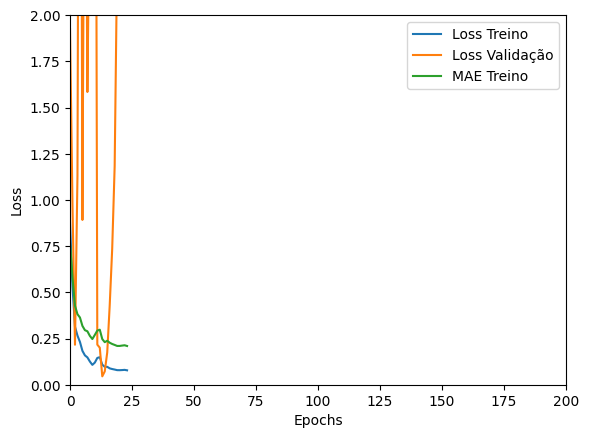

Tempo de treino: 0.15353546142578126 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19677665829658508 , MAE = 0.3265525996685028'

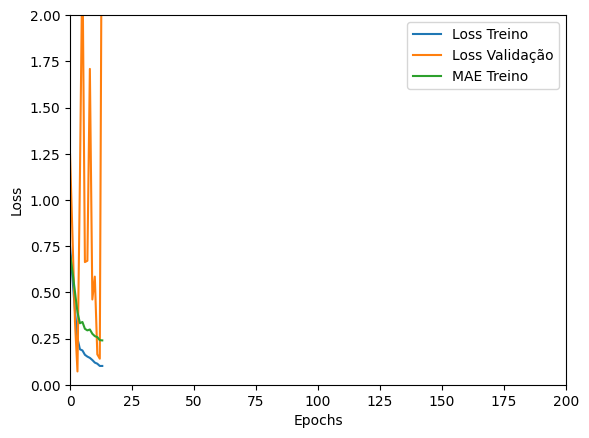

Tempo de treino: 0.08665314118067423 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2218354493379593 , MAE = 0.3551099896430969'

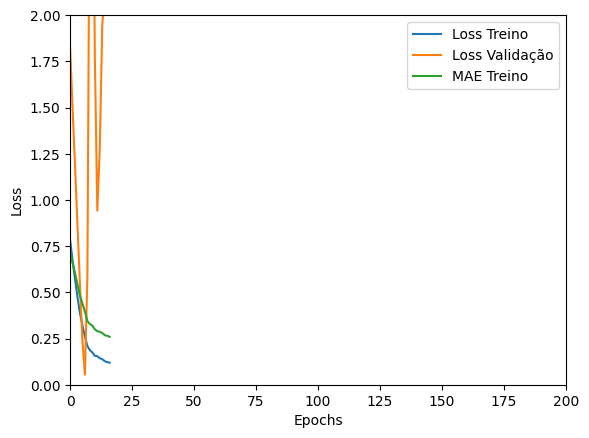

Tempo de treino: 0.07812543312708536 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23051157593727112 , MAE = 0.3570370674133301'

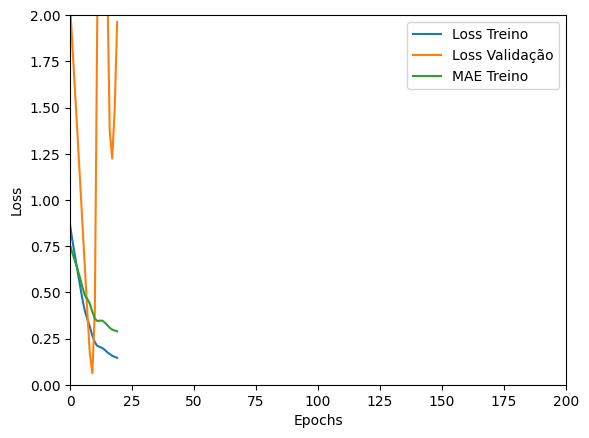

Tempo de treino: 0.0932140032450358 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=12, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06201640143990517 , MAE = 0.19262199103832245'

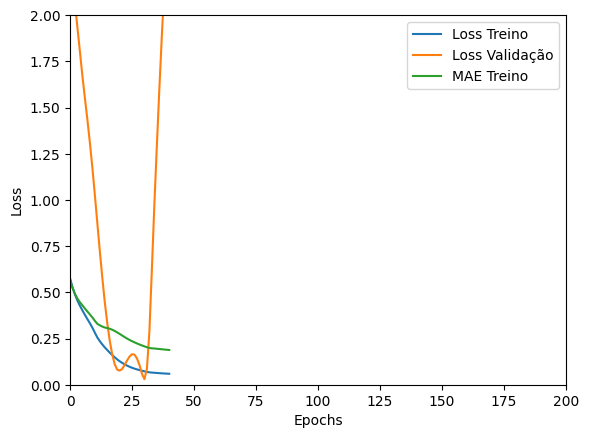

Tempo de treino: 0.19464711348215738 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27285969257354736 , MAE = 0.34158045053482056'

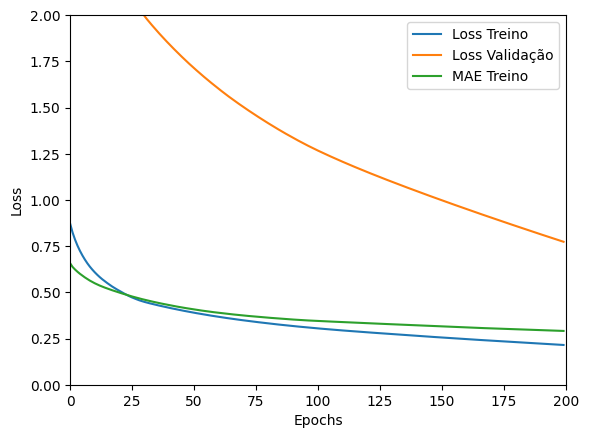

Tempo de treino: 0.46812353531519574 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19441717863082886 , MAE = 0.3369520306587219'

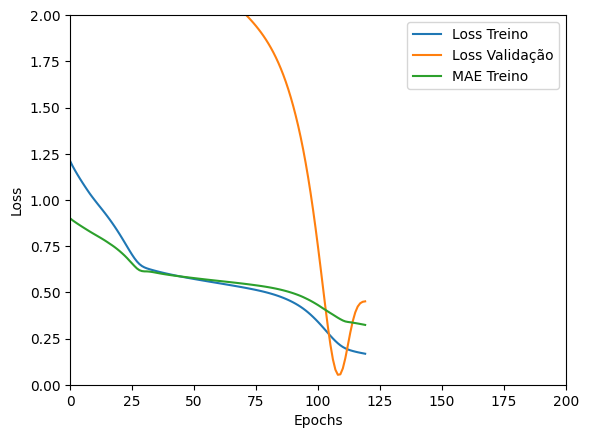

Tempo de treino: 0.22220896085103353 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3376491069793701 , MAE = 0.42816033959388733'

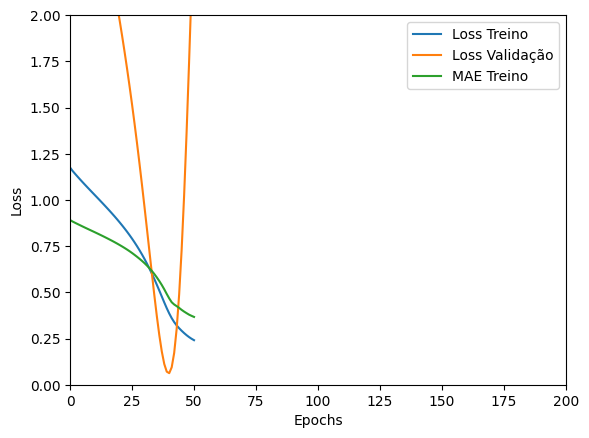

Tempo de treino: 0.1142319401105245 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24146319925785065 , MAE = 0.37909477949142456'

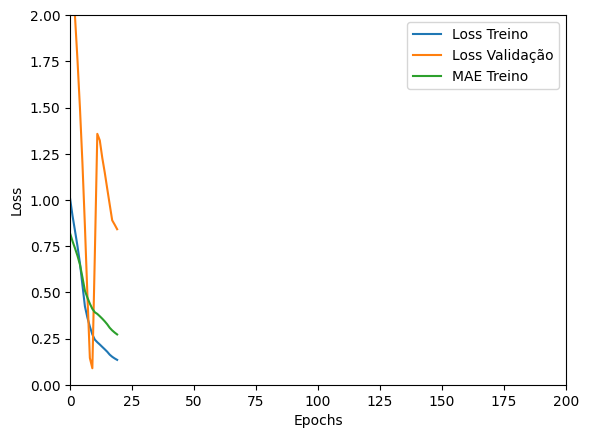

Tempo de treino: 0.11771721045176188 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15384630858898163 , MAE = 0.2814570963382721'

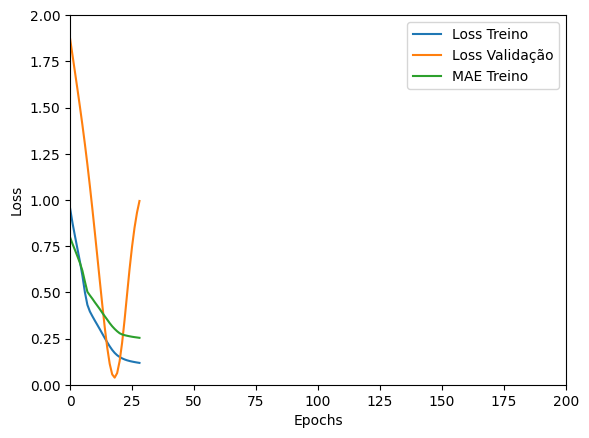

Tempo de treino: 0.1220292329788208 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40921875834465027 , MAE = 0.4894108474254608'

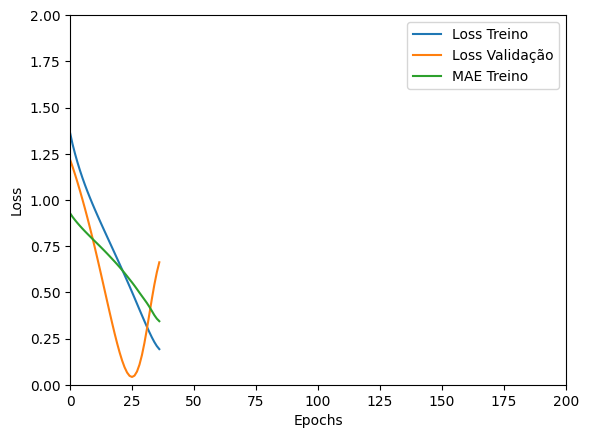

Tempo de treino: 0.1271148920059204 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21577438712120056 , MAE = 0.3462609350681305'

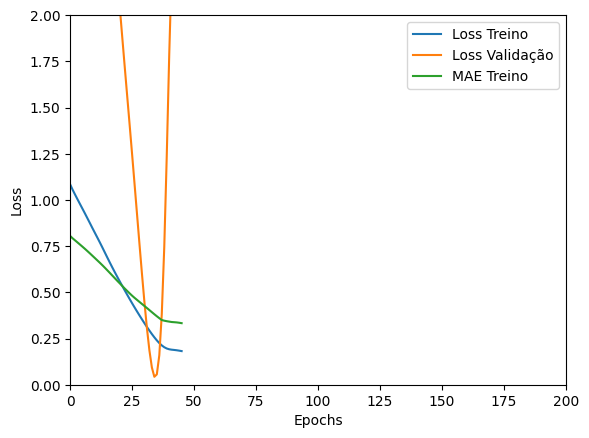

Tempo de treino: 0.16618618567784627 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2057252675294876 , MAE = 0.3530829846858978'

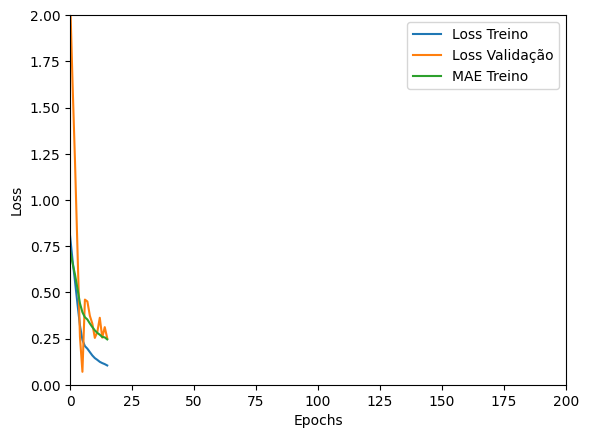

Tempo de treino: 0.0996163527170817 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21339501440525055 , MAE = 0.347349613904953'

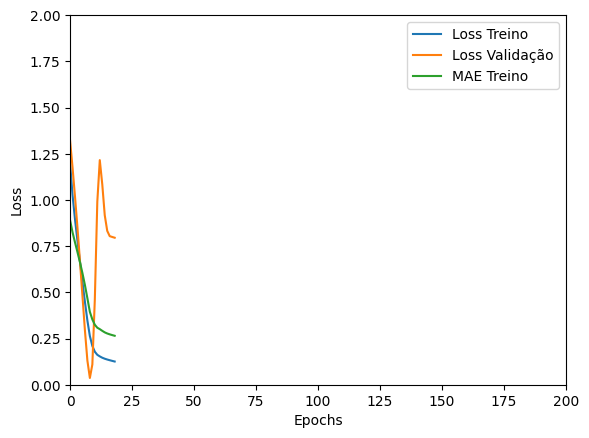

Tempo de treino: 0.12484833002090454 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24079710245132446 , MAE = 0.350574254989624'

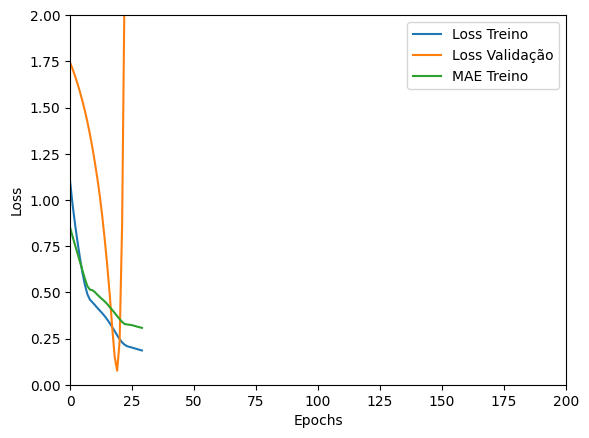

Tempo de treino: 0.1229814330736796 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49534350633621216 , MAE = 0.5466198921203613'

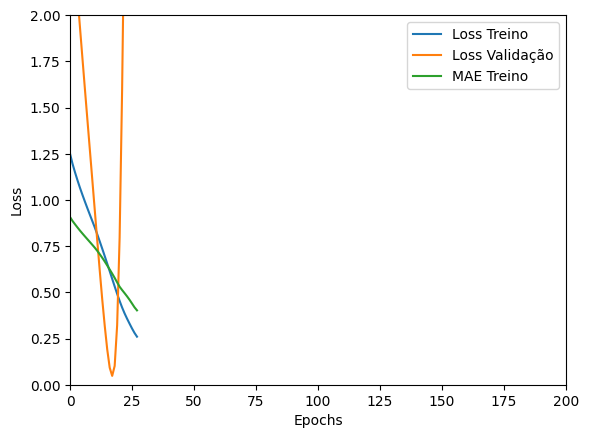

Tempo de treino: 0.09743099610010783 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22739678621292114 , MAE = 0.3487861156463623'

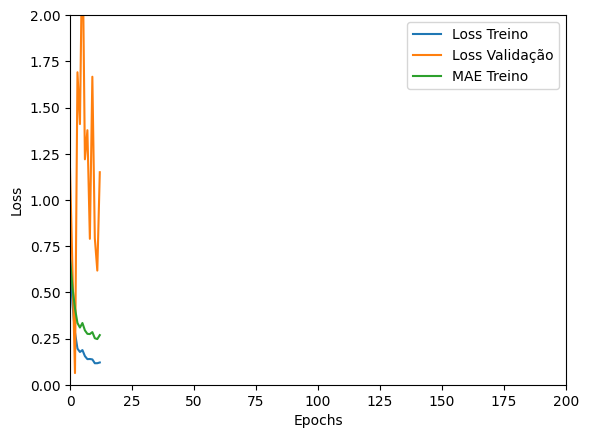

Tempo de treino: 0.08510553439458211 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30038291215896606 , MAE = 0.4224007725715637'

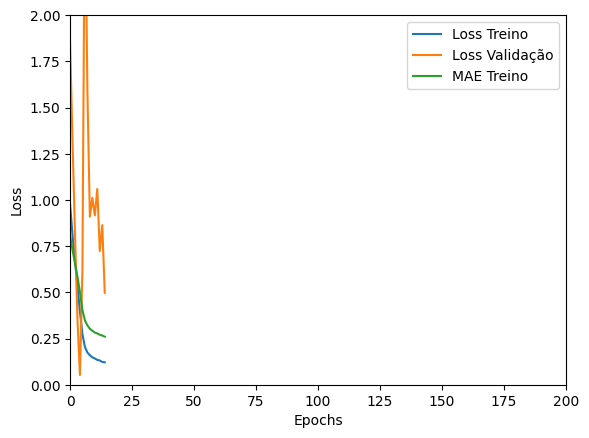

Tempo de treino: 0.08493657906850179 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2508896291255951 , MAE = 0.37692269682884216'

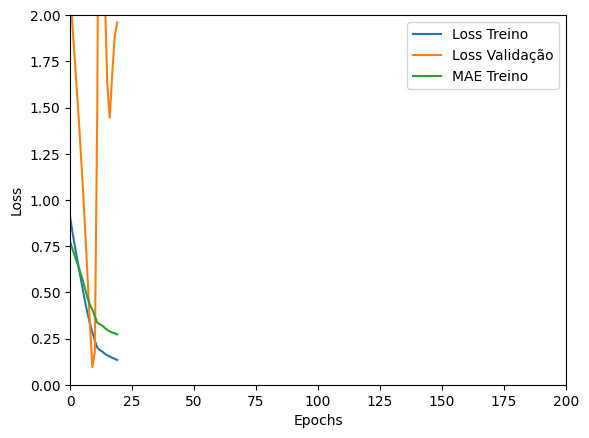

Tempo de treino: 0.06432428359985351 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4038076400756836 , MAE = 0.48966285586357117'

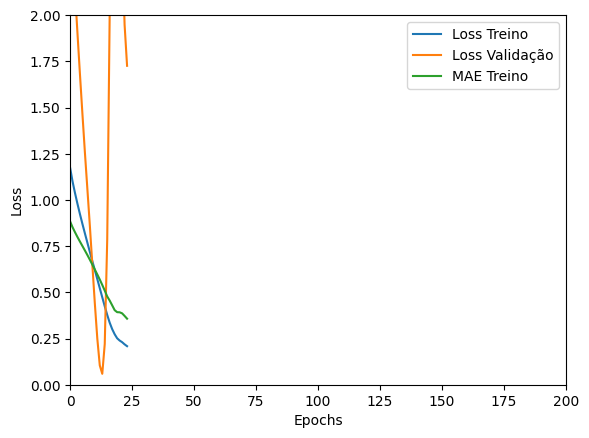

Tempo de treino: 0.13888952334721882 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27391207218170166 , MAE = 0.394048810005188'

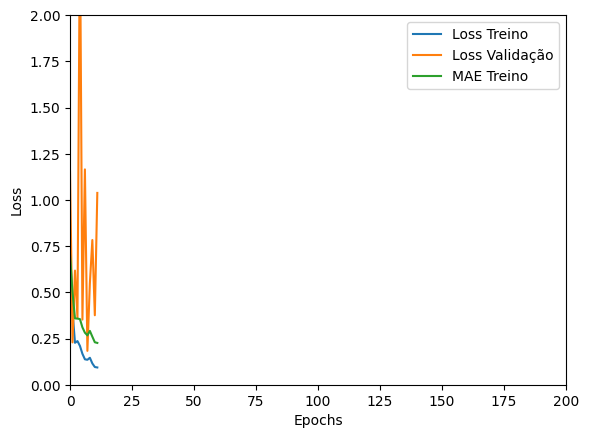

Tempo de treino: 0.0951213558514913 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31222590804100037 , MAE = 0.4054645895957947'

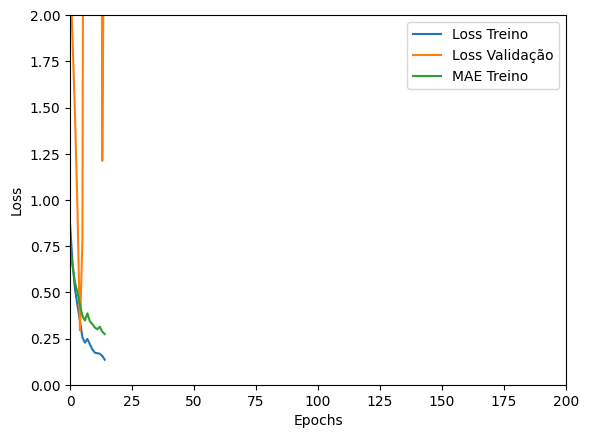

Tempo de treino: 0.08867689371109008 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2561894655227661 , MAE = 0.3666204512119293'

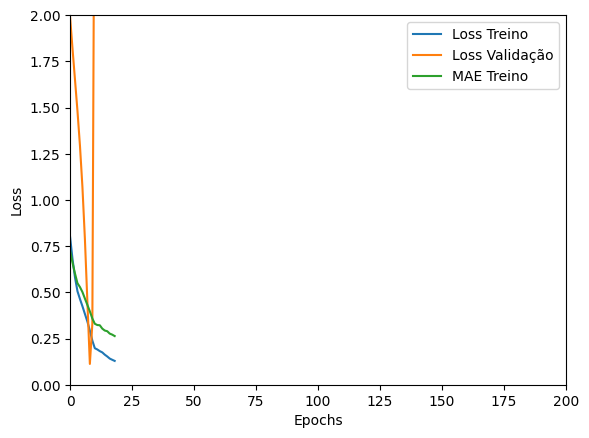

Tempo de treino: 0.08189181884129842 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25524893403053284 , MAE = 0.3705563247203827'

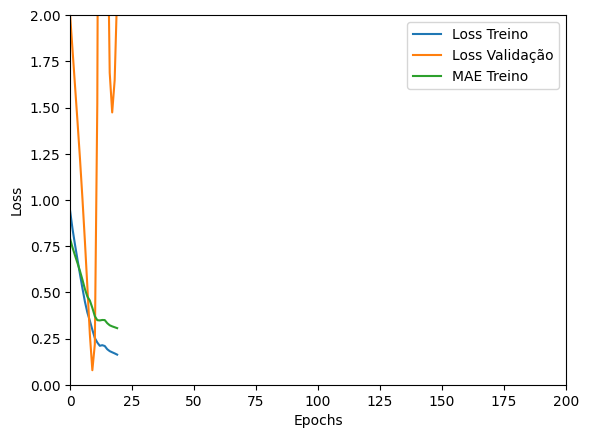

Tempo de treino: 0.0861097534497579 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=12, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1790791004896164 , MAE = 0.3190675973892212'

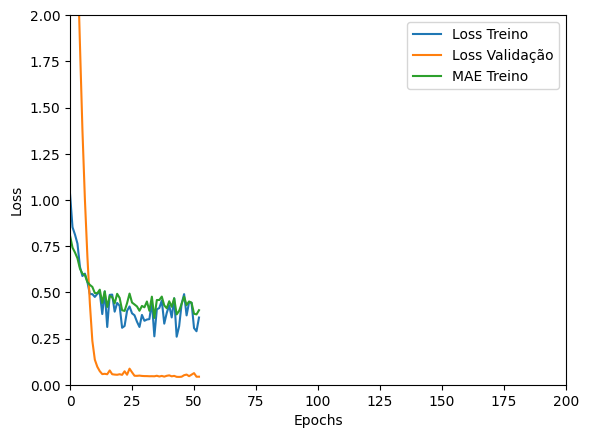

Tempo de treino: 0.20592820247014362 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3943624794483185 , MAE = 0.43178504705429077'

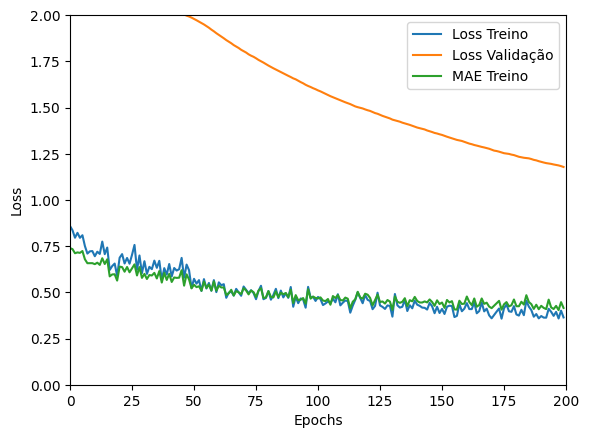

Tempo de treino: 0.724471406141917 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22896836698055267 , MAE = 0.3422936797142029'

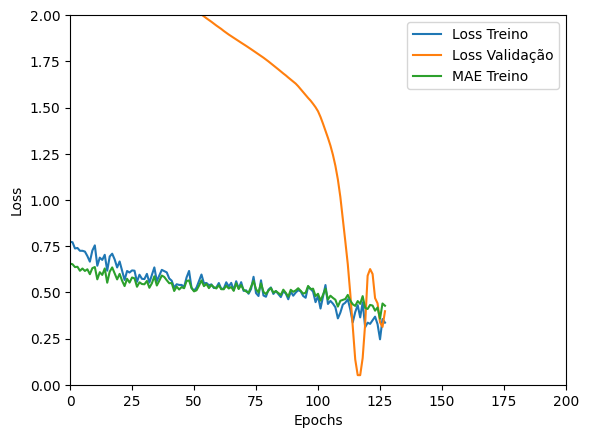

Tempo de treino: 0.2710813283920288 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.734502911567688 , MAE = 0.6688599586486816'

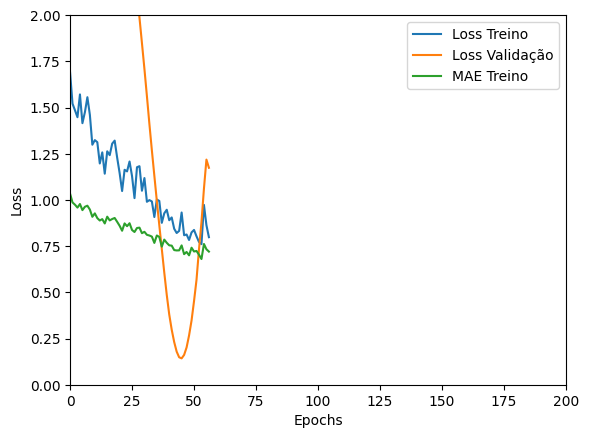

Tempo de treino: 0.147375750541687 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24561363458633423 , MAE = 0.37217283248901367'

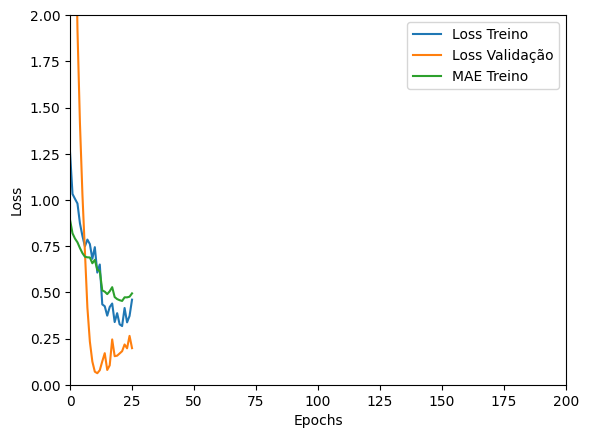

Tempo de treino: 0.13480943044026691 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22738245129585266 , MAE = 0.3479289412498474'

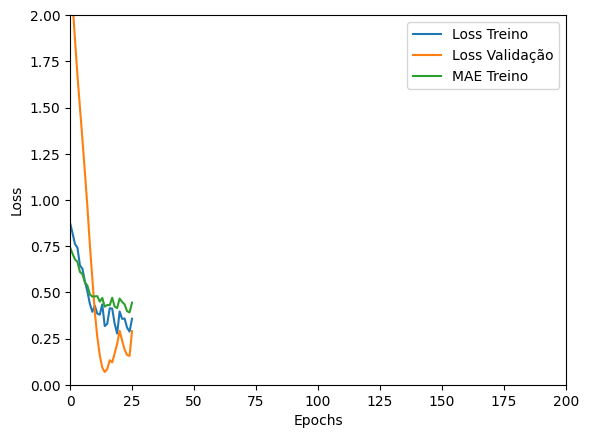

Tempo de treino: 0.09791172742843628 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36155766248703003 , MAE = 0.4581432044506073'

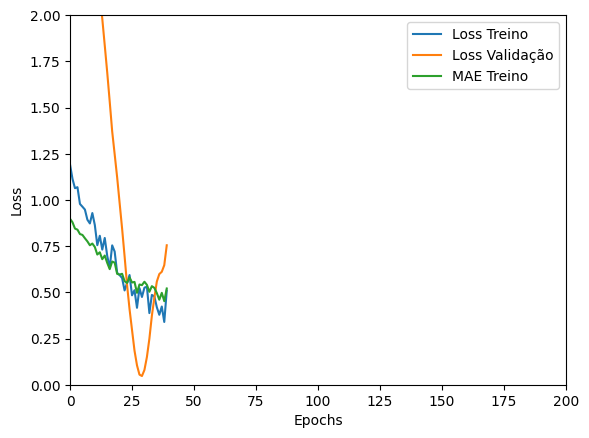

Tempo de treino: 0.12406111558278402 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3511984646320343 , MAE = 0.4560318887233734'

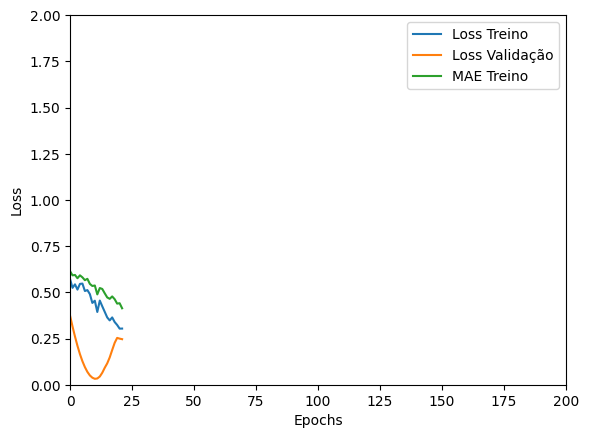

Tempo de treino: 0.08676035404205322 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3439895510673523 , MAE = 0.46015465259552'

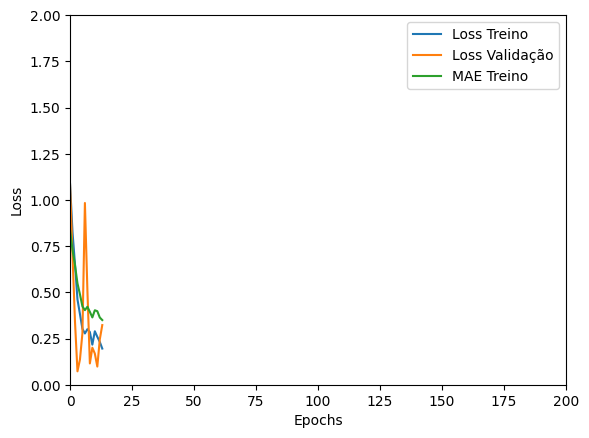

Tempo de treino: 0.12288133303324382 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20613974332809448 , MAE = 0.3263323903083801'

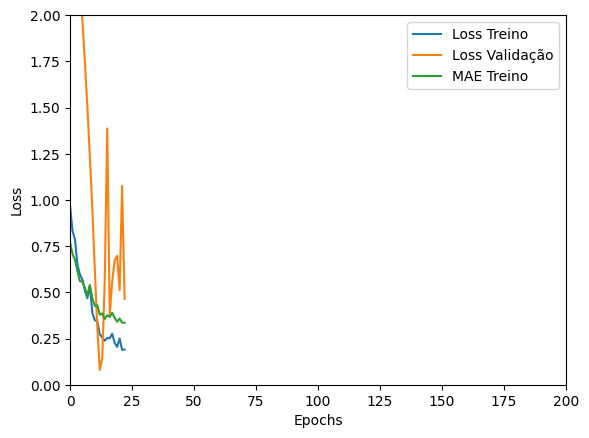

Tempo de treino: 0.11236625512441 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.199015274643898 , MAE = 0.33344271779060364'

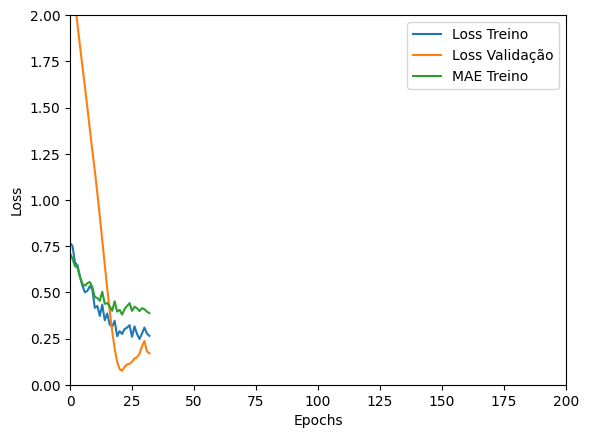

Tempo de treino: 0.11809483369191488 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21719929575920105 , MAE = 0.3434794545173645'

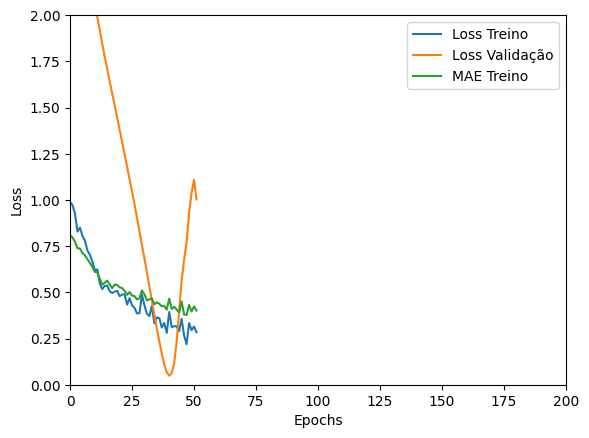

Tempo de treino: 0.14341925382614135 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10010373592376709 , MAE = 0.22968311607837677'

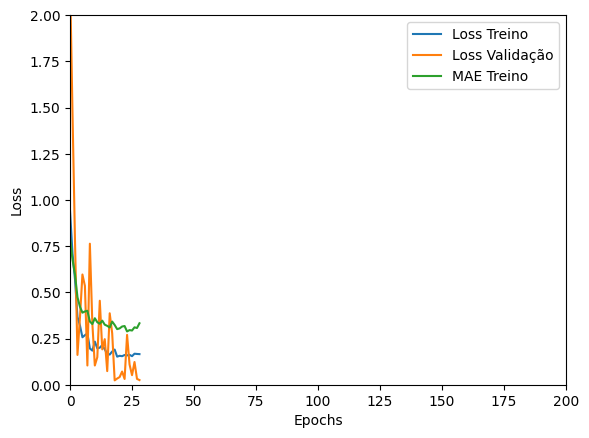

Tempo de treino: 0.21613059441248575 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3531273305416107 , MAE = 0.4610407054424286'

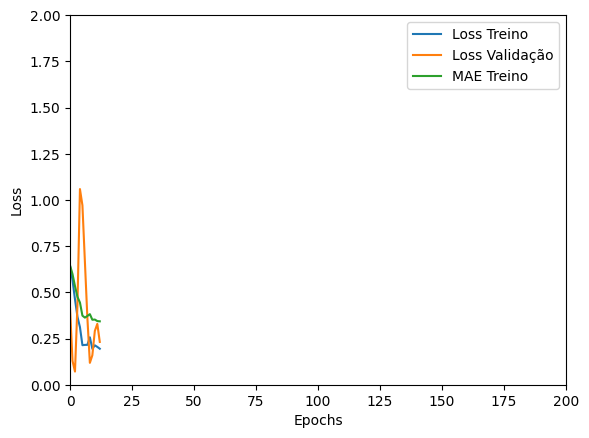

Tempo de treino: 0.08188704252243043 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20101648569107056 , MAE = 0.3265535235404968'

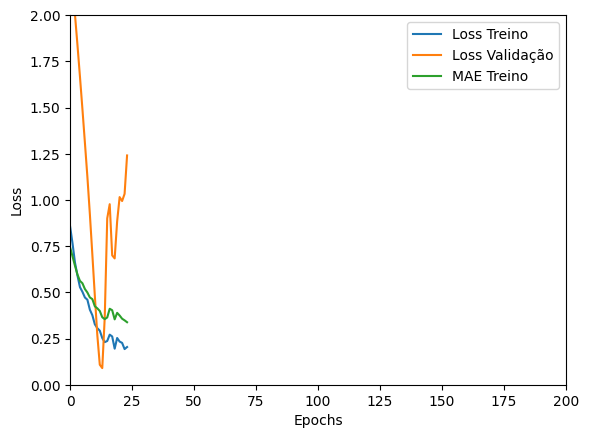

Tempo de treino: 0.07464183966318766 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26785460114479065 , MAE = 0.3737083077430725'

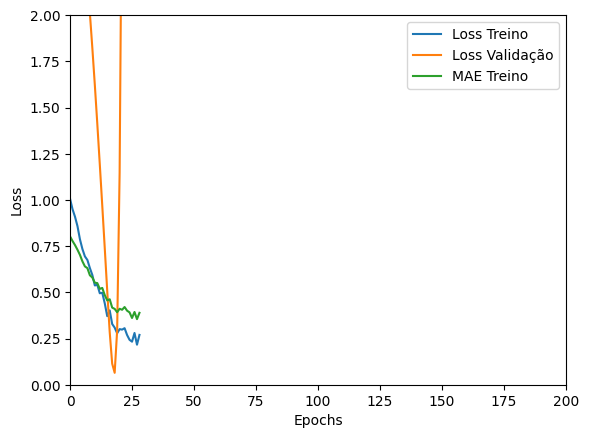

Tempo de treino: 0.09841736157735188 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08097302168607712 , MAE = 0.2049054503440857'

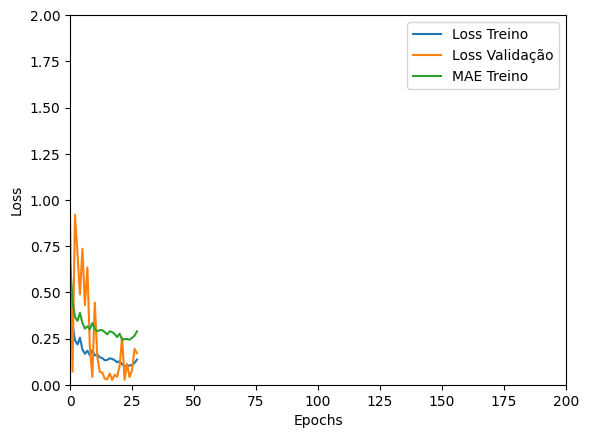

Tempo de treino: 0.16630839506785075 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2739018201828003 , MAE = 0.39531463384628296'

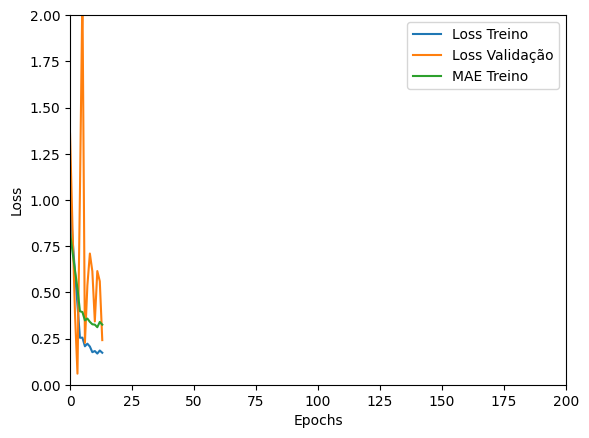

Tempo de treino: 0.09321689208348592 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2379002869129181 , MAE = 0.36229395866394043'

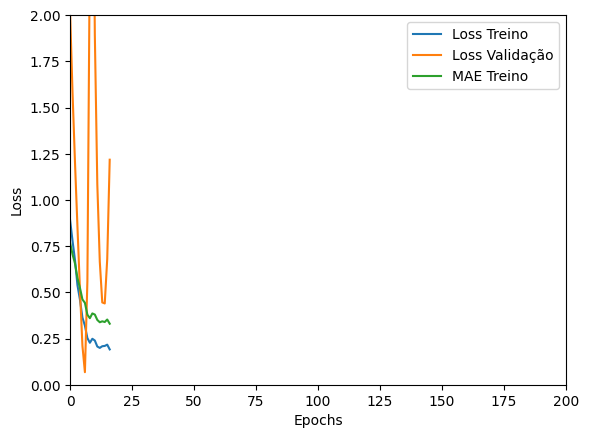

Tempo de treino: 0.09066217343012492 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23285721242427826 , MAE = 0.3706738352775574'

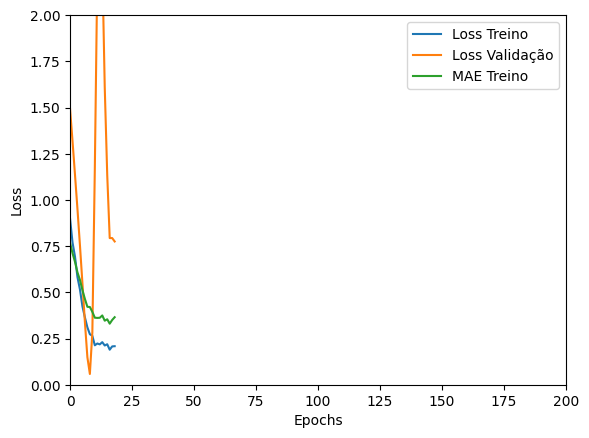

Tempo de treino: 0.091964058081309 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com GRU_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04352923855185509 , MAE = 0.16065636277198792'

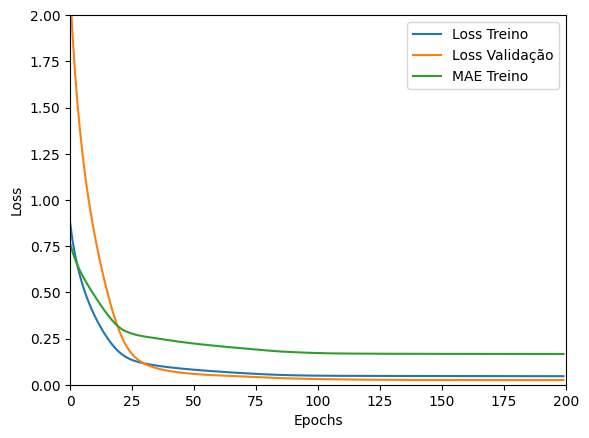

Tempo de treino: 0.6909936428070068 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04851865395903587 , MAE = 0.1693326234817505'

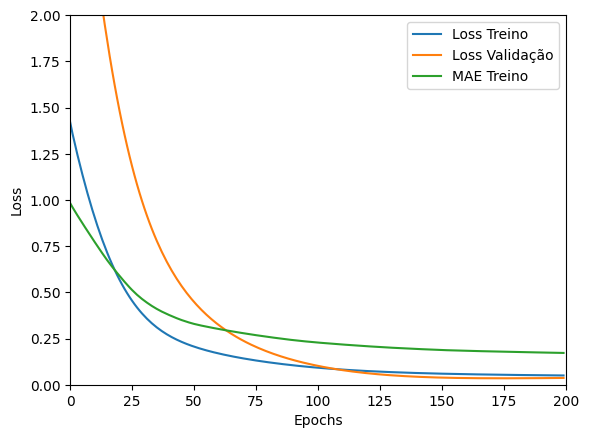

Tempo de treino: 0.4483290831247965 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07269006222486496 , MAE = 0.2144441157579422'

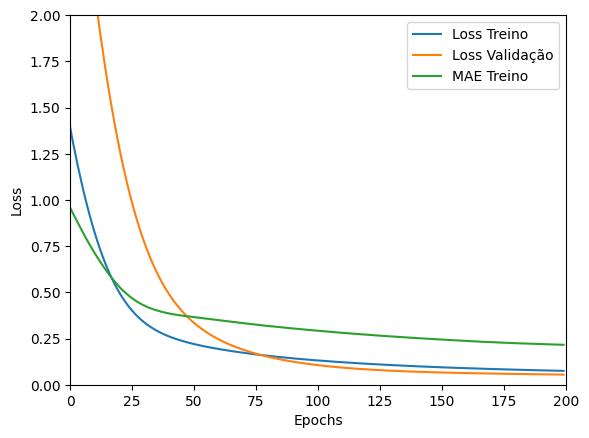

Tempo de treino: 0.4209878126780192 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19087737798690796 , MAE = 0.34131738543510437'

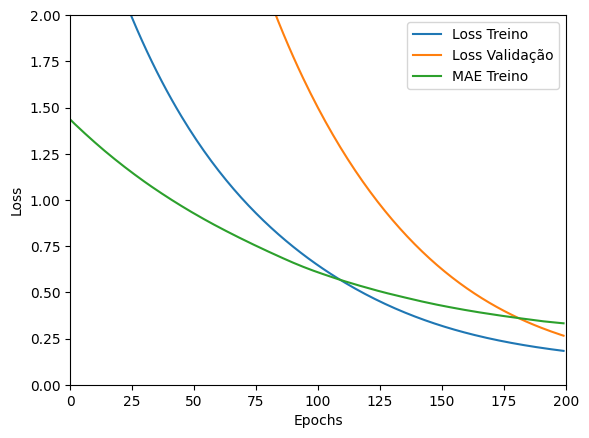

Tempo de treino: 0.4229817708333333 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04255681112408638 , MAE = 0.15797147154808044'

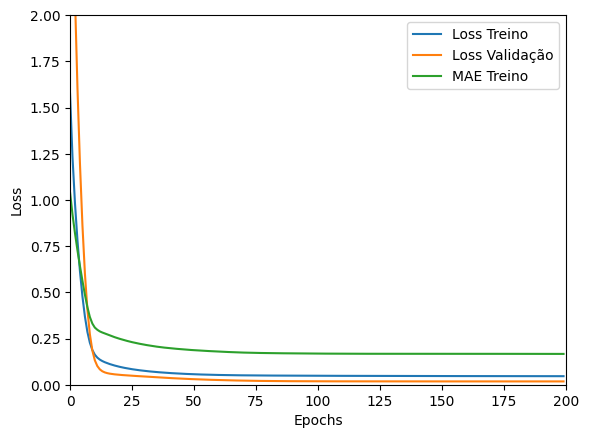

Tempo de treino: 0.7474637111028035 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042837489396333694 , MAE = 0.1593562364578247'

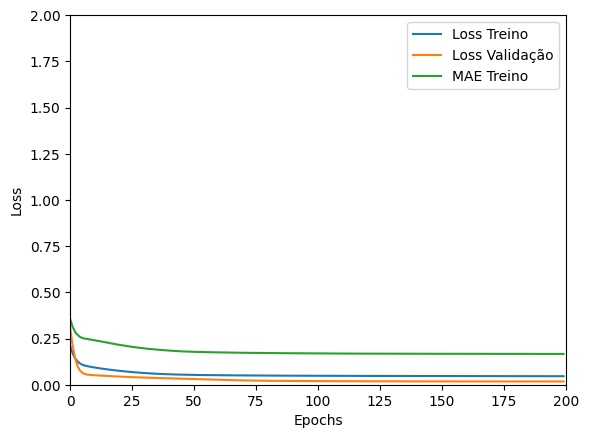

Tempo de treino: 0.7341426650683085 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048552244901657104 , MAE = 0.16882050037384033'

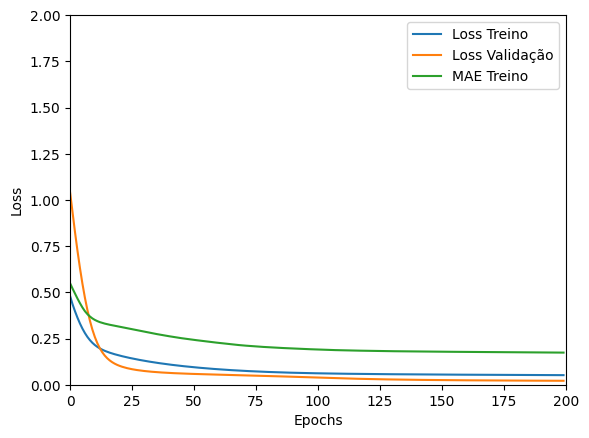

Tempo de treino: 0.3188630779584249 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05398833751678467 , MAE = 0.1841476410627365'

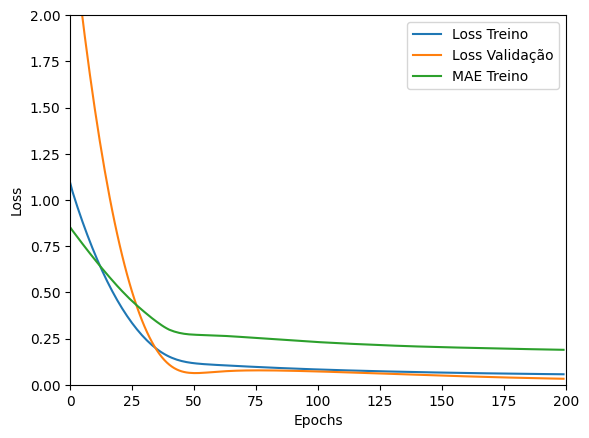

Tempo de treino: 0.7380909482638042 minutos


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com GRU_v1 , timesteps=12, units=16, batch=4


'TRAINING set. Loss = 0.04232899844646454 , MAE = 0.15683069825172424'

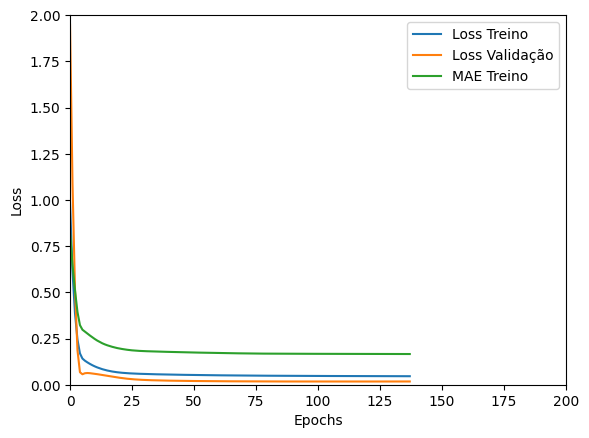

Tempo de treino: 0.5534403165181477 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04220963269472122 , MAE = 0.15792308747768402'

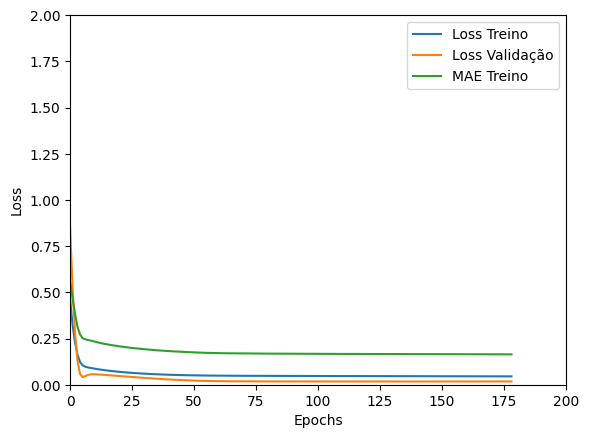

Tempo de treino: 0.7371246973673503 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04608394205570221 , MAE = 0.16418474912643433'

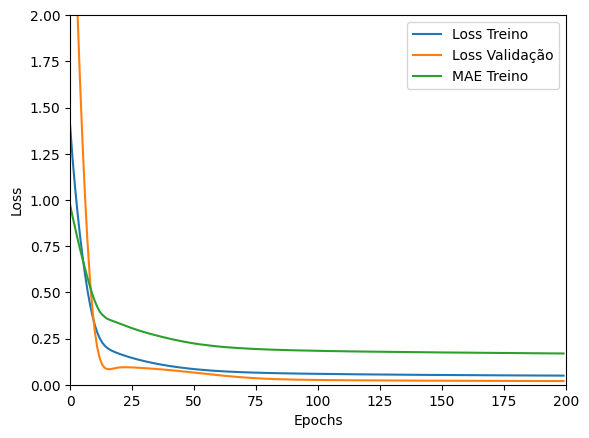

Tempo de treino: 0.33901784420013426 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04637322574853897 , MAE = 0.16741785407066345'

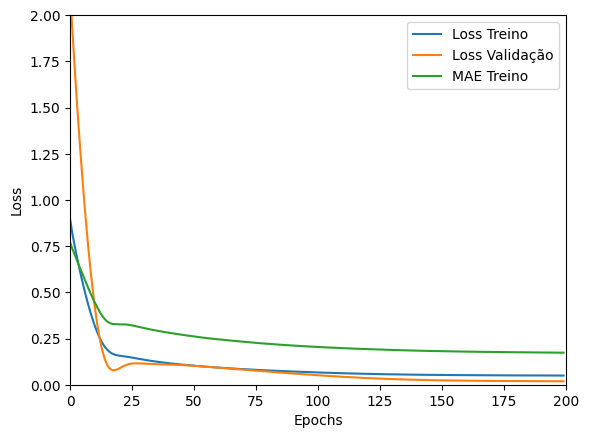

Tempo de treino: 0.40269068876902264 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042802006006240845 , MAE = 0.15734092891216278'

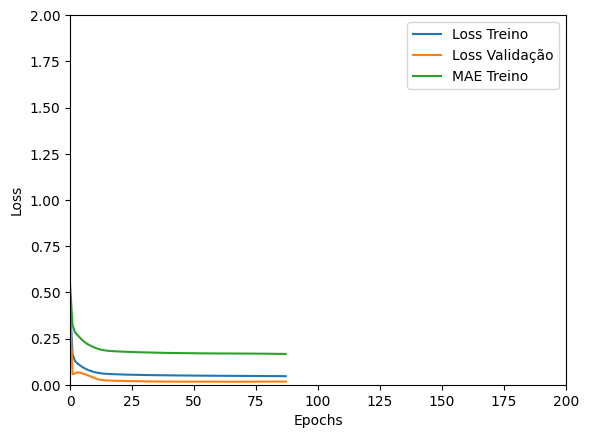

Tempo de treino: 0.36107177734375 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042857956141233444 , MAE = 0.15798945724964142'

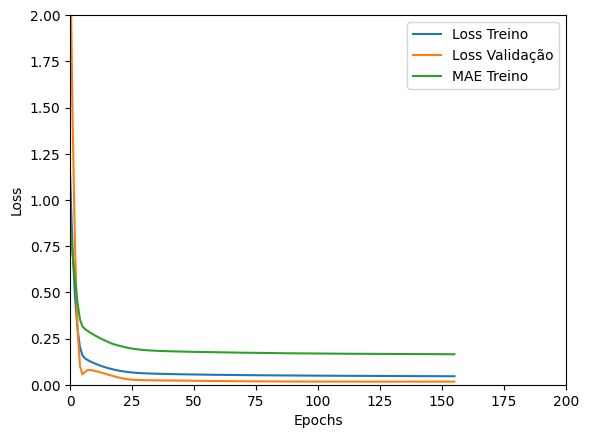

Tempo de treino: 0.7383938431739807 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04535967484116554 , MAE = 0.16215157508850098'

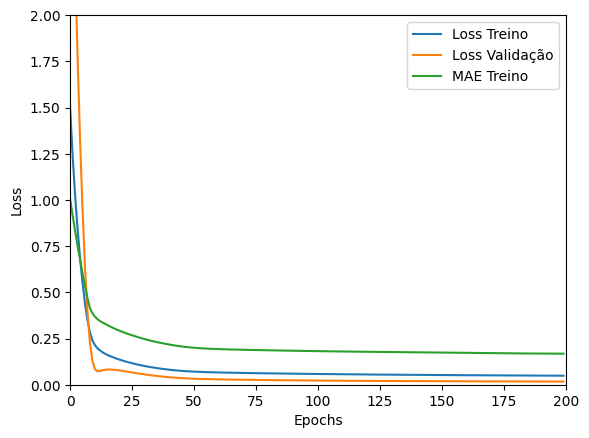

Tempo de treino: 0.33548952341079713 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12935397028923035 , MAE = 0.27726471424102783'

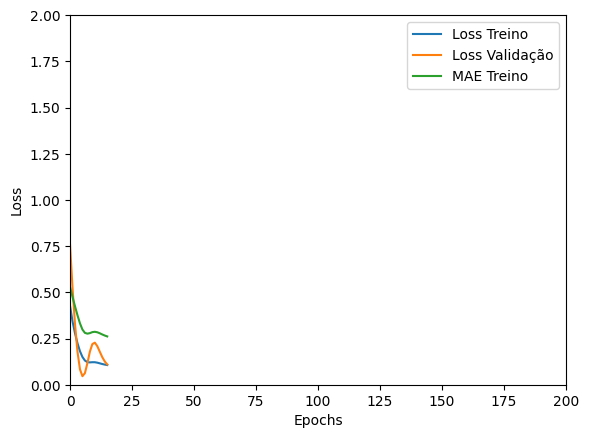

Tempo de treino: 0.1026238203048706 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04110638052225113 , MAE = 0.15167436003684998'

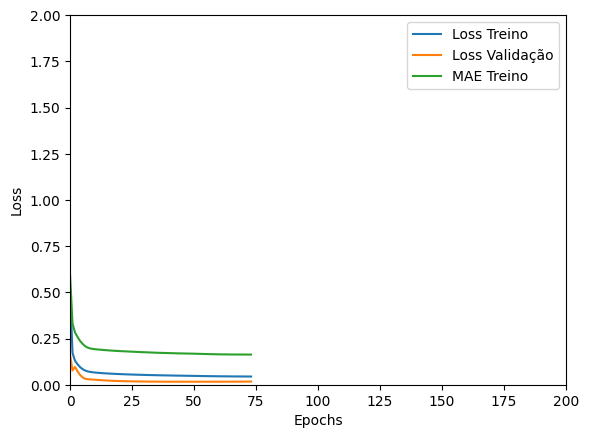

Tempo de treino: 0.31399236917495726 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.03946182131767273 , MAE = 0.14977598190307617'

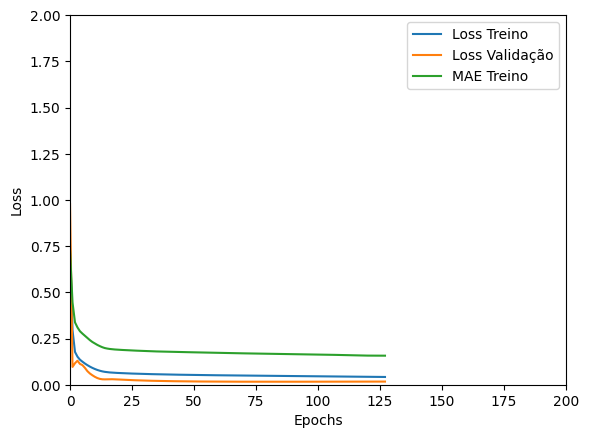

Tempo de treino: 0.41596876780192055 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08071675151586533 , MAE = 0.2164309322834015'

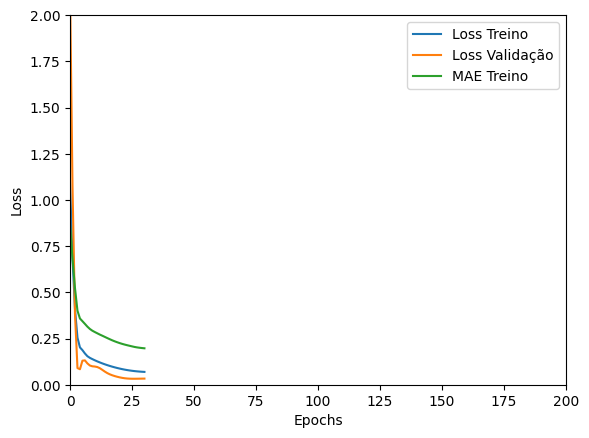

Tempo de treino: 0.15183293024698893 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0455179326236248 , MAE = 0.16557888686656952'

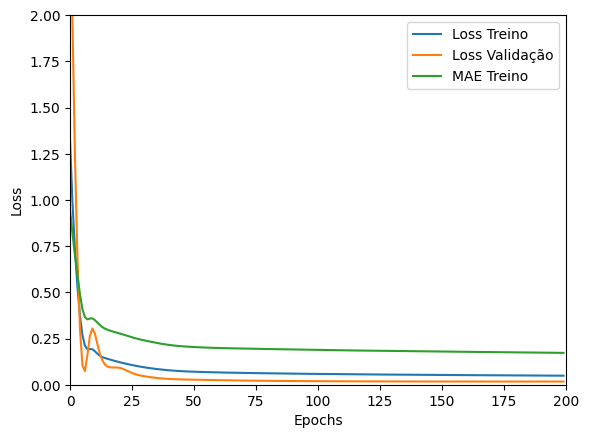

Tempo de treino: 0.3650348424911499 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4833729863166809 , MAE = 0.5169979929924011'

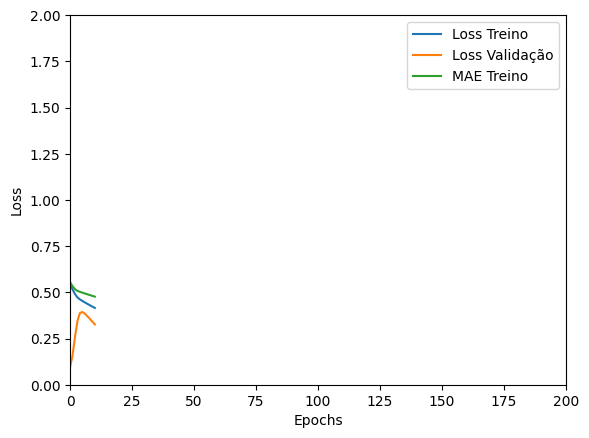

Tempo de treino: 0.10890898307164511 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.047504451125860214 , MAE = 0.1709260791540146'

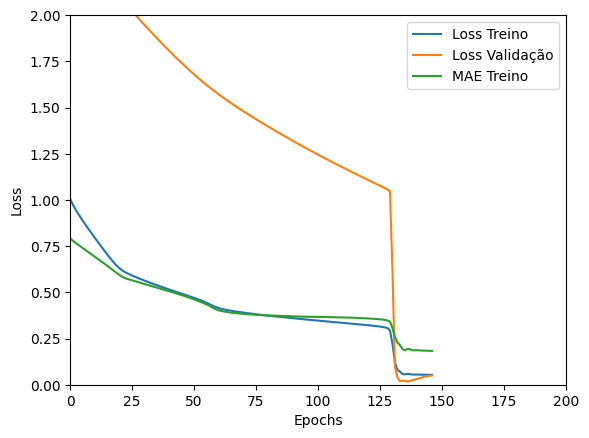

Tempo de treino: 0.5172906835873922 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2627621591091156 , MAE = 0.362068235874176'

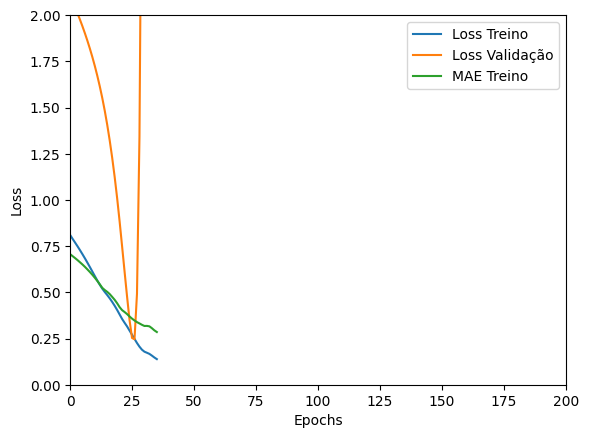

Tempo de treino: 0.12479021151860555 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5519256591796875 , MAE = 0.5412941575050354'

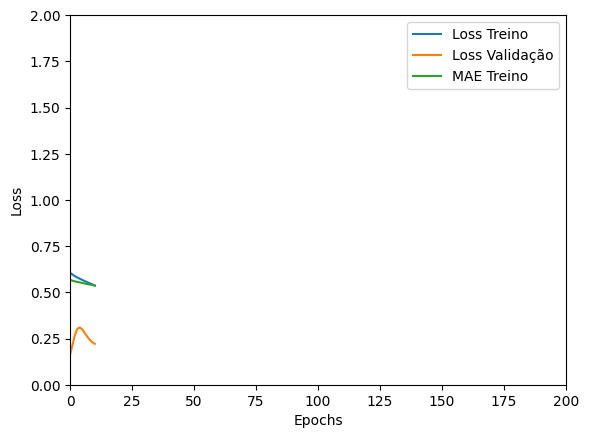

Tempo de treino: 0.1391693353652954 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5183053612709045 , MAE = 0.5644696950912476'

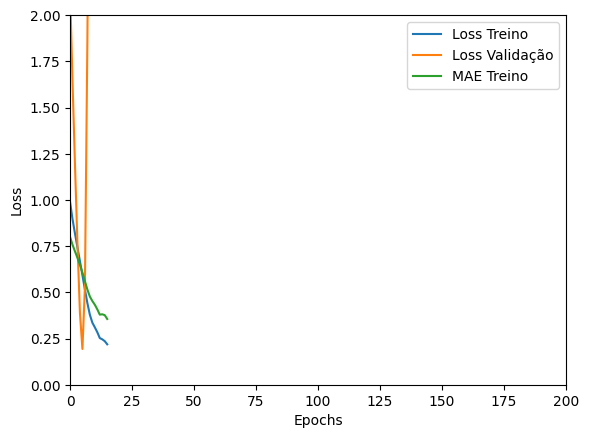

Tempo de treino: 0.17463624080022175 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3873981833457947 , MAE = 0.4872514307498932'

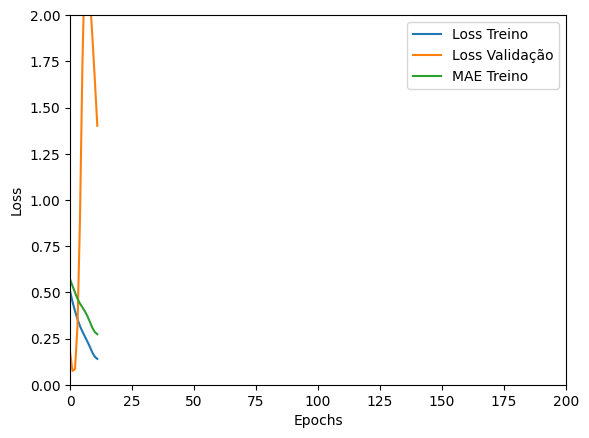

Tempo de treino: 0.09107514222462972 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22990864515304565 , MAE = 0.34790751338005066'

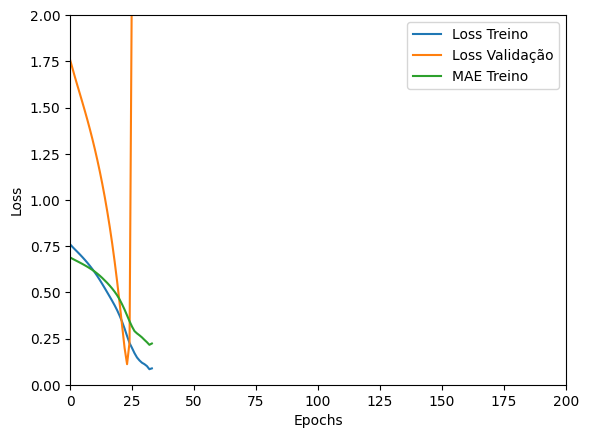

Tempo de treino: 0.1304718812306722 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4031611382961273 , MAE = 0.4312668442726135'

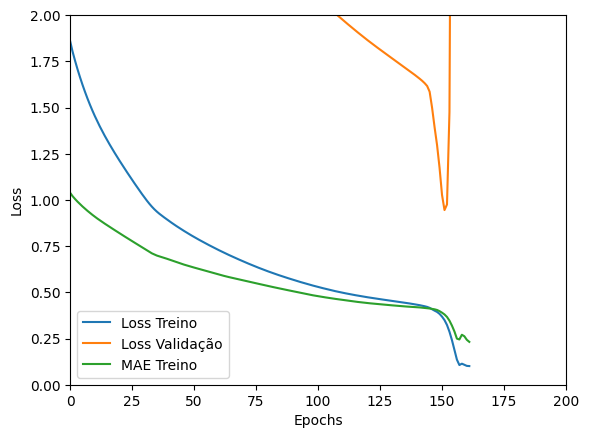

Tempo de treino: 0.2864923357963562 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08532382547855377 , MAE = 0.2088417112827301'

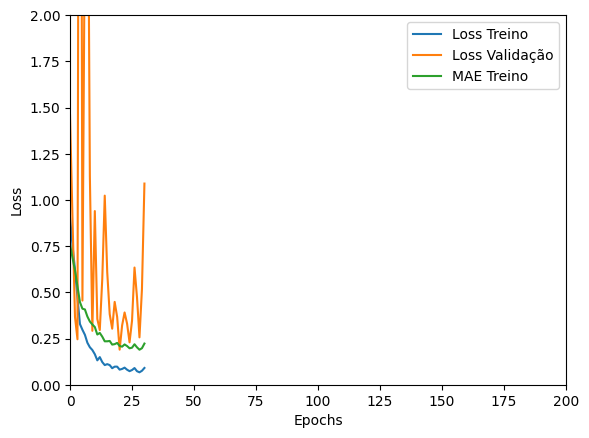

Tempo de treino: 0.22853294213612874 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33558905124664307 , MAE = 0.4374447166919708'

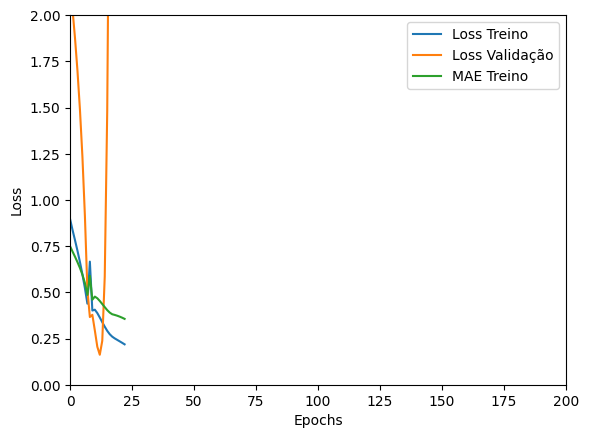

Tempo de treino: 0.12778534491856894 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3066363036632538 , MAE = 0.38515225052833557'

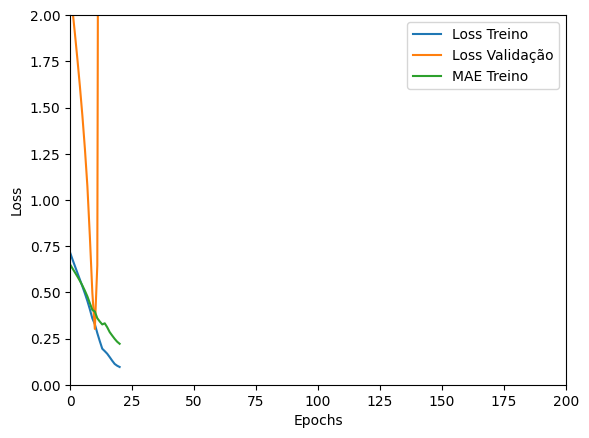

Tempo de treino: 0.16495554049809774 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35798612236976624 , MAE = 0.4261794090270996'

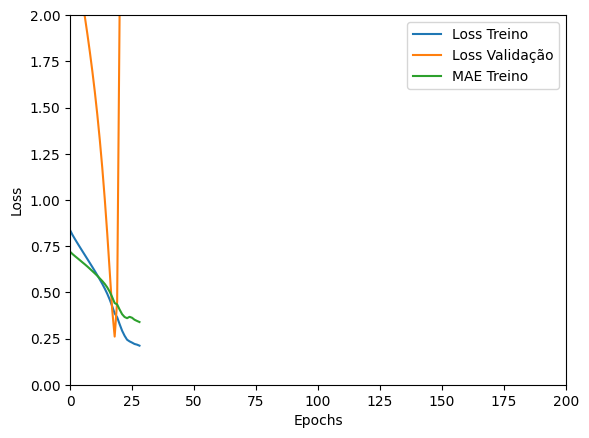

Tempo de treino: 0.1045347531636556 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5140514373779297 , MAE = 0.546396791934967'

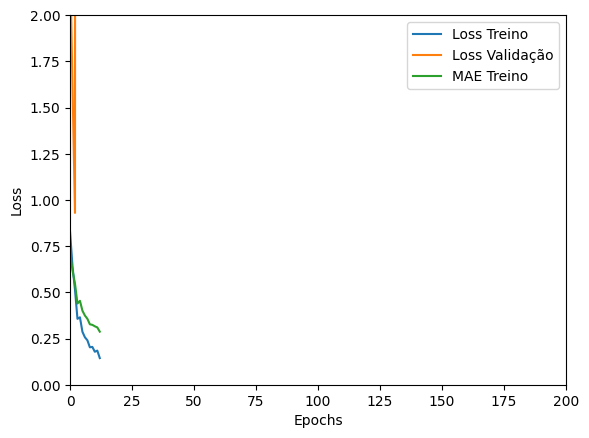

Tempo de treino: 0.14499400854110717 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40734434127807617 , MAE = 0.48902884125709534'

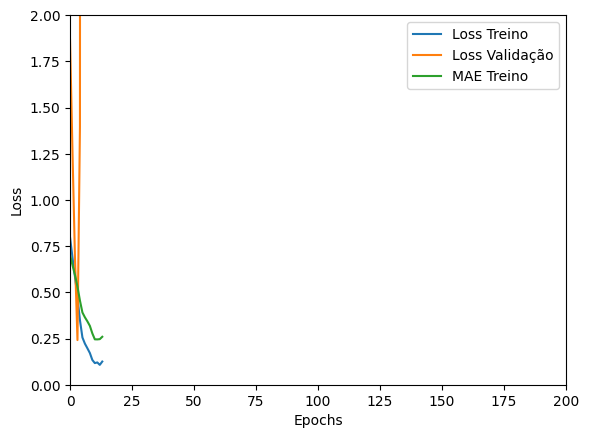

Tempo de treino: 0.12916692892710369 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29023513197898865 , MAE = 0.3812311291694641'

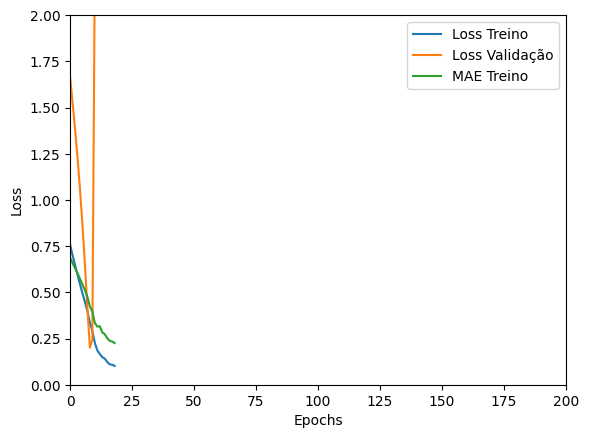

Tempo de treino: 0.1277139941851298 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37703609466552734 , MAE = 0.4651930332183838'

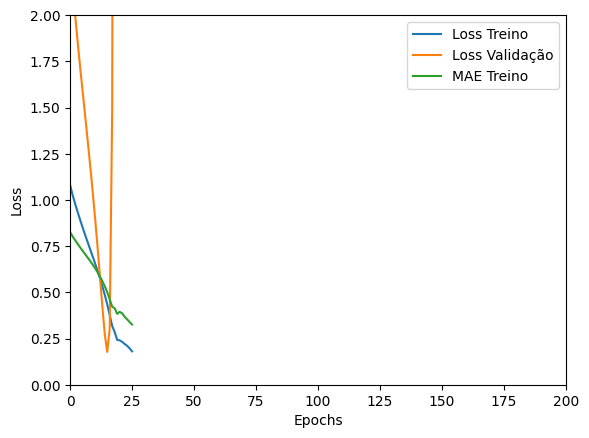

Tempo de treino: 0.1328342914581299 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1194569319486618 , MAE = 0.25361350178718567'

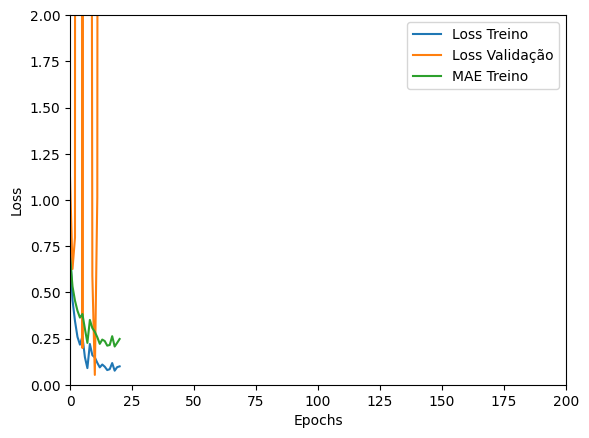

Tempo de treino: 0.1841551423072815 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.308357298374176 , MAE = 0.4363711178302765'

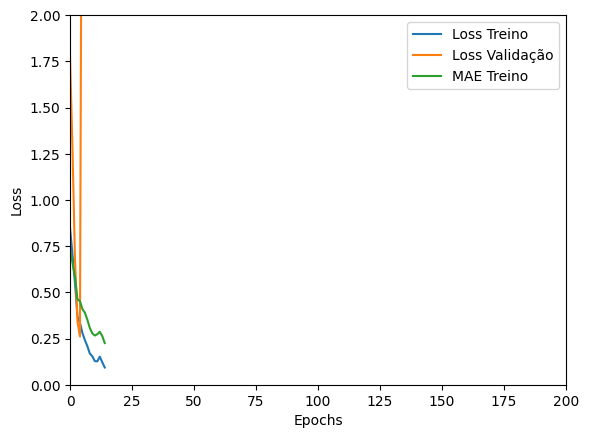

Tempo de treino: 0.1511542042096456 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2622201144695282 , MAE = 0.3754788339138031'

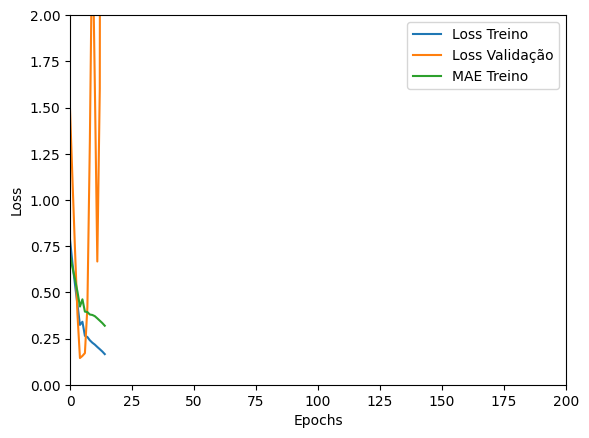

Tempo de treino: 0.10153423150380453 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39884570240974426 , MAE = 0.4697088301181793'

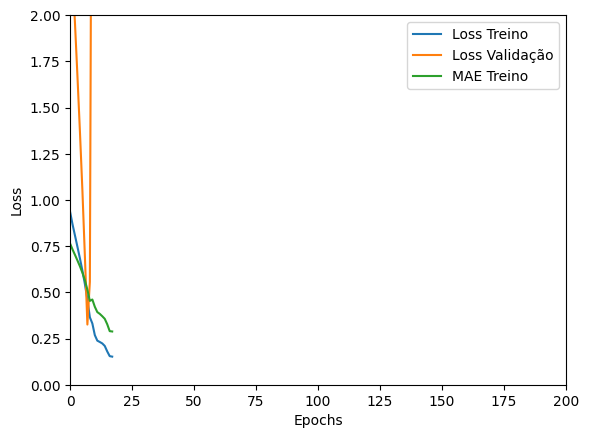

Tempo de treino: 0.08886353572209676 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=24, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16657224297523499 , MAE = 0.2880282402038574'

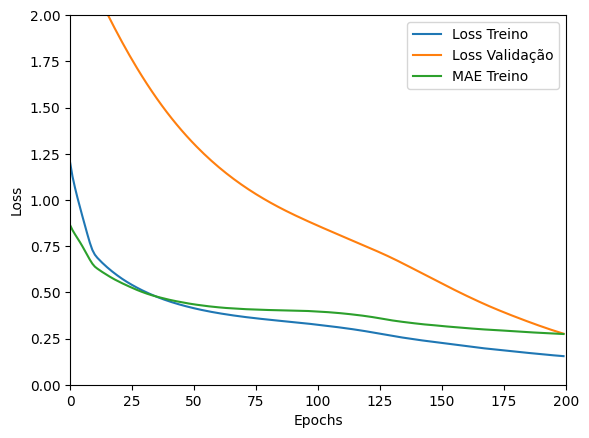

Tempo de treino: 1.1296129862467448 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4576139748096466 , MAE = 0.5101978778839111'

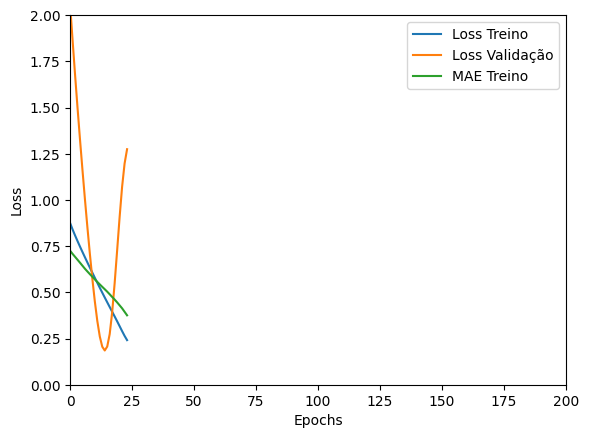

Tempo de treino: 0.11818794012069703 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33897072076797485 , MAE = 0.4412015676498413'

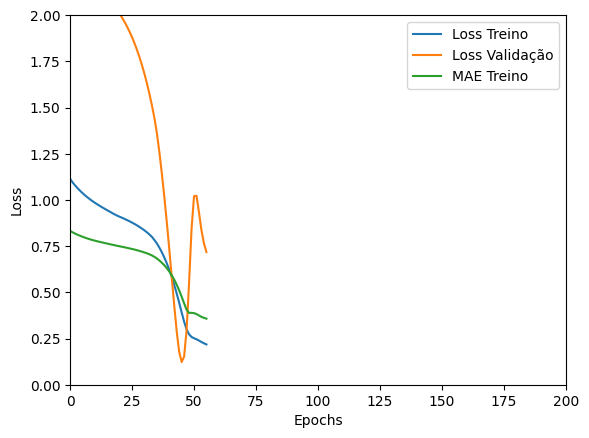

Tempo de treino: 0.1658570965131124 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26638931035995483 , MAE = 0.39329639077186584'

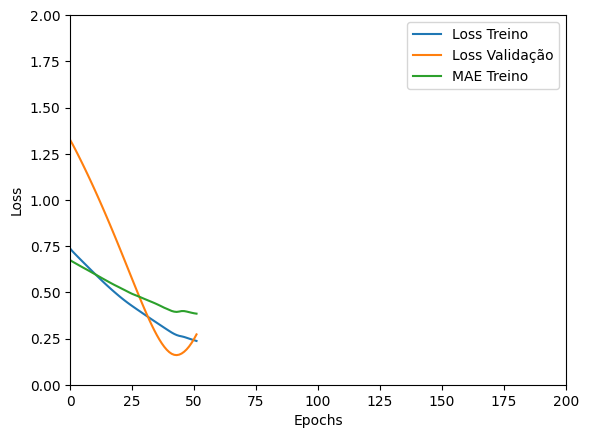

Tempo de treino: 0.1264273444811503 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.545962393283844 , MAE = 0.5707507133483887'

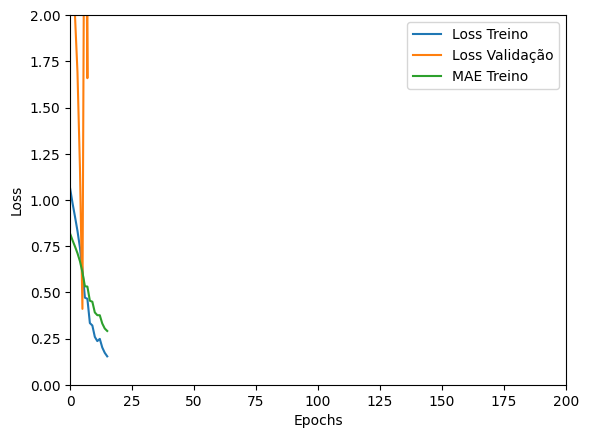

Tempo de treino: 0.19468966722488404 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4322308301925659 , MAE = 0.4808785915374756'

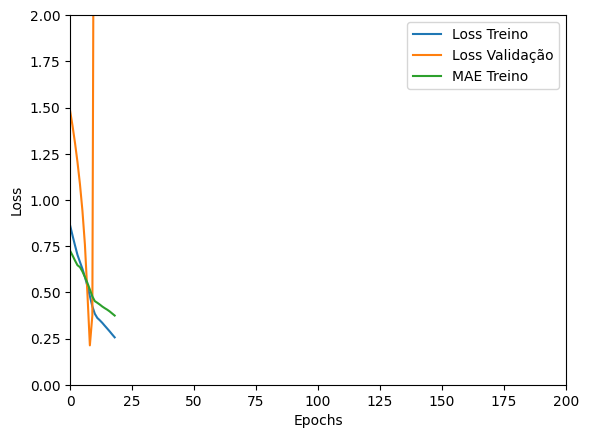

Tempo de treino: 0.1362960934638977 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18492701649665833 , MAE = 0.2986546456813812'

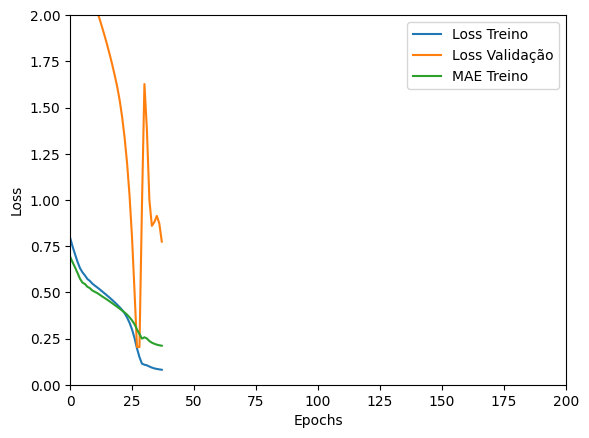

Tempo de treino: 0.14074031909306844 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18471941351890564 , MAE = 0.3216348886489868'

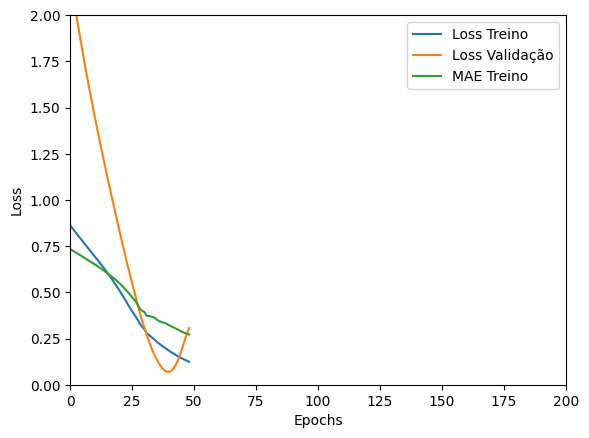

Tempo de treino: 0.13053791920344035 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4898045063018799 , MAE = 0.5152744650840759'

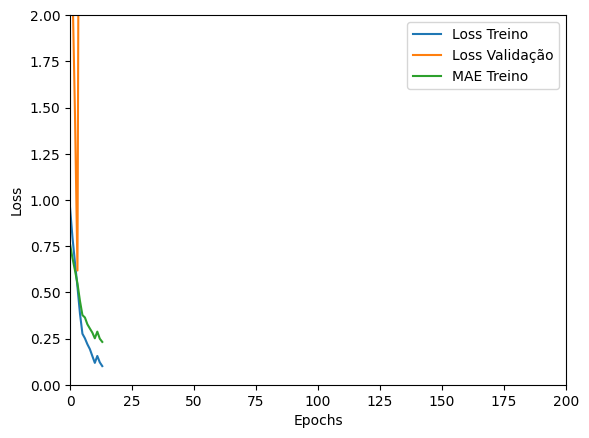

Tempo de treino: 0.13271387020746866 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26133087277412415 , MAE = 0.3830830454826355'

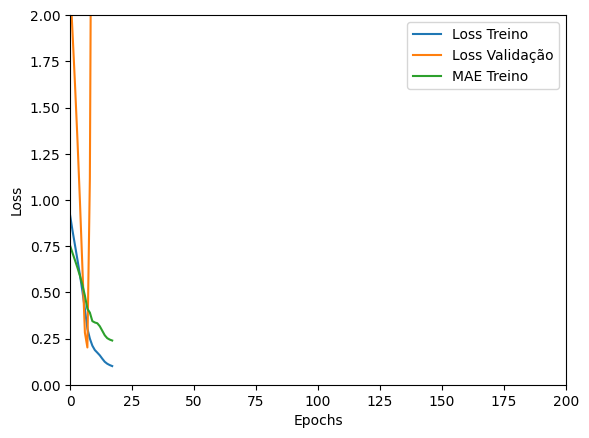

Tempo de treino: 0.13032464583714803 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41178005933761597 , MAE = 0.480705589056015'

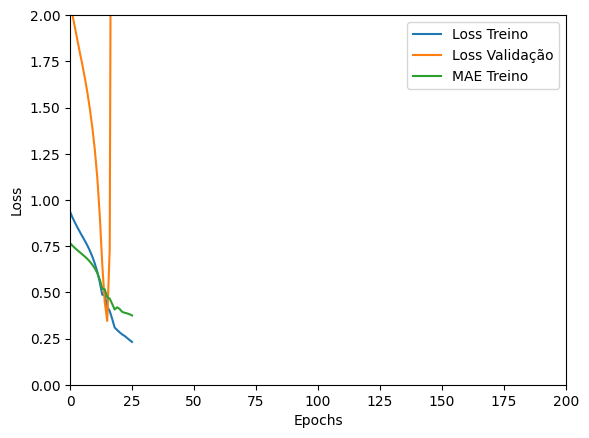

Tempo de treino: 0.12994802792867025 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3564052879810333 , MAE = 0.4405711889266968'

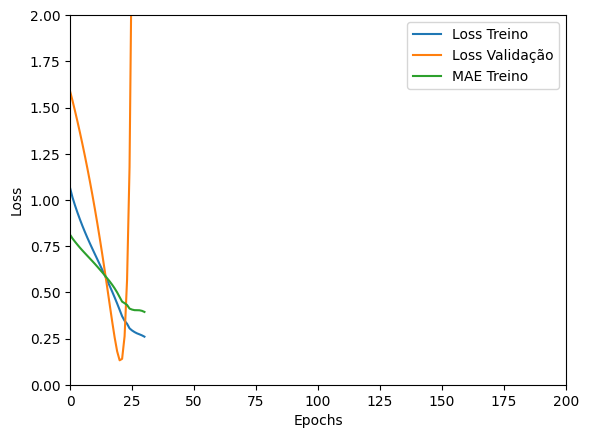

Tempo de treino: 0.12394911448160807 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28660526871681213 , MAE = 0.39794695377349854'

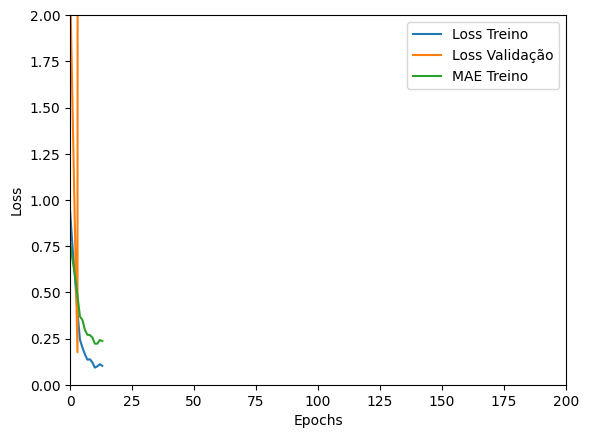

Tempo de treino: 0.2260300636291504 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40631401538848877 , MAE = 0.49687451124191284'

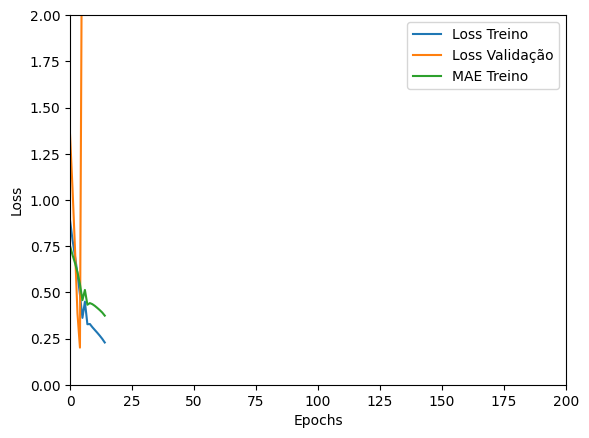

Tempo de treino: 0.11467684507369995 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.326614648103714 , MAE = 0.40951088070869446'

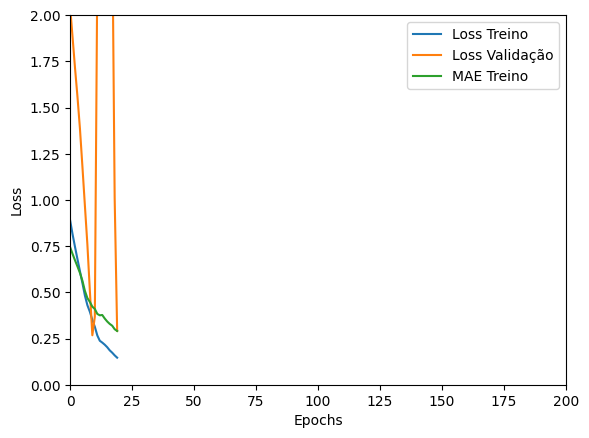

Tempo de treino: 0.08963114420572917 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49550503492355347 , MAE = 0.5408143997192383'

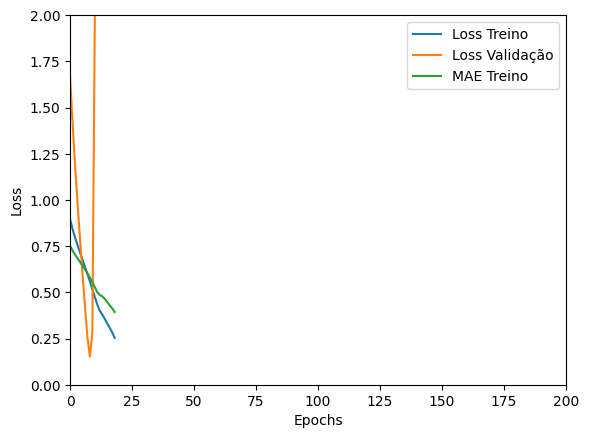

Tempo de treino: 0.08472299178441366 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11555728316307068 , MAE = 0.24695876240730286'

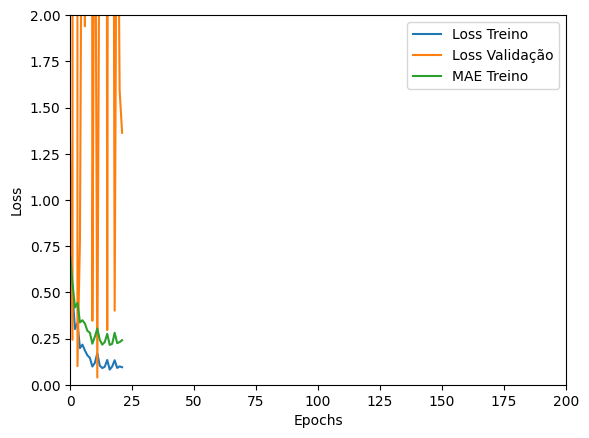

Tempo de treino: 0.22366505066553752 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3462632894515991 , MAE = 0.43248799443244934'

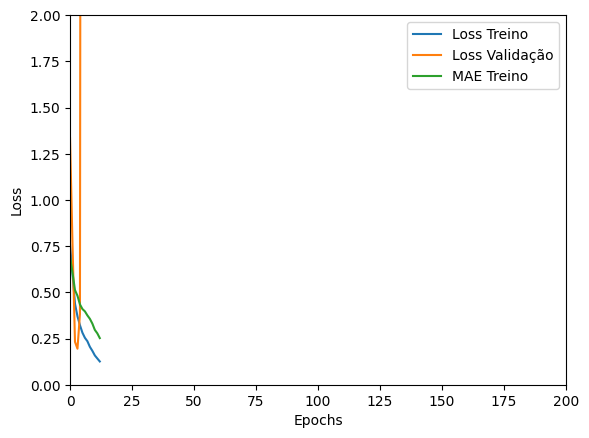

Tempo de treino: 0.13695569435755411 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4732084274291992 , MAE = 0.5194673538208008'

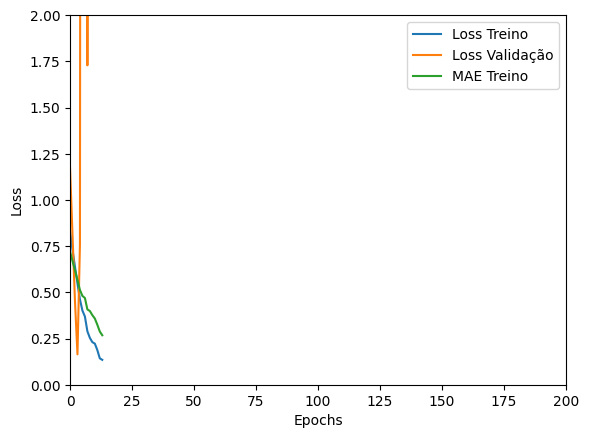

Tempo de treino: 0.10447425842285156 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.48731136322021484 , MAE = 0.5241568088531494'

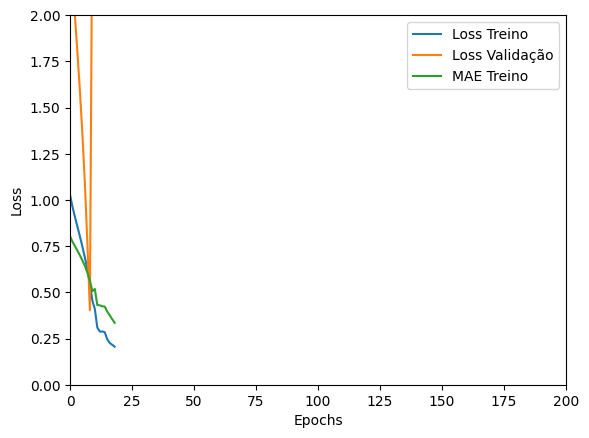

Tempo de treino: 0.08702916701634725 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=24, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3344041705131531 , MAE = 0.4204246997833252'

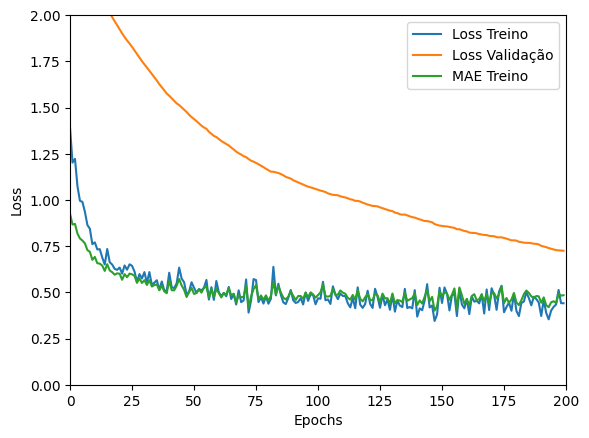

Tempo de treino: 1.4210623900095622 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6957853436470032 , MAE = 0.5997247099876404'

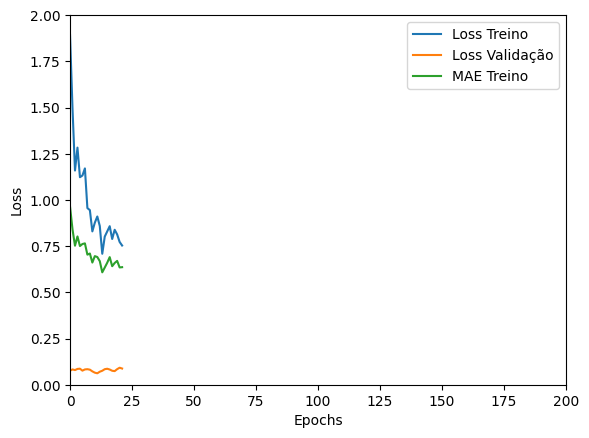

Tempo de treino: 0.12881364822387695 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2706398665904999 , MAE = 0.3821573555469513'

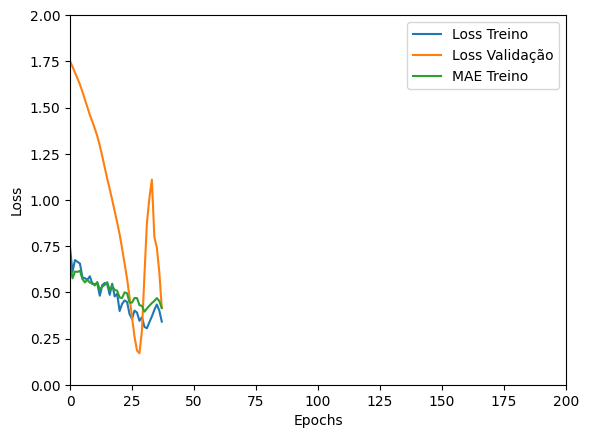

Tempo de treino: 0.11400805711746216 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5397741198539734 , MAE = 0.5550876259803772'

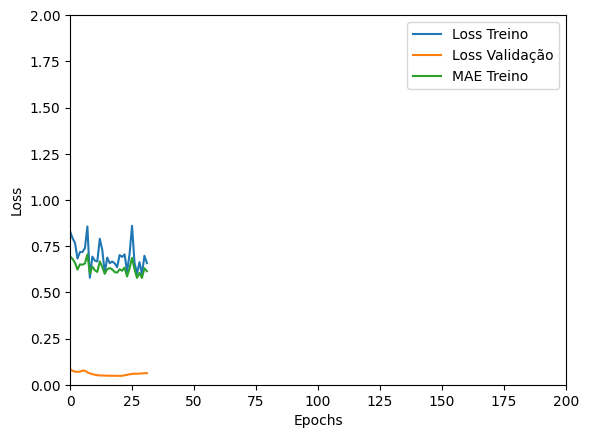

Tempo de treino: 0.10306416749954224 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15301251411437988 , MAE = 0.28553035855293274'

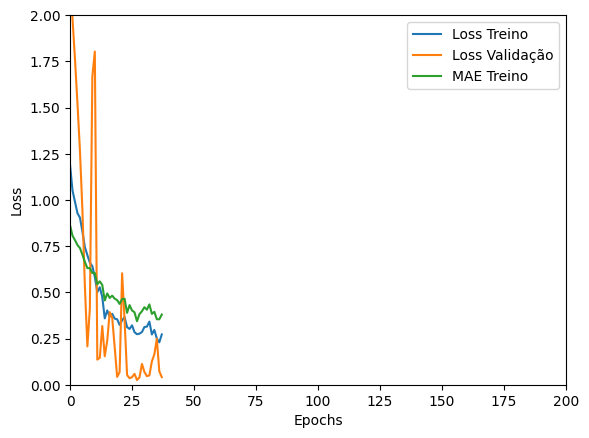

Tempo de treino: 0.3167007764180501 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47362998127937317 , MAE = 0.5164018273353577'

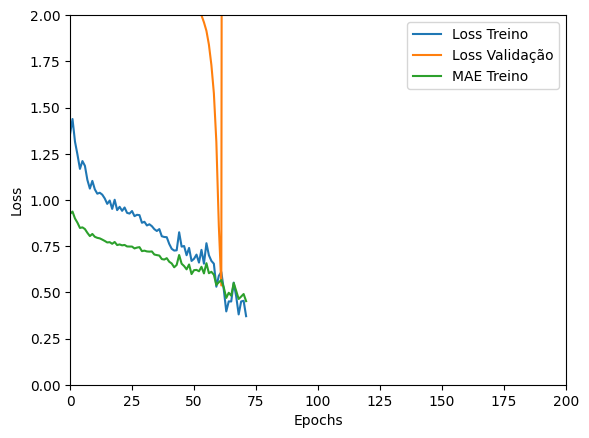

Tempo de treino: 0.30949235359827676 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37728604674339294 , MAE = 0.46015092730522156'

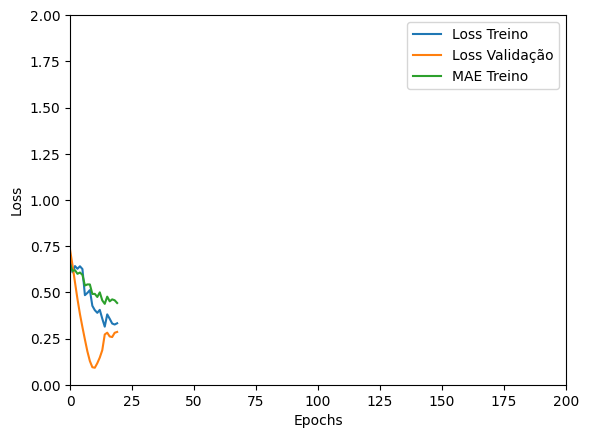

Tempo de treino: 0.13343727986017864 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4151712656021118 , MAE = 0.4923401474952698'

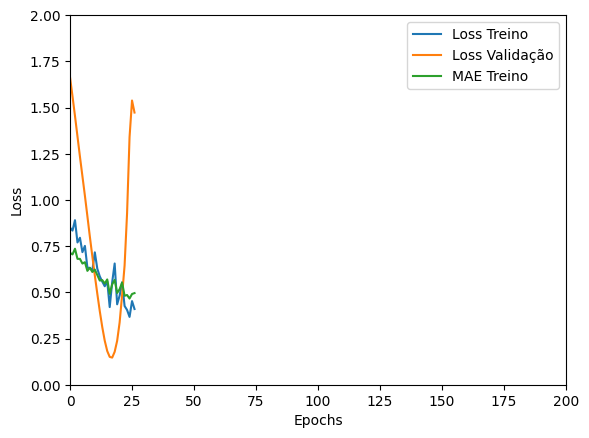

Tempo de treino: 0.10172181526819865 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06002291291952133 , MAE = 0.18724264204502106'

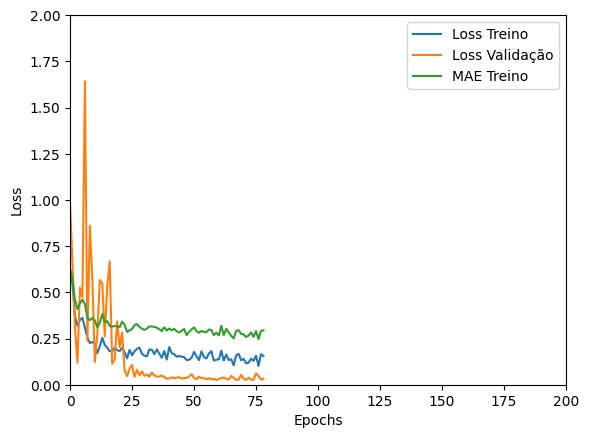

Tempo de treino: 0.49692033529281615 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4440563917160034 , MAE = 0.49205490946769714'

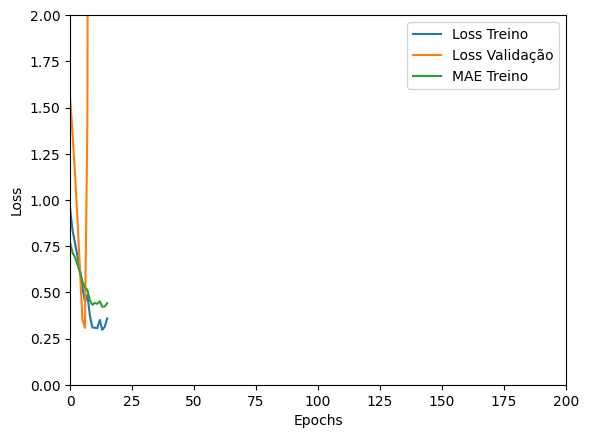

Tempo de treino: 0.12760320901870728 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21652883291244507 , MAE = 0.33574724197387695'

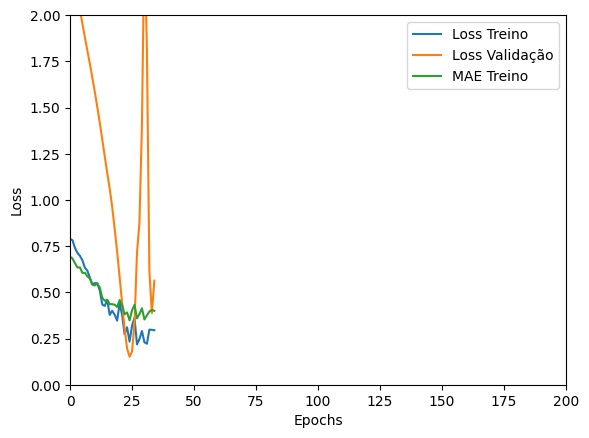

Tempo de treino: 0.12684475580851237 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6973924040794373 , MAE = 0.6233333945274353'

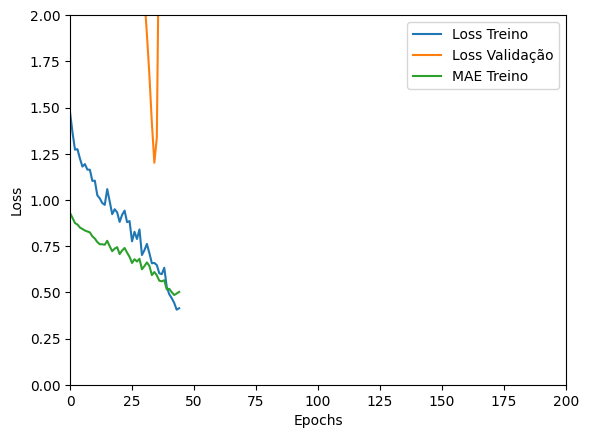

Tempo de treino: 0.1688919981320699 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12049668282270432 , MAE = 0.24739134311676025'

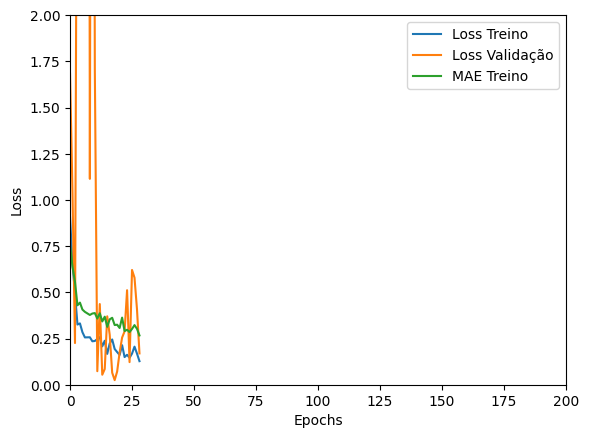

Tempo de treino: 0.24145145018895467 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16997678577899933 , MAE = 0.30180251598358154'

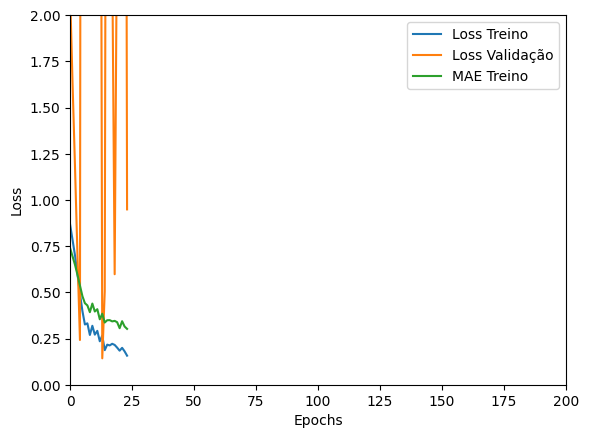

Tempo de treino: 0.14414789279301962 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3939002752304077 , MAE = 0.4774237871170044'

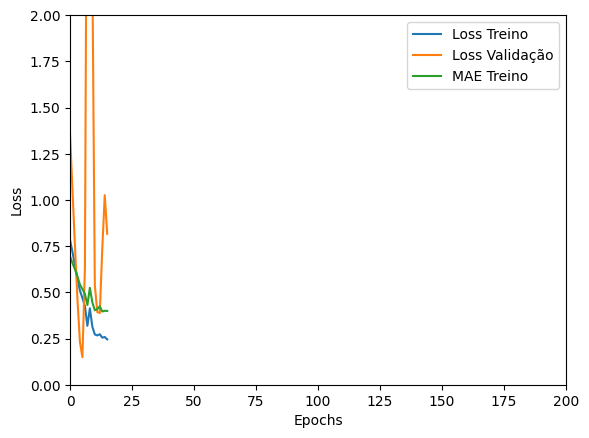

Tempo de treino: 0.08931028048197429 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.44093215465545654 , MAE = 0.5022134780883789'

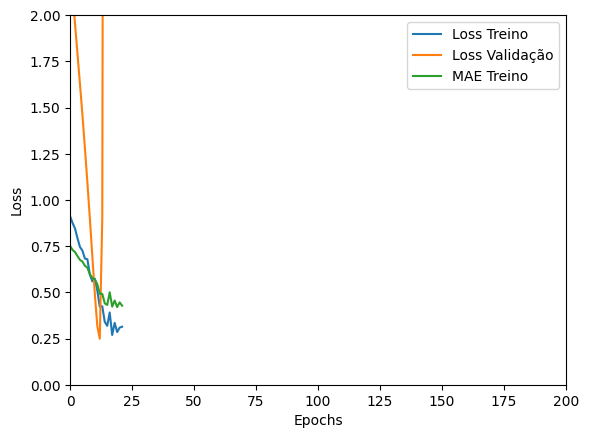

Tempo de treino: 0.09781285524368286 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07788242399692535 , MAE = 0.20818616449832916'

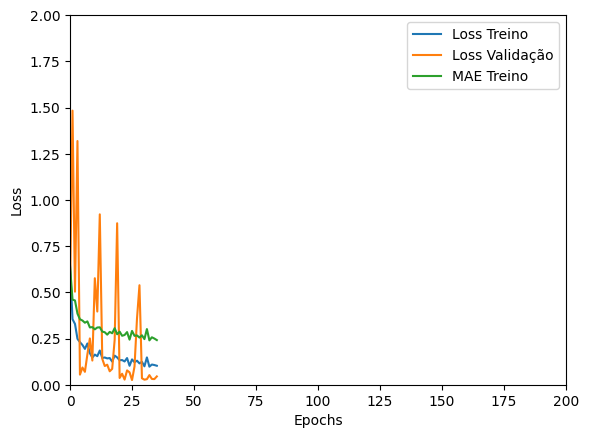

Tempo de treino: 0.38812841176986695 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1716715544462204 , MAE = 0.30143868923187256'

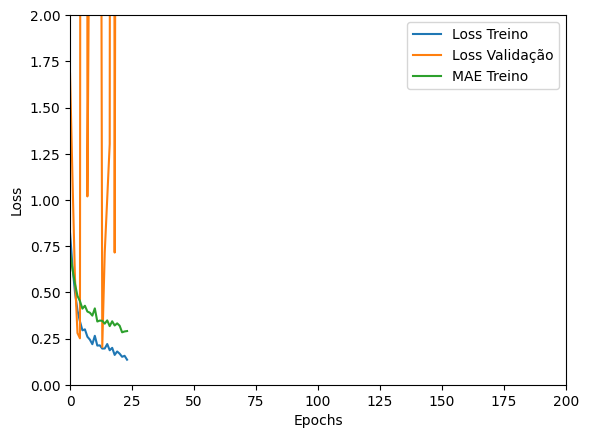

Tempo de treino: 0.14928945700327556 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4747319519519806 , MAE = 0.5220348238945007'

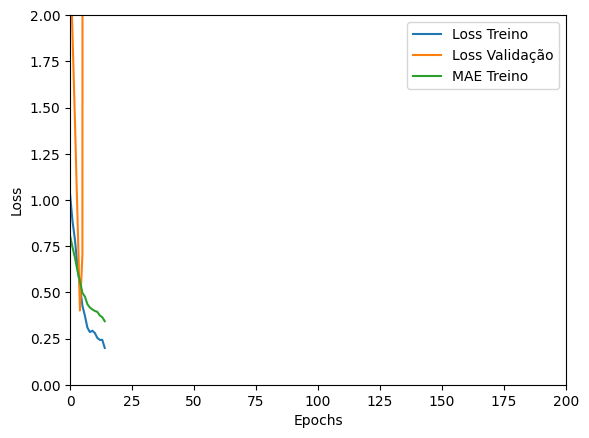

Tempo de treino: 0.1515455921490987 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30943331122398376 , MAE = 0.39961785078048706'

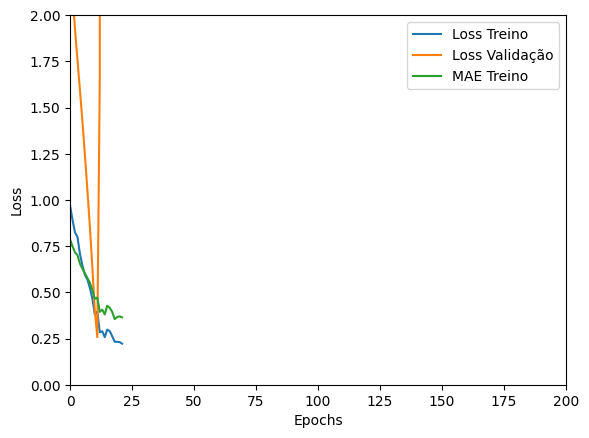

Tempo de treino: 0.13632798592249554 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com GRU_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.052639178931713104 , MAE = 0.17977851629257202'

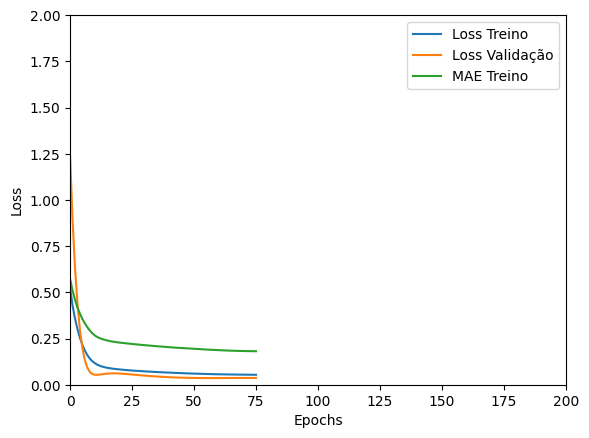

Tempo de treino: 0.7534598747889201 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0753544420003891 , MAE = 0.21469739079475403'

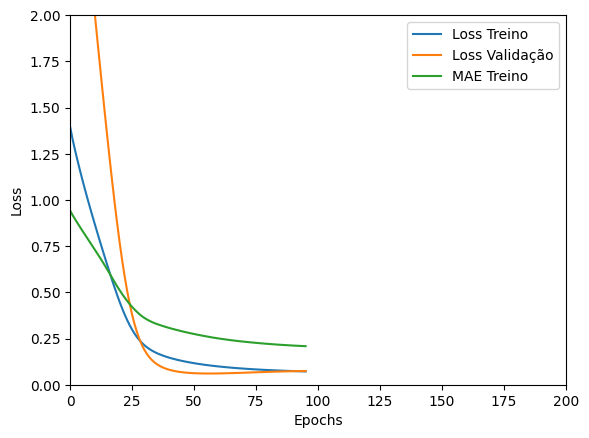

Tempo de treino: 0.4120005488395691 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11815101653337479 , MAE = 0.2800522446632385'

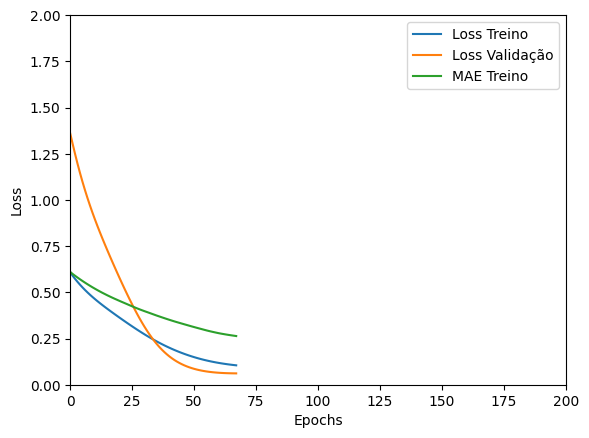

Tempo de treino: 0.26181848843892414 minutos


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com GRU_v1 , timesteps=24, units=4, batch=32


'TRAINING set. Loss = 0.1109810397028923 , MAE = 0.265290766954422'

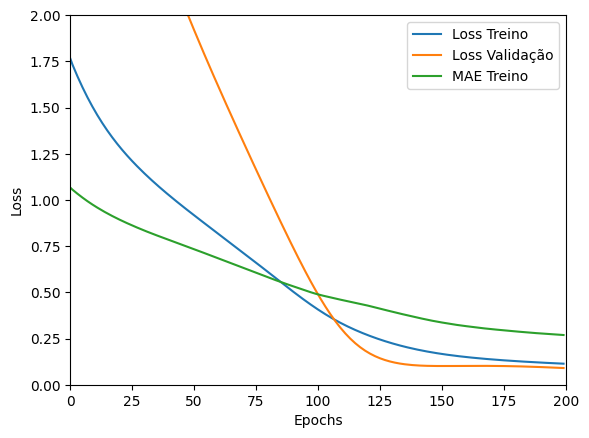

Tempo de treino: 0.4368491967519124 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0453990176320076 , MAE = 0.16497227549552917'

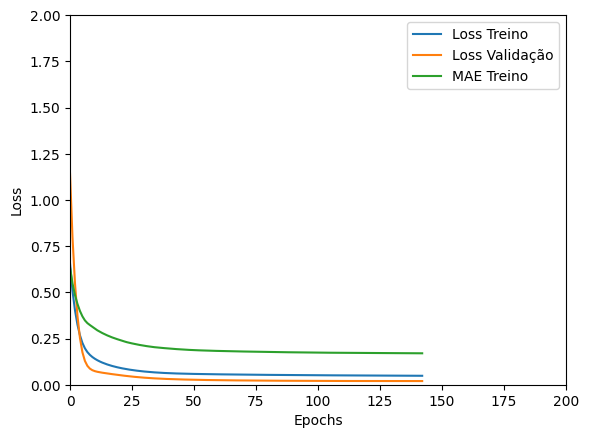

Tempo de treino: 1.4316496173540751 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05325588583946228 , MAE = 0.18040268123149872'

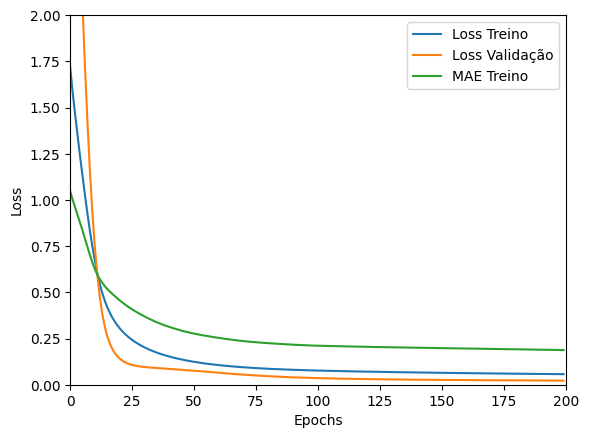

Tempo de treino: 0.7690412521362304 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10390584915876389 , MAE = 0.25924235582351685'

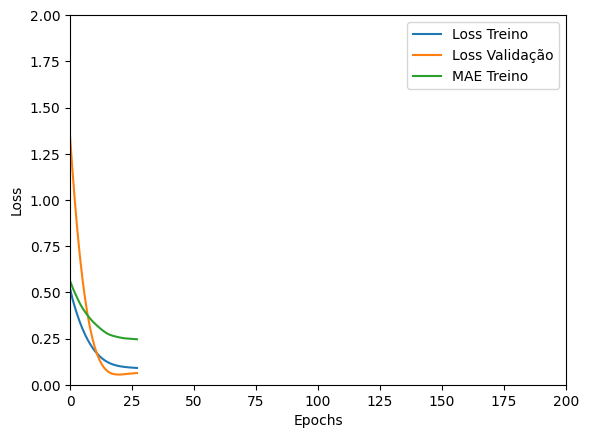

Tempo de treino: 0.1501959760983785 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14489144086837769 , MAE = 0.31321701407432556'

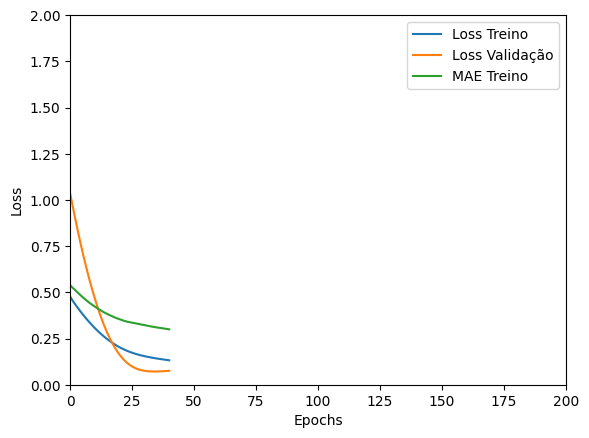

Tempo de treino: 0.1849870761235555 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.046169452369213104 , MAE = 0.16563087701797485'

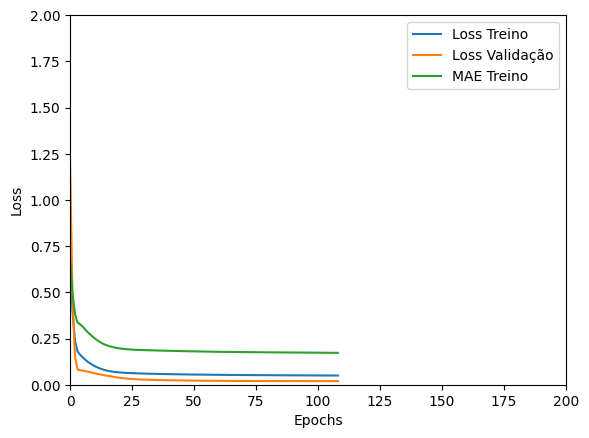

Tempo de treino: 0.8095877687136332 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04603412002325058 , MAE = 0.1651957482099533'

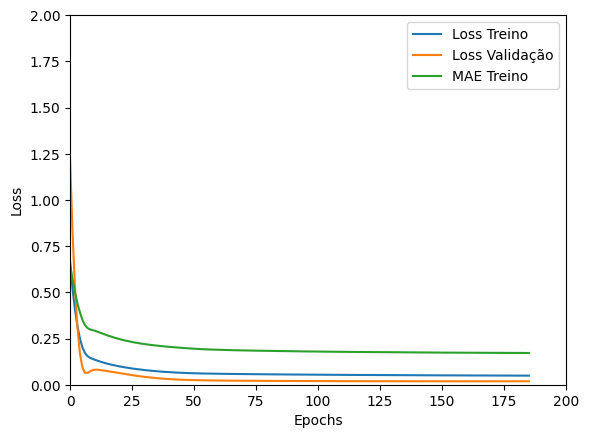

Tempo de treino: 1.418591852982839 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17174264788627625 , MAE = 0.32308050990104675'

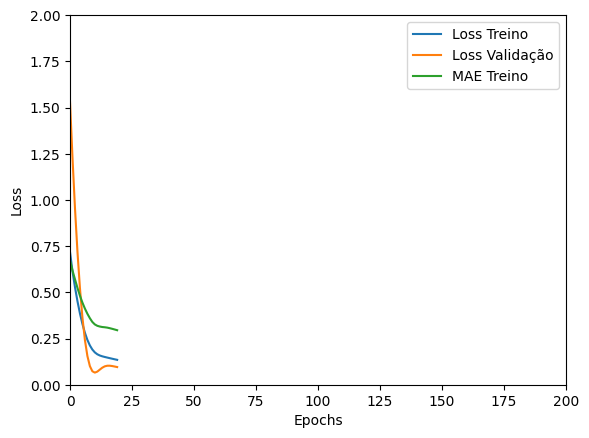

Tempo de treino: 0.1039829929669698 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19513584673404694 , MAE = 0.3494437634944916'

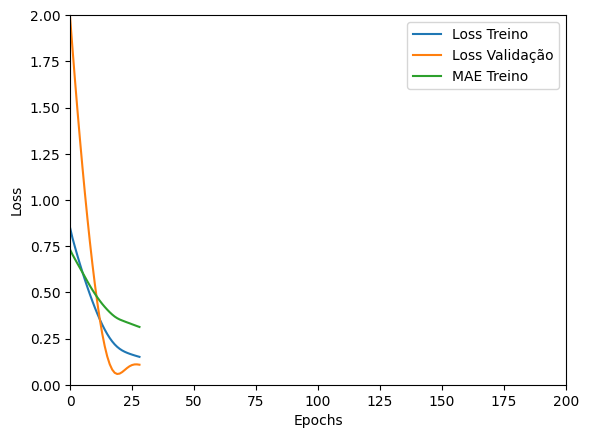

Tempo de treino: 0.14885591665903727 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.046062152832746506 , MAE = 0.16510967910289764'

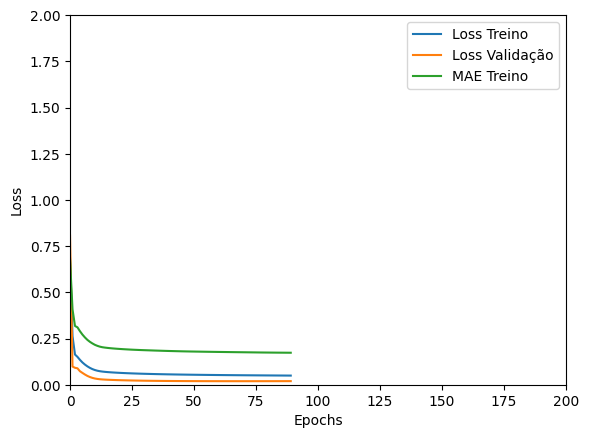

Tempo de treino: 0.7044639269510905 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.046959180384874344 , MAE = 0.16611027717590332'

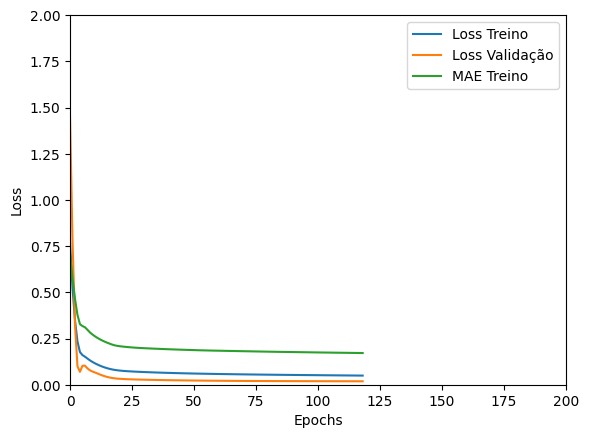

Tempo de treino: 0.5415709733963012 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04675102233886719 , MAE = 0.1657181978225708'

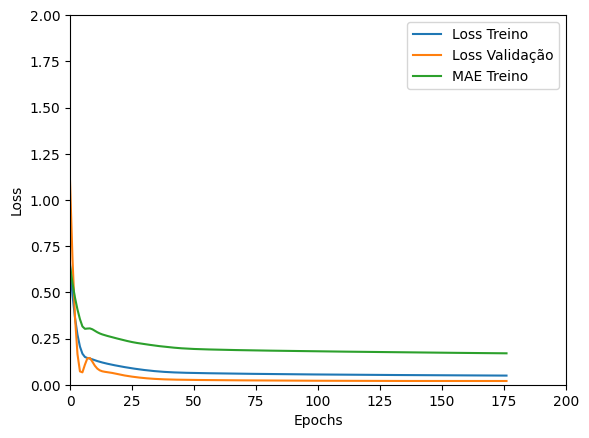

Tempo de treino: 0.7377004504203797 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22646772861480713 , MAE = 0.37352871894836426'

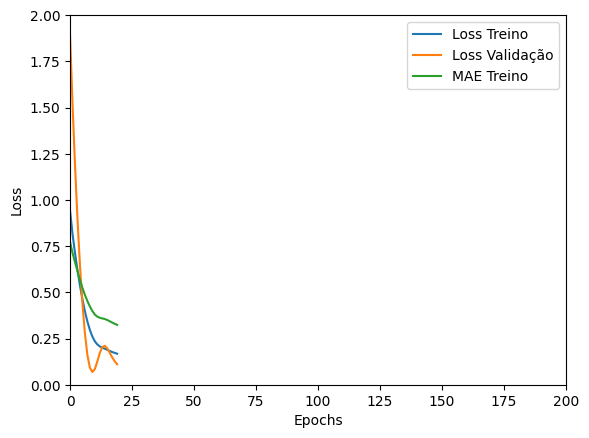

Tempo de treino: 0.0996940811475118 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.047063980251550674 , MAE = 0.16771098971366882'

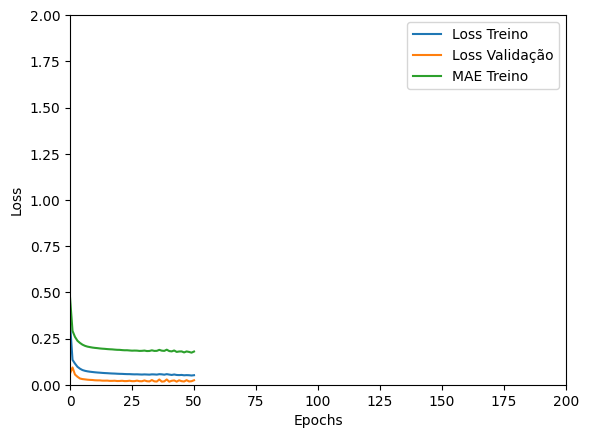

Tempo de treino: 0.5006953517595927 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04962990805506706 , MAE = 0.17070211470127106'

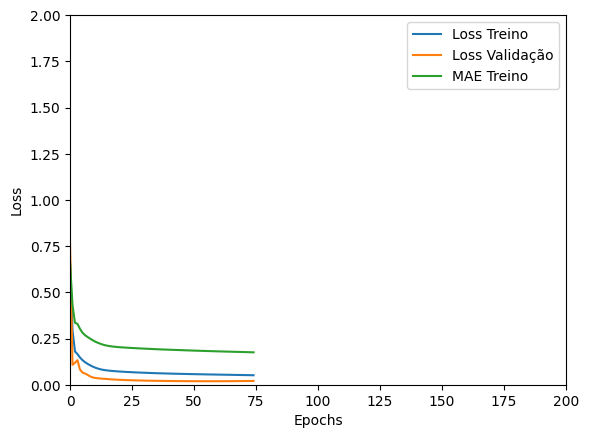

Tempo de treino: 0.4092032512029012 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048098377883434296 , MAE = 0.16783303022384644'

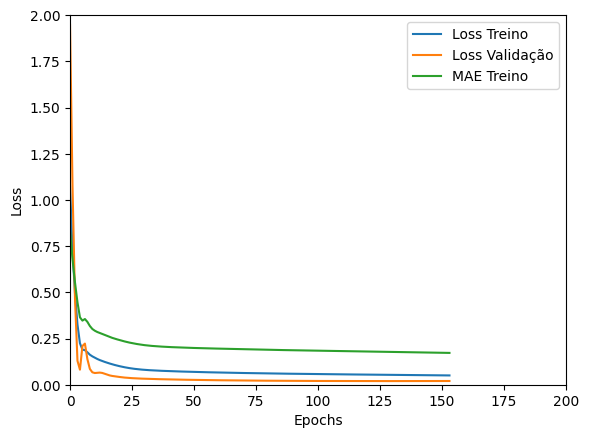

Tempo de treino: 0.46548370520273846 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05355390906333923 , MAE = 0.17658989131450653'

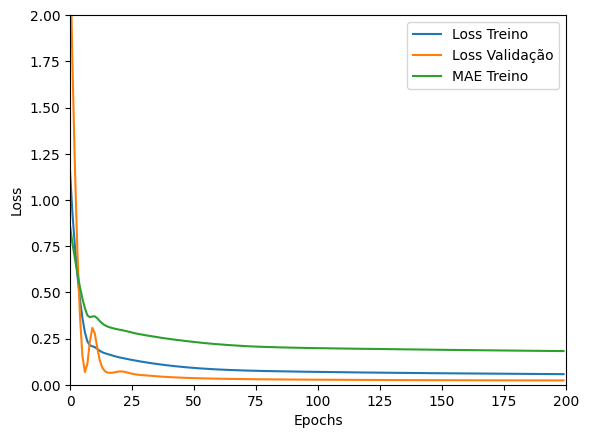

Tempo de treino: 0.7442773580551147 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07429997622966766 , MAE = 0.20635291934013367'

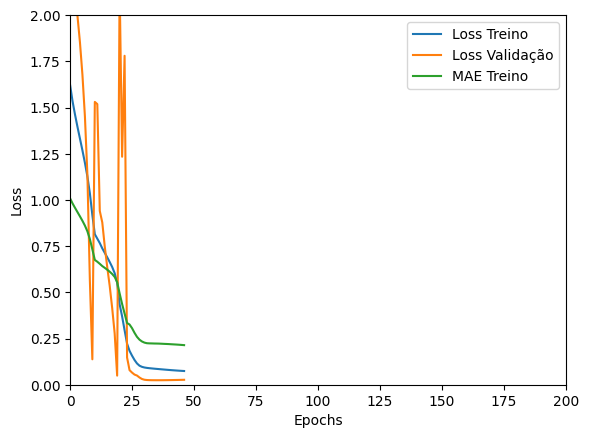

Tempo de treino: 0.3827258229255676 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24118947982788086 , MAE = 0.36731985211372375'

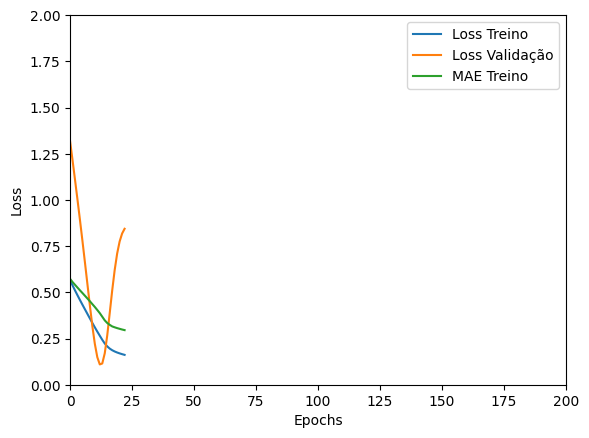

Tempo de treino: 0.18496032953262329 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30325937271118164 , MAE = 0.40270304679870605'

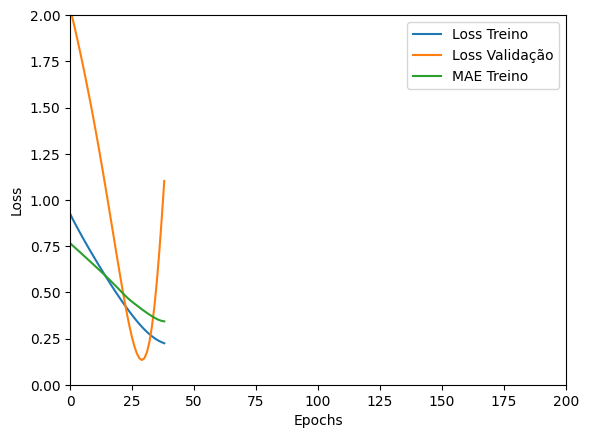

Tempo de treino: 0.21826132535934448 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.543556272983551 , MAE = 0.5542333126068115'

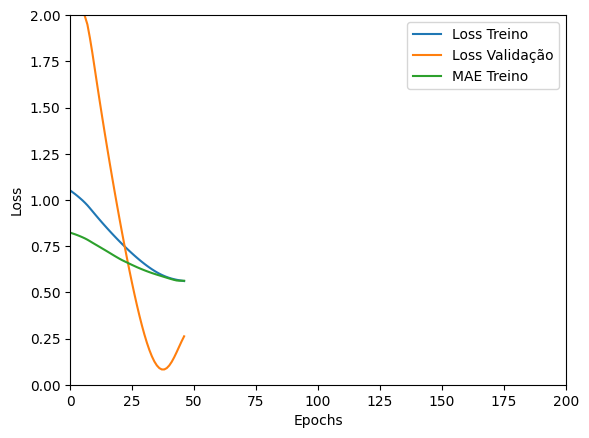

Tempo de treino: 0.13080666462580362 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3253907561302185 , MAE = 0.4361625909805298'

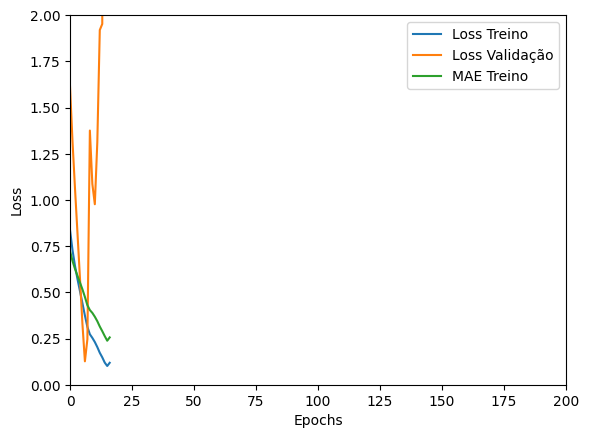

Tempo de treino: 0.15629638036092122 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6127544045448303 , MAE = 0.5917880535125732'

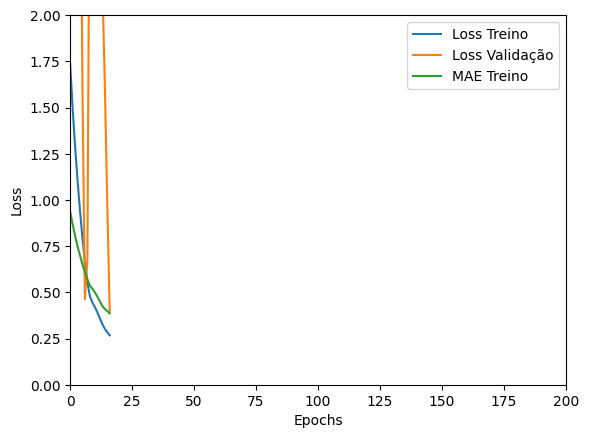

Tempo de treino: 0.12128716707229614 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.46498486399650574 , MAE = 0.5140950679779053'

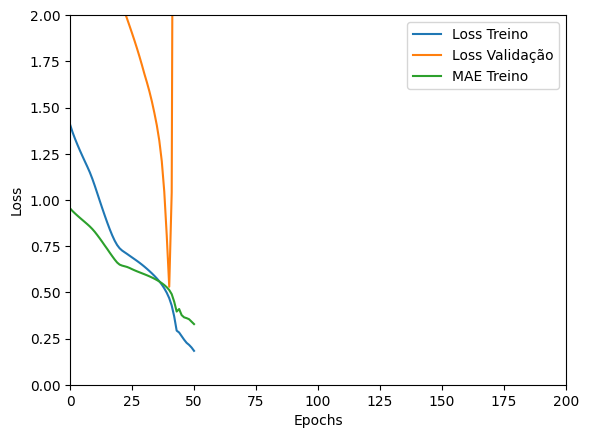

Tempo de treino: 0.21126529375712078 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16935665905475616 , MAE = 0.29997894167900085'

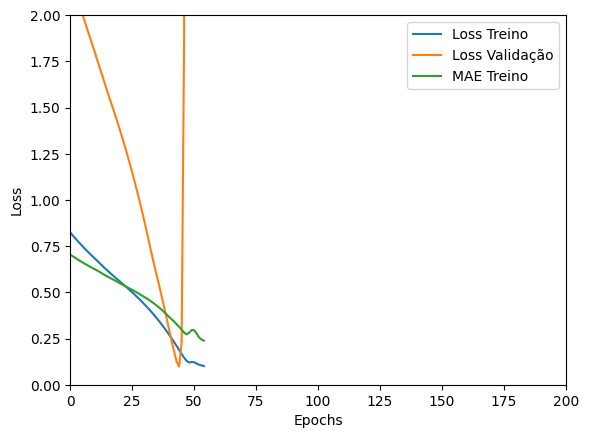

Tempo de treino: 0.12006022532780965 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30557236075401306 , MAE = 0.4242638945579529'

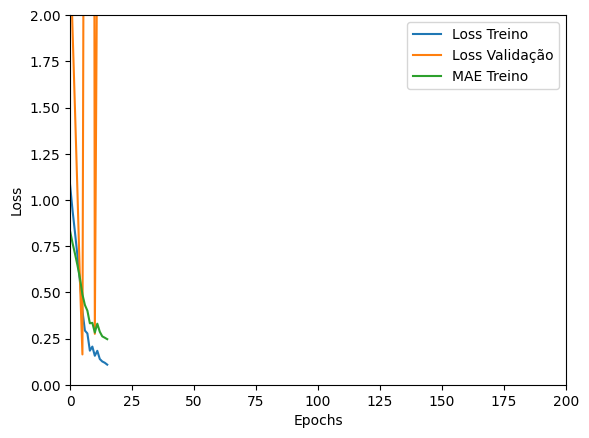

Tempo de treino: 0.2072596589724223 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4592512249946594 , MAE = 0.530058741569519'

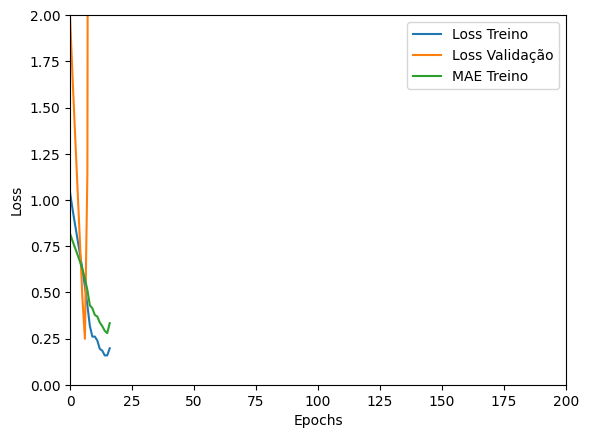

Tempo de treino: 0.1492241342862447 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6540214419364929 , MAE = 0.6065947413444519'

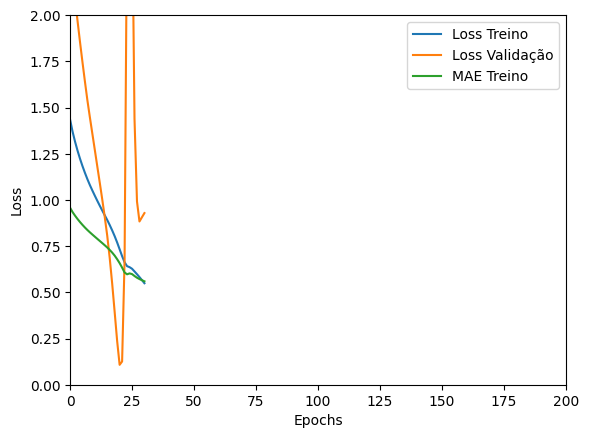

Tempo de treino: 0.13381648063659668 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2791384756565094 , MAE = 0.3866339921951294'

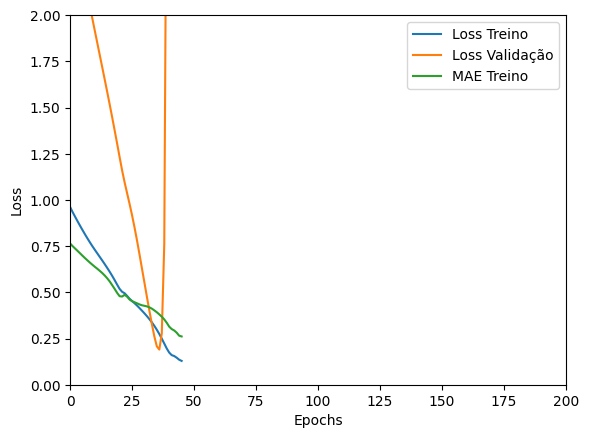

Tempo de treino: 0.11642903089523315 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20636500418186188 , MAE = 0.3266223073005676'

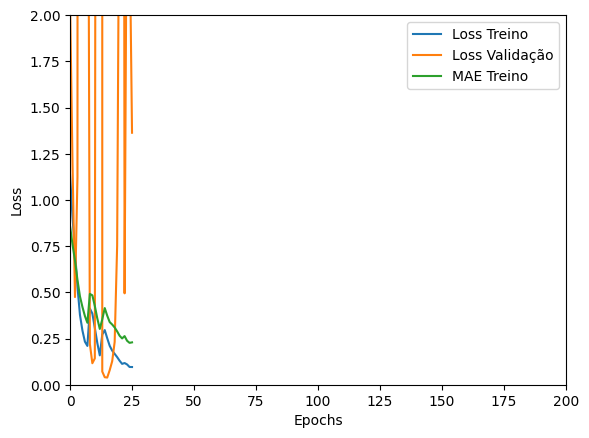

Tempo de treino: 0.3891943176587423 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3816617727279663 , MAE = 0.4798668622970581'

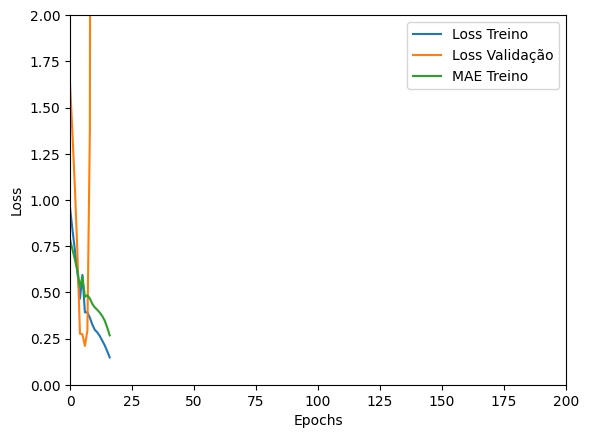

Tempo de treino: 0.12664719422658285 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3696623742580414 , MAE = 0.45783597230911255'

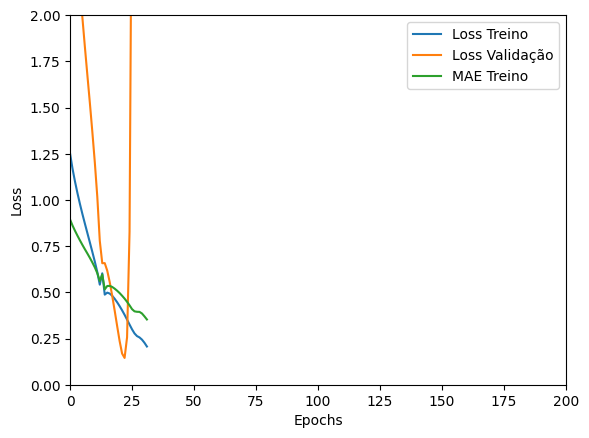

Tempo de treino: 0.11742519537607829 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34923055768013 , MAE = 0.43354082107543945'

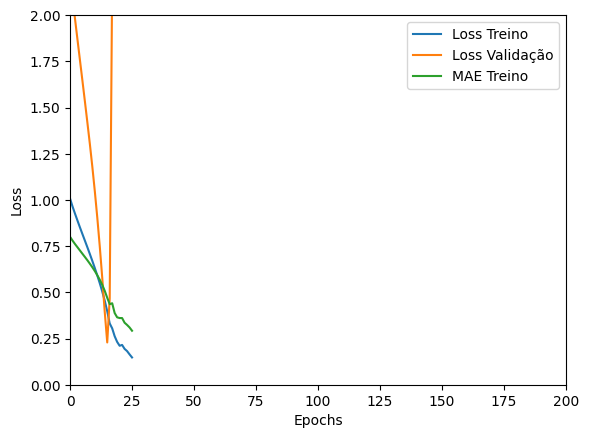

Tempo de treino: 0.11864555279413859 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2066596895456314 , MAE = 0.35831183195114136'

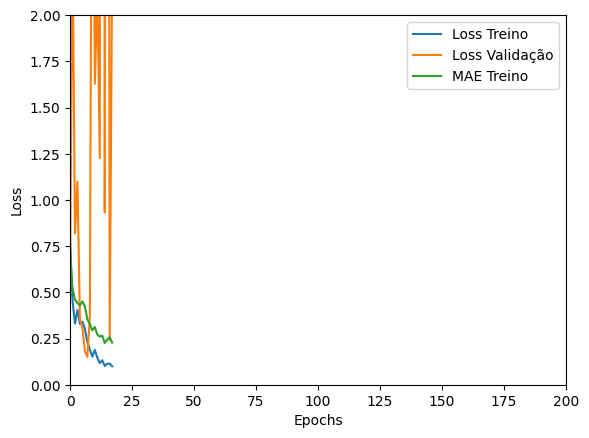

Tempo de treino: 0.22019669612248738 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3865024149417877 , MAE = 0.4781576991081238'

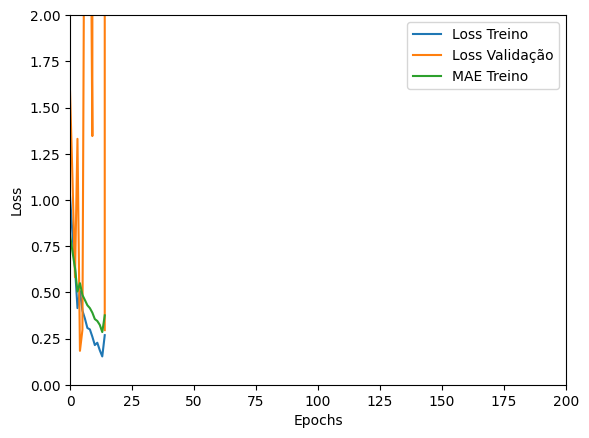

Tempo de treino: 0.13283031384150187 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31515011191368103 , MAE = 0.4293052852153778'

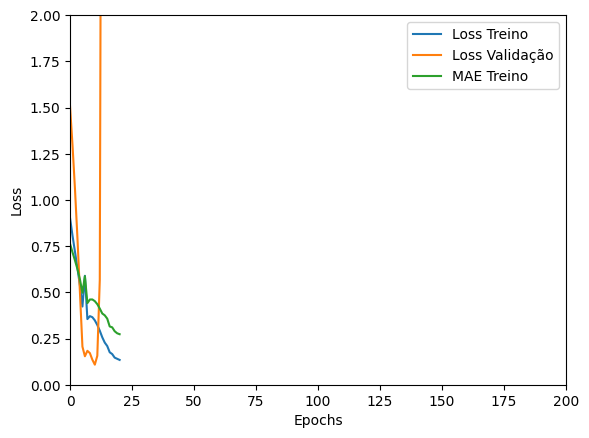

Tempo de treino: 0.13408148686091106 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.404573917388916 , MAE = 0.4859110414981842'

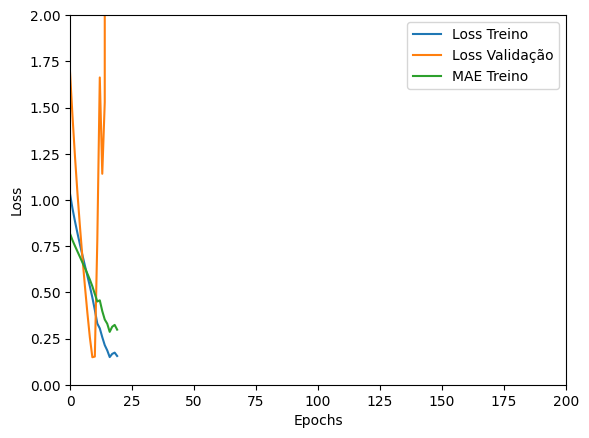

Tempo de treino: 0.09688692490259807 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=36, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05802328884601593 , MAE = 0.1810562163591385'

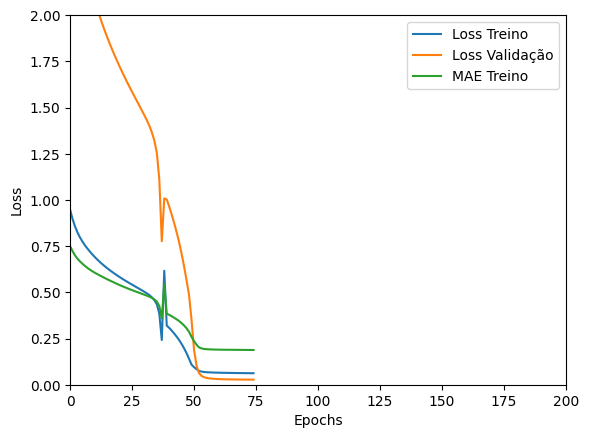

Tempo de treino: 0.7271256804466247 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39293718338012695 , MAE = 0.4222992956638336'

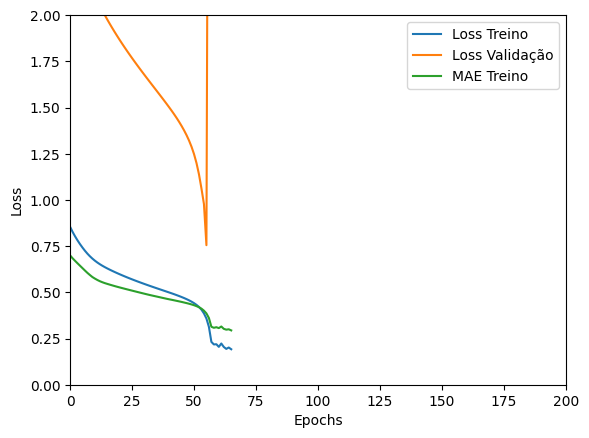

Tempo de treino: 0.3824445605278015 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.8764228224754333 , MAE = 0.7402178049087524'

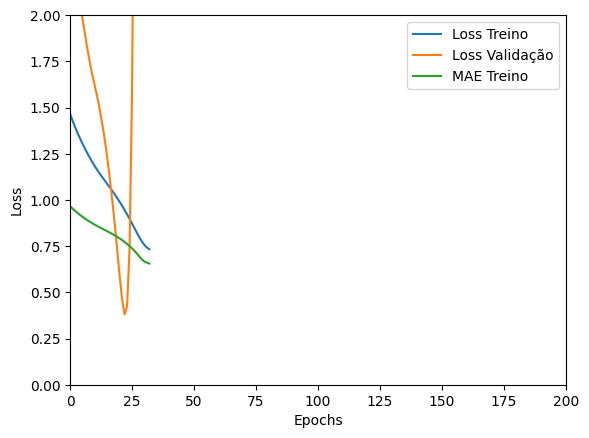

Tempo de treino: 0.12479839324951172 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2412528246641159 , MAE = 0.376187264919281'

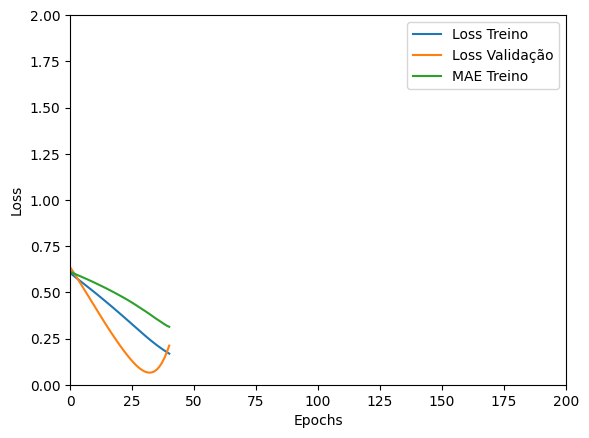

Tempo de treino: 0.16419326464335124 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5952362418174744 , MAE = 0.6050219535827637'

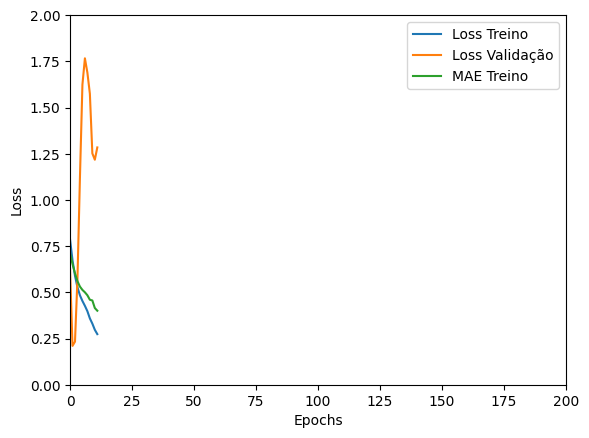

Tempo de treino: 0.142665429910024 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5099921822547913 , MAE = 0.5510267615318298'

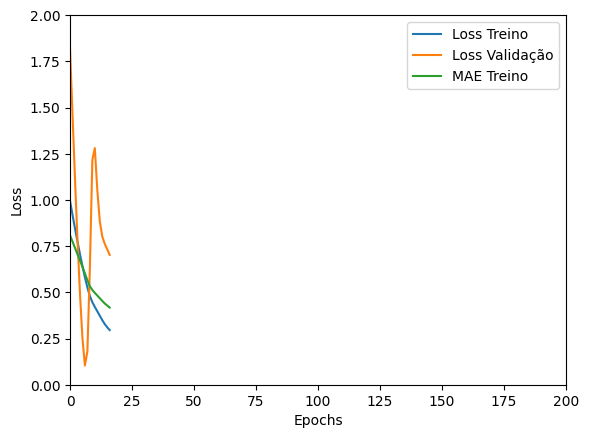

Tempo de treino: 0.12872655789057413 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7883127927780151 , MAE = 0.6379399299621582'

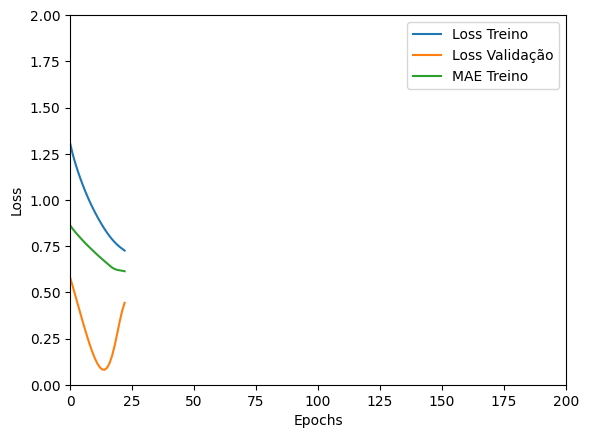

Tempo de treino: 0.12962843974431357 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4109782576560974 , MAE = 0.4679045081138611'

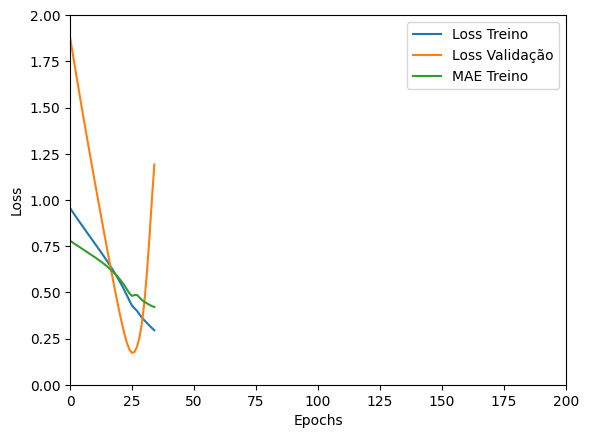

Tempo de treino: 0.1346319079399109 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14545349776744843 , MAE = 0.27320870757102966'

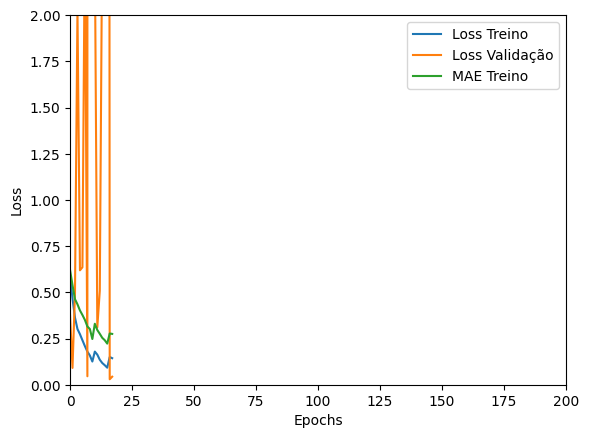

Tempo de treino: 0.17161373297373453 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35970646142959595 , MAE = 0.44540145993232727'

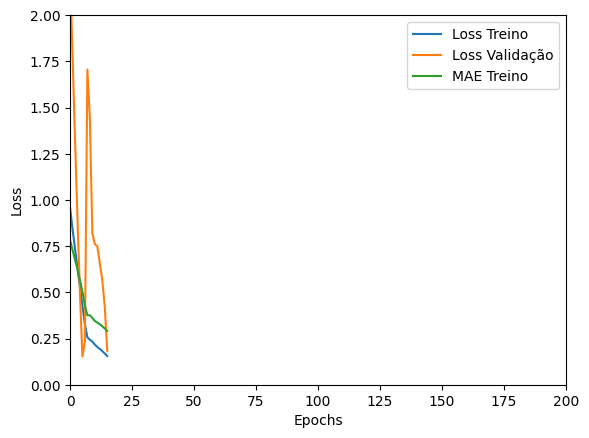

Tempo de treino: 0.12708214521408082 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49532350897789 , MAE = 0.5421120524406433'

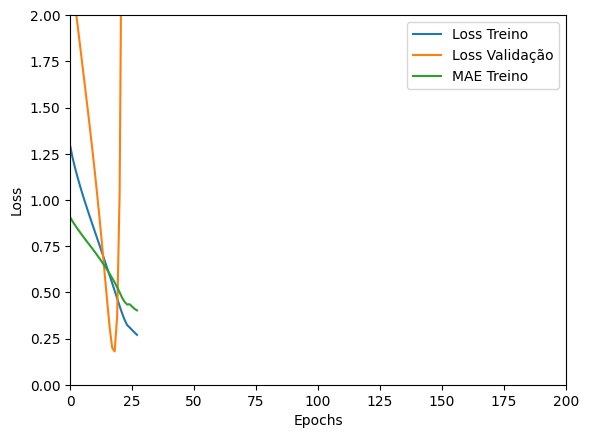

Tempo de treino: 0.1472549835840861 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5461392402648926 , MAE = 0.5864130258560181'

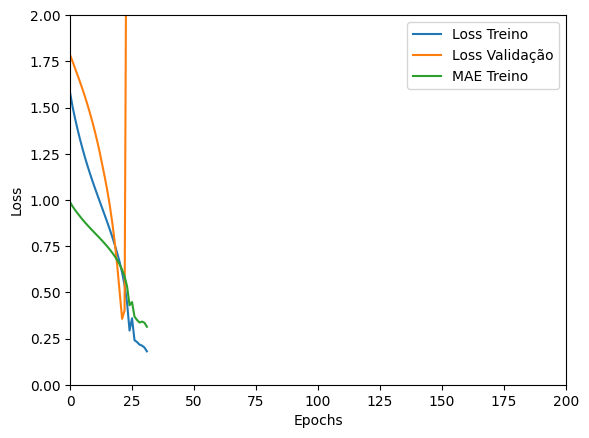

Tempo de treino: 0.14193437894185384 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10065216571092606 , MAE = 0.23066480457782745'

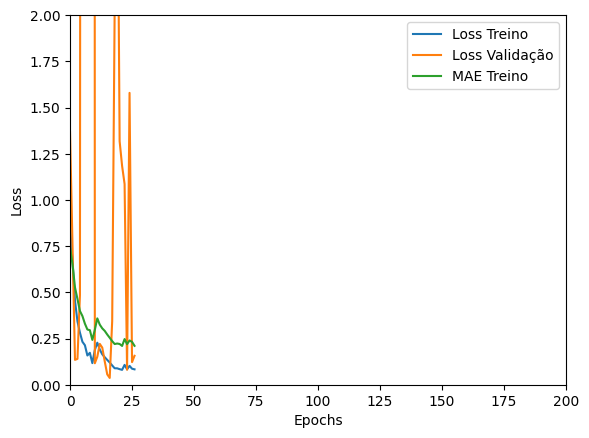

Tempo de treino: 0.39201062520345054 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1036970317363739 , MAE = 0.22587671875953674'

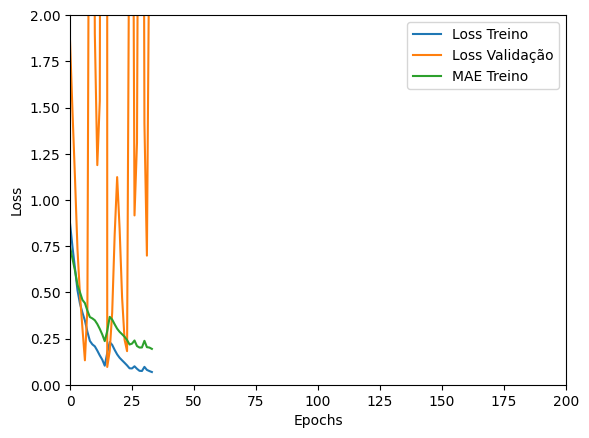

Tempo de treino: 0.19831173419952391 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.48500970005989075 , MAE = 0.5369435548782349'

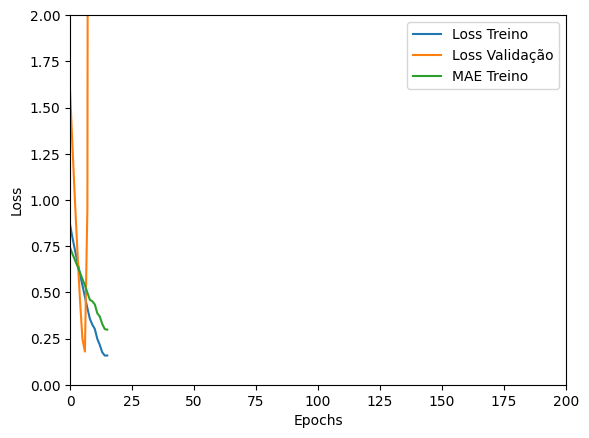

Tempo de treino: 0.08697377840677897 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28777197003364563 , MAE = 0.39805564284324646'

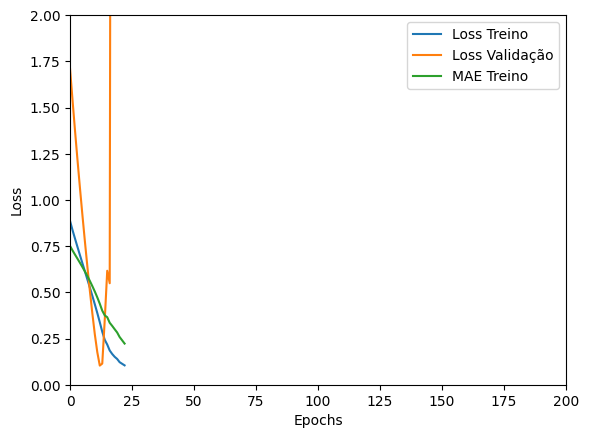

Tempo de treino: 0.08609259525934855 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24013710021972656 , MAE = 0.36106616258621216'

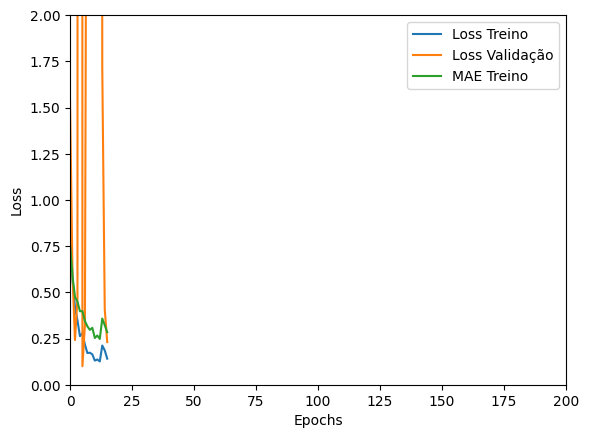

Tempo de treino: 0.23006122509638469 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2326650321483612 , MAE = 0.3628794848918915'

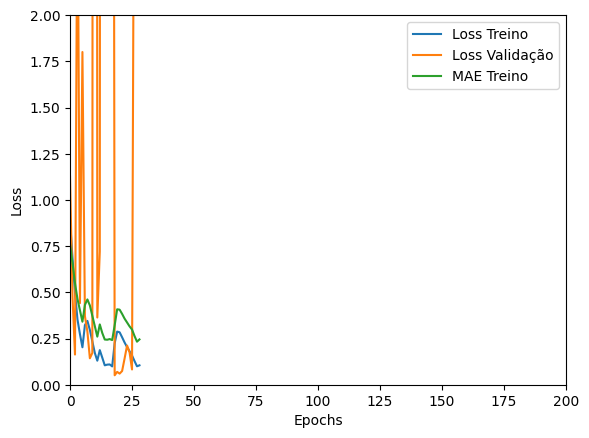

Tempo de treino: 0.22434732516606648 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3476743698120117 , MAE = 0.4404386281967163'

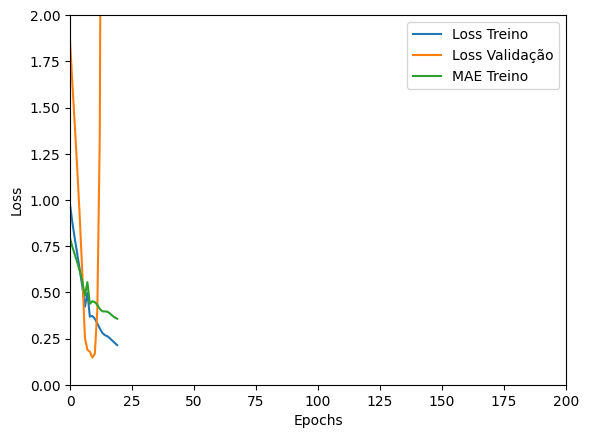

Tempo de treino: 0.14662761688232423 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3421562910079956 , MAE = 0.4408983290195465'

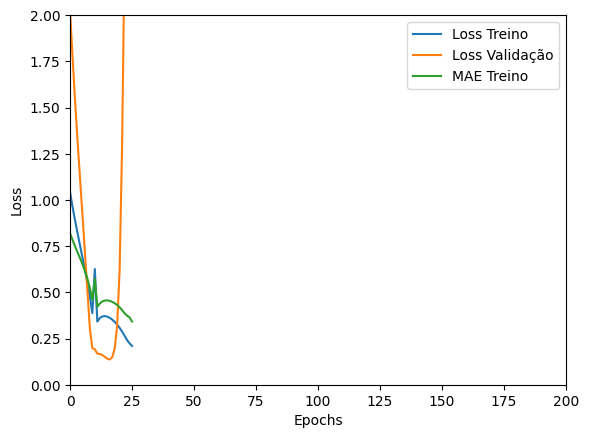

Tempo de treino: 0.11461550792058309 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=36, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 2.936231851577759 , MAE = 1.332728624343872'

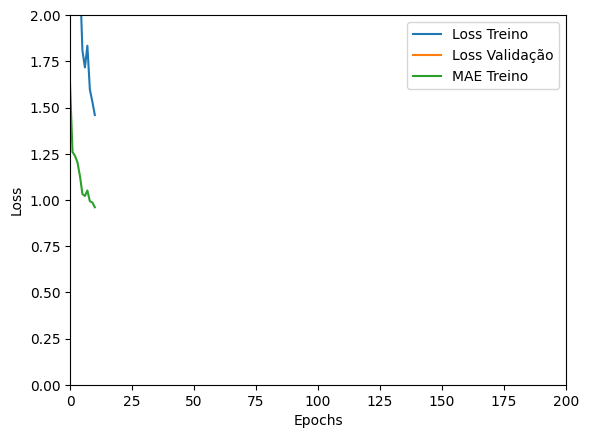

Tempo de treino: 0.11484510501225789 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23198841512203217 , MAE = 0.36747708916664124'

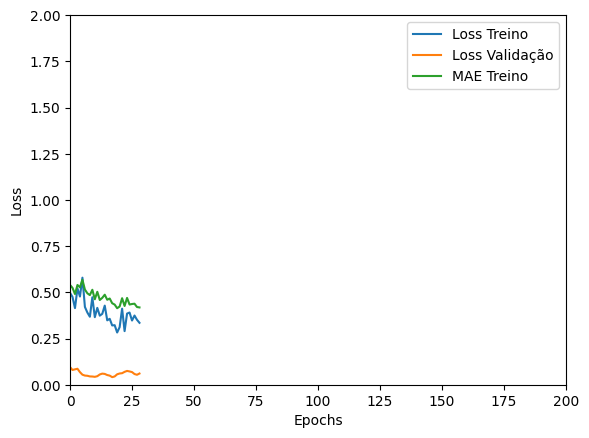

Tempo de treino: 0.21453156073888144 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22754918038845062 , MAE = 0.3653164207935333'

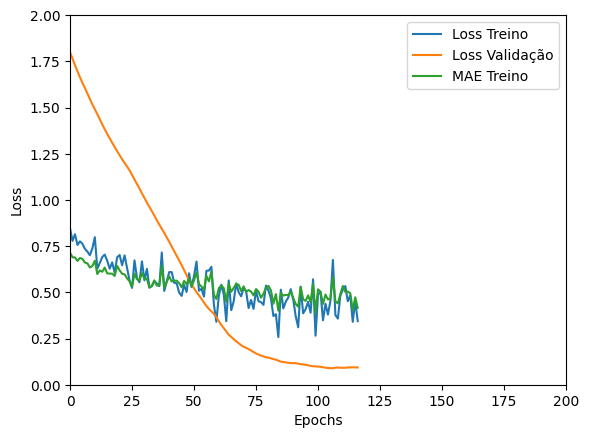

Tempo de treino: 0.31304312149683633 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2163887768983841 , MAE = 0.35082942247390747'

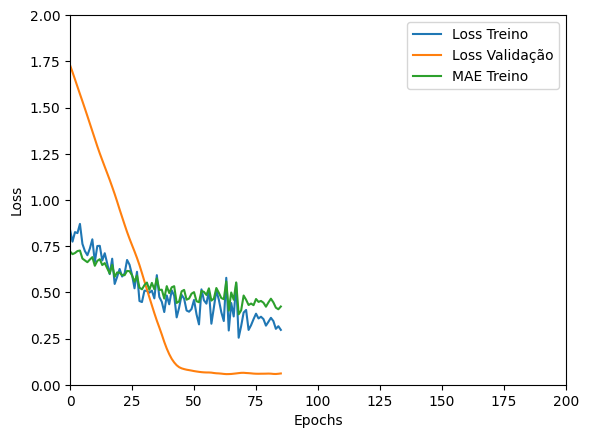

Tempo de treino: 0.16384287277857462 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4188199043273926 , MAE = 0.49285364151000977'

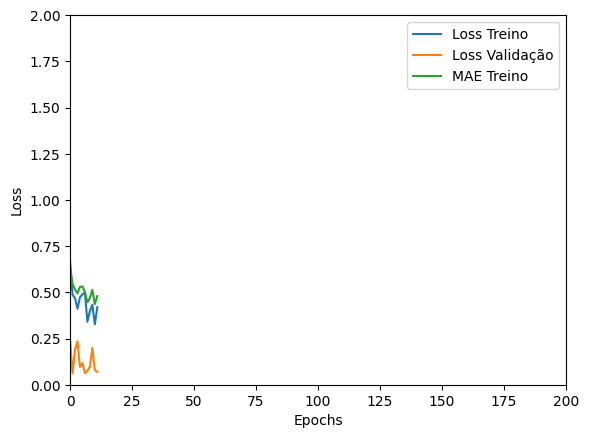

Tempo de treino: 0.15345678329467774 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35521185398101807 , MAE = 0.4500742256641388'

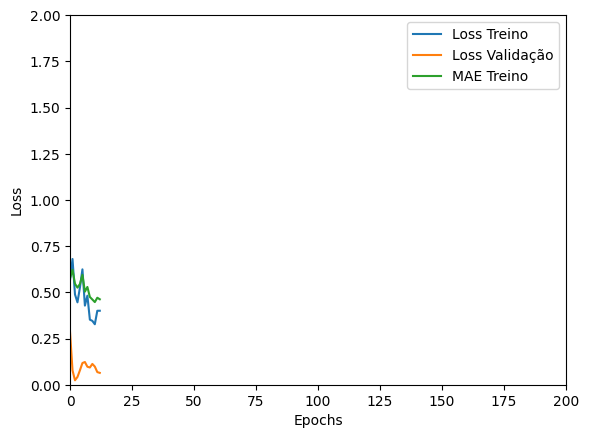

Tempo de treino: 0.14516357183456421 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20031744241714478 , MAE = 0.33781662583351135'

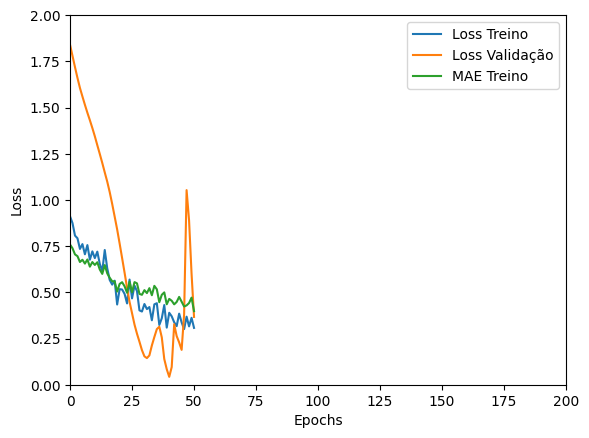

Tempo de treino: 0.17914358377456666 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25562259554862976 , MAE = 0.3702446222305298'

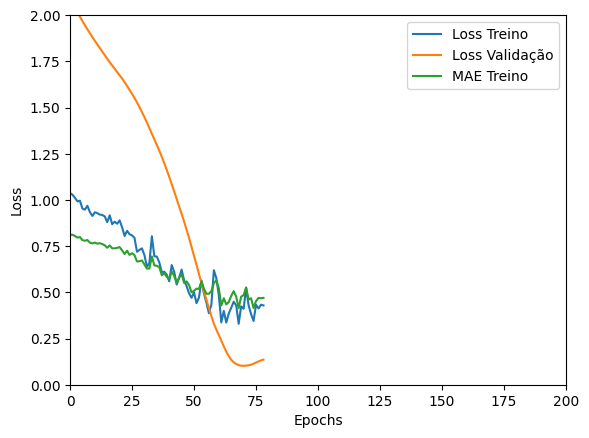

Tempo de treino: 0.17967926263809203 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15796799957752228 , MAE = 0.2893469035625458'

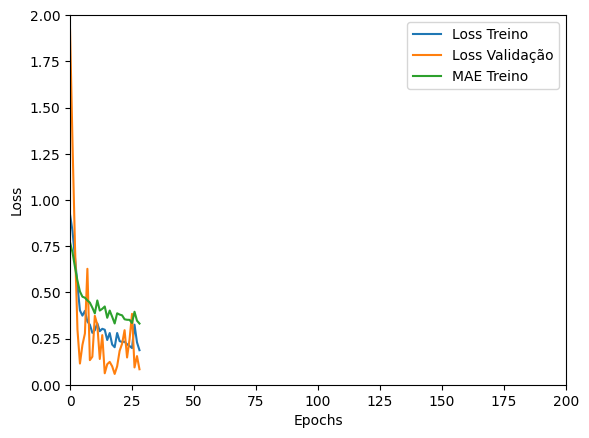

Tempo de treino: 0.244756019115448 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3831254839897156 , MAE = 0.43841391801834106'

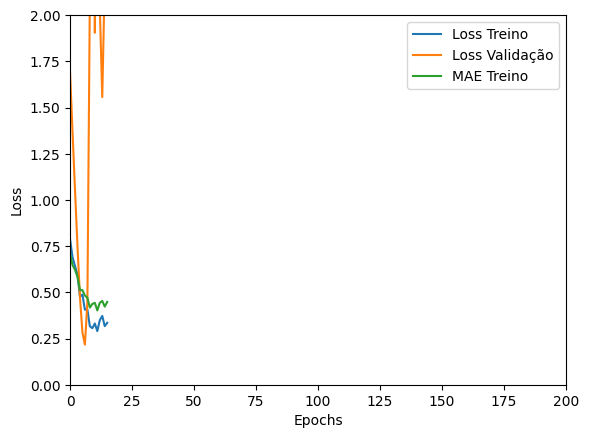

Tempo de treino: 0.10377365350723267 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27333858609199524 , MAE = 0.37686261534690857'

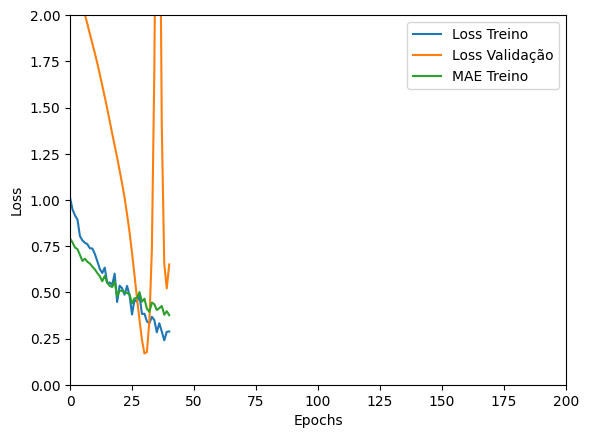

Tempo de treino: 0.21718327601750692 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4526788592338562 , MAE = 0.5102247595787048'

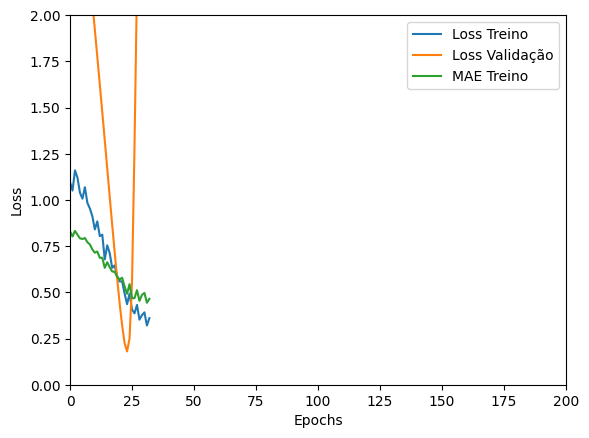

Tempo de treino: 0.14504607518513998 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18590575456619263 , MAE = 0.3164450526237488'

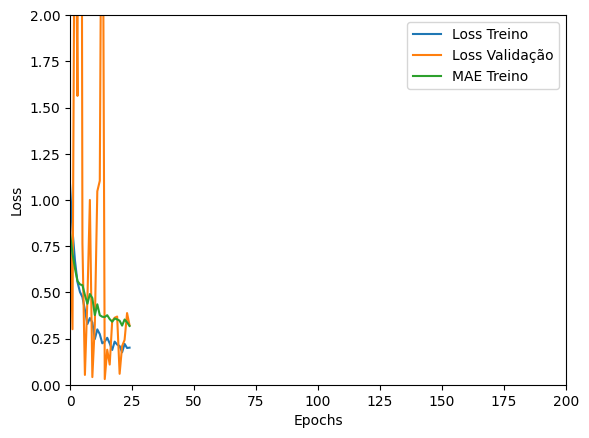

Tempo de treino: 0.3969344178835551 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08829964697360992 , MAE = 0.2149062156677246'

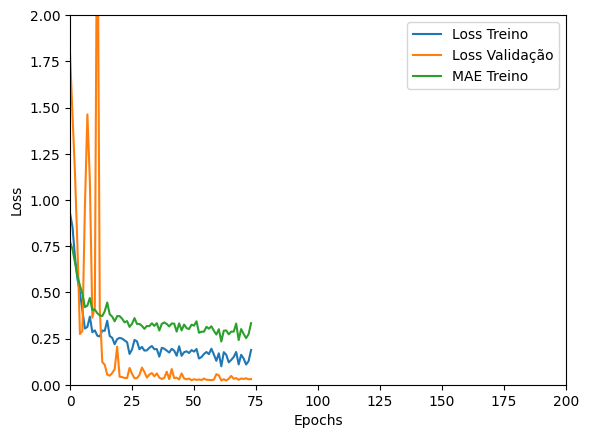

Tempo de treino: 0.38970189491907753 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.43678197264671326 , MAE = 0.5041545033454895'

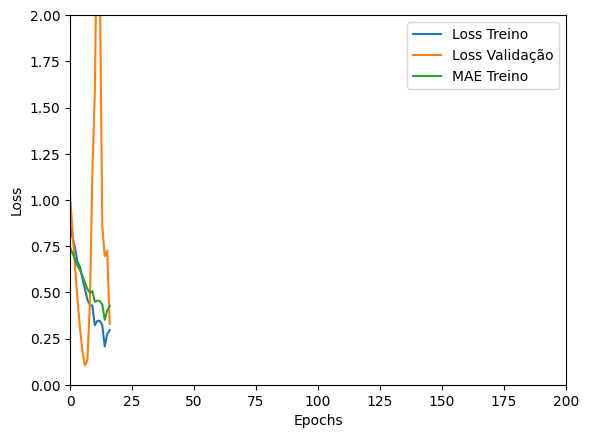

Tempo de treino: 0.08963732322057089 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3839414119720459 , MAE = 0.47018224000930786'

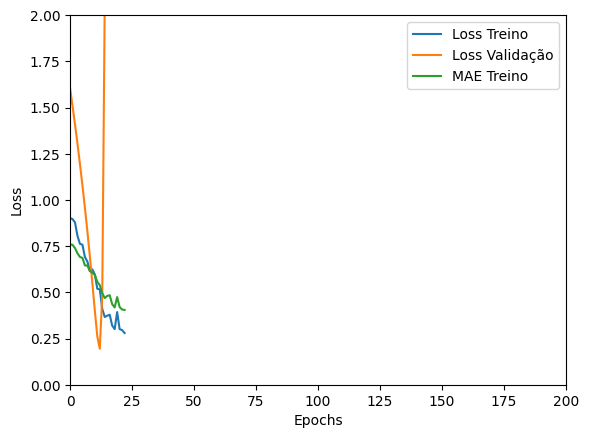

Tempo de treino: 0.1337275226910909 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12539228796958923 , MAE = 0.2516423463821411'

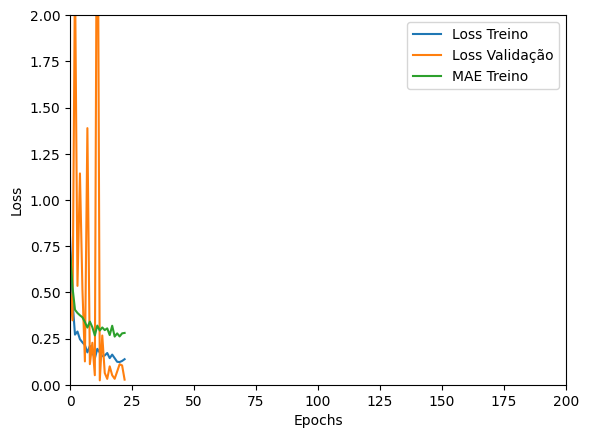

Tempo de treino: 0.3856281320254008 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08601552248001099 , MAE = 0.2129216343164444'

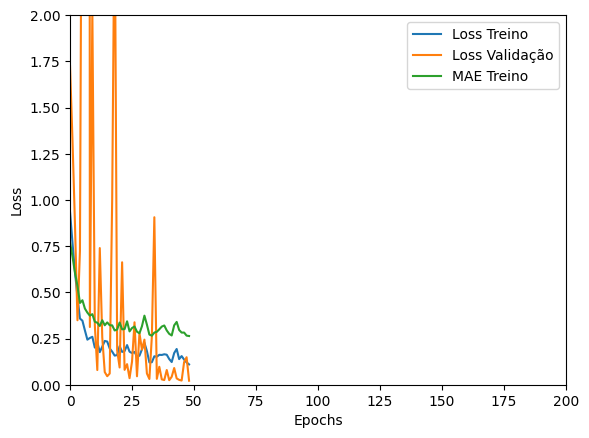

Tempo de treino: 0.25314292510350545 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2383604198694229 , MAE = 0.36558419466018677'

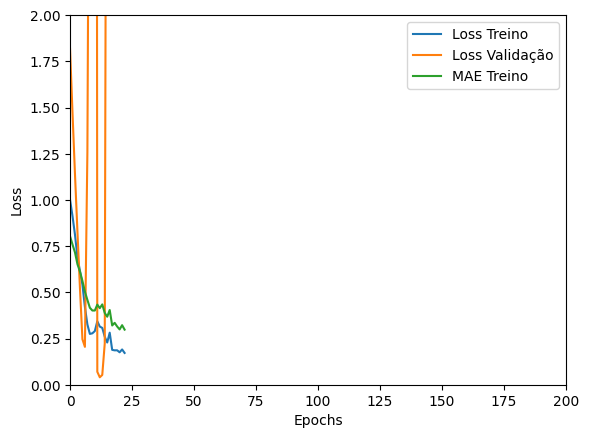

Tempo de treino: 0.16560678084691366 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40576252341270447 , MAE = 0.4677613079547882'

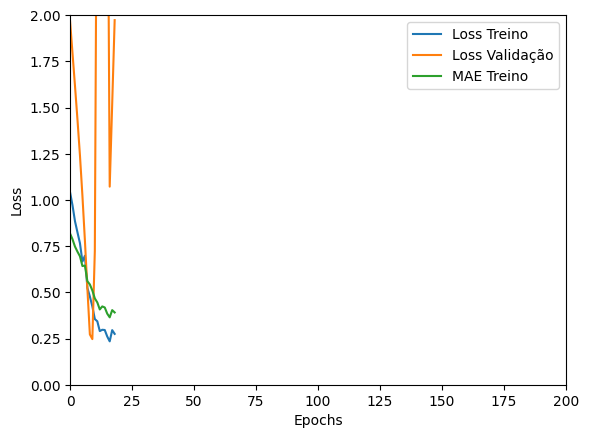

Tempo de treino: 0.093897811571757 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com GRU_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04936201870441437 , MAE = 0.17061106860637665'

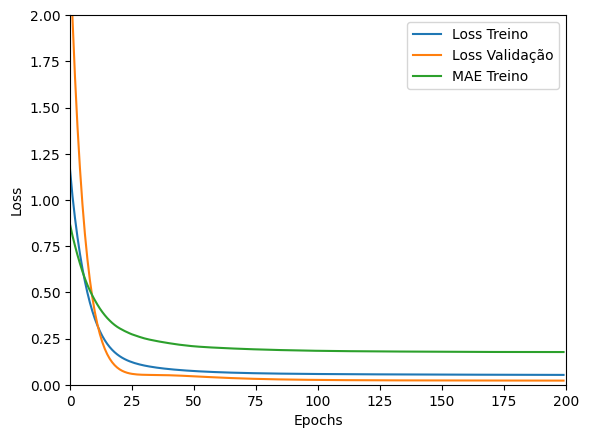

Tempo de treino: 1.5374004324277242 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.059483665972948074 , MAE = 0.18752722442150116'

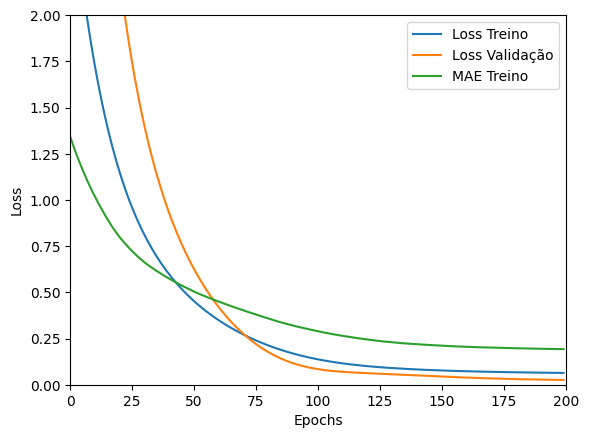

Tempo de treino: 0.947014578183492 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08644282817840576 , MAE = 0.23163051903247833'

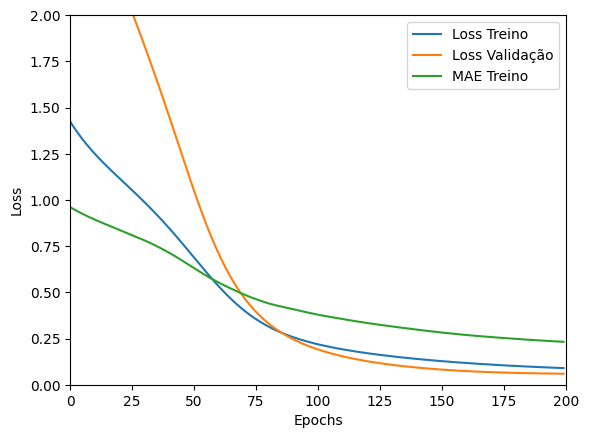

Tempo de treino: 0.5512316147486369 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09488102793693542 , MAE = 0.2427336871623993'

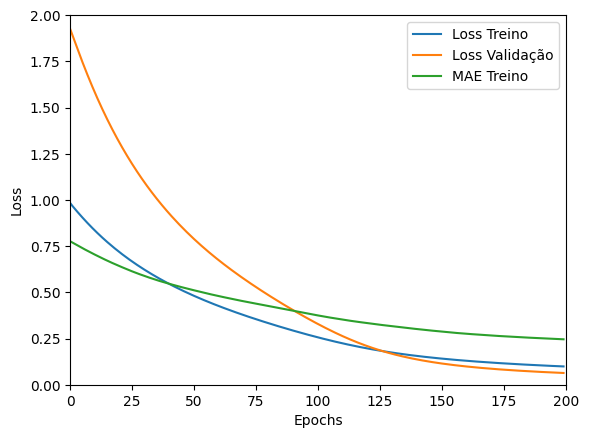

Tempo de treino: 0.7709384838740031 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12931783497333527 , MAE = 0.27763622999191284'

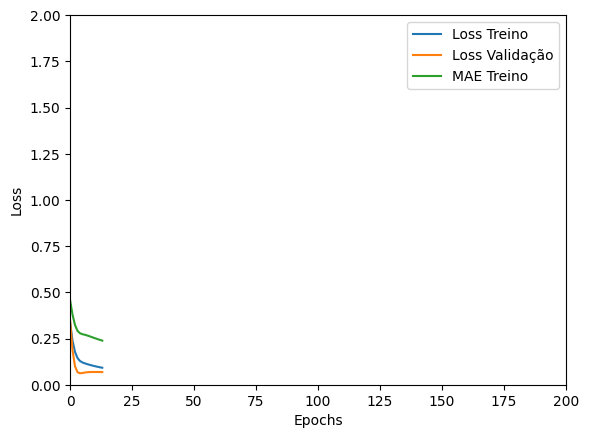

Tempo de treino: 0.24701590140660604 minutos


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com GRU_v1 , timesteps=36, units=8, batch=8


'TRAINING set. Loss = 0.11923941224813461 , MAE = 0.26706019043922424'

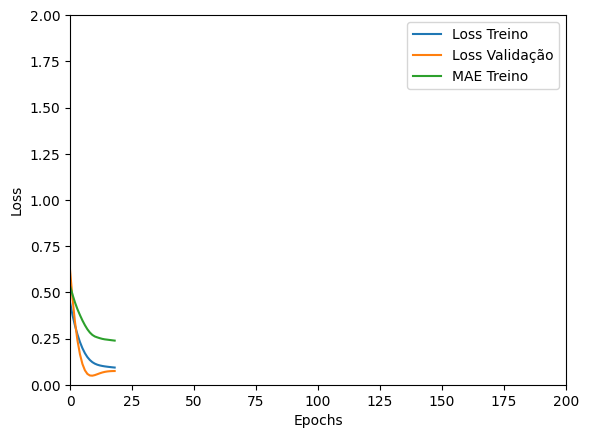

Tempo de treino: 0.1507552981376648 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1336943358182907 , MAE = 0.2789222300052643'

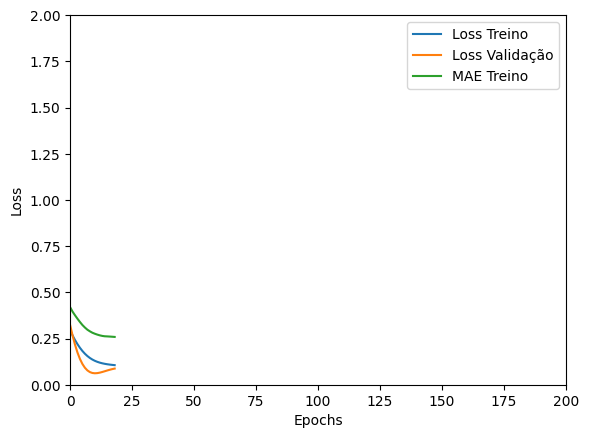

Tempo de treino: 0.12224700450897216 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13784755766391754 , MAE = 0.29707449674606323'

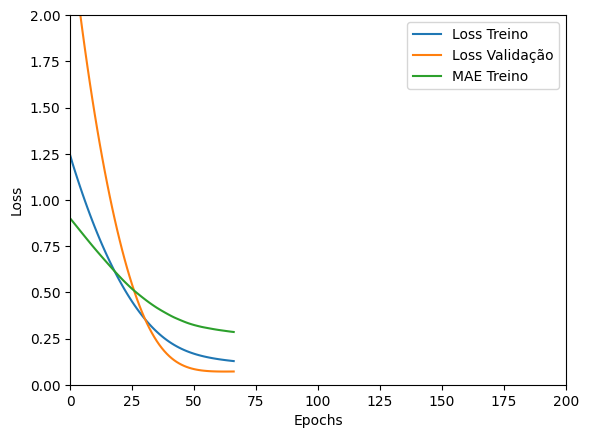

Tempo de treino: 0.2204272508621216 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.043979842215776443 , MAE = 0.16217459738254547'

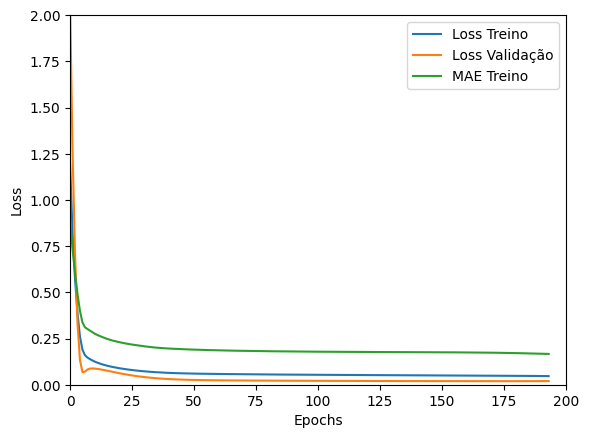

Tempo de treino: 1.6427960952123006 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04876285046339035 , MAE = 0.17010675370693207'

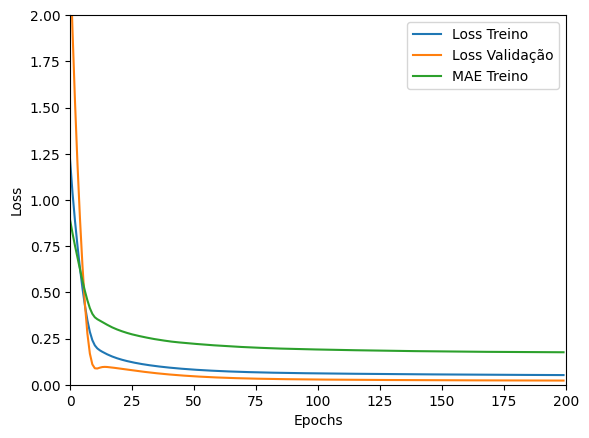

Tempo de treino: 1.4246618747711182 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1714719980955124 , MAE = 0.3222920596599579'

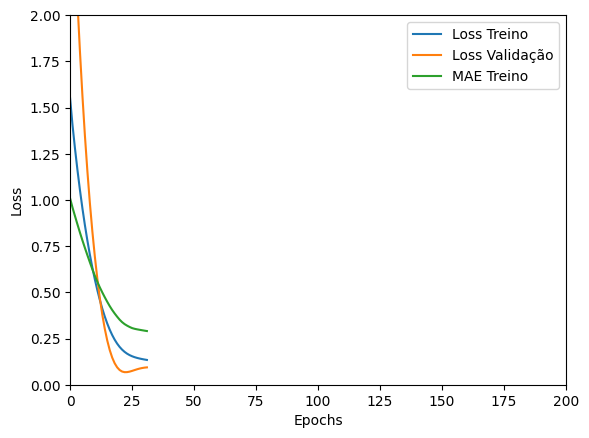

Tempo de treino: 0.22237165768941244 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20677456259727478 , MAE = 0.3519635796546936'

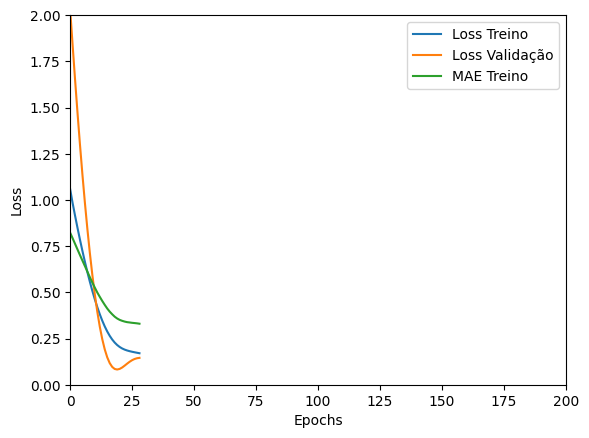

Tempo de treino: 0.1362603465716044 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.049583543092012405 , MAE = 0.17350561916828156'

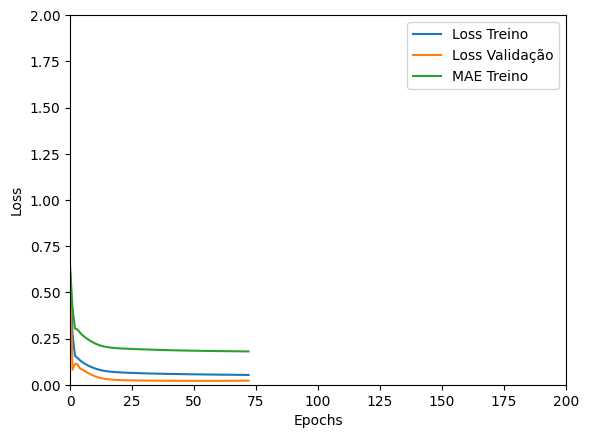

Tempo de treino: 0.7391345342000325 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0480162687599659 , MAE = 0.17054185271263123'

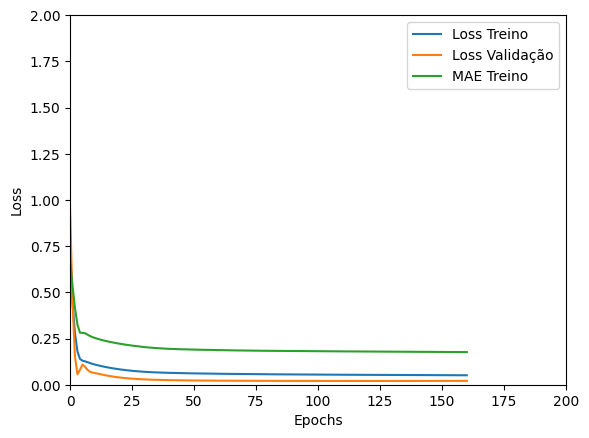

Tempo de treino: 1.4237844705581666 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19116893410682678 , MAE = 0.340430349111557'

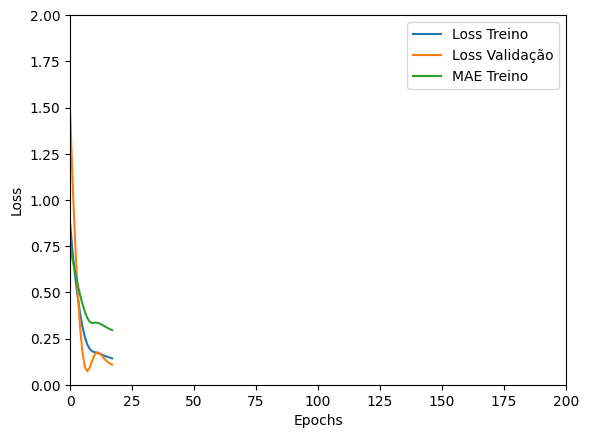

Tempo de treino: 0.14046767552693684 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14180511236190796 , MAE = 0.2849876582622528'

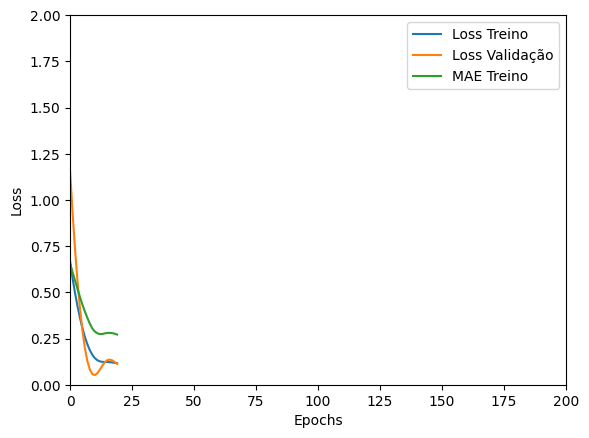

Tempo de treino: 0.10596507787704468 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04870285466313362 , MAE = 0.1708921492099762'

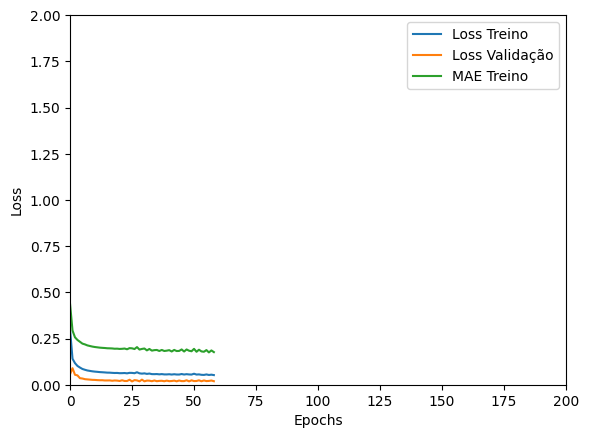

Tempo de treino: 0.6140162507692973 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04762689769268036 , MAE = 0.16874107718467712'

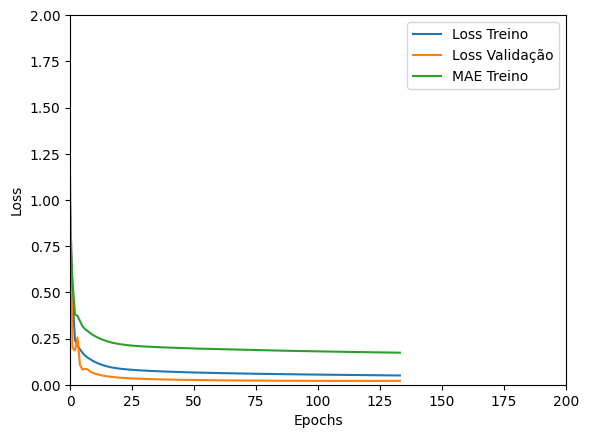

Tempo de treino: 0.7540012915929158 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.051666565239429474 , MAE = 0.17373500764369965'

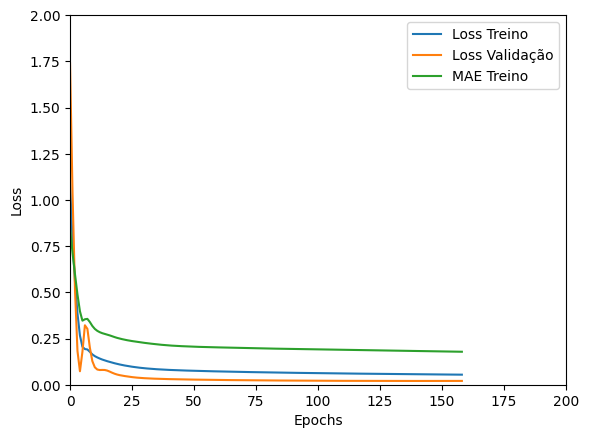

Tempo de treino: 0.7522470990816752 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23588478565216064 , MAE = 0.3686838150024414'

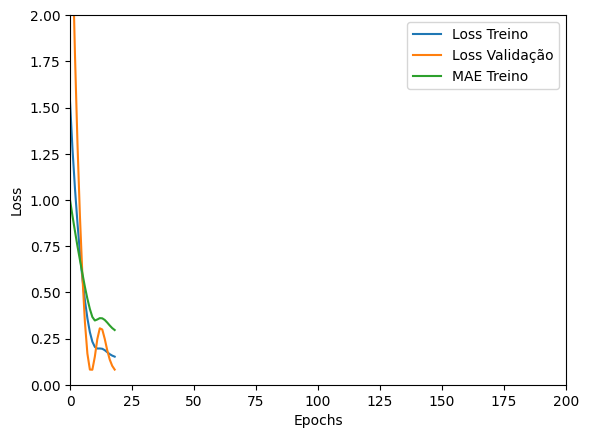

Tempo de treino: 0.10531995296478272 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1302579641342163 , MAE = 0.2774057984352112'

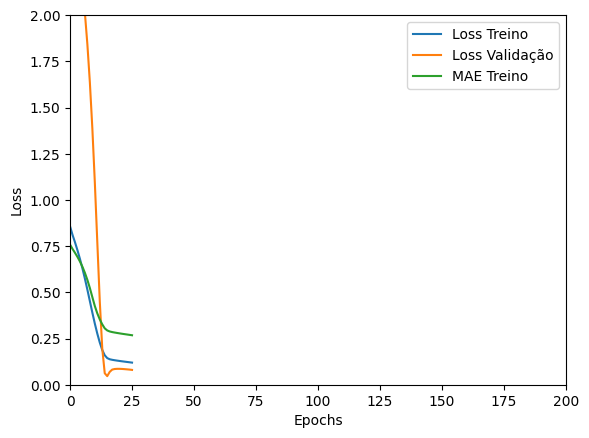

Tempo de treino: 0.11878603299458822 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13508504629135132 , MAE = 0.2927975356578827'

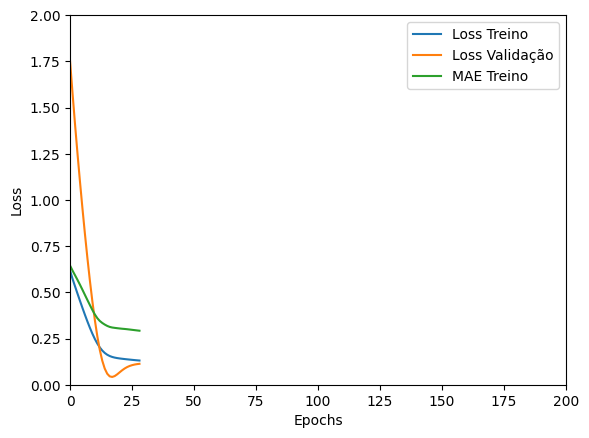

Tempo de treino: 0.14631778796513875 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30397140979766846 , MAE = 0.3647410273551941'

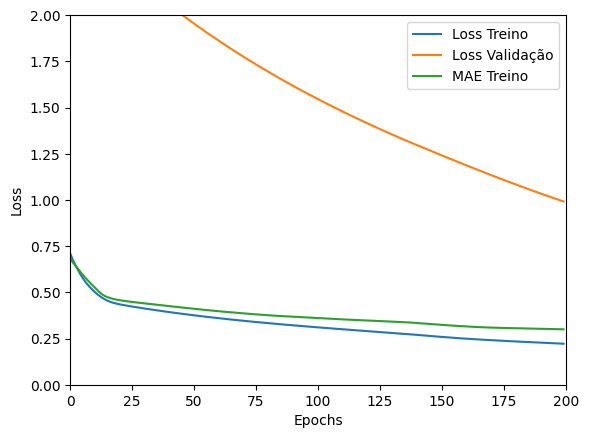

Tempo de treino: 0.3985036611557007 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5251785516738892 , MAE = 0.547008752822876'

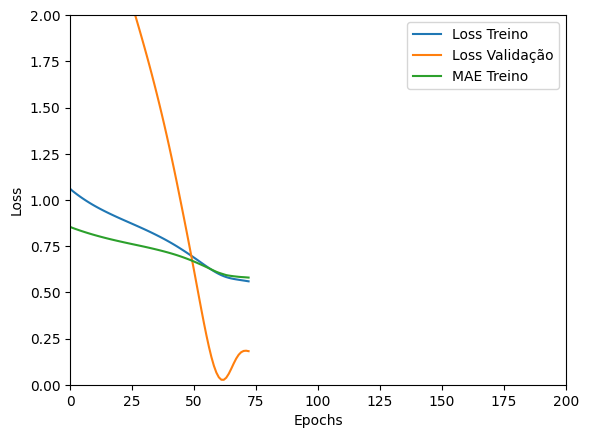

Tempo de treino: 0.11943833033243816 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18848581612110138 , MAE = 0.3368627429008484'

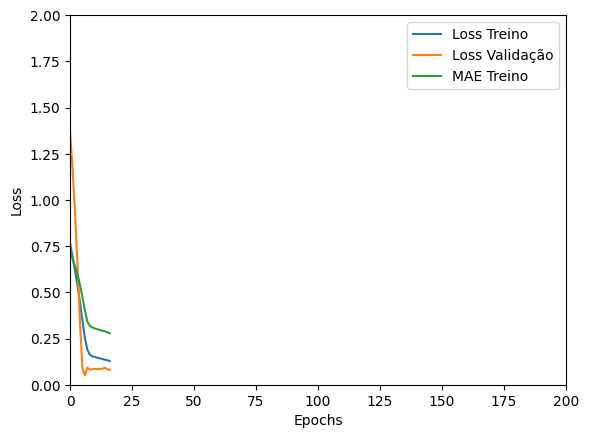

Tempo de treino: 0.11247429450352987 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1658245474100113 , MAE = 0.30873197317123413'

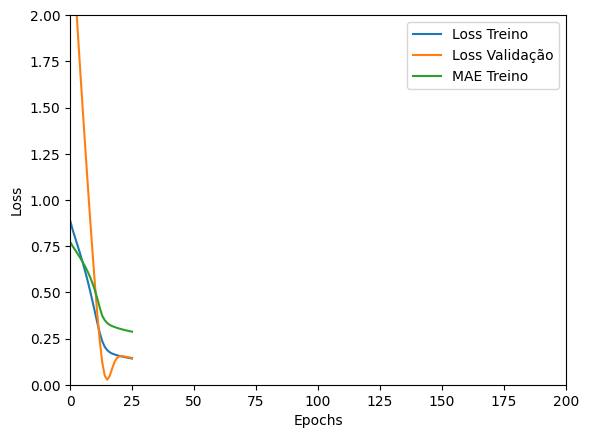

Tempo de treino: 0.09132953484853108 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31304481625556946 , MAE = 0.42785876989364624'

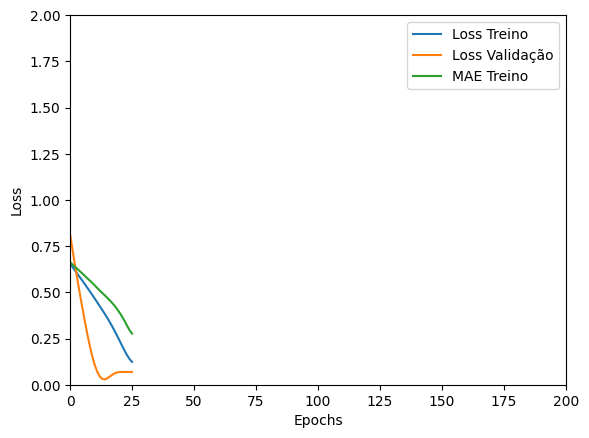

Tempo de treino: 0.08859529892603556 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3912460505962372 , MAE = 0.48402246832847595'

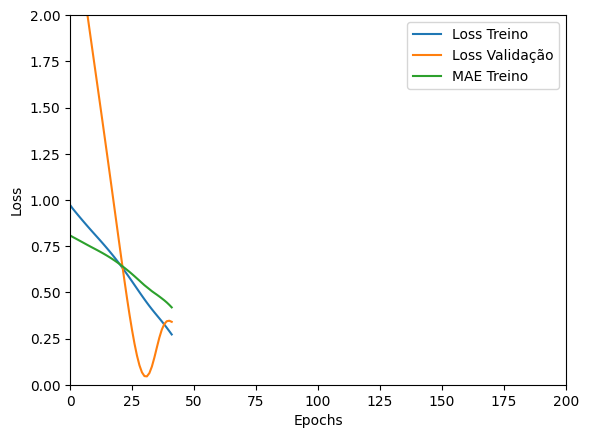

Tempo de treino: 0.08195913235346476 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12315588444471359 , MAE = 0.26686200499534607'

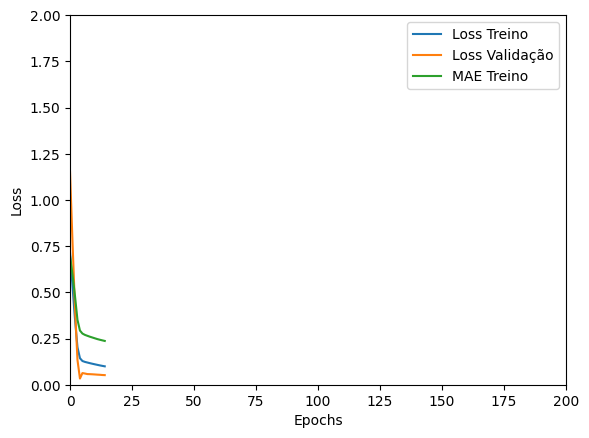

Tempo de treino: 0.12522421280543009 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1511346399784088 , MAE = 0.28678327798843384'

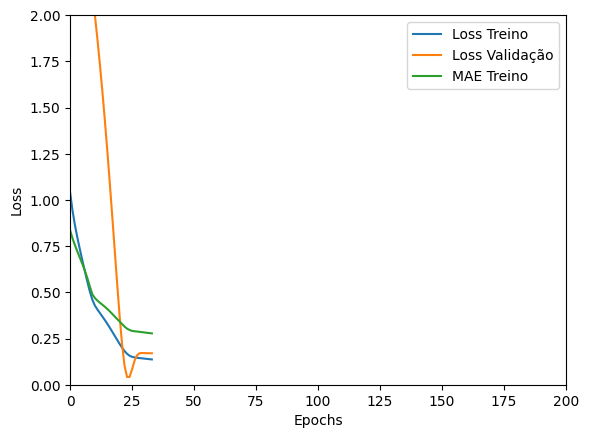

Tempo de treino: 0.16573747793833415 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22025799751281738 , MAE = 0.3659922778606415'

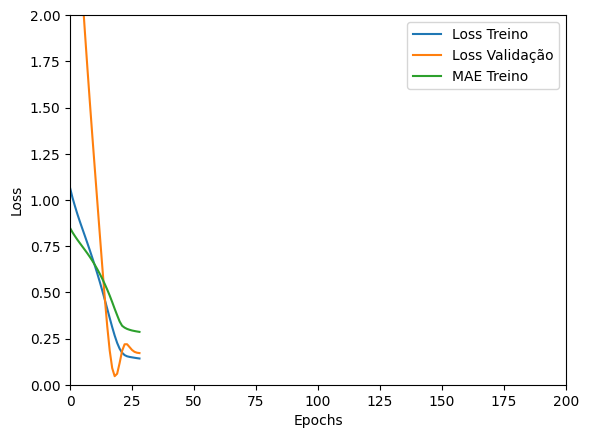

Tempo de treino: 0.09426364501317343 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29174545407295227 , MAE = 0.421718031167984'

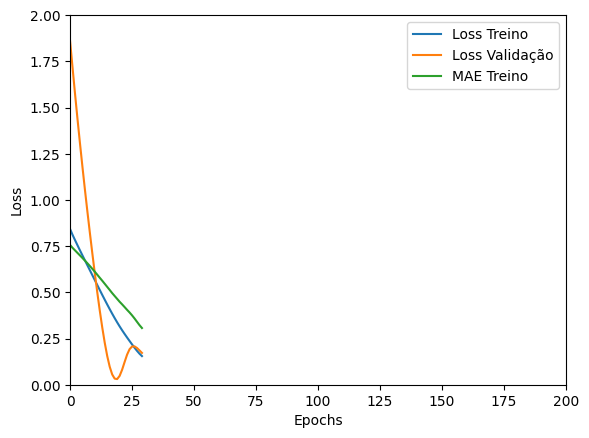

Tempo de treino: 0.08137186368306477 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06257524341344833 , MAE = 0.20640239119529724'

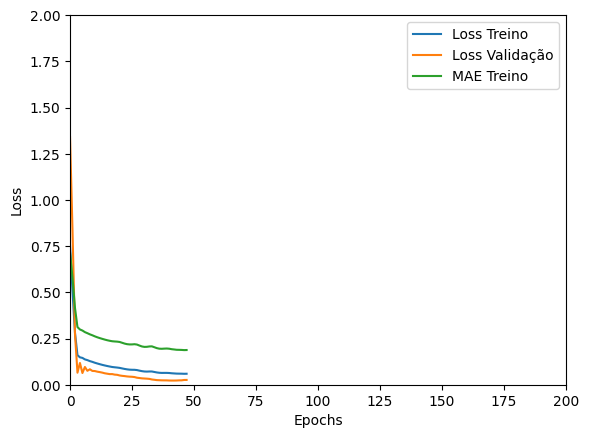

Tempo de treino: 0.22784260511398316 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2941063344478607 , MAE = 0.42575010657310486'

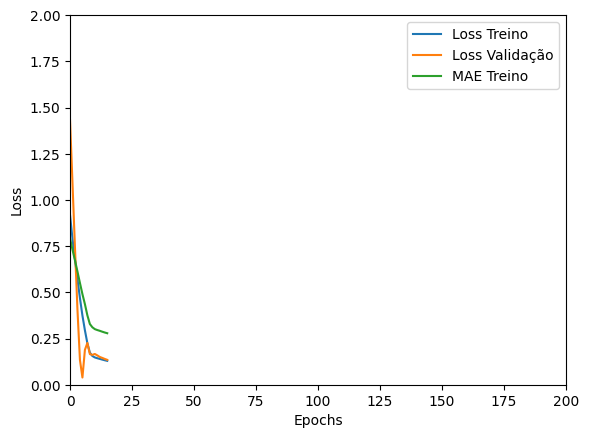

Tempo de treino: 0.09296762545903524 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13027538359165192 , MAE = 0.27206021547317505'

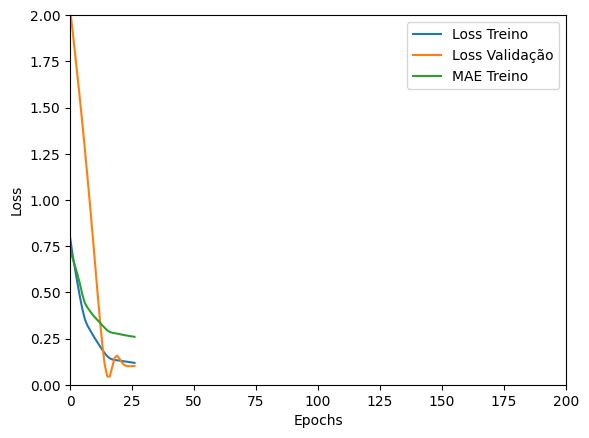

Tempo de treino: 0.07742575804392497 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14539088308811188 , MAE = 0.2890996038913727'

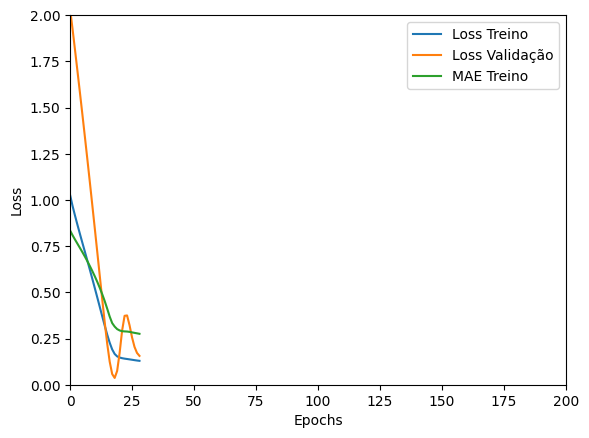

Tempo de treino: 0.08511740763982137 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06208384782075882 , MAE = 0.20574967563152313'

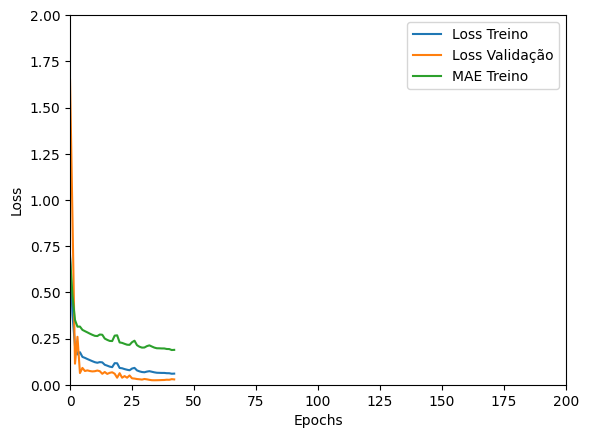

Tempo de treino: 0.24005293051401774 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1444794237613678 , MAE = 0.28657066822052'

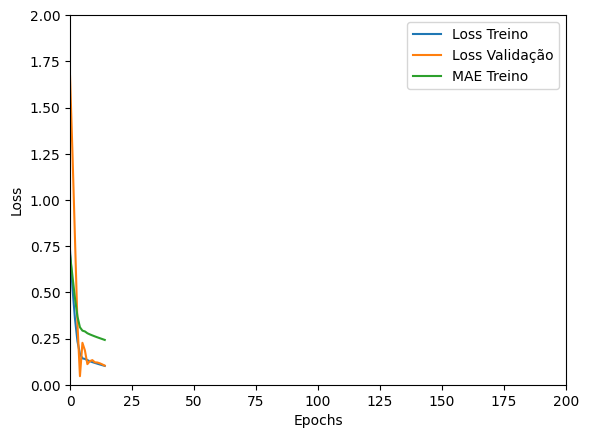

Tempo de treino: 0.09419833421707154 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1604047417640686 , MAE = 0.3012867867946625'

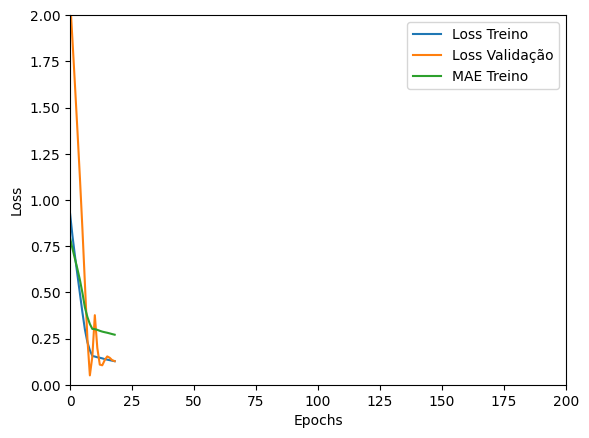

Tempo de treino: 0.09280116160710652 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13927434384822845 , MAE = 0.28581178188323975'

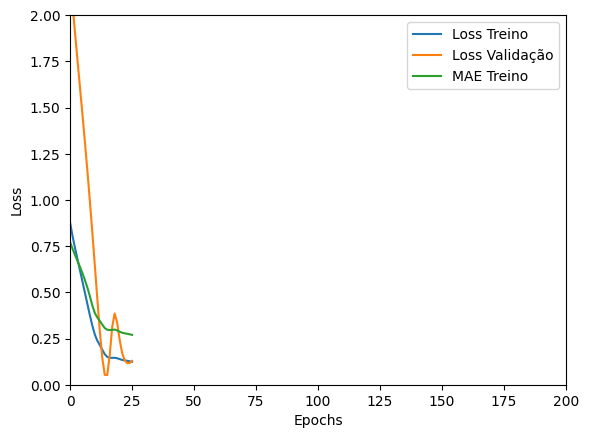

Tempo de treino: 0.07583755652109782 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=6, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30622032284736633 , MAE = 0.4342956840991974'

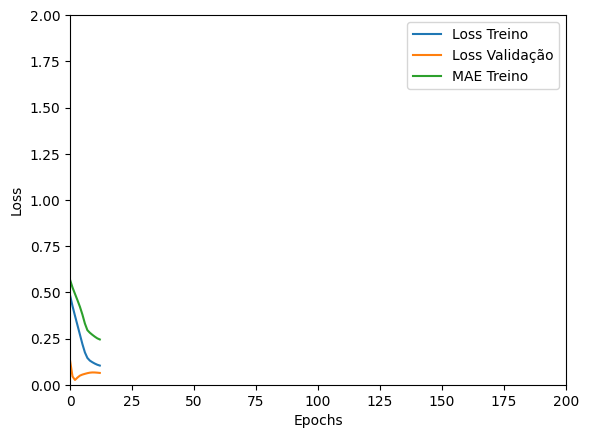

Tempo de treino: 0.08126139243443807 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14582176506519318 , MAE = 0.2987156808376312'

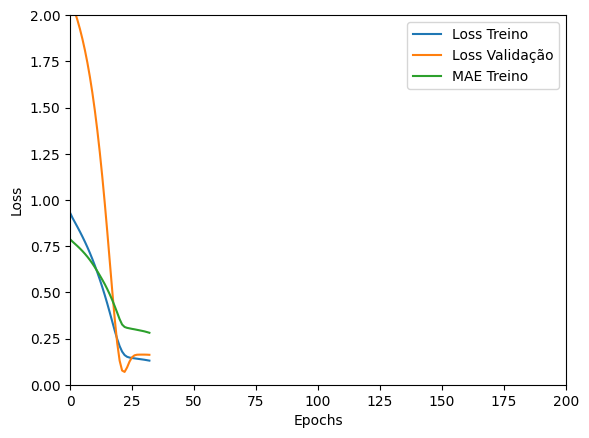

Tempo de treino: 0.1166296402613322 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11242781579494476 , MAE = 0.2512129545211792'

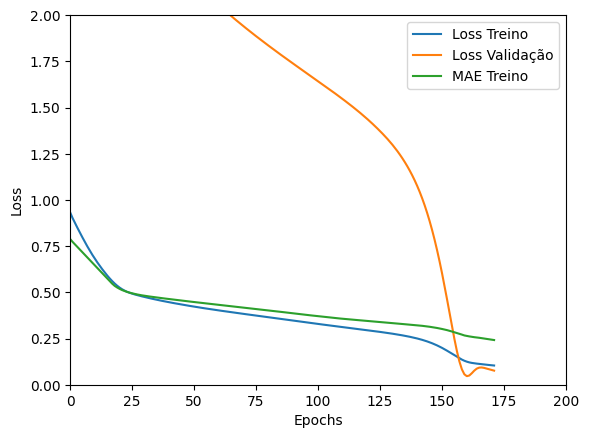

Tempo de treino: 0.38270460764567055 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1319599747657776 , MAE = 0.27988219261169434'

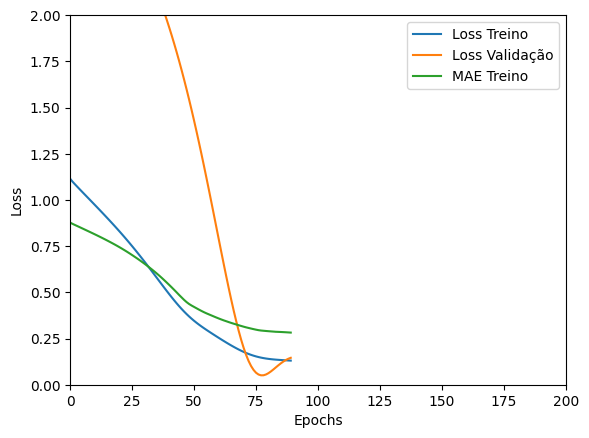

Tempo de treino: 0.14319624106089274 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1206100732088089 , MAE = 0.2639138996601105'

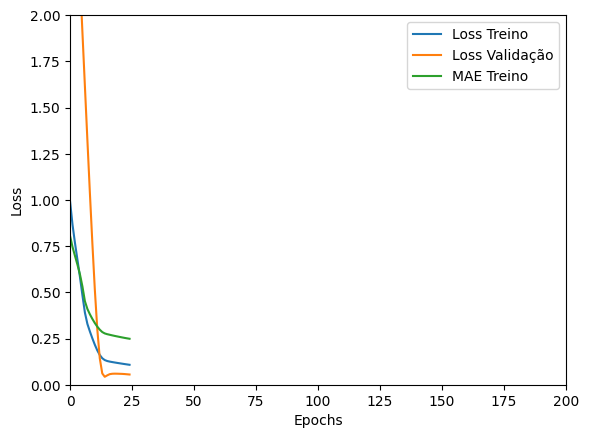

Tempo de treino: 0.1515586256980896 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23583853244781494 , MAE = 0.386409193277359'

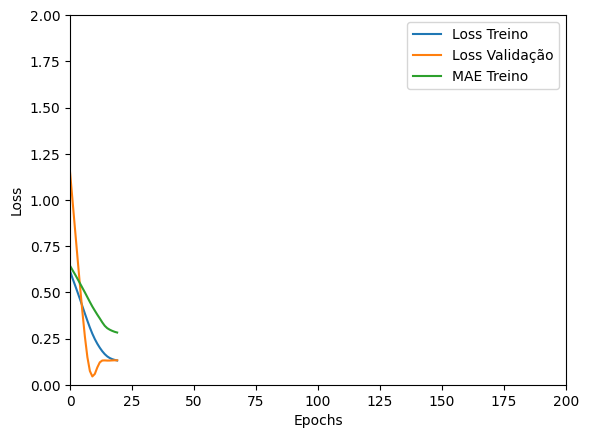

Tempo de treino: 0.13476611773173014 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5645014643669128 , MAE = 0.5668642520904541'

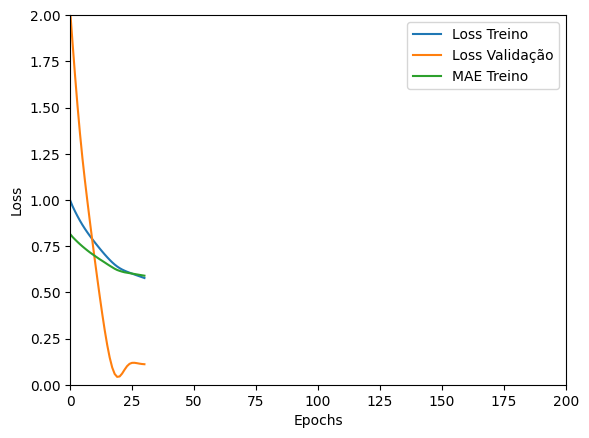

Tempo de treino: 0.13413877089818318 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2460794746875763 , MAE = 0.3906961977481842'

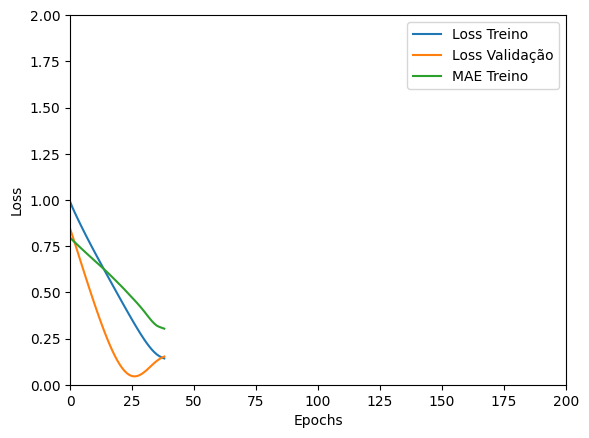

Tempo de treino: 0.09552549918492635 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15383164584636688 , MAE = 0.2970890700817108'

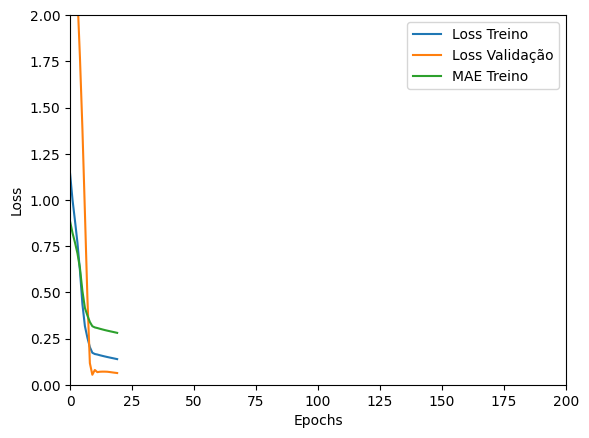

Tempo de treino: 0.13103778759638468 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1456155925989151 , MAE = 0.29283633828163147'

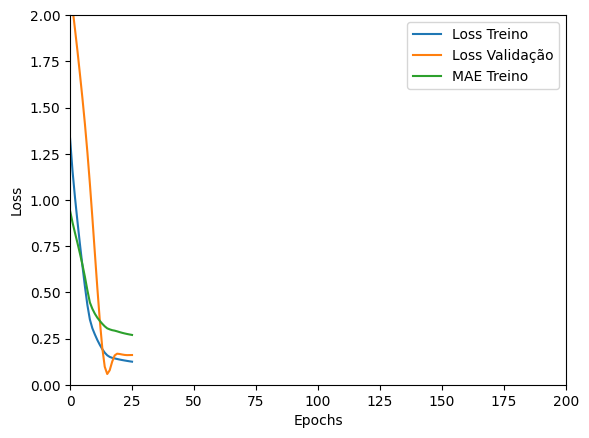

Tempo de treino: 0.13986181020736693 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2590080201625824 , MAE = 0.40168407559394836'

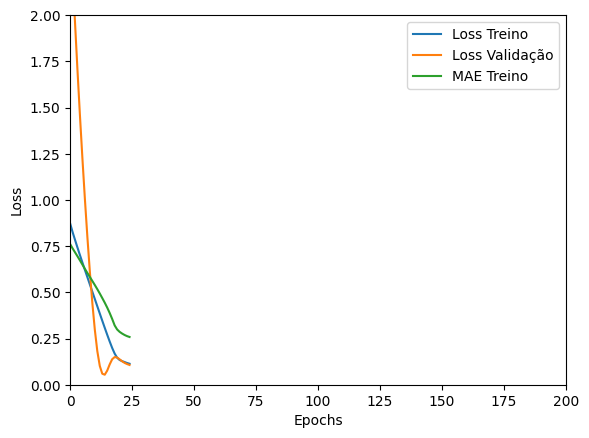

Tempo de treino: 0.08512227535247803 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22859250009059906 , MAE = 0.37639549374580383'

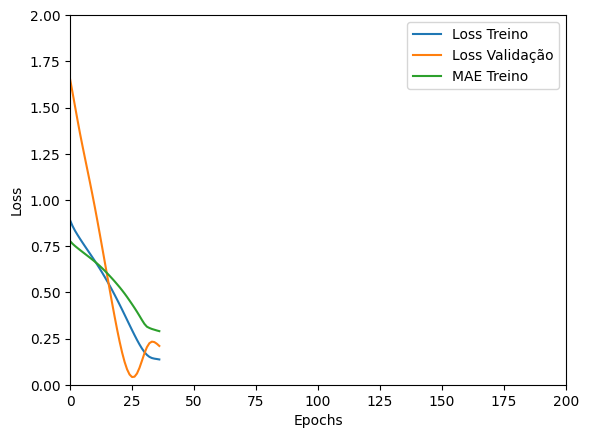

Tempo de treino: 0.16976048946380615 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08075860142707825 , MAE = 0.2239002138376236'

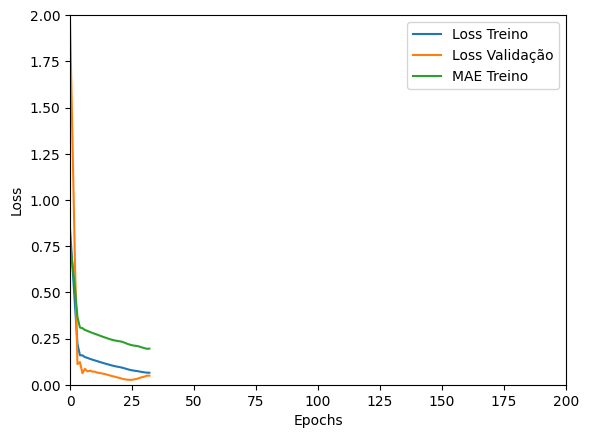

Tempo de treino: 0.2267226258913676 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16817152500152588 , MAE = 0.31068116426467896'

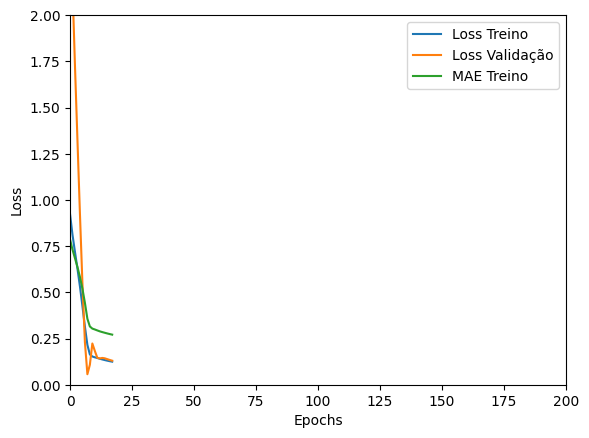

Tempo de treino: 0.10030757188796997 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13356944918632507 , MAE = 0.27154892683029175'

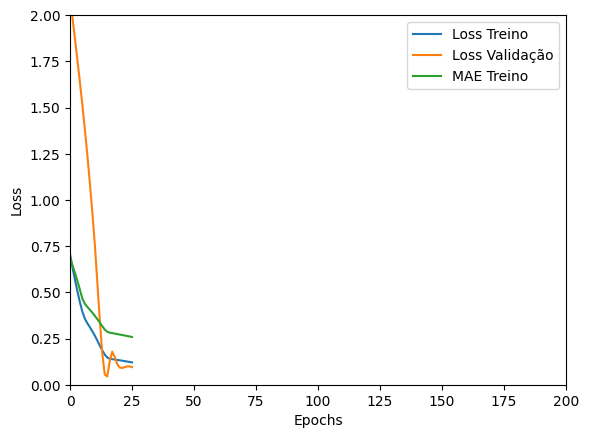

Tempo de treino: 0.0792101542154948 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13267917931079865 , MAE = 0.2718300223350525'

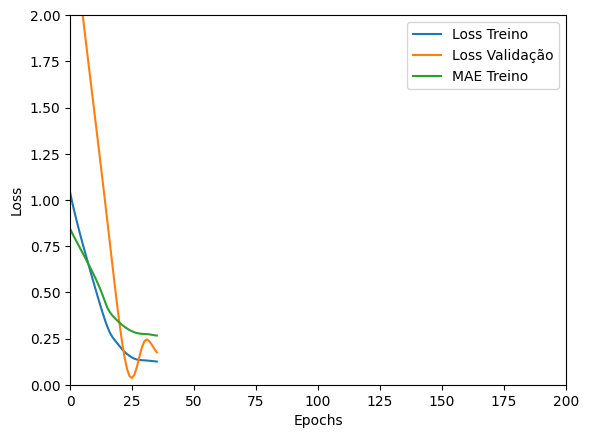

Tempo de treino: 0.12797556718190511 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07352687418460846 , MAE = 0.22318726778030396'

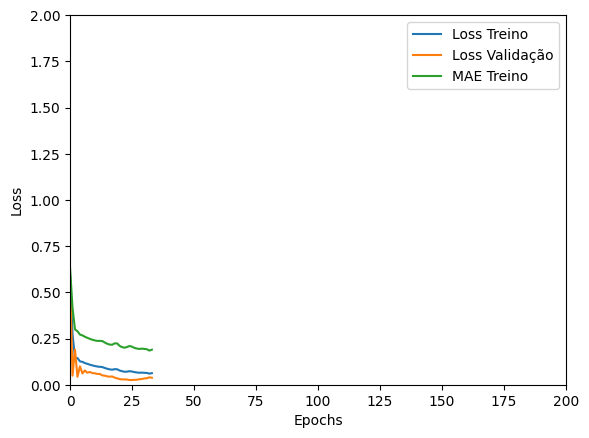

Tempo de treino: 0.15735721588134766 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16594533622264862 , MAE = 0.3079652488231659'

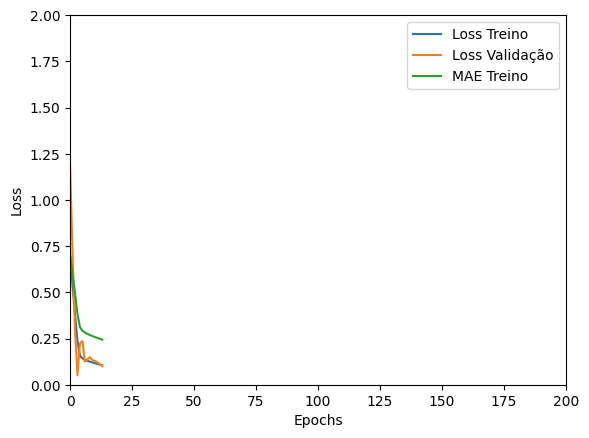

Tempo de treino: 0.07700095971425375 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21195153892040253 , MAE = 0.35403093695640564'

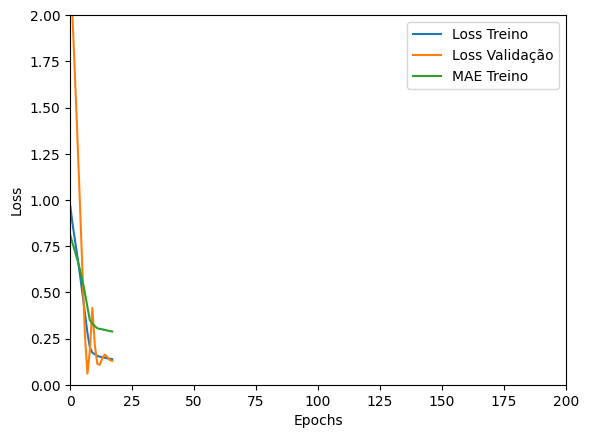

Tempo de treino: 0.12148297627766927 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15534797310829163 , MAE = 0.2989688217639923'

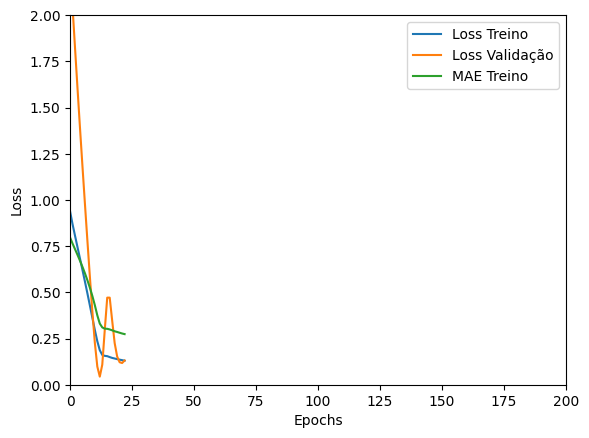

Tempo de treino: 0.10417200326919555 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=6, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35065099596977234 , MAE = 0.41499871015548706'

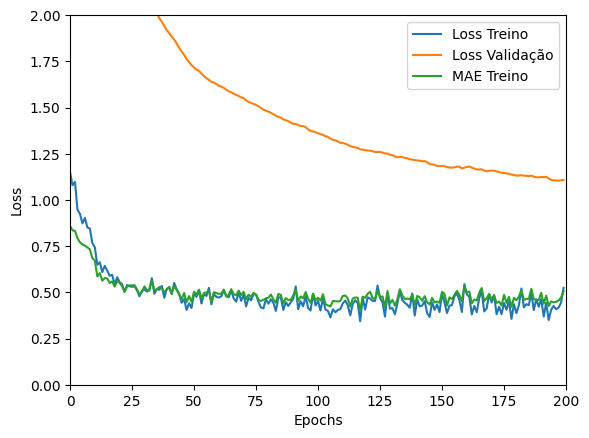

Tempo de treino: 0.6253055771191914 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16216164827346802 , MAE = 0.307732492685318'

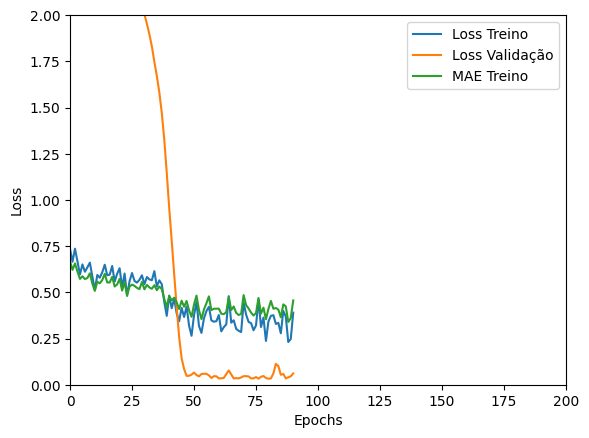

Tempo de treino: 0.21426466306050618 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.357204407453537 , MAE = 0.4694596827030182'

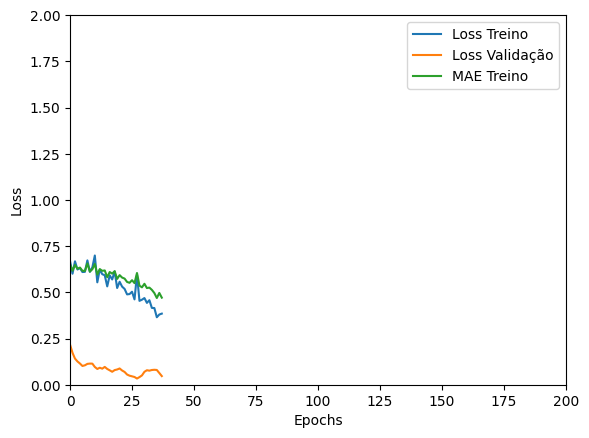

Tempo de treino: 0.09443334341049195 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18619385361671448 , MAE = 0.3313986361026764'

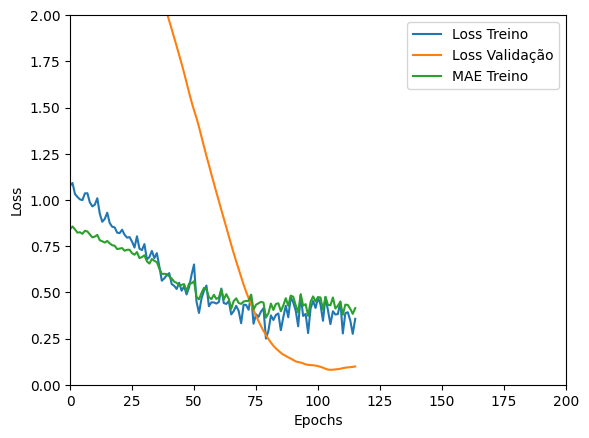

Tempo de treino: 0.22522159814834594 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11830876767635345 , MAE = 0.2601507306098938'

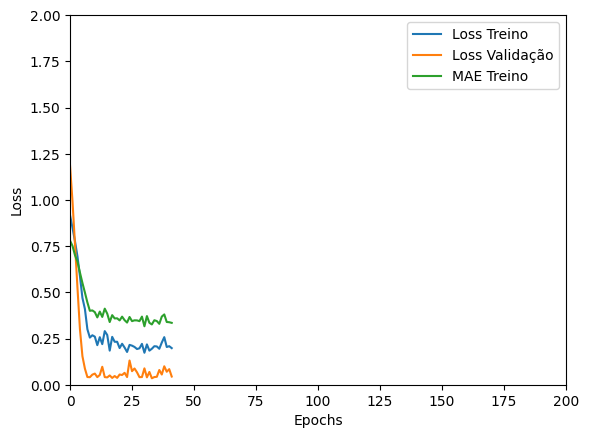

Tempo de treino: 0.16676341692606608 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32347068190574646 , MAE = 0.4437822699546814'

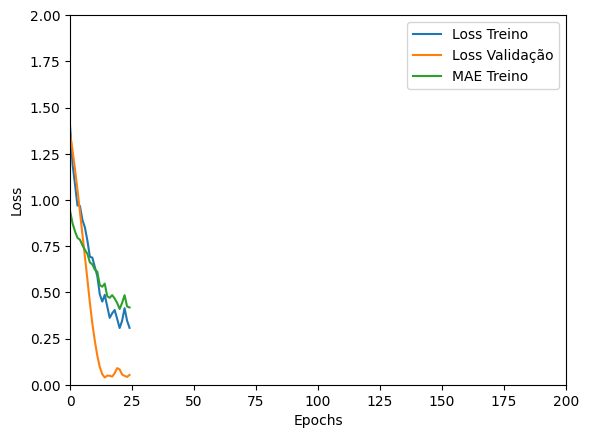

Tempo de treino: 0.16890769799550373 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5867378115653992 , MAE = 0.5750620365142822'

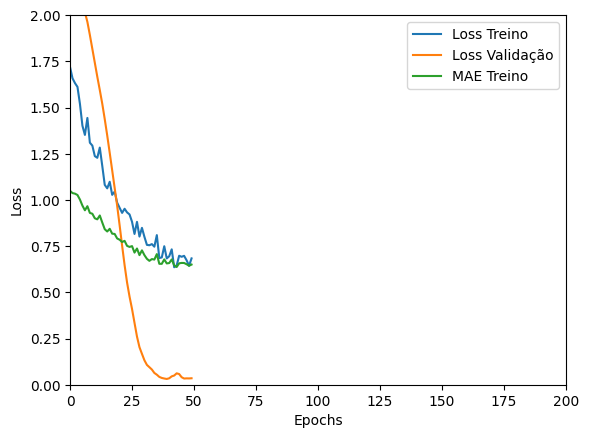

Tempo de treino: 0.12815290689468384 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14575496315956116 , MAE = 0.2908458709716797'

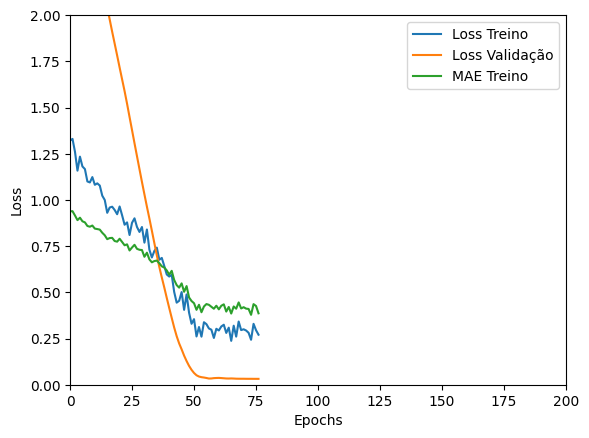

Tempo de treino: 0.13820789655049642 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12686365842819214 , MAE = 0.26637527346611023'

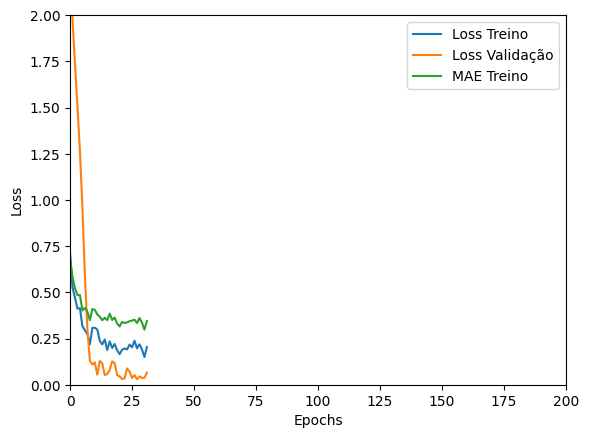

Tempo de treino: 0.15525080760320029 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13674984872341156 , MAE = 0.27901750802993774'

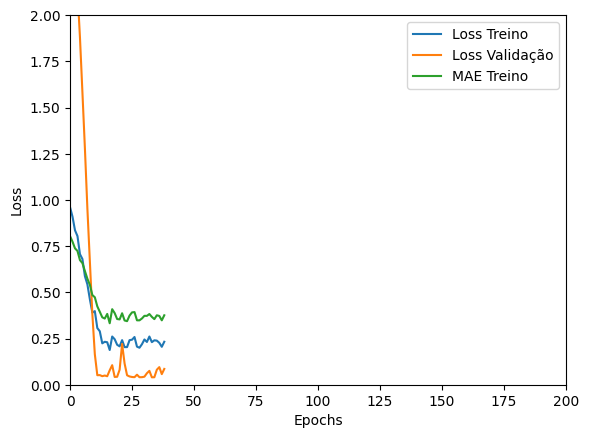

Tempo de treino: 0.12341187795003256 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40886640548706055 , MAE = 0.4887022078037262'

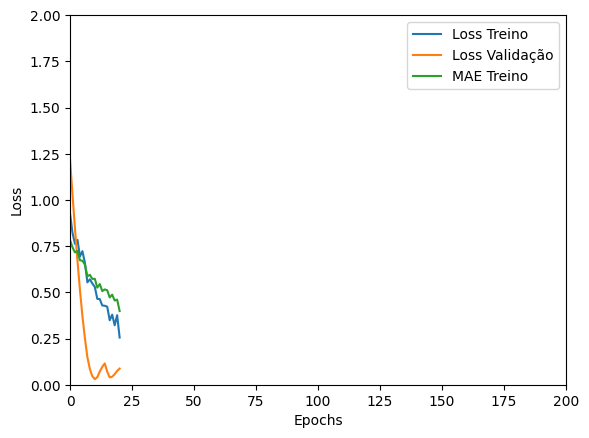

Tempo de treino: 0.07869099775950114 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30903586745262146 , MAE = 0.4325595796108246'

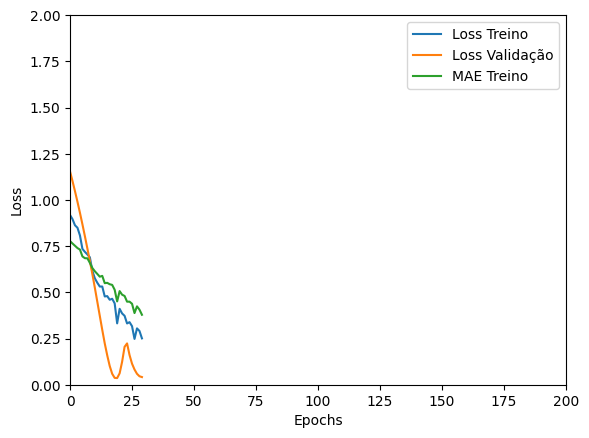

Tempo de treino: 0.07133225599924724 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09918394684791565 , MAE = 0.23583102226257324'

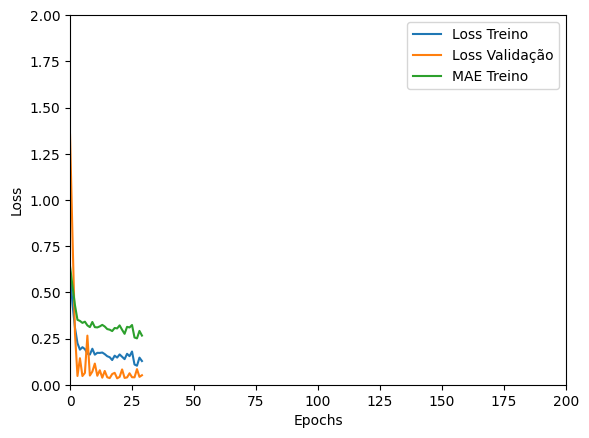

Tempo de treino: 0.2618190844853719 minutos


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v3 , timesteps=6, units=32, batch=8


'TRAINING set. Loss = 0.1264616847038269 , MAE = 0.2657088041305542'

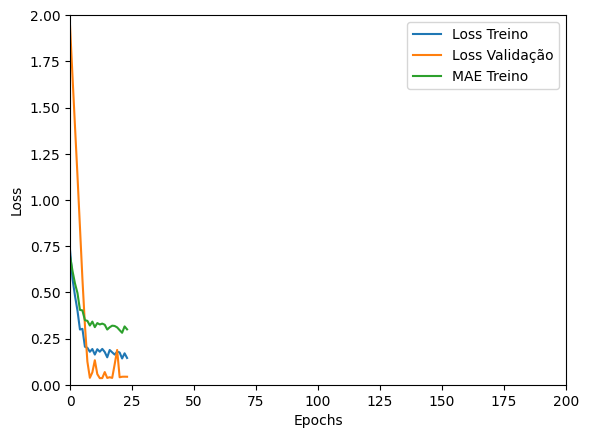

Tempo de treino: 0.11982099215189616 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.44750961661338806 , MAE = 0.5128953456878662'

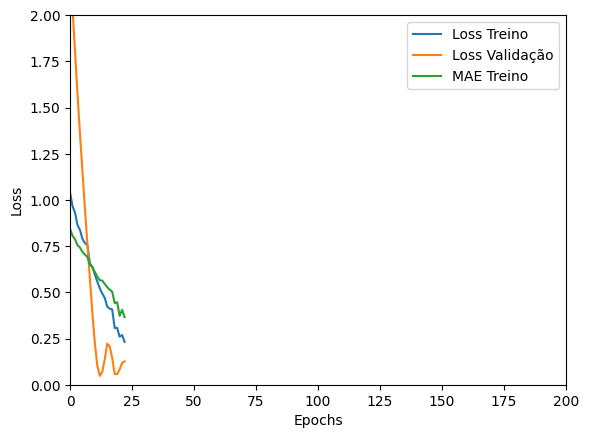

Tempo de treino: 0.08284505208333333 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14076641201972961 , MAE = 0.28077709674835205'

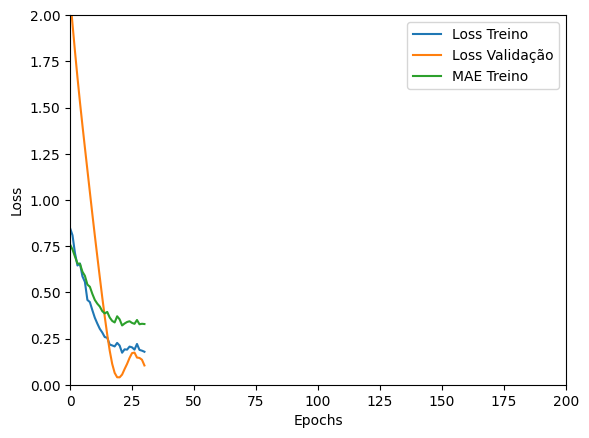

Tempo de treino: 0.09986195961634318 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13641732931137085 , MAE = 0.2794455885887146'

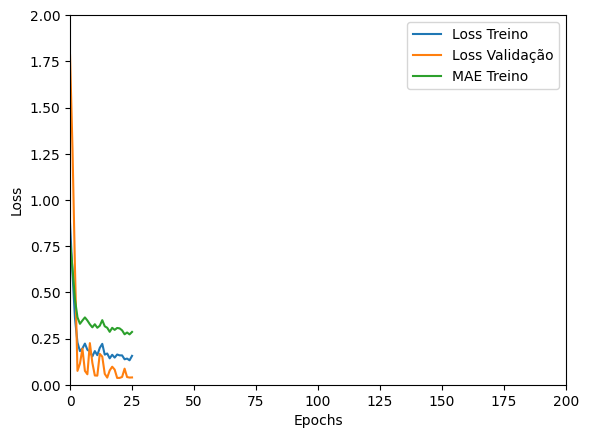

Tempo de treino: 0.13295077482859294 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1188894510269165 , MAE = 0.25574684143066406'

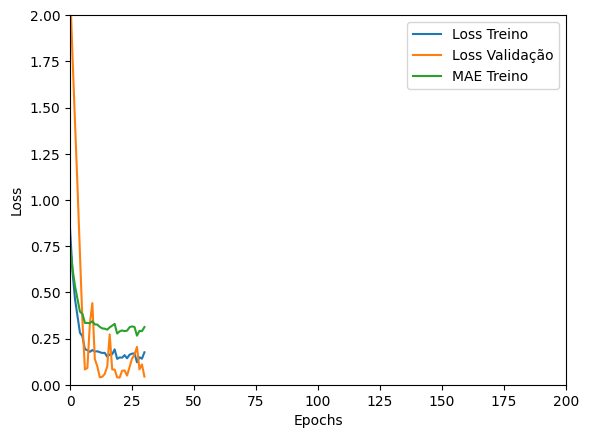

Tempo de treino: 0.11869252920150757 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12506046891212463 , MAE = 0.26453039050102234'

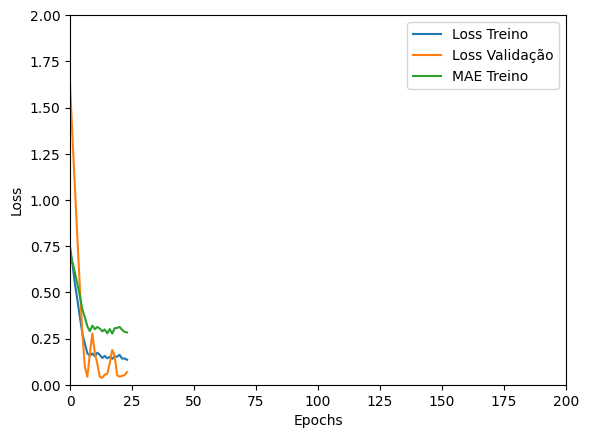

Tempo de treino: 0.08490233818689982 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15487325191497803 , MAE = 0.29813188314437866'

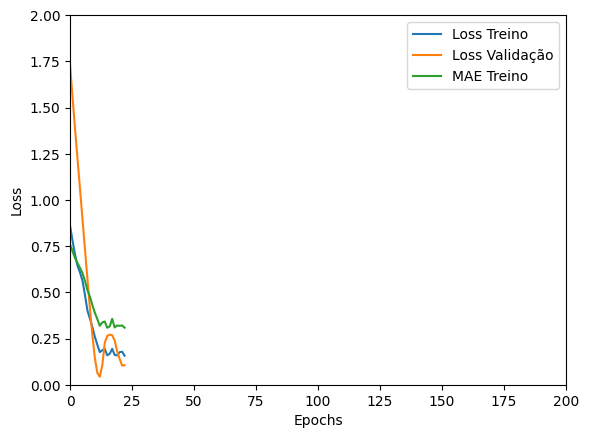

Tempo de treino: 0.13235731919606528 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com GRU_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042807675898075104 , MAE = 0.15930843353271484'

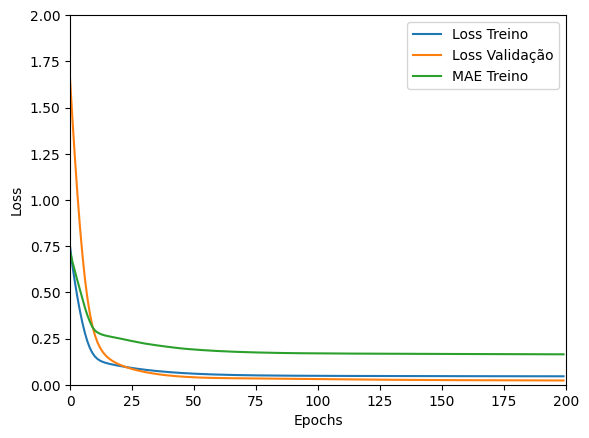

Tempo de treino: 0.6949315468470255 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04379585012793541 , MAE = 0.1613890528678894'

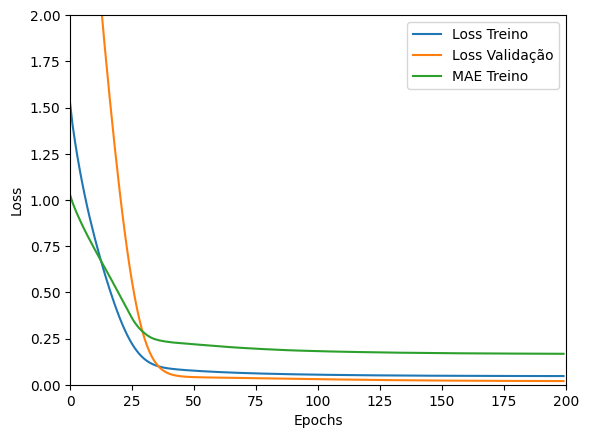

Tempo de treino: 0.7500935872395833 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05467922240495682 , MAE = 0.18308071792125702'

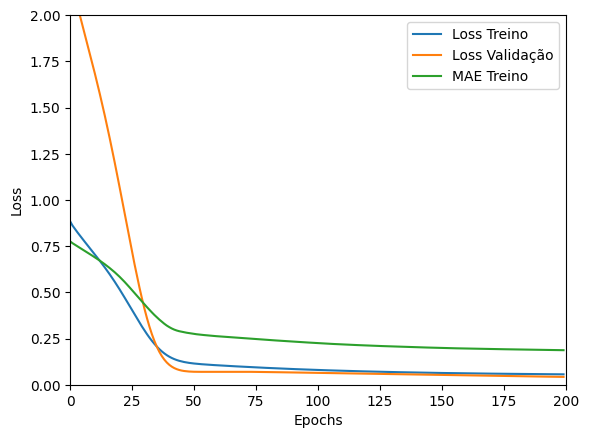

Tempo de treino: 0.3247566223144531 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07489439100027084 , MAE = 0.2180221527814865'

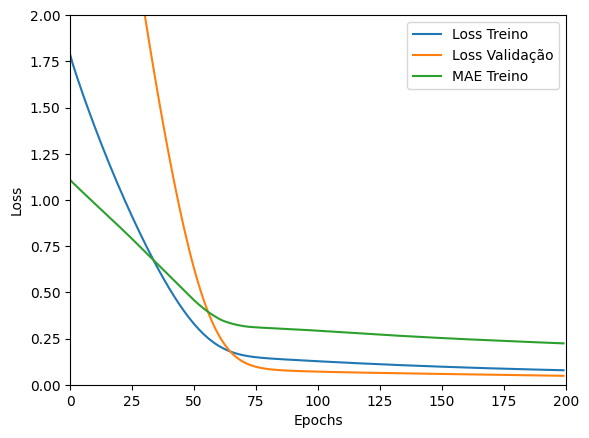

Tempo de treino: 0.25420455932617186 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04394356161355972 , MAE = 0.16144929826259613'

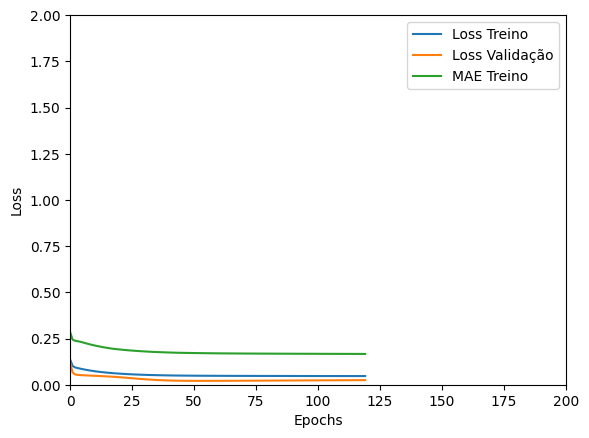

Tempo de treino: 0.7706145087877909 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04439448192715645 , MAE = 0.16072922945022583'

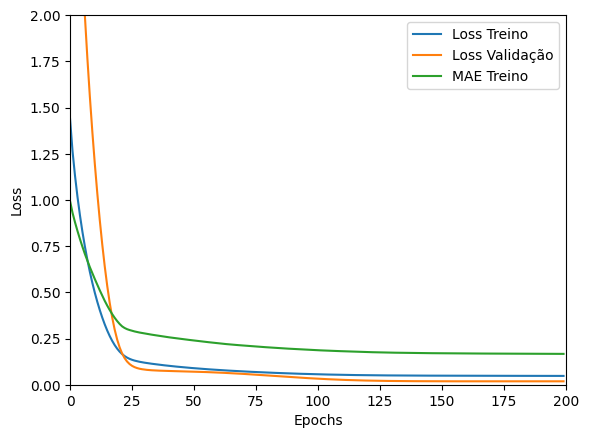

Tempo de treino: 0.7465317765871684 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048067715018987656 , MAE = 0.16909943521022797'

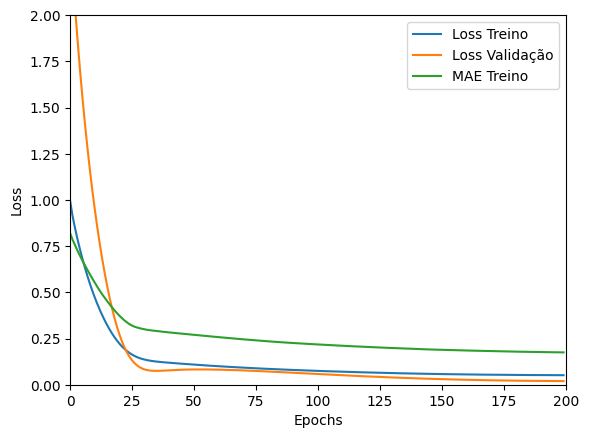

Tempo de treino: 0.33629661798477173 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.056724585592746735 , MAE = 0.186965674161911'

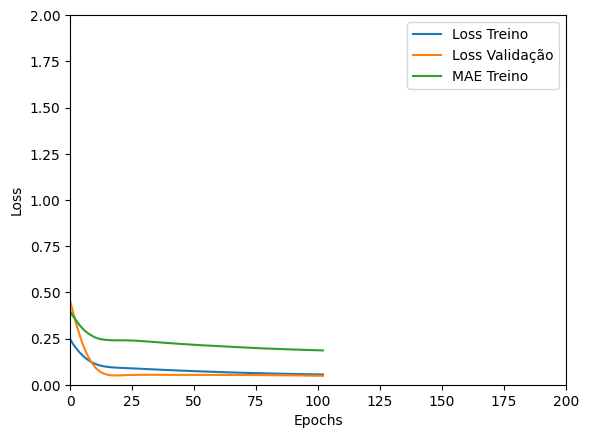

Tempo de treino: 0.15813862880071003 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05013918876647949 , MAE = 0.17406290769577026'

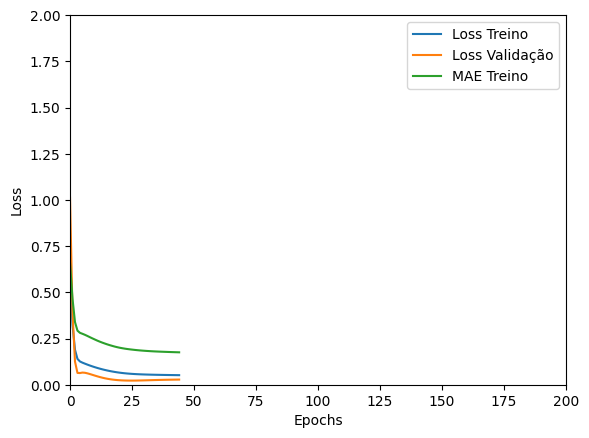

Tempo de treino: 0.28206805388132733 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04450029507279396 , MAE = 0.16194069385528564'

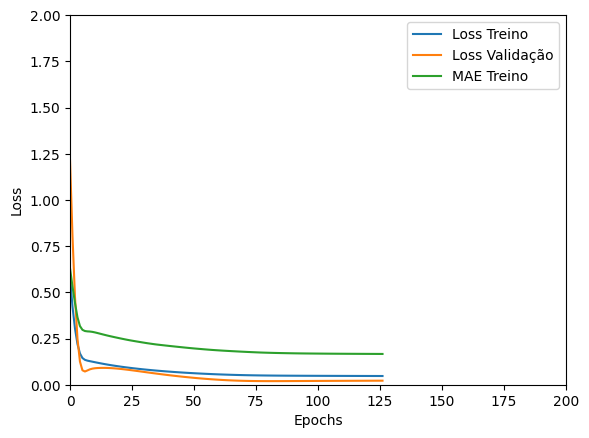

Tempo de treino: 0.33835678100585936 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0599236823618412 , MAE = 0.18838784098625183'

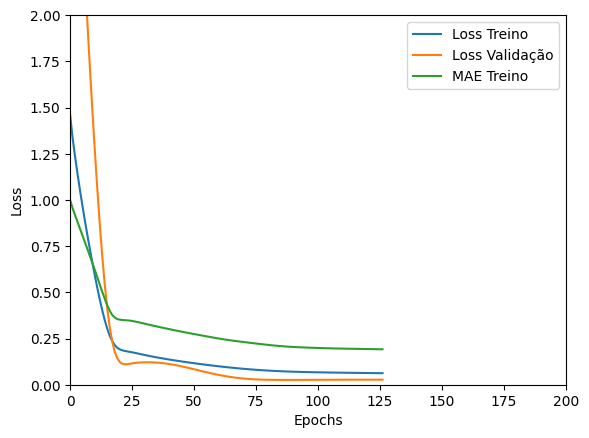

Tempo de treino: 0.41009589831034343 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10993494838476181 , MAE = 0.26450982689857483'

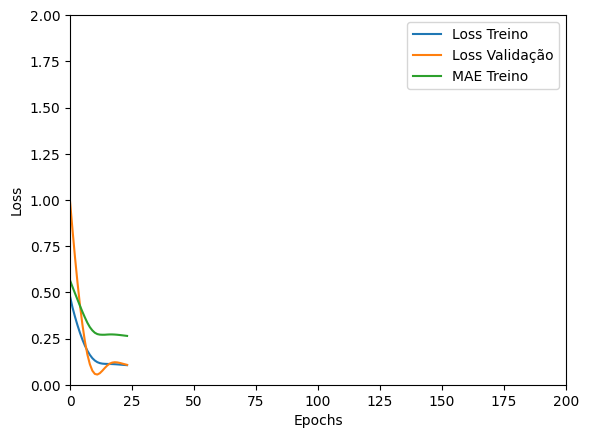

Tempo de treino: 0.1704314390818278 minutos


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com GRU_v1 , timesteps=6, units=32, batch=4


'TRAINING set. Loss = 0.055190738290548325 , MAE = 0.18341900408267975'

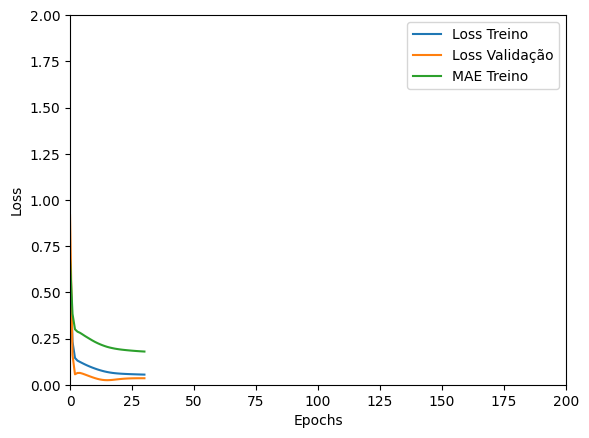

Tempo de treino: 0.4761600852012634 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15849268436431885 , MAE = 0.31633058190345764'

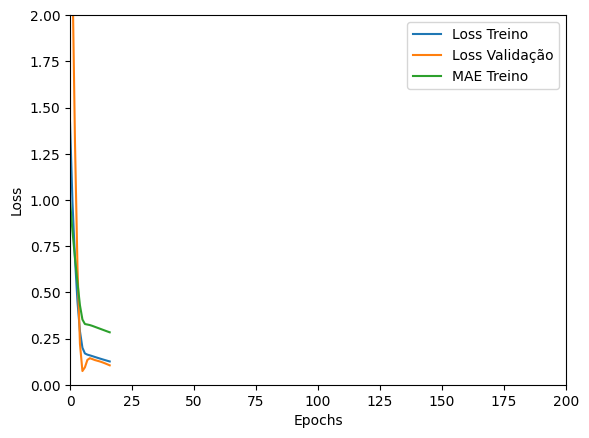

Tempo de treino: 0.1526862899462382 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10388059169054031 , MAE = 0.25444674491882324'

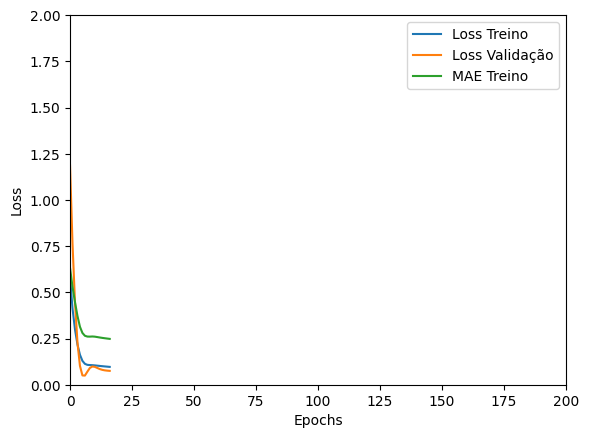

Tempo de treino: 0.10196158885955811 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09754039347171783 , MAE = 0.2450437992811203'

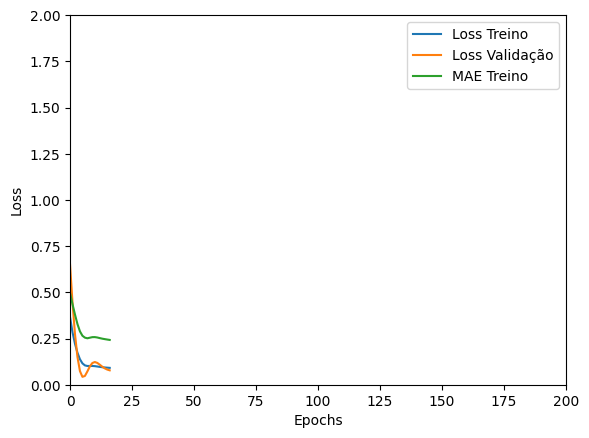

Tempo de treino: 0.10462524890899658 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05737164989113808 , MAE = 0.18726934492588043'

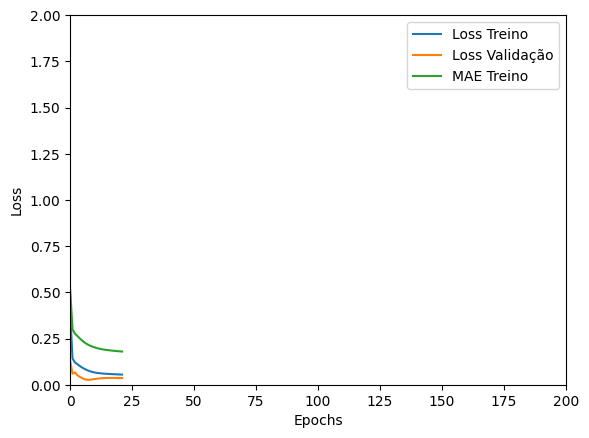

Tempo de treino: 0.1462994893391927 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07105404883623123 , MAE = 0.20702488720417023'

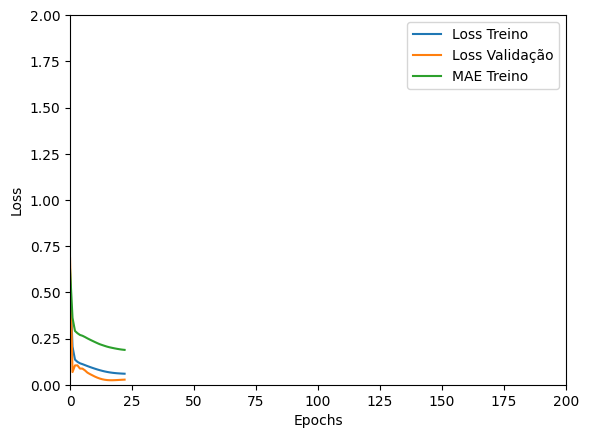

Tempo de treino: 0.16841190258661906 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14364409446716309 , MAE = 0.2985275685787201'

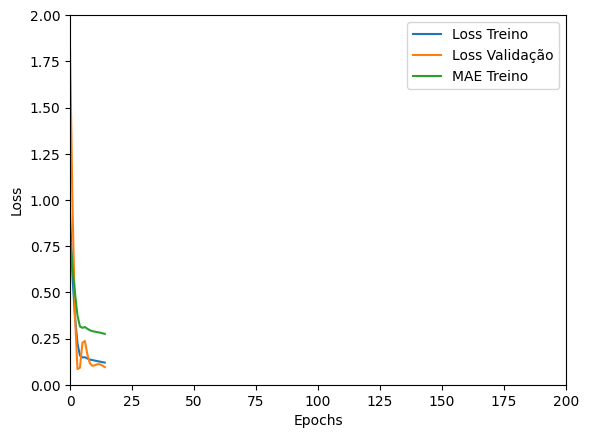

Tempo de treino: 0.11328463951746623 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16349703073501587 , MAE = 0.3166641294956207'

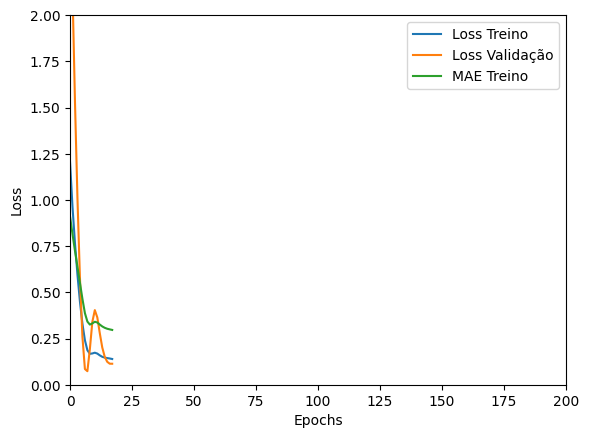

Tempo de treino: 0.09678028027216594 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5008748769760132 , MAE = 0.565437912940979'

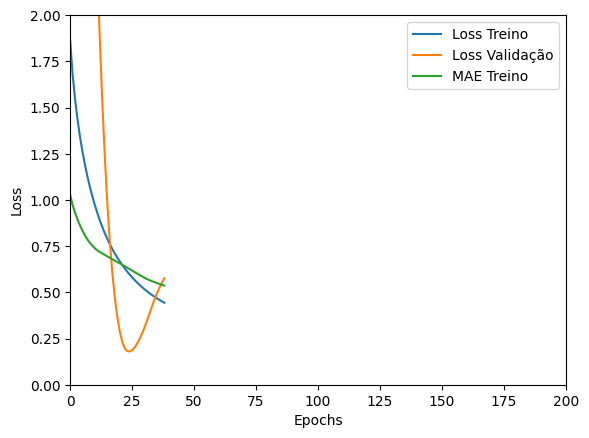

Tempo de treino: 0.18417927424112956 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30638331174850464 , MAE = 0.3673633635044098'

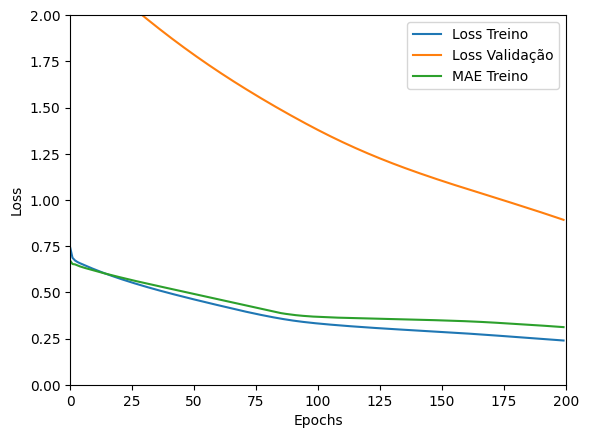

Tempo de treino: 0.7179094036420186 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38911691308021545 , MAE = 0.4149559736251831'

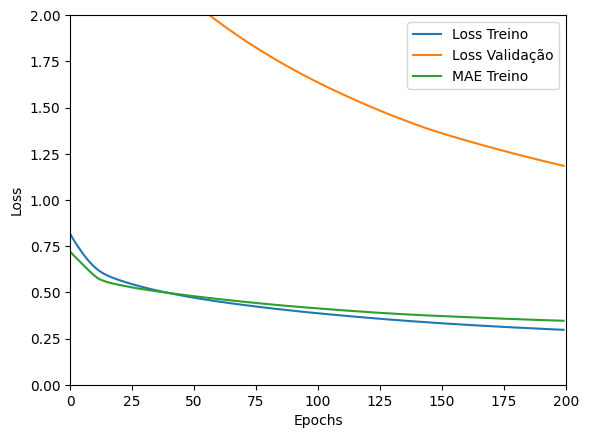

Tempo de treino: 0.2576948841412862 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6847628355026245 , MAE = 0.6357550024986267'

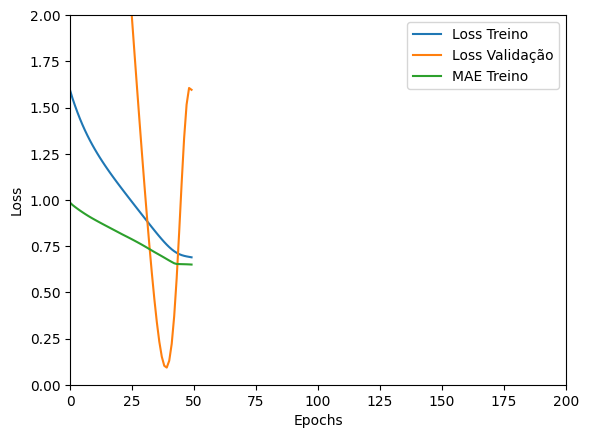

Tempo de treino: 0.16466894149780273 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.271329402923584 , MAE = 0.38521409034729004'

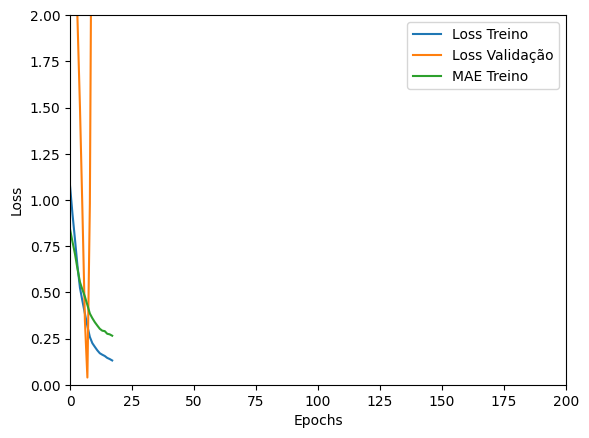

Tempo de treino: 0.10356772740681966 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28315186500549316 , MAE = 0.42240044474601746'

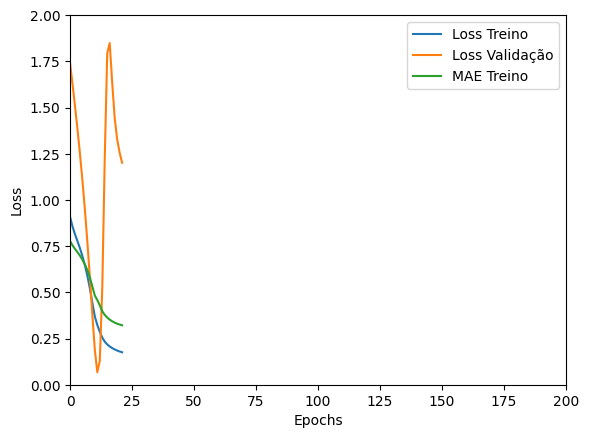

Tempo de treino: 0.09526493946711222 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2788187563419342 , MAE = 0.3891778886318207'

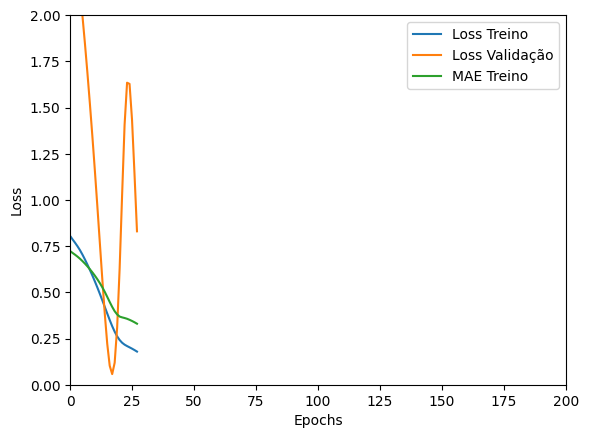

Tempo de treino: 0.07494469086329142 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6049803495407104 , MAE = 0.6093592643737793'

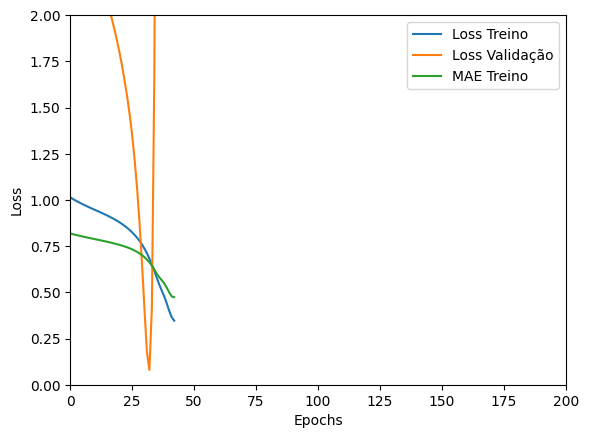

Tempo de treino: 0.1293734868367513 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23730194568634033 , MAE = 0.3696537911891937'

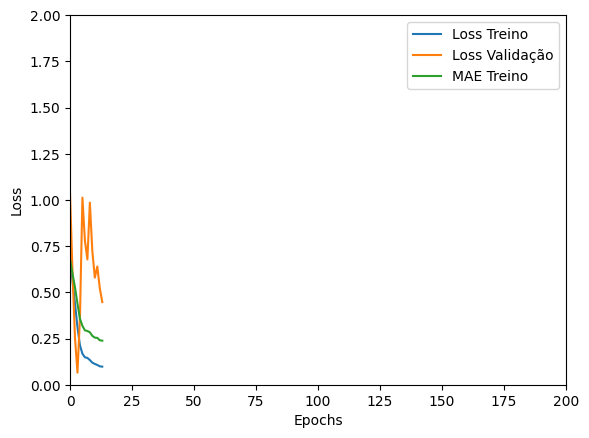

Tempo de treino: 0.08064090410868327 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.266478568315506 , MAE = 0.3978114426136017'

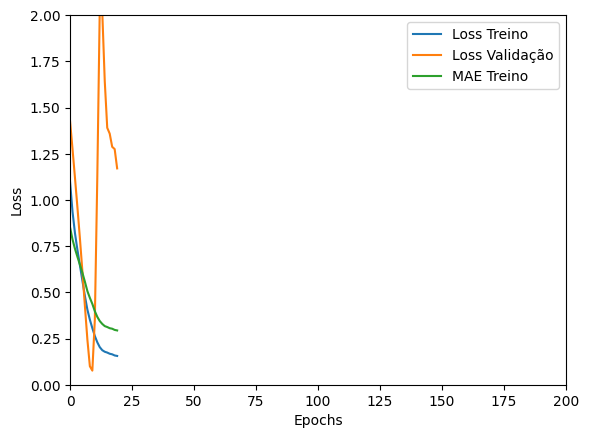

Tempo de treino: 0.122102423508962 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6017586588859558 , MAE = 0.6015704274177551'

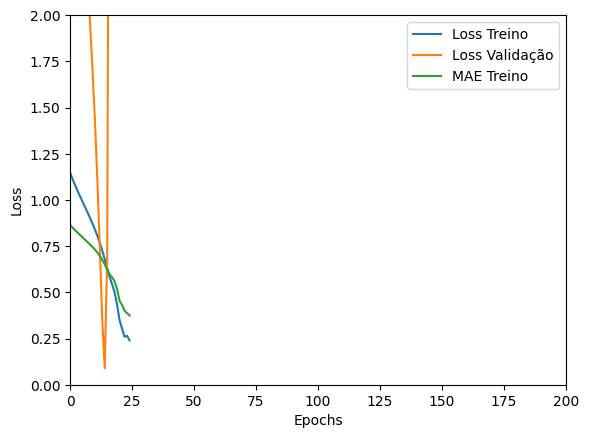

Tempo de treino: 0.06548848946889242 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31730136275291443 , MAE = 0.4258609712123871'

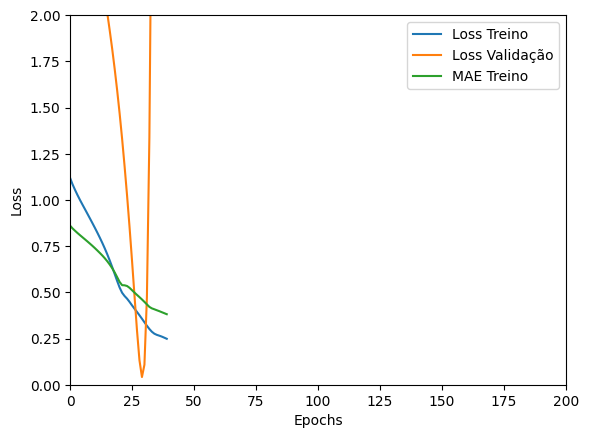

Tempo de treino: 0.12810190121332804 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24944821000099182 , MAE = 0.3712146282196045'

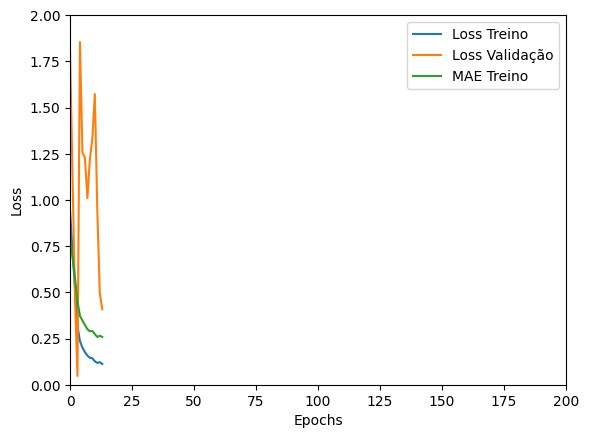

Tempo de treino: 0.09810799360275269 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26601818203926086 , MAE = 0.38694435358047485'

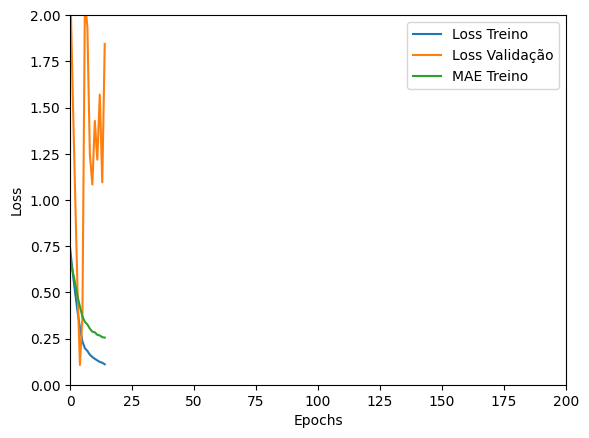

Tempo de treino: 0.12885629733403522 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3152428865432739 , MAE = 0.4142221510410309'

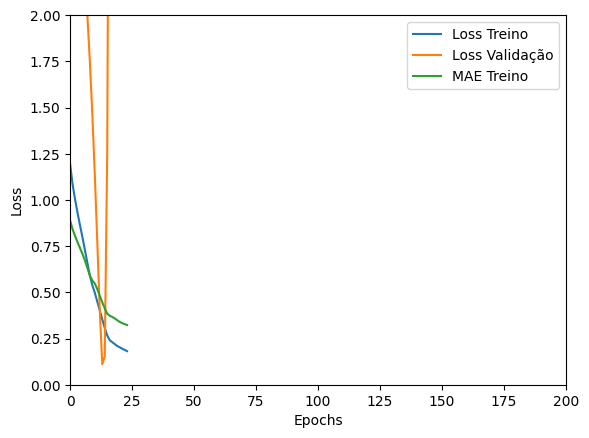

Tempo de treino: 0.08248287041982015 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17327362298965454 , MAE = 0.30530425906181335'

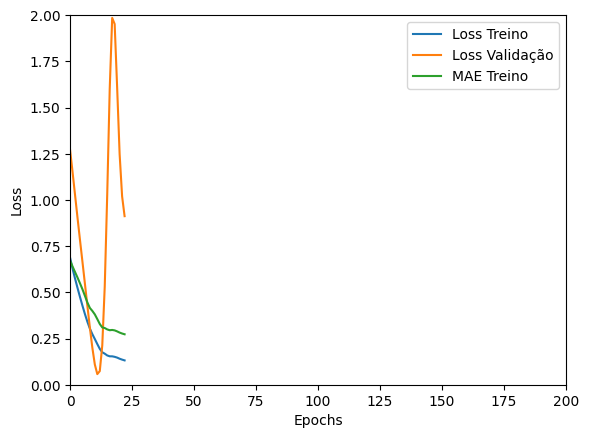

Tempo de treino: 0.0924051841100057 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08216848224401474 , MAE = 0.21627181768417358'

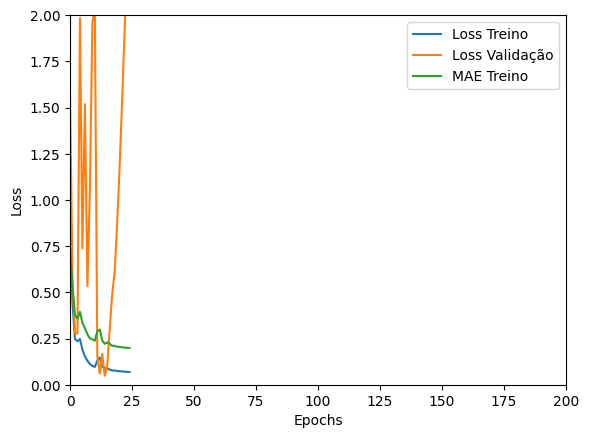

Tempo de treino: 0.12115027904510497 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2572539150714874 , MAE = 0.38724207878112793'

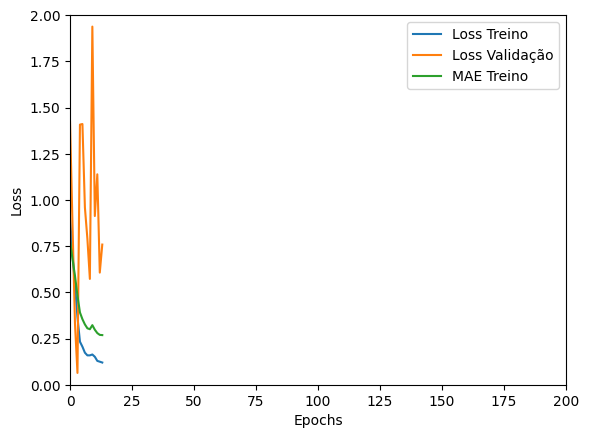

Tempo de treino: 0.08453727165857951 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2788872718811035 , MAE = 0.4078684151172638'

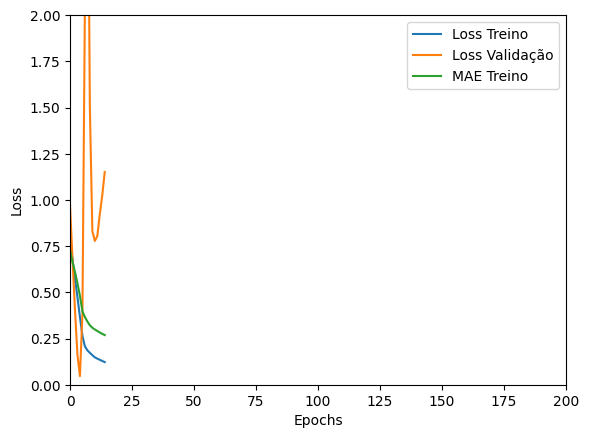

Tempo de treino: 0.059218998750050864 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3292825222015381 , MAE = 0.44212985038757324'

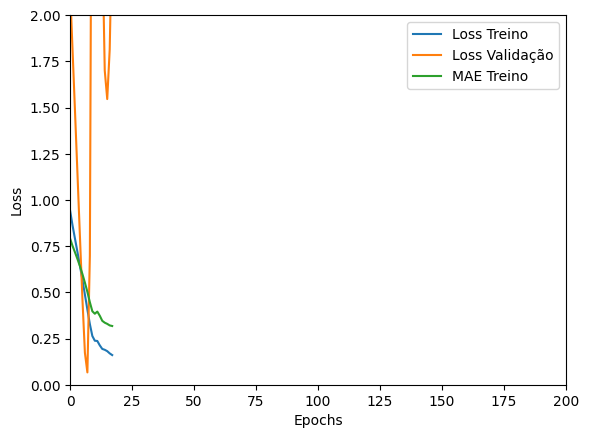

Tempo de treino: 0.0838250994682312 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=12, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19467712938785553 , MAE = 0.31520700454711914'

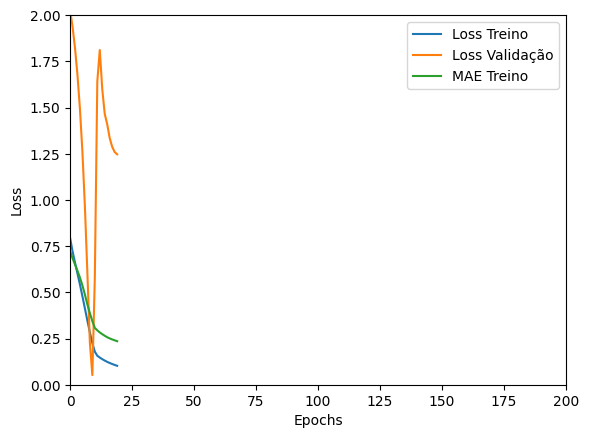

Tempo de treino: 0.1233514944712321 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16966450214385986 , MAE = 0.31327807903289795'

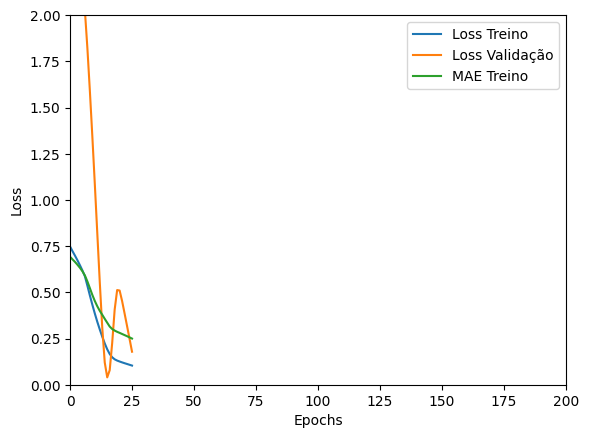

Tempo de treino: 0.0959977388381958 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47960200905799866 , MAE = 0.5060262084007263'

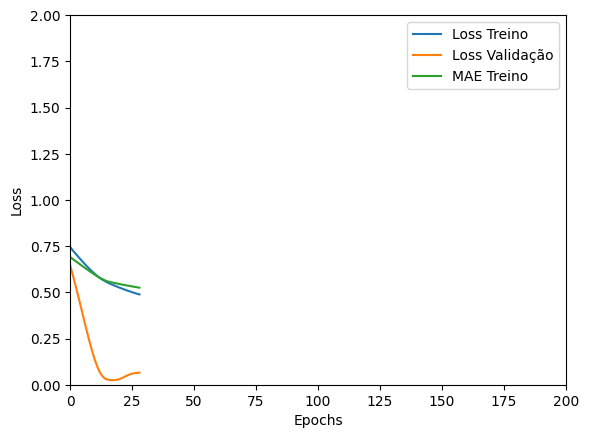

Tempo de treino: 0.1366998593012492 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14229604601860046 , MAE = 0.26086774468421936'

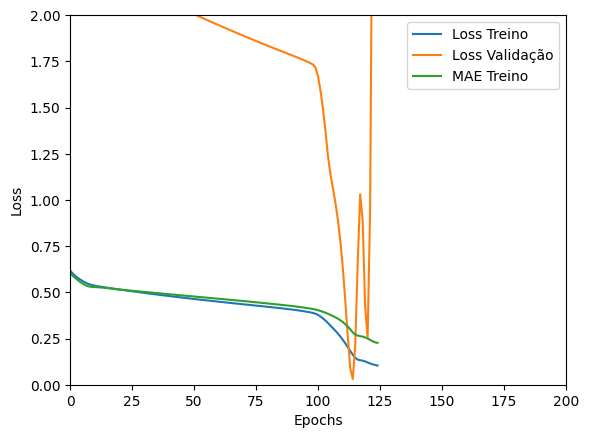

Tempo de treino: 0.21616450945536295 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2288581132888794 , MAE = 0.34739723801612854'

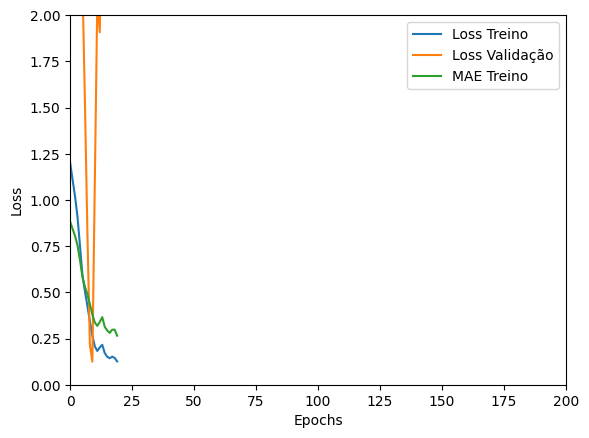

Tempo de treino: 0.10247478485107422 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5899592041969299 , MAE = 0.5834392309188843'

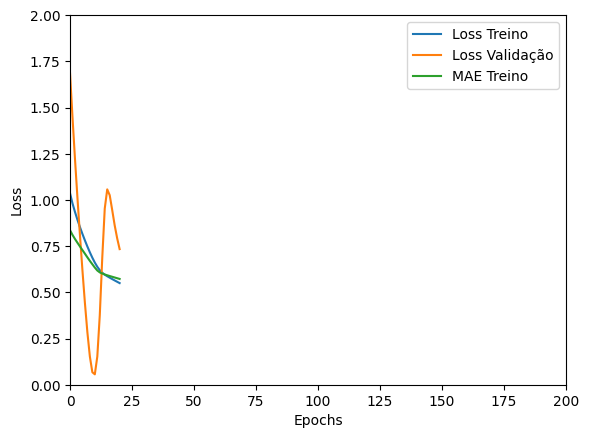

Tempo de treino: 0.08378986517588298 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25010448694229126 , MAE = 0.3806484639644623'

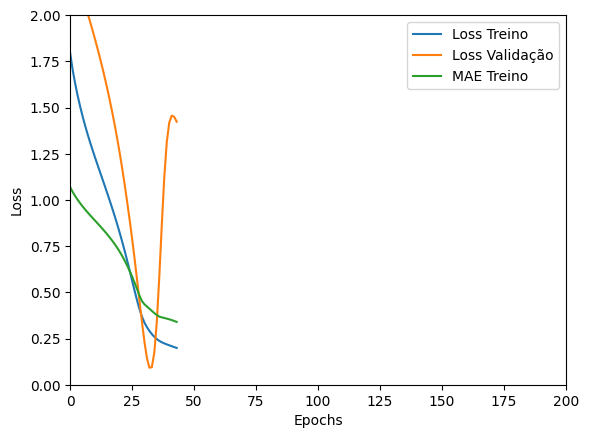

Tempo de treino: 0.08818561236063639 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21655383706092834 , MAE = 0.3563041388988495'

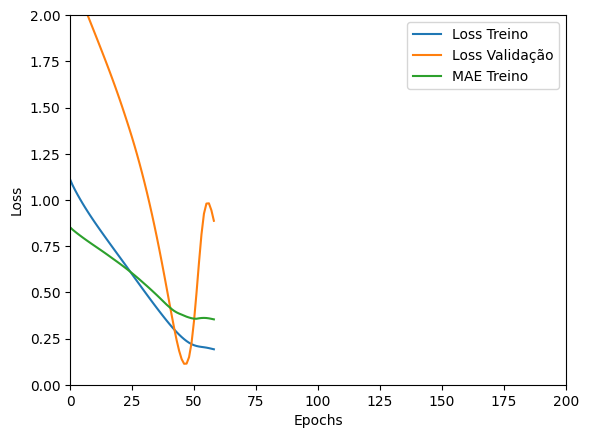

Tempo de treino: 0.13773203293482464 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3227575123310089 , MAE = 0.4131627380847931'

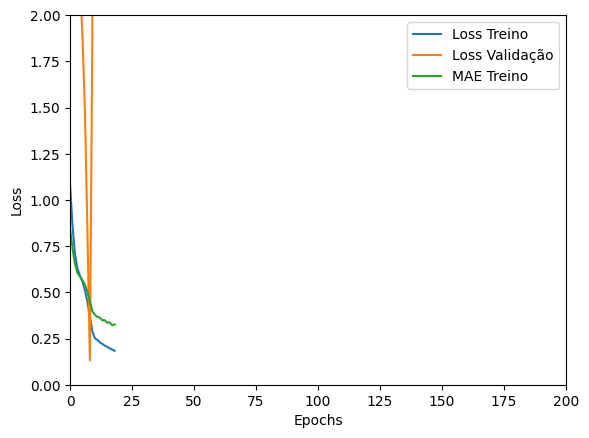

Tempo de treino: 0.13351137638092042 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21399299800395966 , MAE = 0.33308279514312744'

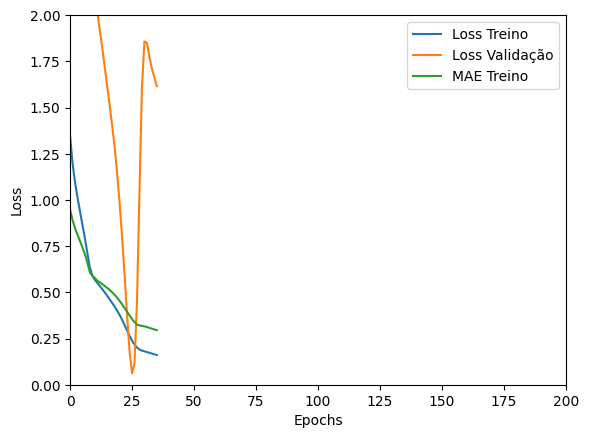

Tempo de treino: 0.11438932021458943 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2339152991771698 , MAE = 0.3624846339225769'

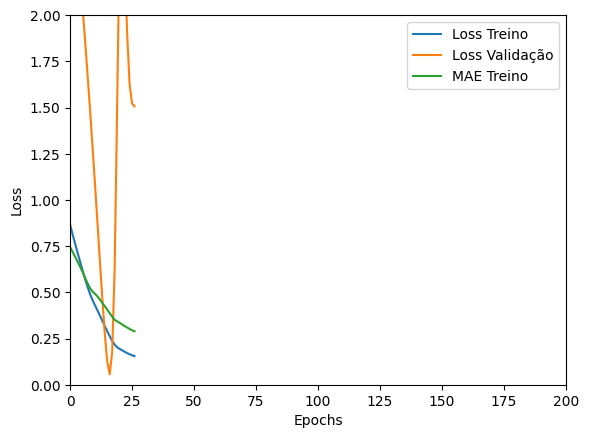

Tempo de treino: 0.1254837393760681 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4965023100376129 , MAE = 0.5429506897926331'

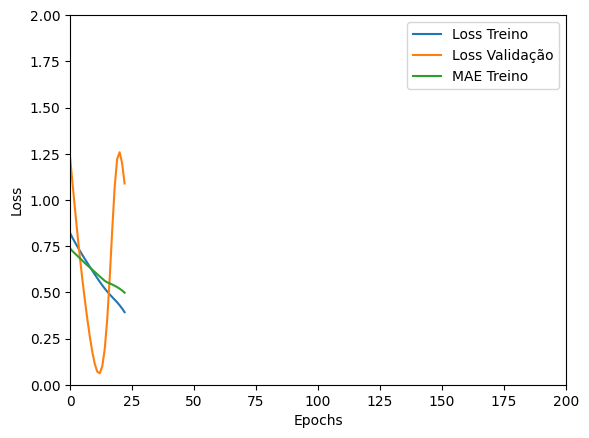

Tempo de treino: 0.07406628926595052 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20423956215381622 , MAE = 0.3349386155605316'

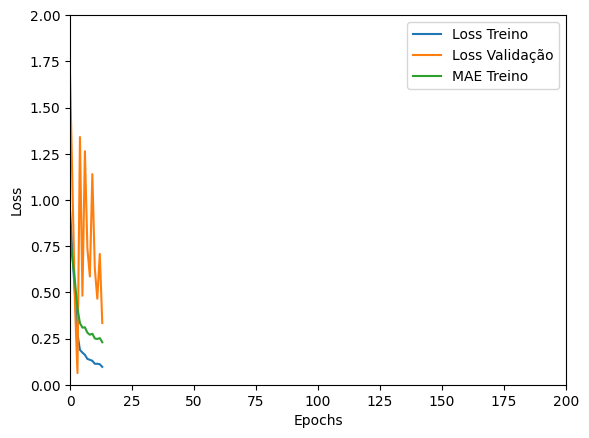

Tempo de treino: 0.09838054180145264 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24027323722839355 , MAE = 0.35844096541404724'

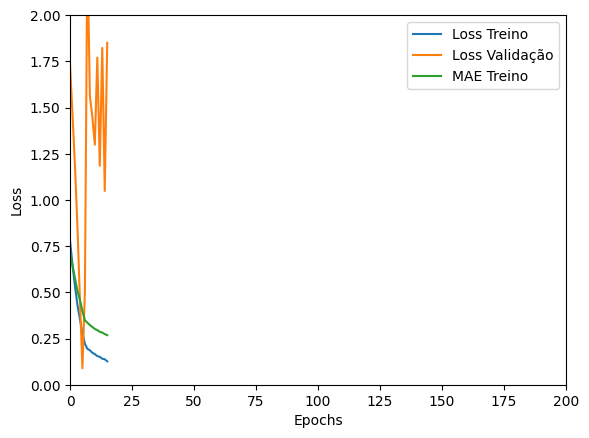

Tempo de treino: 0.0803972323735555 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23904840648174286 , MAE = 0.3746882379055023'

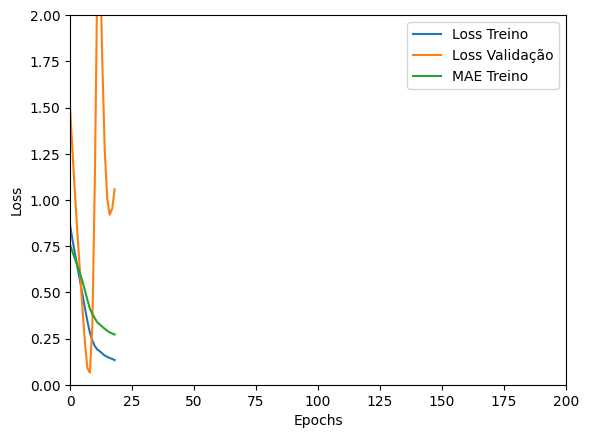

Tempo de treino: 0.0787904699643453 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21021372079849243 , MAE = 0.3261895477771759'

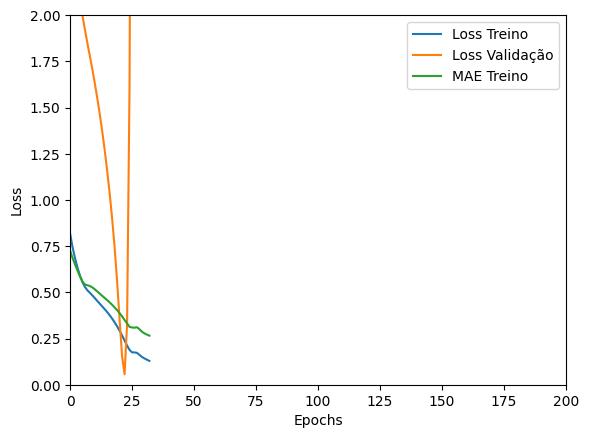

Tempo de treino: 0.14112100998560587 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3727293312549591 , MAE = 0.47055384516716003'

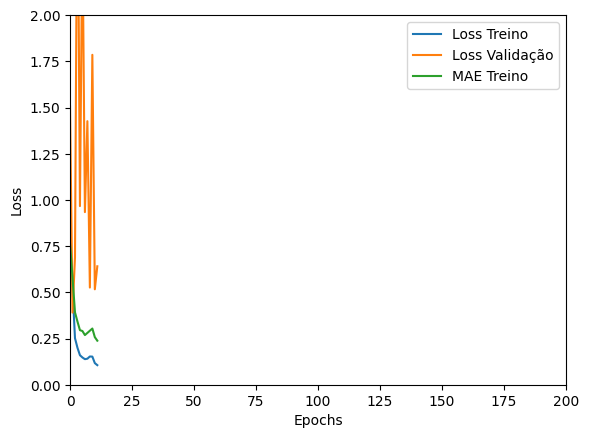

Tempo de treino: 0.10277649958928427 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=8

<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2932373583316803 , MAE = 0.39788657426834106'

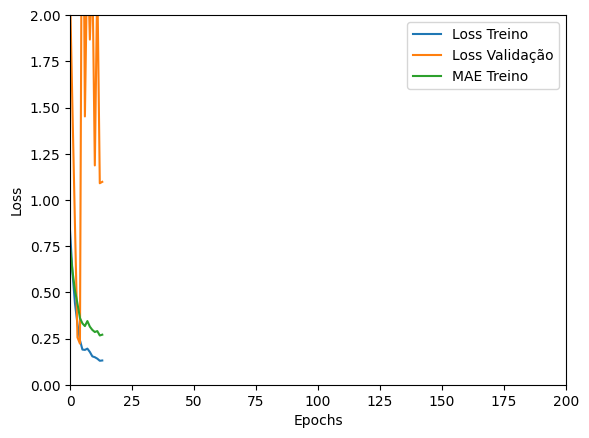

Tempo de treino: 0.08913896083831788 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21255218982696533 , MAE = 0.33210259675979614'

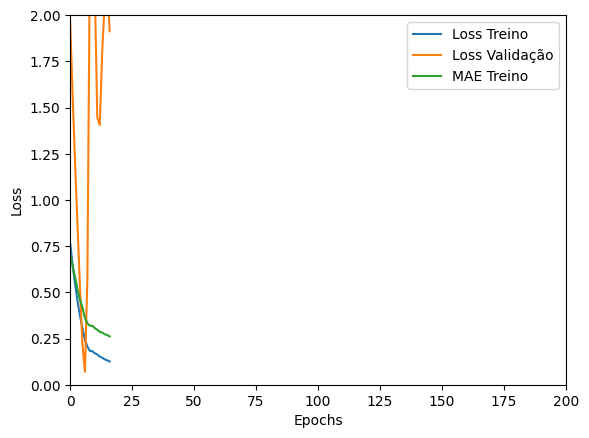

Tempo de treino: 0.07081744273503622 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28905558586120605 , MAE = 0.4129972755908966'

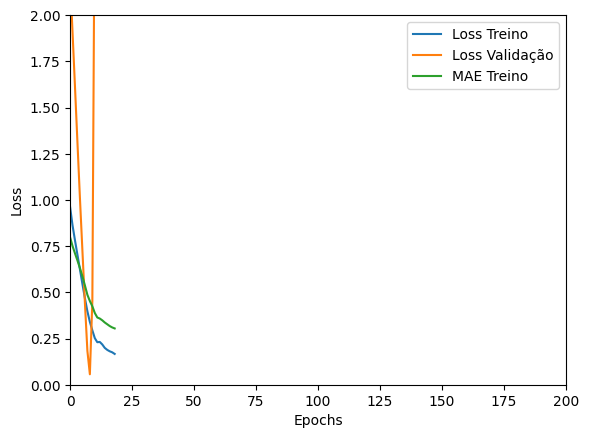

Tempo de treino: 0.0891242782274882 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=12, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14240595698356628 , MAE = 0.2770257592201233'

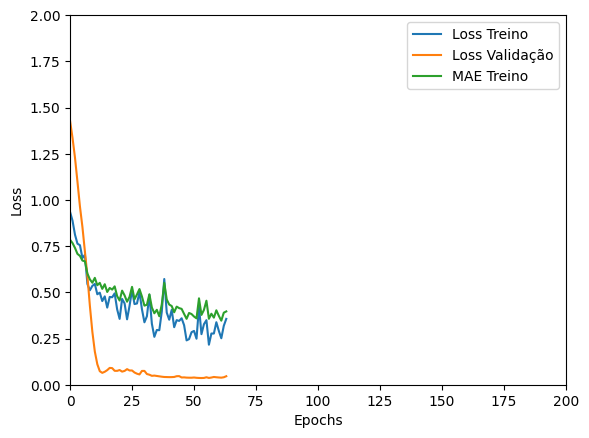

Tempo de treino: 0.21648582617441814 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6947800517082214 , MAE = 0.6540916562080383'

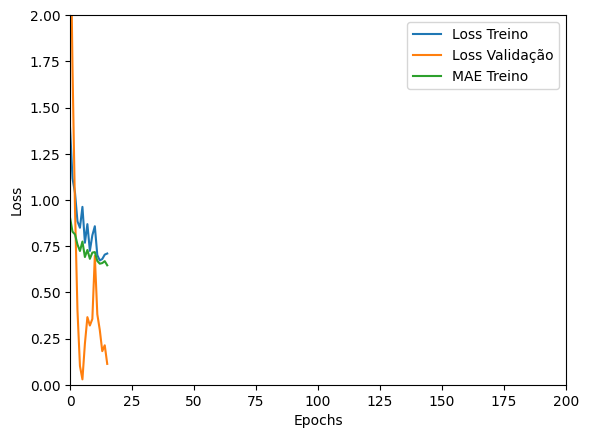

Tempo de treino: 0.0684410015741984 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.46338891983032227 , MAE = 0.5169224739074707'

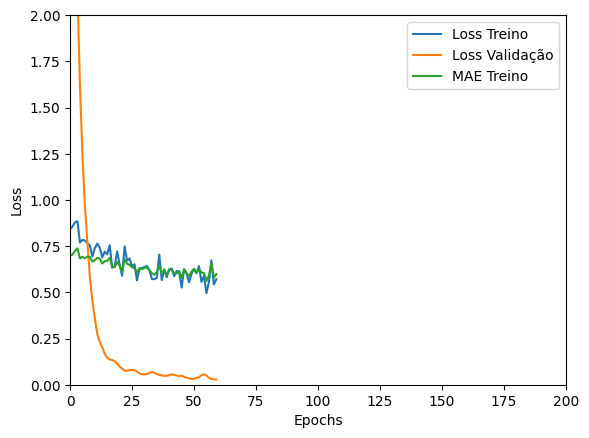

Tempo de treino: 0.12375732660293579 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.48010435700416565 , MAE = 0.49128589034080505'

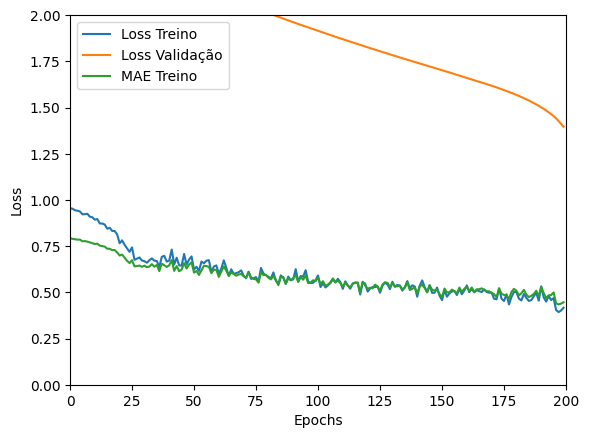

Tempo de treino: 0.3350277821222941 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3494254946708679 , MAE = 0.4676578640937805'

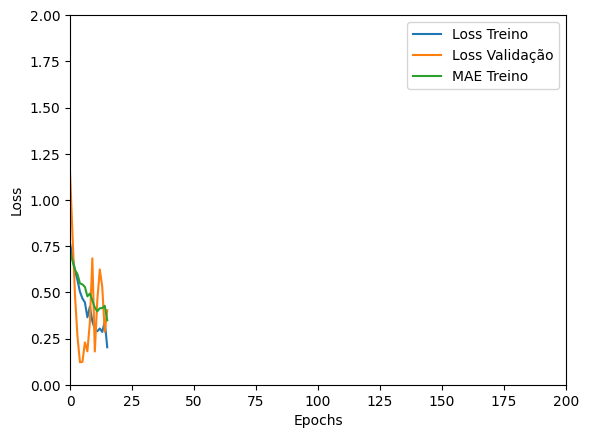

Tempo de treino: 0.13643548091252644 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2535174787044525 , MAE = 0.3880937695503235'

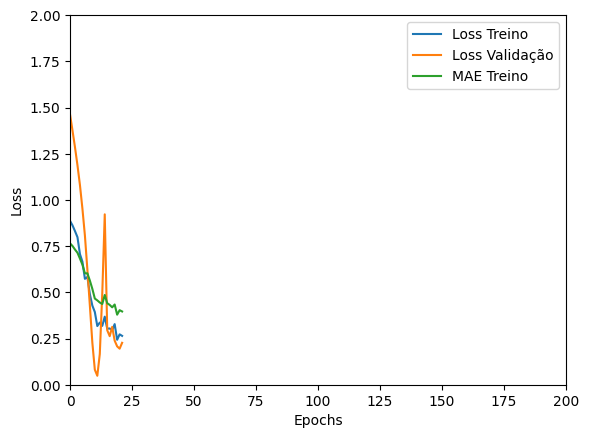

Tempo de treino: 0.08540156284968058 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27870962023735046 , MAE = 0.39907366037368774'

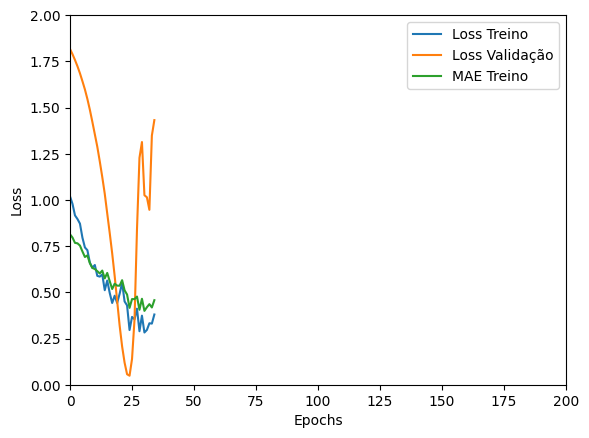

Tempo de treino: 0.10111627181371054 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35054710507392883 , MAE = 0.4445754885673523'

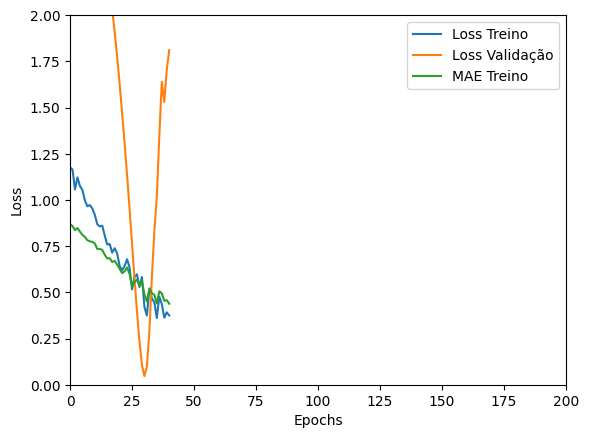

Tempo de treino: 0.09595890839894612 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2392999678850174 , MAE = 0.36054134368896484'

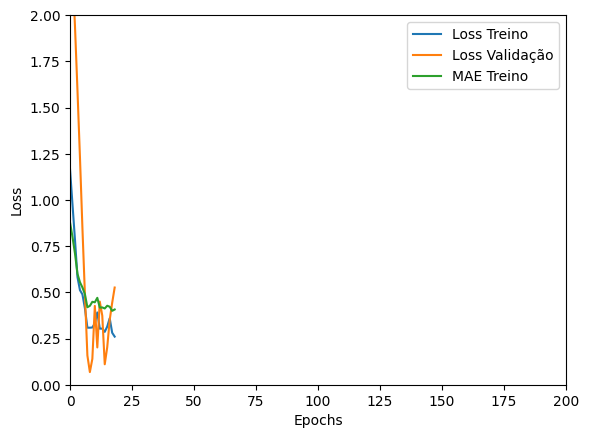

Tempo de treino: 0.10709689458211263 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22707077860832214 , MAE = 0.34086260199546814'

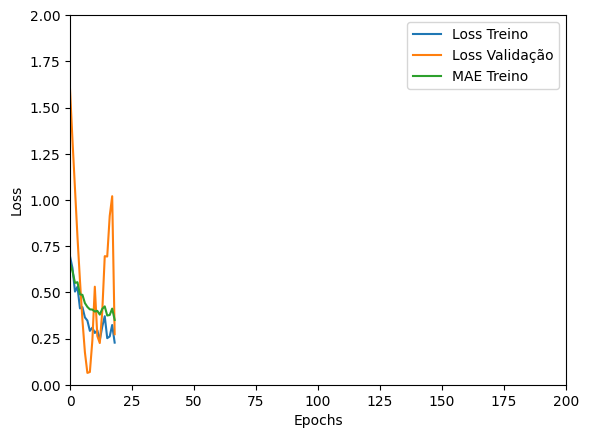

Tempo de treino: 0.07929044961929321 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.320700079202652 , MAE = 0.4258038103580475'

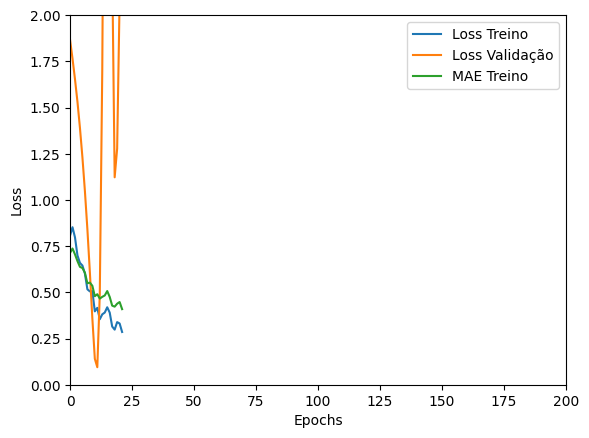

Tempo de treino: 0.08276565869649251 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2551296353340149 , MAE = 0.38146838545799255'

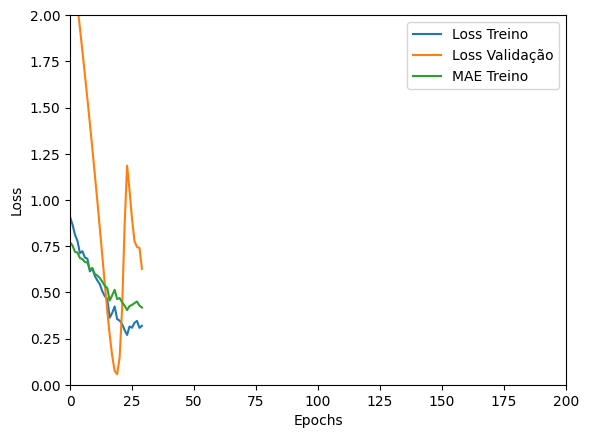

Tempo de treino: 0.1253445545832316 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37530824542045593 , MAE = 0.4765869379043579'

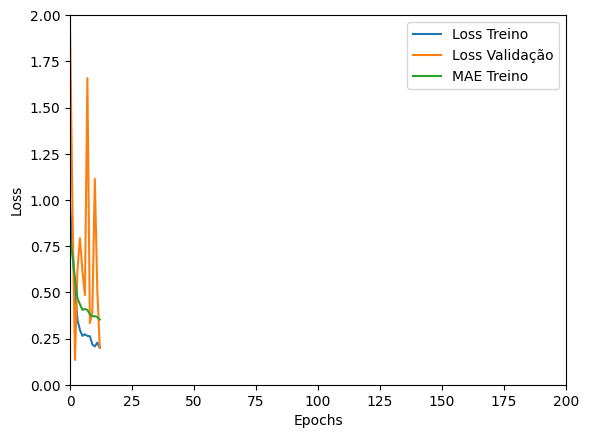

Tempo de treino: 0.1300032416979472 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3401375114917755 , MAE = 0.43688318133354187'

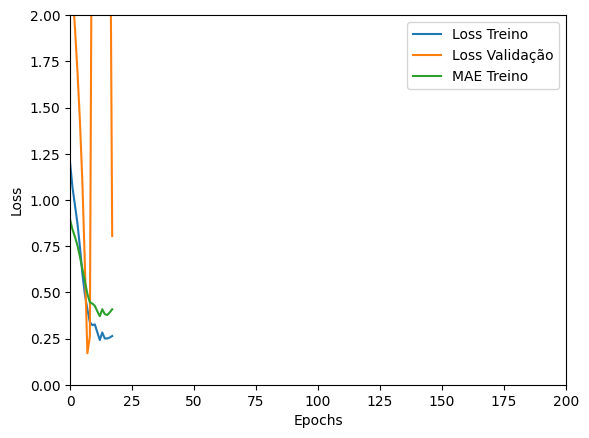

Tempo de treino: 0.08412230809529622 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24371777474880219 , MAE = 0.3677815794944763'

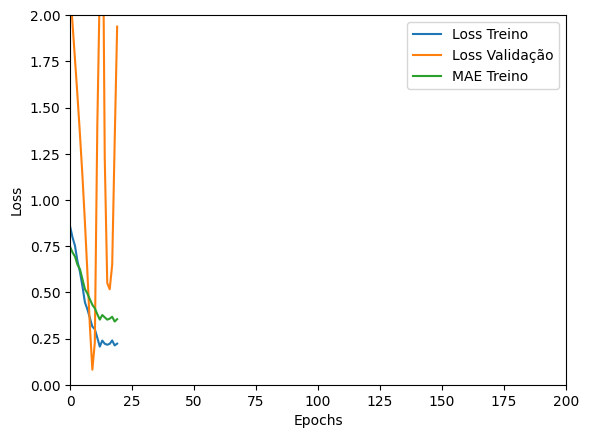

Tempo de treino: 0.08196279605229696 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5841146111488342 , MAE = 0.5931124091148376'

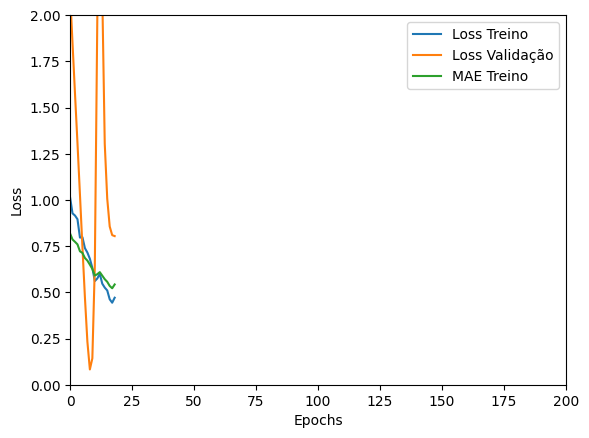

Tempo de treino: 0.08779944976170857 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28245142102241516 , MAE = 0.39409154653549194'

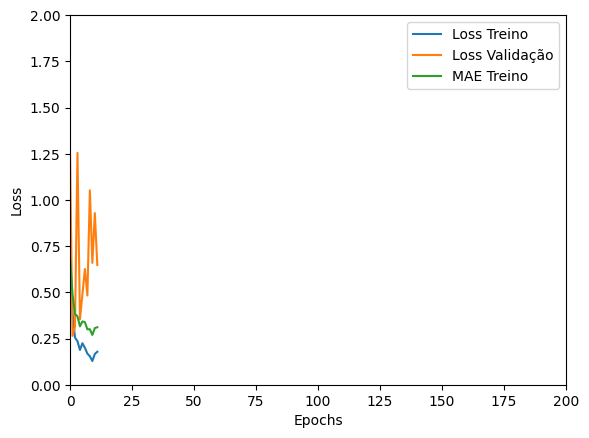

Tempo de treino: 0.08125659624735514 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09288116544485092 , MAE = 0.23113054037094116'

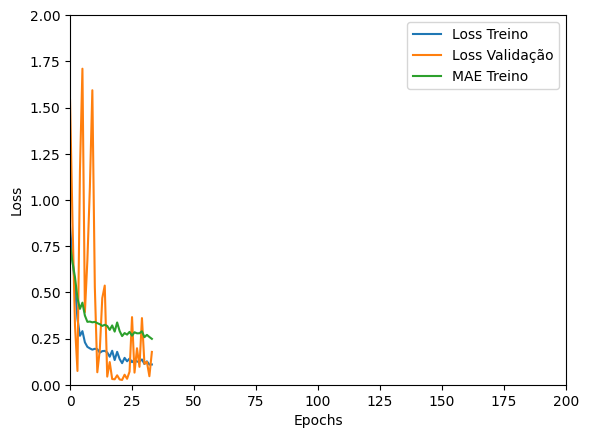

Tempo de treino: 0.13072187105814617 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24263915419578552 , MAE = 0.3558090627193451'

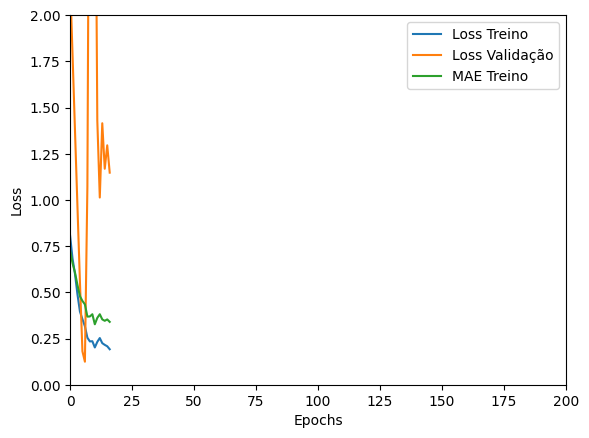

Tempo de treino: 0.12397396961847941 minutos


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v3 , timesteps=12, units=64, batch=32


'TRAINING set. Loss = 0.2428545504808426 , MAE = 0.36822378635406494'

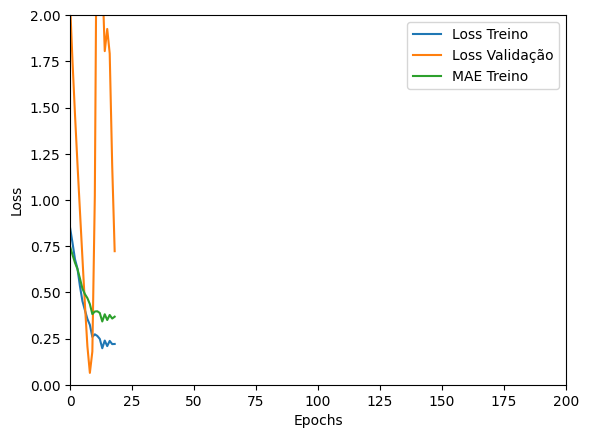

Tempo de treino: 0.096687912940979 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com GRU_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05792336165904999 , MAE = 0.18288347125053406'

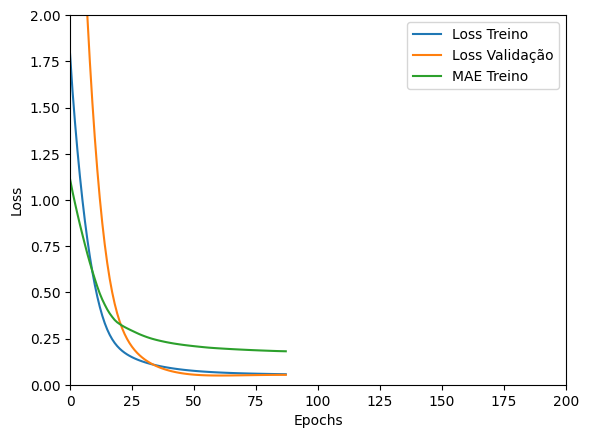

Tempo de treino: 0.3939610997835795 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.049460381269454956 , MAE = 0.17537204921245575'

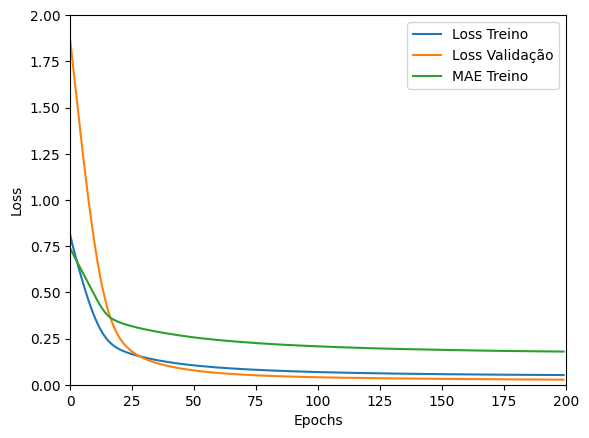

Tempo de treino: 0.732078484694163 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05253316089510918 , MAE = 0.18089699745178223'

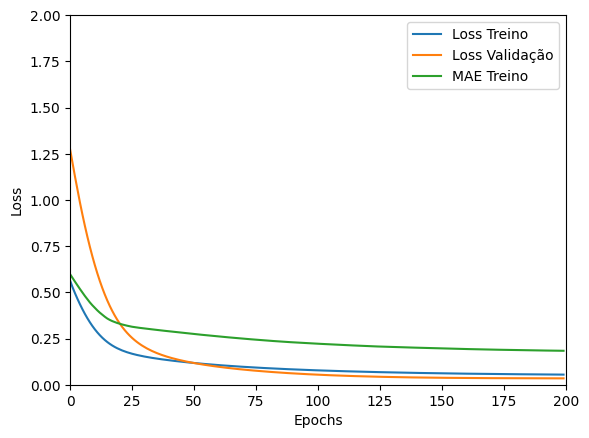

Tempo de treino: 0.39333902994791664 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08002211153507233 , MAE = 0.23076212406158447'

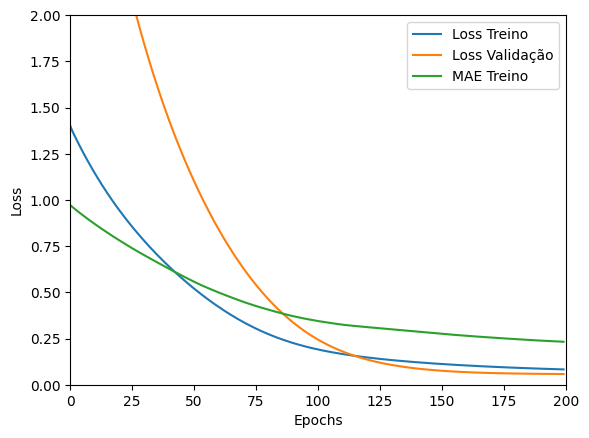

Tempo de treino: 0.2974575638771057 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04141756147146225 , MAE = 0.15698228776454926'

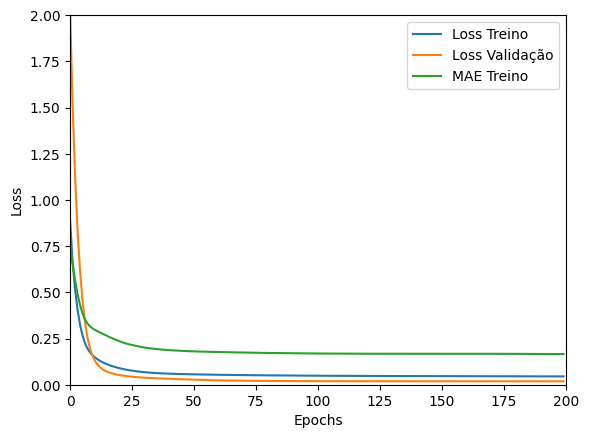

Tempo de treino: 0.7189902226130168 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04567781463265419 , MAE = 0.16441303491592407'

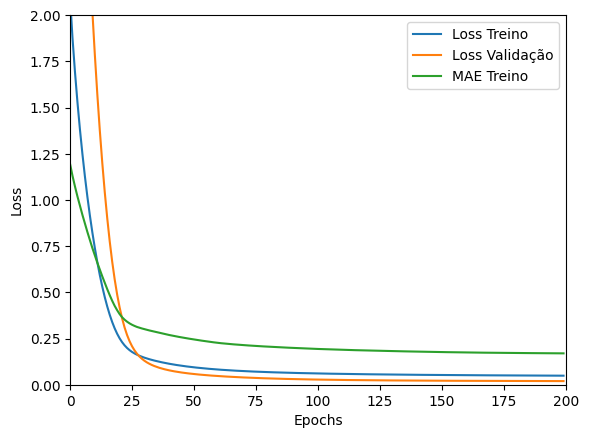

Tempo de treino: 0.7376395901044209 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04493137449026108 , MAE = 0.1645413041114807'

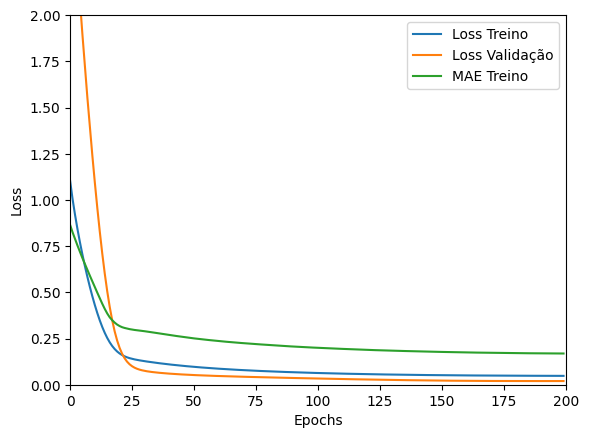

Tempo de treino: 0.3908754547437032 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05859881639480591 , MAE = 0.18625885248184204'

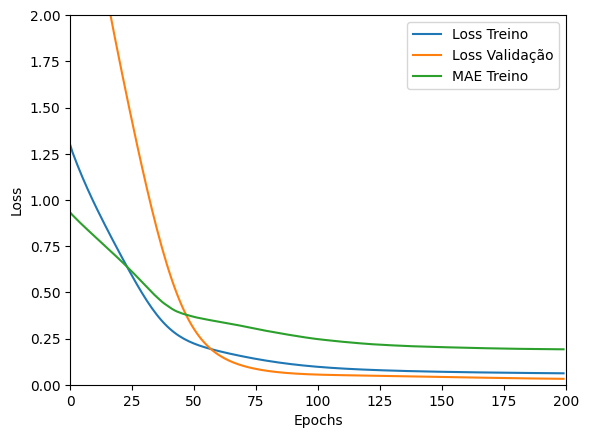

Tempo de treino: 0.3953965981801351 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04279037564992905 , MAE = 0.15847234427928925'

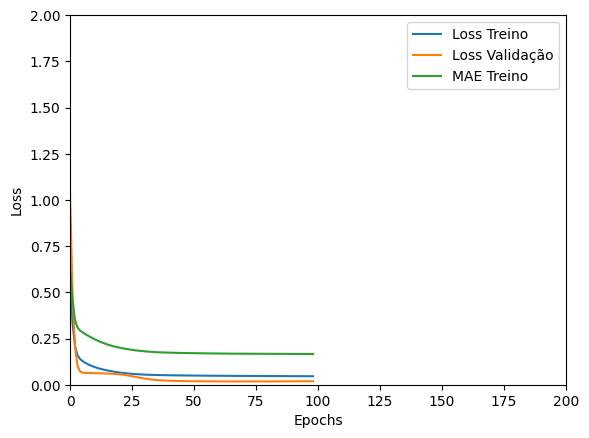

Tempo de treino: 0.38744812409083046 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042654626071453094 , MAE = 0.15802088379859924'

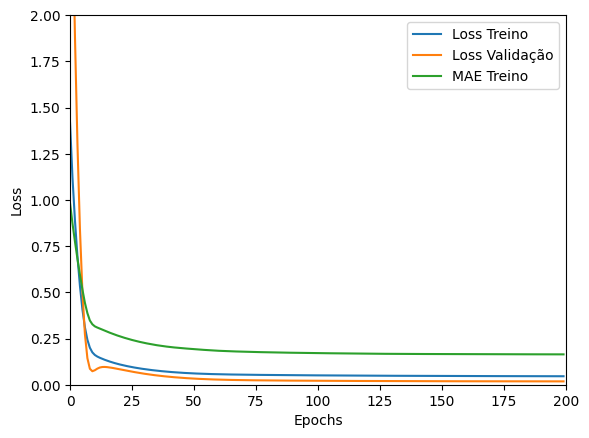

Tempo de treino: 0.5167851646741232 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04434337839484215 , MAE = 0.161775141954422'

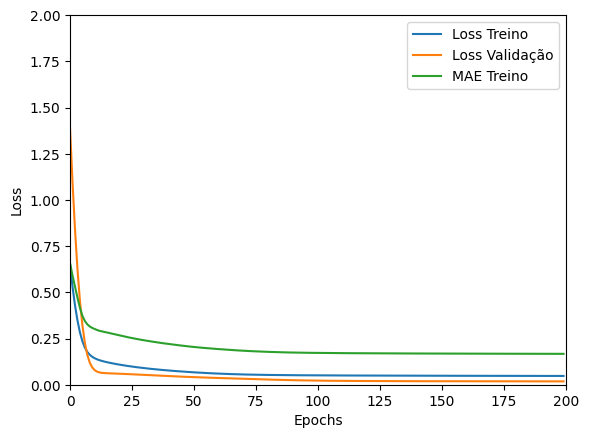

Tempo de treino: 0.33133370876312257 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18984755873680115 , MAE = 0.34499847888946533'

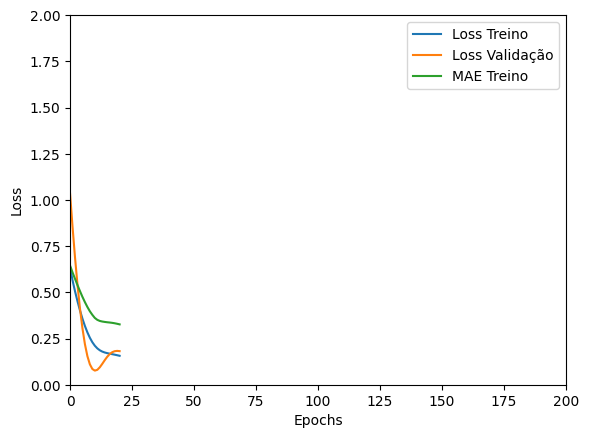

Tempo de treino: 0.09882334073384604 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.040921635925769806 , MAE = 0.15373775362968445'

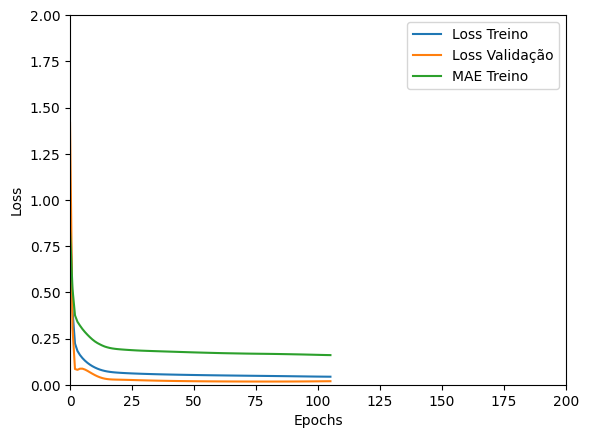

Tempo de treino: 0.3923539638519287 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04312942177057266 , MAE = 0.15864263474941254'

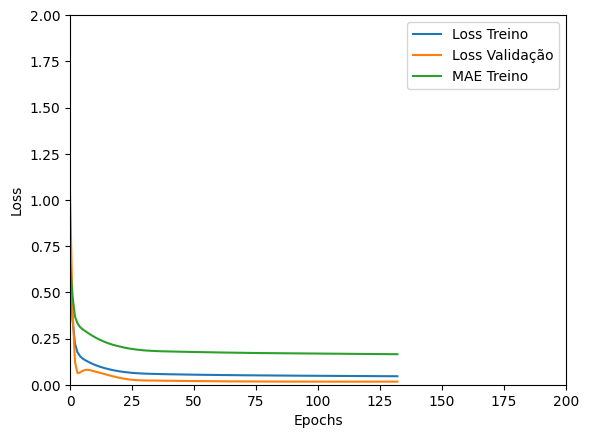

Tempo de treino: 0.296765124797821 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.156512051820755 , MAE = 0.30726099014282227'

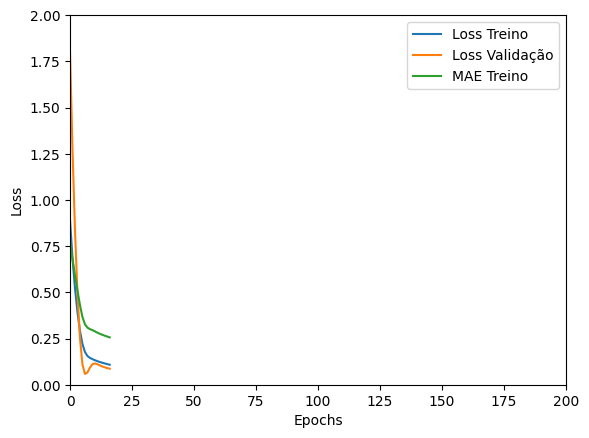

Tempo de treino: 0.16957786480585735 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1458522528409958 , MAE = 0.30297785997390747'

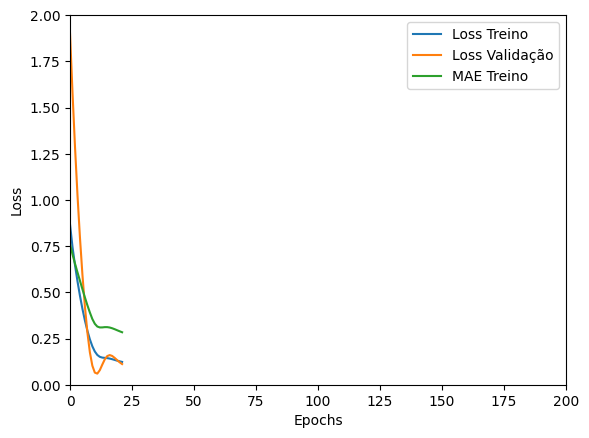

Tempo de treino: 0.11644349892934164 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-5885c10707a8>:32: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


In [ ]:
all_results = pd.DataFrame(columns=['model_type','model',feature,'unit','optimizer', 'batch_size', 'timesteps', 'loss','mae'])

# hyper parâmetros testados
model_hyperparams = ['LSTM_v1', 'LSTM_v2', 'LSTM_v3', 'GRU_v1']
timesteps_hyperparams = [6, 12, 24, 36]
units_hyperparams = [4, 8, 16, 32, 64]
batch_hyperparams = [4, 8, 16, 32]

epochs = 200
times_exec = 3

for times in range(times_exec):
  for timesteps in timesteps_hyperparams:
    for model_type_str in model_hyperparams:
      if model_type_str[:3] in ['LST', 'GRU']:
        scaler, X_train, X_test, y_train, y_test = preprocess(df, feature, timesteps, len(data_teste))
        print('X_train.shape, X_test.shape, y_train.shape, y_test.shape = ', X_train.shape, X_test.shape, y_train.shape, y_test.shape)
      for optimizer in ['Adam']:
        for unit in units_hyperparams:
          for batch_size in batch_hyperparams:

            inittime = time()
            print(f'Treinando com {model_type_str} , timesteps={timesteps}, units={unit}, batch={batch_size}')
            m, h = model_type(model_type_str, unit=unit, optimizer=optimizer, timesteps=timesteps, X=X_train, y=y_train, epochs=epochs, batch_size=batch_size)
            endtime = time()
            print(f'Tempo de treino: {(endtime-inittime)/60} minutos' )
            score = m.evaluate(X_test, y_test, batch_size=batch_size, verbose=0)
            all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,
                                              'optimizer':optimizer, 'batch_size':batch_size, 'timesteps':timesteps,
                                              'loss':score[0], 'mae':score[1]}, ignore_index=True)
            del m, h

### Desempenho ordenado por menor MAE na base de validação
É considerada a melhor média, em termos de MAE, das três execuções

In [51]:
print(len(all_results))
mean_mae = all_results.groupby(['model_type', 'unit', 'batch_size', 'optimizer', 'timesteps'])['mae'].mean().reset_index()
mean_mae.sort_values(by=['mae'])
print(len(mean_mae))
mean_mae

960
320


,model_type,unit,batch_size,optimizer,timesteps,mae
0,GRU_v1,4,4,Adam,6,0.148569
1,GRU_v1,4,4,Adam,12,0.172029
2,GRU_v1,4,4,Adam,24,0.158598
3,GRU_v1,4,4,Adam,36,0.203465
4,GRU_v1,4,8,Adam,6,0.177846
...,...,...,...,...,...,...
315,LSTM_v3,64,16,Adam,36,1.869609
316,LSTM_v3,64,32,Adam,6,0.477906
317,LSTM_v3,64,32,Adam,12,0.574903
318,LSTM_v3,64,32,Adam,24,0.791563


## 5) Avaliação na base de testes


Seleção dos melhores modelos de cada arquitetura


In [56]:
best_models_arr = []

for model_str in model_hyperparams:
  best_model = mean_mae[mean_mae['model_type'] == model_str].sort_values('mae', ascending=True).head(1)
  best_models_arr.append(best_model)

best_models_df = pd.concat(best_models_arr)
del best_models_arr
print("Melhores modelos")
dsp.display(best_models_df.sort_values('mae', ascending=True))



Melhores modelos


,model_type,unit,batch_size,optimizer,timesteps,mae
291,LSTM_v3,32,4,Adam,36,0.131139
33,GRU_v1,16,4,Adam,12,0.133029
208,LSTM_v2,32,4,Adam,6,0.285957
145,LSTM_v1,64,4,Adam,12,0.352251


### Avaliação últimos 12 meses - usando dados reais
Construção dos dados de predição, também usados no Boxplot e Swarmplot

Aqui treinamos novamente o modelo para aferição dos resultados anteriores e comparação com os 12 últimos meses da série

'TRAINING set. Loss = 0.08543854206800461 , MAE = 0.22779956459999084'

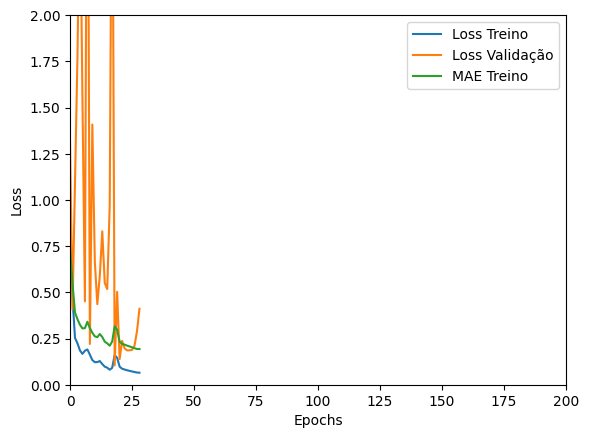

1/1 [==============================] - 0s 453ms/step


'TRAINING set. Loss = 0.06255058199167252 , MAE = 0.20253801345825195'

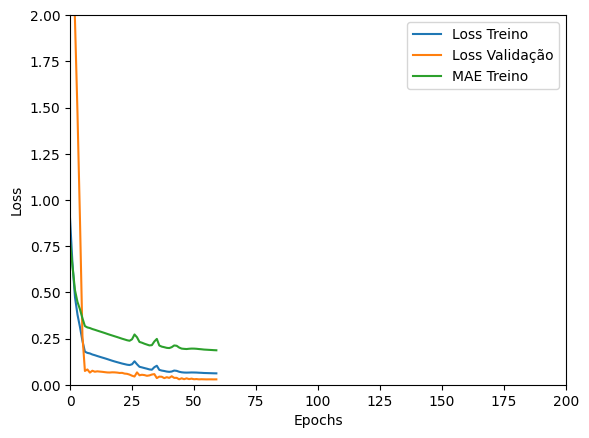

1/1 [==============================] - 0s 222ms/step


'TRAINING set. Loss = 0.13232572376728058 , MAE = 0.27165549993515015'

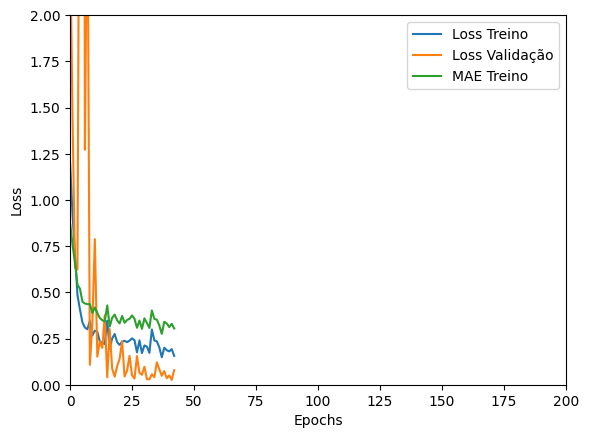

1/1 [==============================] - 0s 192ms/step


'TRAINING set. Loss = 0.04312390089035034 , MAE = 0.15886609256267548'

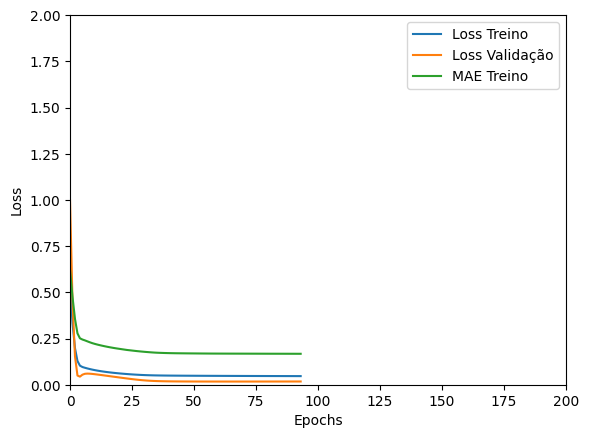

1/1 [==============================] - 0s 382ms/step
     LSTM_v1  LSTM_v1_Real   LSTM_v2  LSTM_v2_Real   LSTM_v3  LSTM_v3_Real  \
0   2.796687          2.83  2.725795          2.83  2.860566          2.83   
1   2.830053          2.85  2.784471          2.85  2.941680          2.85   
2   2.843288          2.97  2.818099          2.97  3.009813          2.97   
3   2.945214          3.01  2.909977          3.01  3.123349          3.01   
4   3.006601          3.01  2.964181          3.01  3.233105          3.01   
5   3.028849          3.18  2.982904          3.18  3.314822          3.18   
6   3.131816          3.31  3.105941          3.31  3.481030          3.31   
7   3.237720          3.29  3.234443          3.29  3.702702          3.29   
8   3.267981          3.48  3.258095          3.48  3.877238          3.48   
9   3.373188          3.58  3.401330          3.58  4.145170          3.58   
10  3.468916          3.56  3.515990          3.56  4.442019          3.56   
11  3.50438

In [81]:
aval = pd.DataFrame()

for index, setup in best_models_df.iterrows():
  scaler, X_train, X_test, y_train, y_test = preprocess(df, 'valor', setup['timesteps'], len(data_teste))
  mod, _ = model_type(setup['model_type'], setup['unit'], setup['optimizer'], setup['timesteps'], X_train, y_train,
                      epochs=epochs, batch_size=setup['batch_size'], train=True)
  best_models_df['model'] = mod
  y_pred = mod.predict(X_test)
  y_pred = scaler.inverse_transform(y_pred)
  y_real = scaler.inverse_transform(y_test)

  aval[f'{setup["model_type"]}'] = y_pred[:,0]
  aval[f'{setup["model_type"]}_Real'] = y_real[:,0]

print(aval)

#### Boxplot e Swarmplot

In [78]:
def box_swarm_plots(aval):
  fig, ax = plt.subplots(figsize=(12, 8), nrows=1, ncols=1)
  sns.boxplot(data=aval, dodge=False, palette='Blues', ax=ax)
  sns.swarmplot(data=aval, color='.25', alpha=0.8, ax=ax)

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:.25'` for same effect.
  warnings.warn(msg, FutureWarning)


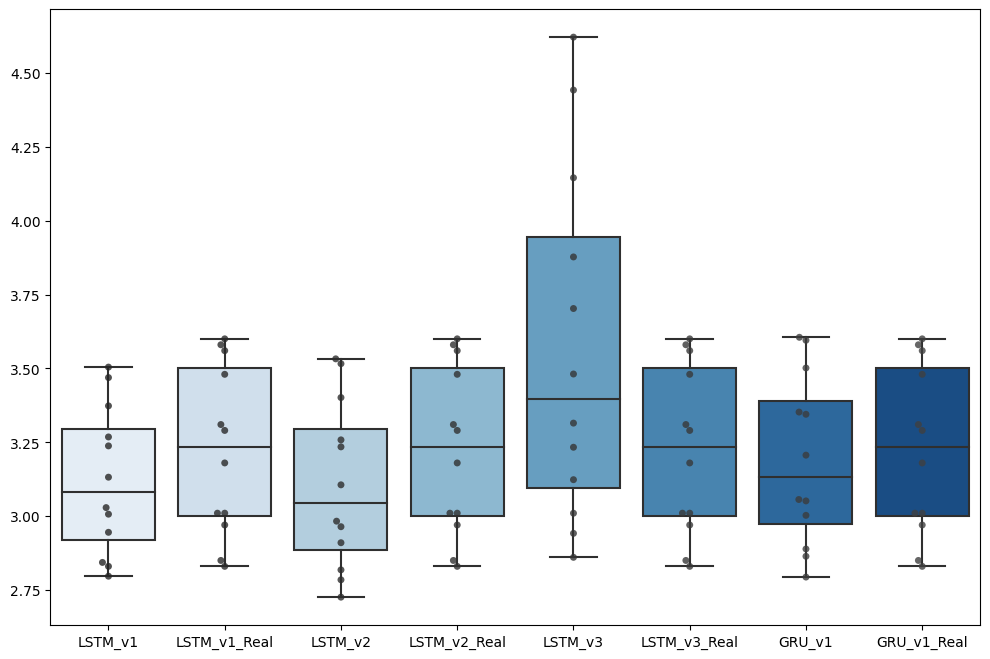

In [82]:
box_swarm_plots(aval)

#### Gráfico Linhas Real x Previsto
Figura com valor real x previsto dos últimos 12 meses da série

In [136]:
def plot_aval(aval):
  min_val, max_val = aval.min().min(), aval.max().max()
  fig, ax = plt.subplots(figsize=(30, 12), nrows=1, ncols=len(best_models_df))
  i = 0
  for model_str in best_models_df['model_type']:
    filt = aval.filter(regex=model_str)
    sns.lineplot(data=filt, palette='inferno', ax=ax[i], hue_order=filt.columns)
    ax[i].set_xlabel('Meses')
    ax[i].set_title(model_str)
    ax[i].set_ylim(min_val, max_val)
    i += 1


2.725794553756714 4.621204853057861


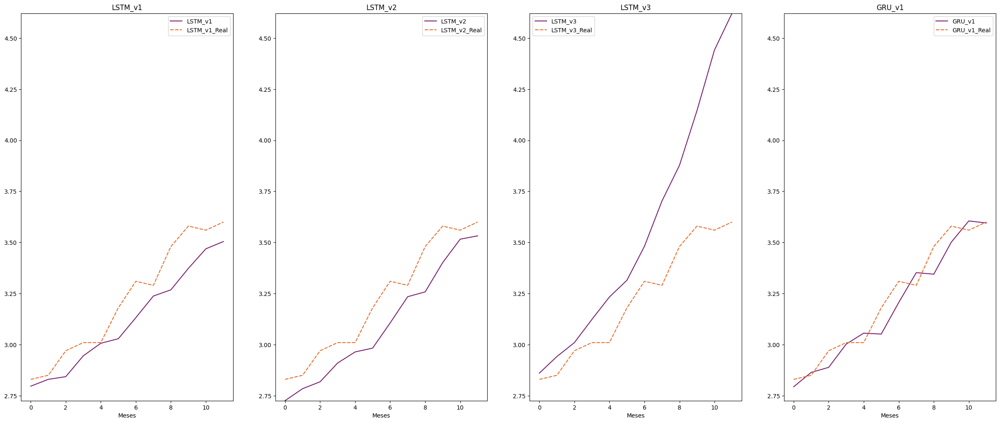

In [137]:
plot_aval(aval)

### Avaliação últimos 12 meses - usando dados previstos
Aqui construímos novamente os dados de predição, também usados no Boxplot e Swarmplot

Mas desta vez usamos a técnica de prever no futuro, adicionando os dados previstos ao final da série e repetimos o processo 12 vezes. Este passo é necessário para identificar se o processo de prever o fututo está consistente. Ainda estamos comparando com a base de testes

Usou-se ruído nas saídas para simular curvas mais realísticas. A análise empírica deste método revelou predições superiores.

---



In [121]:
aval_pre_fut = pd.DataFrame()

future_size = 12
sharpness = 0.2
for index, setup in best_models_df.iterrows():

  mod = setup['model']
  scaler, X_train, X_test, y_train, y_test = preprocess(df, 'valor', timesteps, future_size)

  initial_sequence = X_test[0]

  # Predict future values iteratively
  predicted_values = []
  for _ in range(future_size):
    # Predict the next step
    next_step = mod.predict(np.array([initial_sequence]), verbose=False)
    # add randomization to model do not converge as a curve
    if sharpness is not None:
      next_step[0, 0] = next_step[0, 0] + next_step[0, 0]*uniform(-sharpness, sharpness)
    # Append the predicted value
    predicted_values.append(next_step[0, 0])
    # Update the initial sequence by removing the oldest value and appending the predicted value
    initial_sequence = np.roll(initial_sequence, shift=-1, axis=0)
    initial_sequence[-1] = next_step[0, 0]


  y_pred = scaler.inverse_transform(np.array(predicted_values).reshape(-1, 1))
  y_real = scaler.inverse_transform(y_test)
  aval_pre_fut[f'{setup["model_type"]}'] = y_pred[:,0]
  aval_pre_fut[f'{setup["model_type"]}_Real'] = y_real[:,0]


#### Boxplot e Swarmplot

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:.25'` for same effect.
  warnings.warn(msg, FutureWarning)


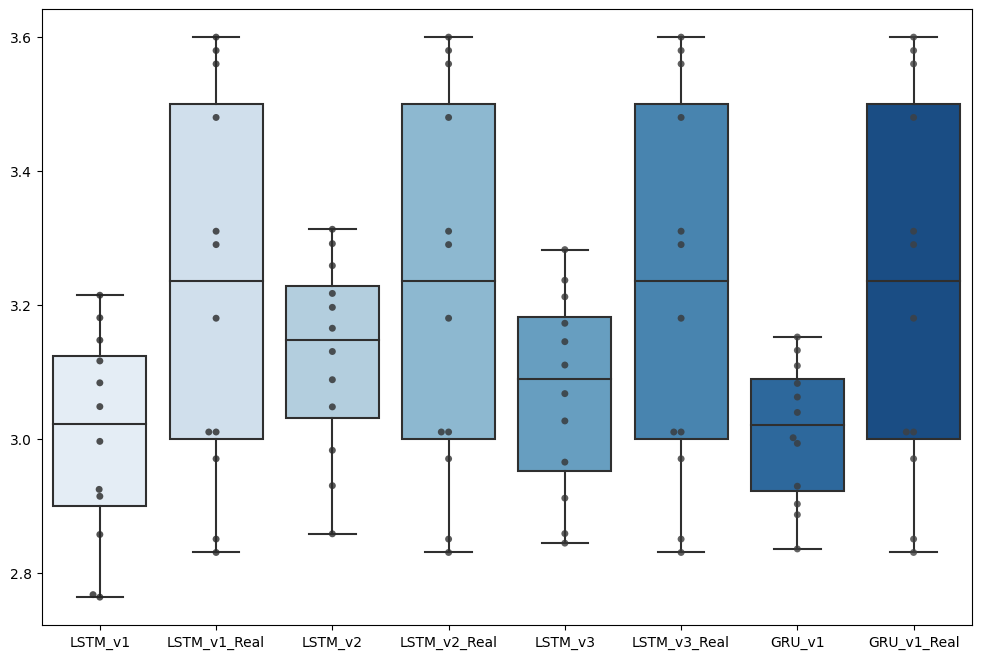

In [122]:
box_swarm_plots(aval_pre_fut)

#### Gráfico Linhas Real x Previsto
Figura com valor real x previsto (iterativo) dos últimos 12 meses da série

2.7632410526275635 3.6


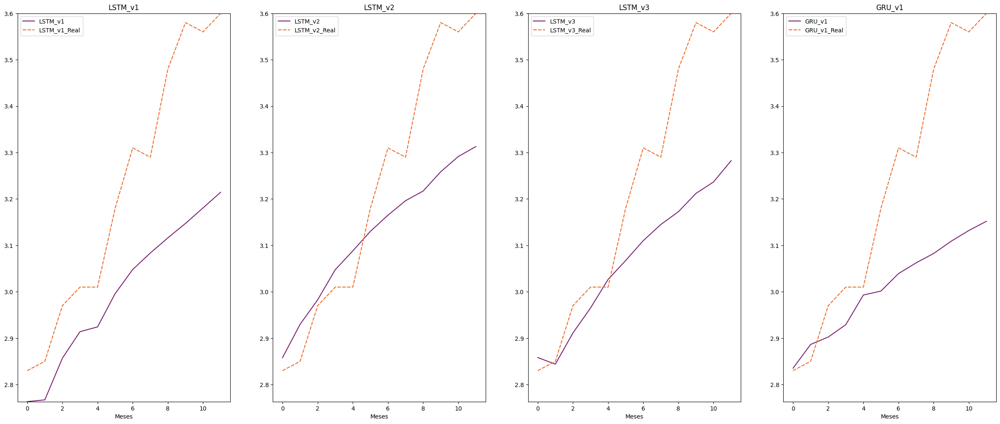

In [138]:
plot_aval(aval_pre_fut)

## 6) Avaliação futuros 12 meses
Aqui construímos novamente os dados de predição, também usados no Boxplot e Swarmplot

Desta, o treinamento do modelo é refeito com todos os dados. Mais uma vez usamos a técnica de prever no futuro, adicionando os dados previstos ao final da série e repetimos o processo 12 vezes.


---



Treinando com LSTM_v1, unit=64, opt=Adam,     timesteps=12, batch=4


'TRAINING set. Loss = 0.057126760482788086 , MAE = 0.17981228232383728'

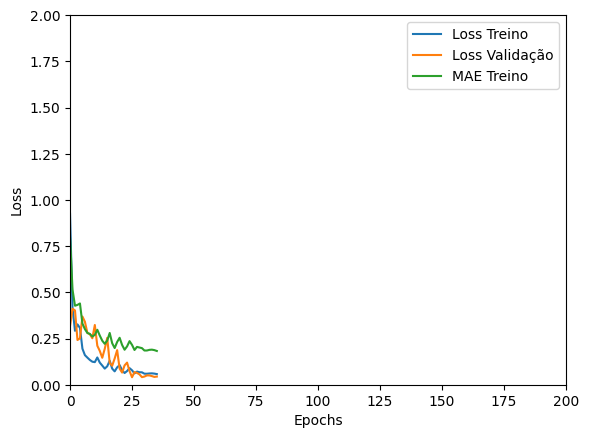

Treinando com LSTM_v2, unit=32, opt=Adam,     timesteps=6, batch=4


'TRAINING set. Loss = 0.20959806442260742 , MAE = 0.3487839698791504'

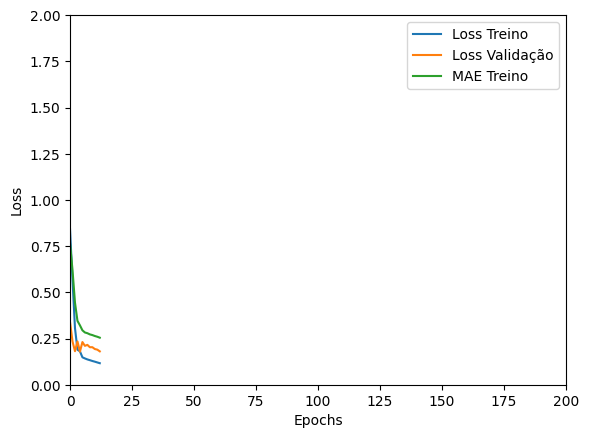

Treinando com LSTM_v3, unit=32, opt=Adam,     timesteps=36, batch=4


'TRAINING set. Loss = 0.08837602287530899 , MAE = 0.21603263914585114'

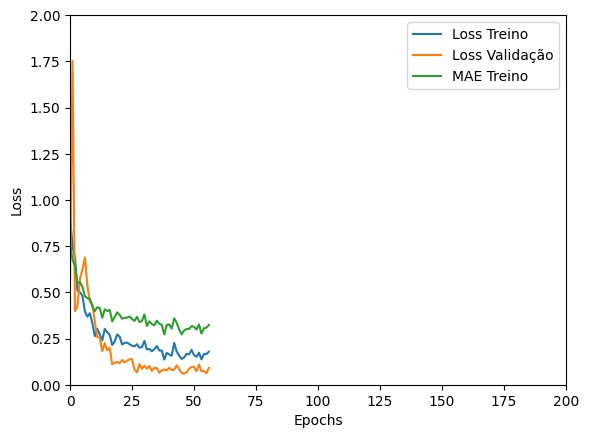

Treinando com GRU_v1, unit=16, opt=Adam,     timesteps=12, batch=4


'TRAINING set. Loss = 0.044217824935913086 , MAE = 0.15999507904052734'

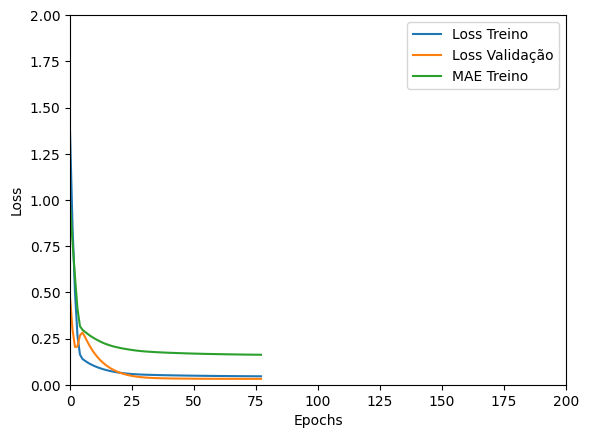

In [124]:
aval_fut = pd.DataFrame()

future_size = 12
sharpness = 0.2
for index, setup in best_models_df.iterrows():

  mod = setup['model']
  print(f'Treinando com {setup["model_type"]}, unit={setup["unit"]}, opt={setup["optimizer"]}, \
    timesteps={setup["timesteps"]}, batch={setup["batch_size"]}')
  scaler, X_train, X_test, y_train, y_test = preprocess(df, 'valor', setup['timesteps'], 0)
  mod, _ = model_type(setup['model_type'], setup['unit'], setup['optimizer'], setup['timesteps'], X_train, y_train,
                      epochs=epochs, batch_size=setup['batch_size'], train=True)

  # using last train element
  initial_sequence = X_train[-1]

  # Predict future values iteratively
  predicted_values = []
  for _ in range(future_size):
    # Predict the next step
    next_step = mod.predict(np.array([initial_sequence]), verbose=False)
    # add randomization to model do not converge as a curve
    if sharpness is not None:
      next_step[0, 0] = next_step[0, 0] + next_step[0, 0]*uniform(-sharpness, sharpness)
    # Append the predicted value
    predicted_values.append(next_step[0, 0])
    # Update the initial sequence by removing the oldest value and appending the predicted value
    initial_sequence = np.roll(initial_sequence, shift=-1, axis=0)
    initial_sequence[-1] = next_step[0, 0]


  y_pred = scaler.inverse_transform(np.array(predicted_values).reshape(-1, 1))
  aval_fut[f'{setup["model_type"]}'] = y_pred[:,0]


### Boxplot e Swarmplot

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:.25'` for same effect.
  warnings.warn(msg, FutureWarning)


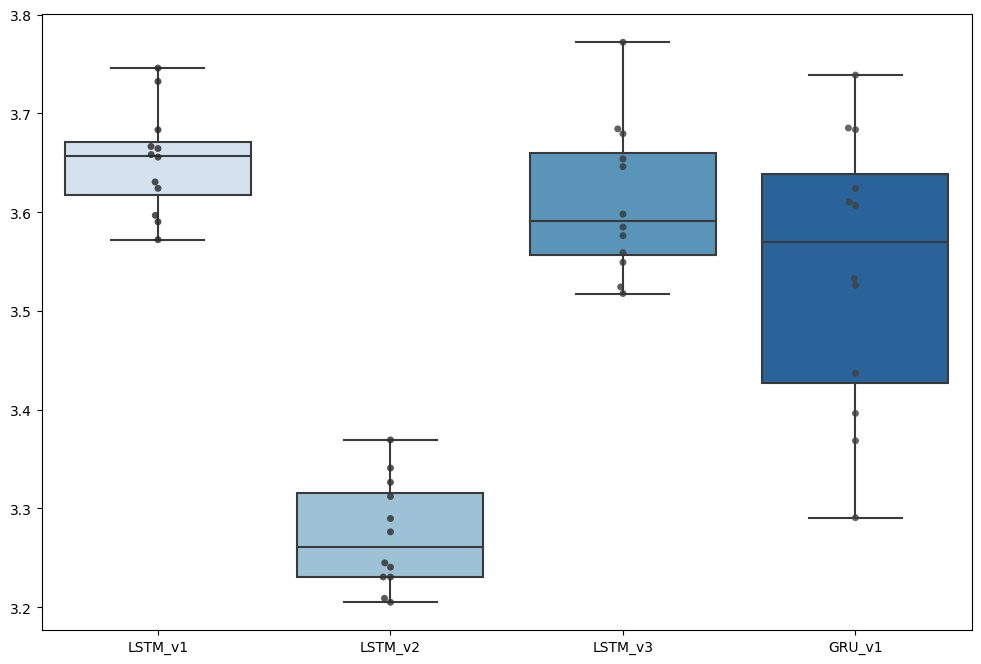

In [125]:
box_swarm_plots(aval_fut)

### Gráfico Linhas Real x Previsto
Figura com valor real x previsto (iterativo) dos últimos 12 meses da série

3.2050261 3.772042


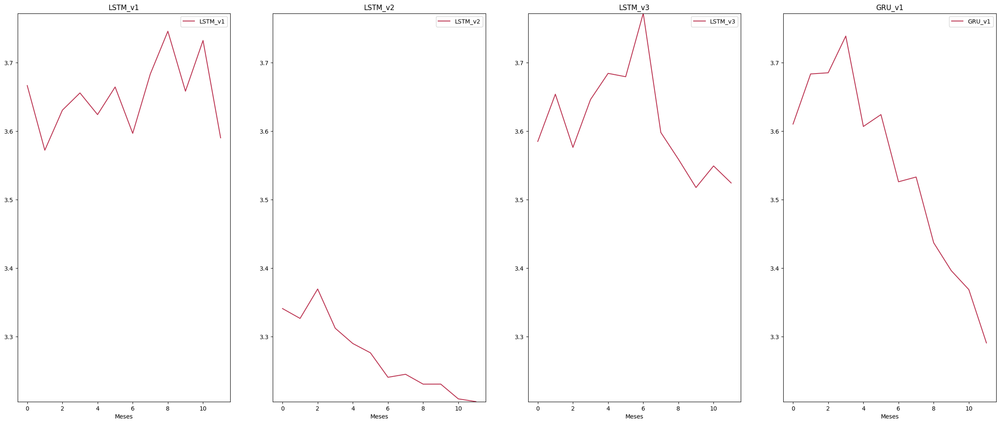

In [139]:
plot_aval(aval_fut)

# REFERÊNCIAS

[1] -  https://repositorio.utfpr.edu.br/jspui/bitstream/1/19605/1/CT_GESFIN_I_2016_07.pdf

[2] - https://repositorio.ufscar.br/bitstream/handle/ufscar/13730/Trabalho_de_Conclusao_de_Curso_Lucas_Vasco.pdf?sequence=2&isAllowed=y

[3] - https://towardsdatascience.com/lstm-framework-for-univariate-time-series-prediction-d9e7252699e

[4] - https://www.datarobot.com/blog/how-much-data-is-needed-to-train-a-good-model/#:~:text=the%20time%20series.-,For%20most%20time%20series%20applications%2C%20this%20means%20that%20the%20submitted,of%20the%20maximum%20expected%20seasonality.&text=For%20example%2C%20if%20you%20have,to%20train%20a%20successful%20model.
